In [1]:
import pandas as pd
import numpy as np
import requests
import time
import math
import re
import pickle
import itertools
import glob
import string

from nltk.corpus import stopwords
from nltk import word_tokenize
from nltk import FreqDist
from nltk.stem.wordnet import WordNetLemmatizer
import nltk

from textblob import TextBlob

import gensim 
import gensim.downloader as gensim_api
from gensim.models.phrases import Phrases
from gensim.corpora.dictionary import Dictionary
from gensim.models.ldamodel import LdaModel
from gensim.models.coherencemodel import CoherenceModel

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.preprocessing import StandardScaler

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import pyLDAvis

import warnings
warnings.filterwarnings('ignore')

In [2]:
sns.set_style('darkgrid')
sns.set_palette("winter_r")

## Data
* Top Large Companies 
* Low Rated Large Companies 
* Lowly rated companies 

### Analysis
* What are the top companies doing really well? 
* From an employee standpoint, why are these the top companies? What matters to employees the most? 
* What are the companies performing poorly doing wrong? From an employee standpoint, why are these companies failing? 
* Are different types of employees feeling more or less valued? (analyze by position) 
* Topic Modeling 

### Prediction
* predict a review rating based on the incidence of certain words (ie: if you include great people, more likely to be a 5) 
    * feature engineering? bool for 'great people' or not? 

* Feature engineering: Sentiment analysis on headline - ie: pos, neut, neg headline - is this a predictor for rating as well? 

* Can we predict the rating based on text? Can be used for surveys and other text based feedback. 
* Has the sentiment at top companies stayed the same over time? 
* Classification

* Rating a company as 'desirable' or 'not desirable'
* Desirable company: 4-5 stars avg since 2019
* Not desirable: < 4 stars avg since 2019 

## Load Files 

In [3]:
"""
Takes in a list of csv files using glob 
Output: dataframe combining all csvs vertically (axis=0)
Assumes all csvs have same column names 
"""
def files_to_df(glob_csv):
    final_df = pd.DataFrame()
    
    for file in glob_csv:
        df = pd.read_csv(file)
        df = df.drop(df.columns[0], axis=1)
        final_df = pd.concat([final_df, df])
        
    return final_df

In [4]:
""" 
Load all csv files from folders 
drop each group into a dataframe 

"""
csvfiles = glob.glob('reviews/top_50_smb/' + '*.csv')
top_smb_reviews = files_to_df(csvfiles)

csvfiles = glob.glob('reviews/top_large/' + '*.csv')
top_large_reviews =  files_to_df(csvfiles)

csvfiles = glob.glob('reviews/finance/' + '*.csv')
finance_reviews =  files_to_df(csvfiles)

## Analyzing Top Companies 

* What are the top companies doing really well? 
* From an employee standpoint, why are these the top companies? What matters to employees the most? 
* Are different types of employees feeling more or less valued? (analyze by position) 
* Topic Modeling 

In [5]:
def position_level(position):
    executive_pattern = re.compile("[Cc]\w[Oo]")
    sr_manager_pattern = re.compile("(senior)\s(\w*)\s(manager)")
    if executive_pattern.match(position.lower()) or sr_manager_pattern.match(position.lower()):
        return "senior"
    
    senior = ["director", "chief", "executive", "senior manager", "head", "general manager", "leader", "president", "vp"]
    for pos in senior:
        if pos in position.lower():
            return "senior"
    
    return "other"


def position_department(position):
    try: 
        marketing_sales = ["marketing", "consultant", "market", "sales", "seo", "ppc", "sdr", "bdr", "account", "demand", "lead gen", "business development", "csm", "customer", "success", "content", "creative"]
        for pos in marketing_sales:
            if pos in position.lower():
                return "marketing_sales"

        hr = ["human", "hr", "recruit", "talent", "l&d", "learning", "people", "culture", "diversity", "inclusion"]
        for pos in hr:
            if pos in position.lower():
                return "hr"

        finance = ["accounting", "controller", "accountant", "finance", "ap", "ar", "payable", "receivable", "financial", "financial analyst", "fp"]
        for pos in finance:
            if pos in position.lower():
                return "finance"

        tech = ["engineer", "data", "software", "ux", "ui", "experience", "developer", "product", "tech", "programmer", "it ", "information", "solution"]
        for pos in tech:
            if pos in position.lower():
                return "technology"
    except:
        print(position)
    
    return "other"

def fill_missing_values(df):
    print(df.isna().sum())
    position_missing = df.author_position.isna().sum()
    headline_missing = df.headline.isna().sum()
    
#     print(f"There are {position_missing} missing position records.")
#     print(f"There are {headline_missing} missing headline records.")
    
    df.author_position = df.author_position.fillna("unknown")
    df.headline = df.headline.fillna('')
    df.pros = df.pros.fillna('')

    return df 

def create_position_cols(df):
    df['position_department'] = df.author_position.apply(lambda x: position_department(x))
    df['position_level'] = df.author_position.apply(lambda x: position_level(x))
    return df 

def convert_datetime(df):
    df.date = pd.to_datetime(df.date, format='%Y-%m-%d')
    return df

In [6]:
# concat reviews for small and large companies 
top_large_reviews = top_large_reviews[top_large_reviews.company.apply(lambda x: not pd.isnull(x))]
top_smb_reviews = top_smb_reviews[top_smb_reviews.company.apply(lambda x: not pd.isnull(x))]
top_company_reviews = pd.concat([top_large_reviews, top_smb_reviews]) 

# Cleaning and new columns 
top_company_reviews = convert_datetime(top_company_reviews)
top_company_reviews = fill_missing_values(top_company_reviews)
top_company_reviews = create_position_cols(top_company_reviews)

recent_reviews = top_company_reviews[top_company_reviews.date > '2020-03-01'] 

company                0
headline             838
date                   0
overall_rating         0
author_position    26403
pros                   1
cons                   0
dtype: int64


# Text Preprocessing

* Using Regex & NLTK libraries
* Noise Removal – Removing unnecessary characters and formatting
* Tokenization – break multi-word strings into smaller components
* Normalization – a catch-all term for processing data; this includes stemming and lemmatization
    * Upper or lowercasing
    * Stopword removal
    * Stemming – bluntly removing prefixes and suffixes from a word
    * Lemmatization – replacing a single-word token with its root

## Define Methods

In [8]:
# TODO pycontractions 
# TODO spell check 
# https://www.analyticsvidhya.com/blog/2018/10/mining-online-reviews-topic-modeling-lda/

def preprocess_text(text, company_list):
    
    # remove html and make all words lowercase
    r_unwanted = re.compile("[\n\t\r-]")
    # add a re for quote at beginning of word or end of word 
    text = r_unwanted.sub('',text.lower())
    
    # remove mentions of company 
    for company in company_list:
        text = text.replace(company, "")
    
    # remove spelling mistakes 
    text = str(TextBlob(text).correct())

    # remove quotes 
    quotes_unwanted = re.compile("\s[\'\"]|[\'\"]\s")
    text = quotes_unwanted.sub(' ', text)  
    
    # create a stopwords list including numbers and punctuation
    stopwords_list = stopwords.words('english')
    stopwords_list += list(string.punctuation)
    stopwords_list += ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9']
    stopwords_list += ['there\'s',"'s", 'n\'t', '\'ve']
    
    # tokenize words 
    text_lst = [word for word in word_tokenize(text) if word not in stopwords_list]
        
    # lemmatize words 
    lemmatizer = WordNetLemmatizer()
    lemmatized_lst = [lemmatizer.lemmatize(word) for word in text_lst]
           
    # combine into one string from list                                      
    final_lst = " ".join(lemmatized_lst)
    return final_lst


def get_corpus_lst(corpus):
    lst_corpus = []
    for string in corpus:
        lst_words = string.split()
    #     lst_grams = [" ".join(lst_words[i:i+1]) for i in range(0, len(lst_words), 1)]
        lst_corpus.append(lst_words)
    return lst_corpus


def get_company_list(df):
    final_lst = []
    for company in df.company.unique():
        final_lst.append(company.lower())
    return final_lst



In [10]:
import time

company_list = get_company_list(recent_reviews)

df = recent_reviews.head()

start = time.time()
df['pros_cleaned'] = df['pros'].apply(lambda x: preprocess_text(x, company_list))
# df['cons_cleaned'] = df['cons'].apply(lambda x: preprocess_text(x, company_list))
# df['headline_cleaned'] = df['headline'].apply(lambda x: preprocess_text(x, company_list))
end = time.time()
print(f'{end - start} seconds')

3.888962745666504 seconds


In [16]:
seconds = end - start
total_time = (10000 / 5) * seconds 
hrs = total_time / 3600 
hrs

2.1605348587036133

In [179]:
# df = top_50_smb_reviews
# df.headline = df.headline.fillna('')
# df.author_position = df.author_position.fillna('Unknown')
# df['pros_cleaned'] = df['pros'].apply(lambda x: preprocess_text(x, company_list))
# df['headline_cleaned'] = df['headline'].apply(lambda x: preprocess_text(x, company_list))
# df.head()

In [288]:
corpus = df['pros_cleaned']
lst_corpus = get_corpus_lst(corpus)

## EDA

## Define Methods

In [284]:
"""
visualize distribution of reviews by year.
input requires a 'date' and a headline column in datetime format
plots barplot 
"""

def reviews_by_year(df, display=True):
    temp_df = df.copy()
    temp_df['year'] = temp_df.date.apply(lambda x: x.year)
    count_year = temp_df.groupby('year').headline.count().reset_index()
    count_year['count_normalized'] = round(((count_year['headline'] / count_year['headline'].sum()) * 100),2)
    plt.figure(figsize=(12,6))
    sns.barplot(x = count_year.year, y=count_year.headline)
    plt.show()
    if display:
        print(count_year[['year','count_normalized']])

## General Data Exploration

In [146]:
top_company_reviews.head(50)

,company,headline,date,overall_rating,author_position,pros,cons,position_department,position_level
0,Adobe,Great place to work,2022-04-06,5.0,Key Account Manager,I love working for Adobe~,I don't have any cons,marketing_sales,other
1,Adobe,Amazing company culture,2022-04-05,5.0,Anonymous Employee,Genuine encouragement for career growth.,Large corporate environment can sometimes make...,other,other
2,Adobe,"Great company, dependable people",2022-04-04,4.0,Senior Engineering Manager,Good people who are always there for help.\r\n...,Need to work on new products,technology,senior
3,Adobe,Cool,2022-04-03,4.0,Translator,They are clear with what they want.,It was hard to get the job.,other,other
4,Adobe,BDR Life,2022-03-30,5.0,Business Development Representative,Fantastic company with great benefits,Low commission and intricate products,marketing_sales,other
5,Adobe,Fun and non-competitive atmosphere,2022-03-29,5.0,Senior Computer Scientist,I really enjoyed my time at Adobe before retir...,Salaries are slightly lower than some of the o...,other,other
6,Adobe,Dream Company to work for,2022-03-28,5.0,Sales Development Representative (SDR),-Great Benefits\r\n-Wonderful sales Culture\r\...,Not any I can think of.,marketing_sales,other
7,Adobe,An incredible atmosphere for success,2022-03-25,5.0,Business Development Representative,Adobe is constantly working to empower its emp...,I have not had any negative experiences workin...,marketing_sales,other
8,Adobe,"Values driven, employee and customer centric c...",2022-03-25,4.0,Senior Director,- Makes products that customers love!\r\n- Gre...,- Decision making slow at times because of mat...,other,senior
9,Adobe,Great company but teams vary,2022-03-24,3.0,Senior Product Designer,Great benefits and meaningful work.,Success is very team dependent and not a lot o...,technology,other


In [134]:
top_company_reviews.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 347477 entries, 0 to 229
Data columns (total 7 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   company          347477 non-null  object 
 1   headline         346639 non-null  object 
 2   date             347477 non-null  object 
 3   overall_rating   347477 non-null  float64
 4   author_position  321074 non-null  object 
 5   pros             347476 non-null  object 
 6   cons             347477 non-null  object 
dtypes: float64(1), object(6)
memory usage: 21.2+ MB


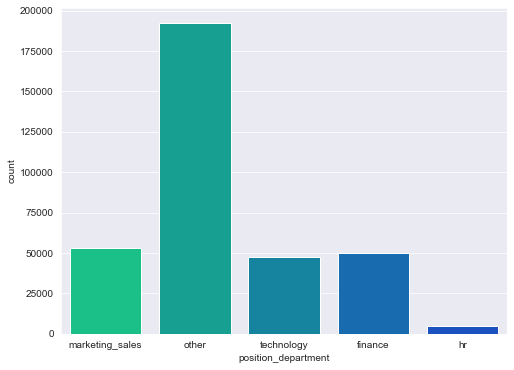

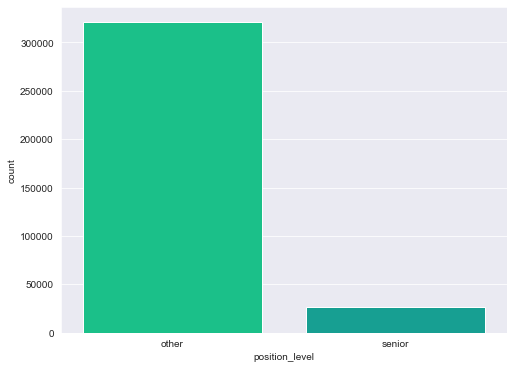

In [172]:
# how many reviews for each type of position 
plt.figure(figsize=(8,6))
sns.countplot(top_company_reviews.position_department)
plt.show()

# how many reviews for each level of position 
plt.figure(figsize=(8,6))
sns.countplot(top_company_reviews.position_level)
plt.show()

In [154]:
top_company_reviews.groupby('position_department').overall_rating.mean().reset_index()

,position_department,overall_rating
0,finance,4.136318
1,hr,4.329524
2,marketing_sales,4.159850
3,other,4.042415
4,technology,4.096643


In [155]:
top_company_reviews.groupby('position_level').overall_rating.mean().reset_index()

,position_level,overall_rating
0,other,4.081076
1,senior,4.135470


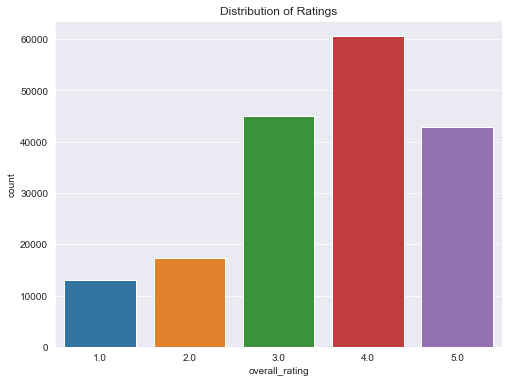

In [285]:
plt.figure(figsize=(8,6))
plt.title('Distribution of Ratings')
sns.countplot(df['overall_rating'])
plt.show()

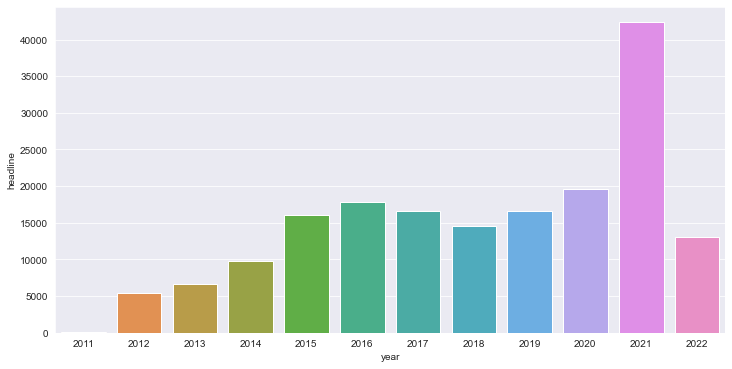

    year  count_normalized
0   2011              0.06
1   2012              3.02
2   2013              3.70
3   2014              5.51
4   2015              9.00
5   2016             10.00
6   2017              9.30
7   2018              8.16
8   2019              9.27
9   2020             11.00
10  2021             23.68
11  2022              7.29


In [286]:
reviews_by_year(df)

In [ ]:
# TODO Ratings over time 
# month and year since 2012 

## Words Analysis

In [289]:
tokens = list(itertools.chain(*lst_corpus))
freqdist = FreqDist(tokens)
most_common = freqdist.most_common(50)
most_common

[('good', 75003),
 ('work', 62437),
 ('great', 50693),
 ('benefit', 29538),
 ('people', 26842),
 ('company', 23983),
 ('opportunity', 19753),
 ('culture', 18076),
 ('balance', 17685),
 ('environment', 16975),
 ('life', 16083),
 ('lot', 14064),
 ('pay', 13933),
 ('employee', 12869),
 ('working', 12519),
 ('team', 11524),
 ('place', 10991),
 ('nice', 10791),
 ('management', 9578),
 ('flexible', 8646),
 ('time', 8600),
 ('salary', 8586),
 ('career', 7979),
 ('job', 7901),
 ('training', 7782),
 ('friendly', 7565),
 ('learn', 7320),
 ('hour', 7073),
 ('get', 7059),
 ('bank', 6220),
 ('experience', 6204),
 ('decent', 5615),
 ('growth', 5565),
 ('best', 5498),
 ('learning', 5451),
 ('well', 5097),
 ('really', 4934),
 ('manager', 4830),
 ('excellent', 4706),
 ('many', 4614),
 ('office', 4481),
 ('colleague', 4436),
 ('home', 4356),
 ('new', 4038),
 ('day', 3875),
 ('global', 3854),
 ('smart', 3826),
 ('business', 3808),
 ('vacation', 3760),
 ('coworkers', 3745)]

In [137]:
# TODO visualize most common words 

In [294]:
total_word_count = len(tokens)
print(f'There are {total_word_count} words in the vocabulary of corpus, after stopwords have been removed.\n')
print('Normalized Frequency\n')
for word in most_common:
    normalized_freq = word[1] / total_word_count
    print(f'{word[0]}: {normalized_freq}')

There are 1475333 words in the vocabulary of corpus, after stopwords have been removed.

Normalized Frequency

good: 0.050838014197472706
work: 0.04232061507469839
great: 0.03436037830103441
benefit: 0.02002124266182618
people: 0.018193858606836557
company: 0.016255991020332358
opportunity: 0.013388841705567488
culture: 0.012252149175813189
balance: 0.011987124262793553
environment: 0.011505876978282191
life: 0.010901267713797496
lot: 0.00953276311178561
pay: 0.00944396959872788
employee: 0.008722776485037616
working: 0.008485541908165818
team: 0.007811117896773135
place: 0.007449843526851226
nice: 0.007314280911495913
management: 0.0064920936493659395
flexible: 0.005860371861810181
time: 0.005829192460278459
salary: 0.005819703077203587
career: 0.005408270539600212
job: 0.00535540111961164
training: 0.005274741363475229
friendly: 0.005127655925814714
learn: 0.004961591722004456
hour: 0.004794171892040644
get: 0.0047846825089657725
bank: 0.004215997337550234
experience: 0.0042051523283

In [299]:
bigram_measures = nltk.collocations.BigramAssocMeasures()
finder = nltk.BigramCollocationFinder.from_words(tokens)
bigrams_scored = finder.score_ngrams(bigram_measures.raw_freq)
bigrams_scored[:10]

[(('work', 'life'), 0.009193178760320551),
 (('life', 'balance'), 0.008271352975904422),
 (('good', 'work'), 0.004859919760487971),
 (('good', 'benefit'), 0.004508812586717711),
 (('place', 'work'), 0.0036303668392152822),
 (('great', 'benefit'), 0.0035869868023015823),
 (('work', 'environment'), 0.003097605760868902),
 (('great', 'people'), 0.0027776779886303634),
 (('company', 'work'), 0.002381157338716073),
 (('good', 'company'), 0.002341844180263032)]

In [300]:
pmi_finder = nltk.BigramCollocationFinder.from_words(tokens)
pmi_finder.apply_freq_filter(5)
pmi_scored = finder.score_ngrams(bigram_measures.pmi)
pmi_scored[:10]

[(("'gs", 'tagmeet'), 20.49260919378279),
 (('+annual', 'fbpyou'), 20.49260919378279),
 (('+health', 'benefits+competitive'), 20.49260919378279),
 (('+internal', 'oppotunities+lots'), 20.49260919378279),
 (('+location', 'tube/dlr'), 20.49260919378279),
 (('+salary+work/life', 'balance+home'), 20.49260919378279),
 (('.clear', 'expectations.clear'), 20.49260919378279),
 (('.competitive', 'salary.some'), 20.49260919378279),
 (('.culture.flexibility', 'work.managementtt'), 20.49260919378279),
 (('.fire.lockdown', '.lift'), 20.49260919378279)]

In [301]:
"""
min_count (float, optional) – 
Ignore all words and bigrams with total collected count lower than this value.

threshold (float, optional) – 
Represent a score threshold for forming the phrases (higher means fewer phrases). 
A phrase of words a followed by b is accepted if the score of the phrase is greater than threshold. 
Heavily depends on concrete scoring-function, see the scoring parameter.
"""
bigrams_detector = Phrases(lst_corpus, delimiter=" ".encode(), min_count=5, threshold=5)
bigrams_phraser = gensim.models.phrases.Phraser(bigrams_detector)
# lst_bigrams = list(bigrams_detector[tokens])
for phrase in bigrams_detector[tokens]:
    print(phrase)

great
firm
great
culture
get
learn lot
different area
bank
great
experience
junior
development
solid
flexibility
overall
employee
value
good
benefit
work life
balance
stable
hour
easy
perform
work
team
playeraccounting
opportunity grow
colleague
india
great.i
started
fresher
people
patient
learning
process
great
work
culture
great
technology
getting
good
benefit
company
getting
good
benefit
company
benefit
unlimited
pool
opportunity grow
work life
balance
decent
global
company
name recognition
becoming
flexible schedule
global
company
lot
opportunity
international presence
friendly
people
interesting
work
overall
good
work life
balance
brand name
job security
perk
great
co worker
collaborate
smart
folk
flexible working
hours.good
perks.no
micromanagement
internal mobility
supportive
culture
camaraderie
great
vacation
benefit
several different
department
apply
yearly raise
35
experience
work home
potential
overall
good
social
policy
easy going
decent
benefit
insurance
get
good
manager
’

balance
good
payout
good
diversity
commission
opportunity
teller
excel
finding solution
customer
banking
need
successfully
referring
customer
account
opening
many
branch closed
saturday
convenient
come
weekend
good
place
benefit
pay
lot
stress
good
work
environment
much
work
free
time
interesting project
easy
learn rope
supportive
manager
flexible working
hour
good
salary.sometime
wfh.good
manager
entrepreneurial
dynamic
work
culture
presence
across multiple
business line
easy move
around
find
role
new
domain
big
global
finance
institution
sg
globally
diverse
bank
excellent
culture
great
learning
base
internal mobility
work/life balance
diverse
complex
working environment
learn
view
multiple
angle
great
work
culturework life
balance
good
pay
good
hour
good
benefit
great
work
culturework life
balance
good
pay
good
hour
good
benefit
avg
pay
new grad
good
benefit
opportunity advance
career
good
company
work
great
work life
balance
improving
wealth management
resource
benefit
good
paid tim

low stress
global
company
stable job
conditons
local bank
korea
enjoyed working
great
culture
people
best part
job
good
salary
benefit
good
leaf culturegood
salary
benefit
good
leaf culturegood
salary
benefit
good
leaf culturegood
salary
benefit
good
leaf culturegood
salary
benefit
good
leaf culturegood
salary
benefit
good
leaf culturegood
salary
benefit
good
leaf culturegood
salary
benefit
good
leaf culturegood
salary
benefit
good
leaf culturegood
salary
benefit
good
leaf culturegood
salary
benefit
good
leaf
culture
career growth
advancement
plenty
job
opportunity
throughout
career
flexible
work
arrangement
diversity
strong
pay
benefit
company
culture
client
location
goodver
food
though
last
company
good
perk
pro
management
michigan
terrible
especially
excellent
culture
diversity
around
organization
lot
varied
career
opportunity
’
development
excellent
benefit
great
work life
balance
find right
department
friendly
culture
easy get
know
people
get involved
different
project
good
flexib

interact
exceptional
professional
good
perk
like
corporate
rate
due
large
bank
job security
growth potential
competitive salary
benefit
work life
balancecompensationholidaysbenefitsflexible
work
culture
time
flexible working
hour
paid overtime
friendly
environment
chilling
back office
lot
learning
job
good
brand
salary
good
employee
401k match
great
peoplelots
existing
client
good
opportunity
career advancement
career progression
opportunity
available
ok
wagegreat
work life
balancedecent
401k
ptomanagement
want
career
people
try keep
happy
large company
decent
growth
trajectory
good
work life
balance
good
benefit
good
compensation
good
exit opps
tier
1/2
investment bank
emea
job
securitysome
people
really
helpful
work life
balance
good
culture
good
benefit
good
coworkers
ability
work
remote
pay
benefit
reasonable
work life
balance
supportive
team
good
management
lot
opportunity
great
company
work
people
nice
always
depends manager
lucky
manager
super
nice
environment
best
enjoy working

good
perk
great
peopleflexible
work
schedule
global
lot
opportunity move
around
culture
conducive
learning
competitive salary
location
canteen
health insurance
vast amount
knowledge
helpful
team member
excellent
working
enivronment
condition
great
team
environment
learn grow
happy
growth
would recommend
place.if
good
sucking
manager
would recommend
place
training
good
get
develop
negotiation
skill
awesome
place
work
learn
good
environment
good
relationship
leader
nothing
scared
term
giving
feedback
boss
mobility within
company
encouraged
coworkersmajor
project
experience
senior leader
exposure
advocate
diversity
however
focused
sometimes
hire
right
people
right
job
improve
individual
unit
diversity
index
talented
teamdevelopment
opportunitiesflexible
working arrangement
good
company
work
understanding
bos
willing
listen.constant
email
engagement
management
great
place
work
opportunity
best
company
work
employee
friendly
policies.everything
aspect
good
perspective
nice
coworkers
good
be

mobility
good
manager
great
people
payment
ok
benefit
good
corporate culture
everyone approachable
work life
balance
bad
better
pay
global
policy
good
team
work
decent
brand recognition
decent
brand recognition
lot
learngood
flexibilityhigh
remuneration
one best
company
work
india
good
salary
nice
team
good
team
opportunity
career
mobility
great
large firm
like
people
always
happy help
mentor
junior
find right
role
benefit
like
internet
reimbursement
leaf
flexible working
hour
great
culture
good
company
nice
company
decent
salary
good
worklife balance
many
learning opportunity
good
pay
benefit
overall
good
learning opportunity
work
environment
good
company
work
working
home
put
camera
management
always trying
help
find
new
better
opportunity
summer analyst
much
manager
assign
much
work
good
team
work life
balance
team
team
work
crazy hour
team
culture
okay
stability
good.work
life balance
large company
many
opportunity
place
could
management
support
worklife balance
leaf
career growth


learning opportunity
given
achieve
great
skill
position
want
move
company
flexible timing
nice
work
culture
like
management
career development
meritocracy
smart
coworkers
opportunity
top performer
great
benefit
flexibility
work life
balance
decent
work
work
environment
easy
internal
job
placementscan
travel
entire
world
good
benefit
lot
opportunity
salary
thing
great
benefit
career
mobility
incentive
1.
salary par
finops
role
provider
industry
2.
club mahindra
holiday
package
3n/4d
every
year3
swanky
office
name
recognitionbenefitssemi
flexible hour
always
guaranteed
decent
work life
balance
hour
benefit
good
work life
balance
good
lot
opportunity
learn
supportive
colleague
people
nice
great
cafeteria
potential
development
career growth
employee
collaborative
encourage
senior
management.senior
management
willing
listening
employee
recommendation
prospective
first started
enjoyed working
employee
friendly
made
pleasant
environment
benefit
working environment
ok
good
health
benefit
start

lot
work
focus
digitalization
good
place
learn grow
within
role
great
firm
work
many
internal
opportunity
great
training
good
diversity
decent
benefit
pay
good
high
pay
good
place
work
considering
get
right
senior
good
payout
good
benefitsgreat
brand value
opportunity grow
advance
good
company
work
good
company
work
smart people
opportunity
work
across different
geography
care
employeeswork/life
balance
nice
company
leadership
family
benefit
lovely
place
work
many
perk
mobility
work
like
balance
flexible
inclusion diversity
good
environmentcompetitive
salary
great
salary
benefit
day
good
salary
benefit package
corporate culture
flexibility
international
management
brand
good
working environment
compensation
work life
balance
company
great
pay
quick pace
nice
people
great
place
work
decent
benefit package
decent
daycare site
presence
relevant
location
great
exposure
financial world
great
international
company
great
diversity
good
culture
great
work life
balance
great
team
manager
pro
go

employeesmultiple
option
switch
team
good
company
work
icg
great
institution
steep learning
curve
’
great
place
learn
exposure
lot
learning opportunity
good
culture
best
technology
tool
good
start
freshersnice
pay
scalepromotion
best
bank
work
good
friendly
team
friendly
environment
good
company
work
global bank
multiple
opportunity
good
companygood
work life
balancegood
leave policy
great
talent
great
product
best class
online
platform
good
working environment
nice
culture
career growth
latest technology
flexibility
benefit
definitely
family oriented
company
care employee
great
work life
balance
remote
work
strong
culture
diversity inclusivity
competitive pay
solid
recognition program
advancement
opportunity
good
prospect
stick
gained
lot
exposure various
thing
early career
worklife balance
market
good
gained
lot
exposure various
thing
early career
worklife balance
market
good
great
benefit
friendly
organized
pay
solid
like
working
8:307pm
mandated
weekend
're
inclusive
great
benefit


gain experience
people
handling
skill
come
voice
process
good
work
placenice
balancegood
culturegood
listeningnice
office
good
company
good
salary
good
training
good
teamwork
great
good
company
work
work life
balance
better
cross functional
opportunity
good
pay
out
average
bonus
lot
opportunity
try different
area
financial
serviceslateral
movement
good
base salary
team orientated
everyone
contributes
team
meeting
enabling
learning
help
increase
subject matter
expertise
management
try
rectify
system
need
request
good
freshie
bcs
many
training
supportive
teammate
knowledgeable
staff.helpful
family
oriented.flexible
work
scheduleallowed
work home
good
company
great
corporate culture
large
parking
lot
cafe
think
cant think
good
compensation
progression
opportunity
strong
technical
profile
business
accumen
good
company
work
salary
quite
good
worklife
also
impressive
andjob
timing
usual
company
benefit
really
good
good
work
culture
people
supportive
nature
good
work
team
good
package
benefit

people
good
place
work
friendly
colleague
great
place
work
great
management
dynamic
environment
learning
opportunitiesgreat
team
firm
really care
employee
mental health
great
learning
environment
career development
good
brand
opportunity
aplenty
lot
resource
global
firm
good
culture
good
platform
supportive
team
cooperation
good
exposure
perfect
team
great
salary
love
culture
coworkers
helpful
benefit package
excellent
flexible
work
time
global exposure
training
fun
actual
floor
thing
taught
needed
focus
could
happen
floor
instead
taking
training
test
computer
salary
reasonable
considering
workload
benefit
better
local bank
great
honestly
know
want
strong
inkling
want
...
pursue
opportunity
focused
're interested
marketing
marketing
specific
role
'll
spend
month
role
retail banking
risk/controls
wo get
fully
develop
marketing
skill
program
honestly
get
small
taste
like
depending
're
trying
could
good
bad
culture
champion
rewarding
salary
compensation
culture
career progression
skill
de

leader
paymaster
good
reward recognition
good
company
work
good
work
culture
pay
good
team
culture
good
benefit
excellent
salarygood
health
assuranceexcellent
benefitsa lot
carrer
opportunity
excellent
salarygood
health
assuranceexcellent
benefitsa lot
carrer
opportunity
professional
atmosphere
smart people
best
ficc
best
research
mortgage
good
pay
flexibility
internal
career
move
excellent
people
nice
company
good
benefit
employee
front office
tech
department
manager
much better
paid
incentive
help
grow.good
tech
projects.exposure
new technology
nurturing
culture
scope
mistake
flexible
good
exposure
great
training
honest
management
stable job
good
people
strong
management
great
work
culture
great
career
opportunity
meritorious
culture
lot
smart people
working
great
thing
global footprint
global
mobility option
one best
recognizable name
resume
good
flexible
good
progression
opportinities
forward thinking
company
many
opportunity
good
work life
balance
good
benefit
good
benefit
pay
fle

good
salary
knowledgeable
coworkers
good
colleague
global presence
diver
inclusive
company
great
team
good
pastoral
care
interesting
work
employee
friendly
discrimination
higher
salary
fresh
graduate2
near
lrt3
nice
office4
training provided
hence
good
career growth
global footprint
great
reputation
great
place
work
culture
career advancement
supportive
environment
leadership
standard
process
driven
employee centric
organization
advanced
product
global exposure
worklife balance
friendly
atmosphere
nice
boss
work life
balance
good
csipl
chennai
location
colleague
nice
coffee
cheap
great
time
policy
good
culture
employee
provide
comprehensive training
system
internal mobility
pretty
good
many
growth
opportunity
global
basis
working
assistant
sale
manager
flexi
timemanagement
okhas
retirement
fund
nice
people
great
culture
fun
perk
big
company
lot
exposure
decent pay
none
place
suck
beware
work
culture
salary
etc etc
good
pay
flexible
interesting
work
company
offer
lot
training
allows
exp

good
team
good
team
leader
home
office
flexibility
.....
.. ..
pay
good
industry standard
good
good
good
good
good
salary
good
good
peer
good
worklife balance
pay
unlimited
opportunity
inclusion diversity
fair
lot
opportunity move
progress
opportunity move
across world
great
atmosphere
impresive
never sleep
personal development
lot
opportunity
great
team
great
people
work
easy switch
position
within firm
team
usually
kind
pro
people
learning opportunity
salary
multicultural environment
learning experience
transaction
execution
velocity
global footprint
breadth product
service
capability
culture
ethic
due
credit
perk
transparency
nice
company
work
payroll
always
time
work
people
around world
mental
awareness
promote diversity
zoom
friday
good
great
experience
good
learning opportunity
value
diversity inclusion
worklife balance
mental health
many
thing
'd
appreciate
start
working
organization
great
experience
treated respect
pay
ok
new hire
great
benefit
maternity/paternity leave
inclusi

global platform
system
supportive
colleague
pick drop
covid
wfh covid
medical
benefit
flexibility
working
home
layed
back
long
ready
count
big
company
good
people
lot
exposure
new
system
supportive management
good
pay
people
nice
good
place
dynamic
team oriented
management style
hard
work
expected
educational
support
well
good
brand name
decent
starting pay
good
nice
best
marvellous
amazing
great
benefit
nice
friendly
co worker
secure
workplace
learning
new technology
meritocracy
colleague
helpful
clear
career path
work
flexibly
respect
dignity
opportunity
diversified
exposure
via
industry
agnostic
coverage
coverage
different region
relatively high
interaction
even junior
level
promotes
depending
put
rewarding
see
care
lot
developing
employee
pay
rang
really
good
amazing
benefit
salary
competitive
great
community
competitive
people
thrive
change
challenge
like
reward
amd
flexibility
variety
work
global presence
working
good
people.opportunities
rotate
move
new
role
internally.good
addi

helpful
good
place
learn
stability
internal
job posting
possible
18 month
diversity
work life
balance
great
exposure
learning
fantastic
“
brand
”
salary
prospect
team
quality
benefit
opportunity
salary
growth
work life
balance
good
working
culture
everyone
friendly helpful
getting
issue
resolved
regardless
rank
employee
benefit
also
considered
average
work life
balance
good
career growth
within
group
good
working
atmosphere
great
place
learn
thing
free
healthcare
big
company
good
benefit
location convenient
opposite
downtown
mrt
station
yearly
pay
increment
better
nothing
internal mobility
year
current role
manage
transfer
left
excellent
company
work
good
promotion
opportunity
educate
employee
update
regulation
nice
workplace
colleague
working
vibe
benefit
industry leading
including
unlimited
military
leave
great
work
culture
company
freedom
innovation
technology
incentive
growth
dcm
dealsexcellent
pay
learning opportunity
opportunity
learn grow
great
work
culture
excellent
team
innova

good
work life
balance
amazing
team
mnc
culture
fast
processing
application
job
form
great
foundation
learning
banking operation
great
teamwork
professionalism
higher base
salary
flexible
arrangement
good
pay
brand value
convenient
job
location
flexibilitydiversity
lot
opportunity grow
provide
good
learning material
provides
great
benefit
pay
entrylevel
call center
position
strong
macro
trading
frachise
good
people
part
great
community
technology
development
global bank
stable
career path
good
amount
holidaysdecent
pay
good
company
work
great
diversity
across
business line
geography
discount
company
good
consistent schedule
base salary
openness
diversity
flexibily
covid
working
remote
good
place
stay
learn
fantastic
culture
nice
internal mobility
pretty
resourceful
good
infrastructure
best
management
good
comp
great
culture
work life
balance
needed
good
hr policy
give
good
offer
crack
interview
depends
negotiation
skill
great
leadership
development
opportunity
learn
strong
leader
smart

grow
good
people
process
fine
new ceo
promising
challenge
many
opportunity
learn
various aspect
interesting
tasksworking
international
environment
knowledge sharing
good
location
great
culture
knowledge sharing
good
location
great
culture
nice
company
welcoming
culture
full
energised
individual
great
progression
good
supportdiverse
range
opportunity
alongside
day
job
good
work life
balance
benefit
good
leadership
nice
salary
care wellbeing
employee
decent
work life
balance
job
salarybenefitsglobal
opportunitiesglobal
working
environmentprofessional
developmentopportunity
internal
promotions/high
internal
mobilitysupportive
senior management
stable job
high base
pay
respect
work
place
good
opportunity
good
company
general
overall
environment
work
priority
continuously
change
adapt
need
customer
industry
company
great
company
work
relaxed
fun exciting
work life
balance
new
good
salary
flexibility
favourable
worklife balance
work home
hour
benefit
good
benefit
applicable
contractor
awesom

benefit
training
development
good
first job
friendly staff
within
bank
training/onboarding
engaging
great
place
work
welcoming
inclusive
environment
employee
iternal
mobility supported
12 month
position
good
salary
colleague
helpful
manager
considerate
great
environment
lot
growth
opportunity
great
place
work
without
doubt
benefit
really
really
good
international
experience
quality
mid level
management
good
place
work
delhi
ncr
pay
vaca
commute
good
exposure
good
experience
great
office
great
teamwork
office
near
metro
nice
location
flexiblity
lot
young
blood
great
work
place
work
collection
team
team
work
varied
work
great
recognition
already
provided
earlier
good
development
opportunity
good
salary
package
internal mobility
easy.job
securitydescent
hikeswide
variety
technology used
good
culture
professionalism
opportunity grow
good
working environment
nice
collegues
competetive
compensation
packagepromotioncompany
perk
work life
balance
advanced technology
global exposure
investment


worldwide
work
developing
knowledge
talent
apply
moreover
lot
tool
develop
talent
degreed
udemy
internal
learning
tool
etc
find
lot
intelligent people
across
broad
try make
friendship
stay
connected
grow
good
benefit
business
structure
medical
benefit
par
better
industry
people
nice
supportive
good
salary
entry level
high basic
good
perk
work life
balance
totally
dependent
team
lot
opportunity grow
competitive
salarygood
office
locationgood
health
insurancegood
working
home
policyno
5th
one
great
company
work
diverse
many
opportunity
challenging
environment
good
profile
location
friendly
intelligent people
push
work
harder
good
firm
tô
wordpress
learn
employee
friendly
global
great
culture
generally
good
place
work
aa
global bank
great
place
put
finance
practice
senior management
open
speak
listen
initiative
suggestion
supportive management
fast
thinking
willing
challenged
good
place
work
friendly
working environment
people
treated respect
firm
exercise
prudent
credit
standard
wide arr

goal
good
health
benefit
100
recommended
compensation
good
meal
transpo
allowance
provided
rendering
overtime
good
benefit
salary
work life
balance
lot
tech
explore
freedom
implement
people
location
technology
perk
compensation
good
opportunity
work
across
team
competitive salary
good
pay
decent
benefit
big
company
lot
opportunity
great
environment
friendly
transparent
helpful
clean
great
team
work
good
benefit
good
people
good
people
work
good
opportunity
best
work life
balance
wonderful
collaborative
team
great
experience
new hire
great
place
work
people
manager
excellent
work
global
company
interaction
different country
great
benefit
employee
move
rapidly
good
salary
good
team
ethos
opportunites
learn new
career
skill
good
company
work
benefit
great
colleague
competent
collaborative
work
environment
great
colleague
brand
quiet
place
work
work
work
may
initial
package
later
realize
big
mistake
done
accepting
join
extra
bucks.there
could
good
thing
wont
able
leverage
culture
created
m

offered
bank holiday
job security
nothing positive
say
best
narcissistic
slacker
drama
king
queen
power
grabber
flexi timing
work home
option
end
working
18
hour
..
good
shift
timingsoffssalarymandy
leave
swap
multiple
opportunity
learn grow
loved
racking
bike
peoplehealth
care
package
benefitsprogression
good
exposure
value
talent
learning opportunity
various role
learning
development
good
competitive salarygreat
working environment
culturegood
place
learn
great
perk
sufficient
salary
benefit
good
worklife balance
bank
offer
competitive compensation
good
pay
401 matching
biggest pro
flexibility
pay
benefit
especially
maternity leave
combination
legacy
latest technology
great
place
work
build career
combination
legacy
latest technology
great
place
work
build career
worked
banking
chef
great
benefit
progressive
company
good
place
work
love
amazing
colleague
really
nice
facility
resource
global reach
hmo
rice
allowance
13
mo
pay
huge
company
good
culture
decent pay
high
pay
flexible hour

place
learn
get
work
senior leader
big
company
grow
future
great
work
culture
love
good
leader
good
company
environment
nice
manager
work
diverse
team
people
opportunity
career
decent wage
challenging task
lot
learn
stable job
long
’
asked
stable job
long
’
asked
friendly
environment
coworkers
great
much
cool
office
though
refreshment
nice
salary
environment
good
mentor
excellent
job
'd like
advance career
banking
global reach
firm
result
great
opportunity
great
benefit
company
culture
good
work life
balance
good
college
job
flexible schedule
good
enviroment
working
good
payflexible
working hoursgood
work life
balance
salary
topnotch
technology
international
culture
employee
voice
concern
stable
good
pay
management
high performance
team
new technology
growth
opportunity
...
benefit
compensation
internal mobility
etc
great
learning curve
experience
good
work
like
would
reccomend
good
worklife balance
benefit
global
strong
consumer
franchise
fixed income
platform
diversity
mobility
acros

competitive
'll
push
grow
1.world
home
2.good
leaves3.work
everything
’
matter
many
hours/
time
day
’
working
4.bonus
end
year5
good
work
culture
global
company
provides
global
job
opportunity
benefit
pay
internal promotion
opportunity
good
worklife
balancehigh
job security
great
company
work
really
look staff
bring
best
good
company
prospect
good
benefit
employee
benefit
parking
management
daycare
pay
great
training
awesome
opportunity
growth
development
good
boss
good
start
salary
promotion
bonus
non
existent
nice
people
work
great
benefit
time
flexible schedule
lot
opportunity grow
fresh graduate
external hire
claim
work life
balance
diversity
important
benefit
great
vacation time
plenty
great
team
great
environment
pay
benefit
nice
policy
great
work
culture
people
’
greatest asset
’
experience
work
environment
professional
management
team
supportive
much say
really
big
company
huge
opportunity
great
exposure
learn
upper management
amazing
great
benefit
comparable
benefit
bank
paid 

benefit
pay
line
industry
good
training
good
salary
growth
global
opportunity
talented
folk
compensation
benefit
decent
get
learn
latest technology
brilliant
work
force
talented
qualified
senior
manager
open
culture
medical
benefit
paid
leave
medical
benefit
paid
leave
collaboration
employee discount
time
medical
benefit
tuition reimbursement
401k match
community involvement
good
environment
good
colleague
good
employee engagement
brand name
exposure
interacting
multiple
vendor
organizing
executing
event
planning
strategy
increase
sale
location
executing
marketing campaign
local
level
better
work
culture
compared
company
financial industry
14
consecutive
day
mandatory
leaf
every year
good
perk
openness
people
mobility
global
company
flat hierarchy
typical
call center
work
benefit
vacation
wonderful
little
experience
necessary
great
experience
lot
learn
culture
collaborate
flexibla
working
hours.good
salary
.good
management
good
exposure senior
management
great
benefit including
tuition

time
started teller
became
banker
year
could
moved
chose
paid vacation
federal holiday
401k matching
maternity/paternity leave
get
monthly commission
quarterly bonus
officer
title
high
vice president
even
fresh graduate
good
pay
market
good
team
fratty
loved
company
job
miss
great
environmentgood
teamhandsome
salarygreat
management
great
environmentgood
teamhandsome
salarygreat
management
good
compensation package
good
worklife balance
great
organisation
opportunity
lateral movement
high
incentiveswith
basic
pay
plus commission
brand
respected
outside
good
work
place
opportunity
great
company
learn new
stuff
complexity
great
people
good
work
environment
good
standard
investment banking
pro
good
modeling
training
great
analyst
colleague
good
exit opportunity
depending group
're
promotes
withinexcellent
benefitscareer
growthsolid
culture
good
bank
work
multicultural
learn lot
product
knowledge
flexible
work
arrangement
generous
leave
benefit
good
training ground
learn
business
move
green

well
secured
financial
organiztaion
complex
system
designed
maintained
developed
current former
leadership
support
flexible working
hour
also provide
great
career path
time
great
benefit
lot
business
opportunity
incredibly
interesting
large scale
work
excellent
benefit
pto
benefit
quarterly
event
food
day
room growth
play
well
others
great
inclusive
environment
work
remote
work
permitted
people
decent
work
multiple
opportunity
work life
balance
good
company
work
diversity
work
force
relatively stable
company
decent comp
decent
people
work
solid
pay
great
benefit
wfh
extremely
ethical
bank
work
great
benefit
flexible
work
good
vacation time
extremely
ethical
bank
work
great
benefit
flexible
work
good
vacation time
build
people
believe
people
give
promotion
stuff
deserving
good
managementtraining
support
great
cool
environment
enough
free
time
challenging
work
excellent
work
environment
competitive
salarygood
place
work
plan
building
career
financial service
industry
exposure
several
tec

career progression
good
said
role
change
much
promoted
mean
responsibility
pay
job
big
company
lot
area
move within
senior analyst
global
analytics
coe
bangalore
half year
amazing
learning curve
pretty
good
challenging
people
making
confident
helping
bos
instead
handholding
personally
felt
amazing
global reach
networking
professional
expert
respective
field
good
welfare
meal
reimbursement
ot
good
great
company
work
lot
benefit
decent pay
leave policy
udemy
learning
free
benefit
co worker
site
ability
work
enjoying
time
humble
folk
care
design
earth
benefit
salary
market.ability
work
remote
day week
depending
job
real
international
bank
comparing
competitiors
digitalization
motivation
caree
perspective
nice
one
great
organization
work
opportunity
work
different aspect
banking
good
training
opportunity
one
willing put
effort
career
opportunity
good
great
company
lot
learn
1.
great
perk
lot
vacations2
many
vertical
horizontal
load
opportunity
learn new
technology
well
financial world
paid

nice
place
get
ur
hand dirty
flexible
friendly
colleague
good
manager
ability
work
independently
flexible schedulegood
health
insurancepersonal
development
opportunity
company
offer
good
opportunity
learn new
skill
ample parking
decent
benefit
compensation
able
income
benefit
good
work
driven
smart people
large
international
company
lot
opportunity
good
benefit
ok
work
feel comfortable
large
global footprint
many
connection
resource
large
global footprint
many
connection
resource
great
benefit
try
offer
incentive
encouragement
keep
employee
updated
’
going
company
flexible
management
friendly
people
international
operating
company
constant changing
business
set
big
potential
driven
employee
numerous
learning
oportunities
possiblity
shift
department
another
next year
week vacation
always
provides
opportunity
always something
learn
flexible schedule
entrepreneurship
great
pay
benefit
autonomy
high
starting salary
attract
outsider
training
lot
new grad
start
together
multiple
opportunity


good
benefit
greta
teamkind
people
good
benefit
salary
cab facility
working environment
greta
teamkind
people
good
benefit
salary
cab facility
working environment
flexible
work
hour
friendly
environment
good
work life
balancenot much
workload
good
environment
opportunity
learning
satisfaction
balance
nice
environment
nice
bos
great
people
work
flexible
come
moving
geography
flexible
come
working
different department
decent
salary
poland
nice office
fresh
fruit
juice
good
working condition
global
firm
international
angle
wide
product suite
stable
orgnizational
structure
etc etc
base salary
work life
balance
good
pay
ok
great
benefit
great
opportunity
work
smart people
challenging
job
401k
pay
career
option
market
recognition
good
salaryyou
get
bank holiday
training
scope
job
team
leader
teammate
wonderful
learn lot
get
paid
well
dayshift
get
lot
support
supervisor
actualize
company
goal objective
people
great
work
good
culture
award
given
star performer
get
work
big
company
lead
con
abi

work
excellent
work/life balance
daycare
onsite health
insurance
management
always available
open communication
positive
environment
constant
training
work
hard
unlimited
opprotunities
advance
good
place
work
dynamic
word
culture
give
lot
learn
one best
multinational
company
one
could
part
great
opportunity grow
good
working environment
great
company
work
challenging
place
benefit
culture
diversity
flexible schedule
good
work life
balance
nice
people
good
opportunity
health
benefit
stability
401k
na na
people
learning curve
fast pace
environment
well equipped
system
great
place
worklot
opportunity
good
pay
awesome
company
work
compensation
good
compared
industry standard
learning
potential
good
personal growth
skill set
development
nice
environment
friendly
colleague
able
relocate
good
pay
say
good
enviroment
good
platform
great
place
work
operates
meritocracy
great
place
work
innovation
focused
bank
move
several
area
keep
growing
learning
pto
holiday
pay
client
continuous learning
tes

great
global
brand
scalability
good
career
opps
free
foodgood
people
easy
workflexible
hoursgood
pay
simple
point
task
pto
benefit
friendly
atmosphere
junior
employee
given
opportunity move
laterally
within firm
several
time
relative
ease
everyone
well compensated
good
environment
global
company
lot
opportunity
experience
corporate
giant
great
training program
learn basic
sale
benefit
work
environment
decent
many
exception
compensation
ok
mature
corporate
infrastructure
great
support
internal
lateral mobility
department
location
really
good
benefit
pay
fast track
promotion
exposure
company
viewing
technology
competitive
advantage
great
people
good
opportunity
good
working environment
good
company
work
formy
manager
truly cared
usinsurance
benefit
really
good
area
started
're
hiredmultiple
shift choose
fromgood
thorough training
exposure
digital
new technology
great
atmosphere
independent
thought
valued
exposure different
area
high
salarygood
locationbonuscolleagues
low
living
cost
bkk


community
focused
engaged
enabling
people
service
client
lot
opportunity
tampa
grow
career
nice
employee
activity
global bank
like
university
never stop
learning
company
empowers
people
provides
tool
best
demanding
since
demand
best
client
take seriously
regulator
requirement
great
place
work
great
hour
holiday
benefit
lucky
good
manager
good
excellent
company
really
develop
find
area
want
amazing
many
training
opportunity
broaden skill
opportunity
learn
many
financial
software
interaction
people
organization
gather
validate
actuals
forecast
input
stability
diversity
good
ethic
job security
good
schedule
monday friday
learn lot
short period
time
good
training
benefit
outstanding
people
super
friendly
plenty opportunity
growth
flexible
casual attire
get
work
done
attitude
great
manager
country
’
sitting
directly
challenging
first
teach
internet
relationship building
strong
work
ethic
big bank
many
layer
good
benefit
nice
dental insurance
401k
even part
time
employee
company
policy
good.

concern
bonus
customer
employee
great
culture
strong
corp
brand
good
place start
banking
career
graduate program
management
associate
top notch
banking
program
good
training
mentor
high
salary
bonus
freshman
gaining
global
banking
knowledge
good
reputationgood
salary
marketnice
building
amazing
benefit
great
company
work
depth
training
good
work home
benefit
people
whether
coworkers
manager
everyone
extremely supportive
communicative
truly care
performance
strive
greatness
competitive salary
benefit
work life
balance
competitive salary
benefit
work life
balance
1.
open
culture2
wfh3
leaf
compared
firm
20
public
holidays+
30
pl
unlimited sick
leave
best
hr policy
infrastructure
handsome
package
good
compensationa
benefitsmeal
transporation
allowance
night
shiftfree
shuttle
edsa
day
shiftflexible
time
schedule
great
culture
rewarding
willing
work
people
help
really
make
job
great
work
environment
great
colleague
great
benefit
time
work
environment
load
holiday
leaf
...
mahindra holiday
o

option
employee discount
popular
brand
good
product
great
customer service
pay
good
benefit
great
location
tribeca
hour
terrible
good
place start
great
benefit
great
company
room grow
family oriented
great
pay
great
healthcare
friendly
culture
pay
grade
far
better
decent
salary
benefit
learn lot
working
big corp
good
benefit
health insurance
401k
vacation time
large company
growth
opportunity
many
lifer
employee
large organization
great
resource
plenty
inhouse
careeropportunities
good
hr
policiesflexibilityapproachable
higher management
strongly
challenging
fast paced
global
branch
opportunity
learn new
thing
develop career
give
fair
opportunity
everyone
good
salary
benefit
professional
environment
good
pay
good
benefit
lot
training
coaching
improvement
success
growth
opportunity
friendly
environment
culture
awesome
staff
fun
stuff
great
people
work
excellent
benefit
advancement
opportunity
mention
global bank
work
hard
long hour
expected
financial service
company
great
access
modern t

awesome
company
work
good
international
employment
training
opportunity
great
development
career
opportunity
working
smartest people
industry
nice
workimg
environment
friendly staff
competent
management
lot
training provided
grow
inside
company
open
got
opportunity move
accross
department
steep learning
curve
performance based
compensation
really
need
push
hard
get
good
rating
interesting project
nice
people
overall
great
benefit
work
environment
fun
micromanaging
low
skilled
work
huge
business
lot
learning
exposure
amazing
facility
flexibility
work
global presence
great
exposure different
business
many
learning opportunity
career development
source
flexibility
good
culture
friendly
enviroment
many
venue
learning
professional
company
location
benefit
pay
flexibility
analyst
encouraged
voice
idea
suggestionsflexibility
people
move across
organizationwork
life balance
smart
intelligent
seasoned
workforce
work
well
team
good
benefit
month paid
leave
pregnancy
leave
childcare
site
great
de

learn grow
name
value
salary
higher average
global bank
great
brand
leadership
innovation
wide
presence asia
product
range
across
retail
corporate
segment
work
culture
thrives
competition
meritocracy
everyone
friendly
pay
solid
type
work
employee
enjoy
great
benefit
company
host
special event
employee
every month
campus
great
cafeteria gym
great
team
work
pay
good
benefit
good
salary
good
benefit
wfh
great
pay
package
considerate
work
ethic
people
work
many
experience
many pro
working
care employee
customer
vacation time
offered
benefit
day
maternity paternity
leave policy
benefit
great
chance advancement
long
open feedback
find
mentor
key
last
17 year
depending
location
also
get
work home
great
company
hand
great
ethical
sale
environment
around
unit
pay
good
training
option
decent
provides
free transport
employee
nice office
equipment
pay
good
training
option
decent
provides
free transport
employee
nice office
equipment
benefit
work life
balance
stability
competitive pay
good
benefit


calling
card
lot
smart people
world class
client
generally
let
job
opportunity
transfer within
company
expanding
knowledge
gaining
new
experience
ability grow
professionally
learning
different
business
process
good
people
work
great
benefit
company
open
diverse
offer
angel
day
extra
day
year
donate
hour
pay
pay
period
offer
free
day
allow
volunteer
charity
facility
world class
cafe
chef
prepared
offering
gym
12 month
site
global exposure
able
deal
many
complex
issue
training
available
highly
capable
talent pool
able
work
talented
intelligent driven
people
care
work
great
people
atmosphere
generally
micromanagement
great
opportunity
mobility
office
world
nice
building
good
salary
good
enviroment
environment
great
opportunity
care employee
benefit
stay long
enough
upward mobility
year
bonus
sale
none
lied
pay
increase
get
thru
door
white
male
manager
would
talk
people
color
exist
competitive pay
good
benefit
lot
opportunity
learn
move
role
great
time
pro
job
great
benefit
good
training
a

great
work
offer
lot
training
mandatory
optional
company
great
diversity
culture
flexible working
arrangement
able
attend
family
required
good
compensation
good
work
environment
good
work life
balance
good
career
opportunity
put
work
good
work
culture
compensation
work life
balance
good
benefit
staff
pleasant
work
lot responsibility
could
get involved
many
project
client
since
day
great
team
steep learning
curve
great
culture
hr
really
employee
flexibility
best part
longterm
view
business
financial advisor
personal
wealth management
might
potentially
one
greatest
job
high level
flexibility
great
tool resource
great
support
team
bank
much
work
environment
good
salary
credited
time.you
get
ample
sick
leaves.good
exposure
good
benefit
salary
diverse
culture
tampa
campus
great
people
cafeteria
also
free
fitness center
full timer
onsite
doctor/pa
choice
advancement
different area
top performer
recognized
good
salary
bonus
job security
pay
people
great
high base
salary
branch
close early
fle

great
experience
real responsibility
work
first
day
fulltime
work home
bos
mean
say
care
work
long
get
job done
company
401k match
dollar dollar
salary
fulltime
work home
bos
mean
say
care
work
long
get
job done
company
401k match
dollar dollar
salary
professional
friendly
environment
care employee
nothing much
really
totally
wasted
year
time
2012
2016
still
regret
signed
offer
back
2012
director
blind
dont
give
...
staff
nothing positive
talk
really
...
hour
pretty
good
decent
salary
flexible
good
benefit
global exposure
flexible
work
arrangement
talented
smart people
smartest
ever
work
great
company
career development
brand value
good
work
culture
compliance
oriented
good
colleague
peer
huge
growth
opportunity
're
entrepreneurial
interested
taking
challenge
provided
full
respectful
time
effort
well
401k
investment
choice
think
twenty word
section
fill
review
lame
benefit
great
include
dental eye
addition
medical
offer
flexible hour
embrace diversity
including
ethnic
gender
sexual ori

facilitysomewhat
better
compensation
service based
companiesnothing
else
xxx xxx
xxx xxx
xxx
free cab
facilitysomewhat
better
compensation
service based
companiesnothing
else
xxx xxx
xxx xxx
xxx
1.
good
benefits2
senior management
effort
understand
required3
brand value
finance industry
excellent
work life
balance
company
becoming
flexible
regarding
work
arrangement
working
home
great
vacation day
flexible
nice
work life
balance
quite
good
work life
balance
friendly
culture
lot
thing
going
time
good
corporate culture
diversity
integrity
great
bank
work
great
bonus
pay
higher
bank
large
enough
company
hide
needed
collaborative
culturegreat
trainingrelatively
flat
corporate
culturesteep
learning curve
global organisation
diverse
company
good
learning
environment
junior
like
environment
people
professional
good
benefit
vacation
location
employee
health
benefit
nice
atmosphere
cummulative
decision
proper
guidence
top
level
better
opportunity
future
induction
training session
useful
pay
goo

big
org
organization
room move
around
good
mentor
significant
international exposure
great
culture
support
senior
big name
cheaper
bank
product
employee
free coffee
nothing else
really
acknowledgement
good
work
requirement
something
field
culture
branch
good
boss
friendly
accommodating
company
well
branded
customer
hold
certain
expectation
better
comp plan
retail bank
focus
quality
accounts/balances
quantity
account
feel
real
job
retail bank
opportunity
banking
finance industry
great
company
great
salary
package
staff
world wide
reachlots
different
technologieslots
people
learn
good
put cv
built
program
take
client
financial
situation
picture
product
pushing
pay
benefit
ok
good
excellent
job
perspective
culture
relaxed
welcoming
team
work
attitude
lot
different
opportunity
within company
competitive pay
benefit
opportunity advancement
diverse workplace
good
place
sit
around
get
paid
year
figure want
next
great
company
work
really
take care
employee
globality
brand recognition
career
st

changed
toxic
one
great
time
work life
balance
work
culture
good
provides
ability
improve
organisation
well
learn new
working
area
great
time
work life
balance
work
culture
good
provides
ability
improve
organisation
well
learn new
working
area
flexible
work
culture
technically
superior
bank
aggressive
per market
trend
depends
management
higher management
leadership
mindset
value
good
employee
develop
staff
accordingly
providing
personal professional
guidance
engagement
reward/recognisation
people
willinging
teach
definitely
learn lot
fast paced
talented colleague
every corner
planet
hyper
competitive
market
stimulating
intellectual
environment
applicable
pro
people
multinational
environment
great
benefit
job
global
company
leverage
advantage
global
friend
global
global
global
great
culture
good
compensation
reasonable
challenge
vast
variety
technology
different kind
specialist
lern
mobility
global bank
lot
opportunity move
aroundcompensation
line
industry
satellite office
country
gener

healthy
happy
environment
work
wide range
opportunity
great
corporate culture
globally
great
visibility
job
market
good
start
point
start career
learn
corporation
101.good
benefit
market
salary
talented
young
people
friendly
atmosphere
global
career
opportunites
generally
high
stress
environment
people
tend
friendly
wonderful
experience
money
made
easily
ready
work
hard
budget
long term
plan
good
company
good
enviroment
one best
bank
world
good
relationship
employee
good
teamwork
ethicgood
social
sidegood
location
london
good
atmosphere
good
pay
work
good
atmosphere
good
pay
work
great
opportunity
learn
aml
world
brand
many
opportunity
country
modern technology
good
social
progamm
paybenefitspaid
volunteer
daygymcafeterialocation
worked
compliance
area
aml
investigation
one
year.the
salary
assigned
title
commensurate
previous
working
experience.good
management
knew
workload manageable
generous
compensation
flexible
work
arrangement
congenial
environment
xlnt
benny
work
place
best
easy


celebration
festival
eg
mooncake
festival
deepavali
chinese
new
year
lion
dance
etc
progressive
workplace
flexible
work
plan
available
standard
banking
environment
standard
pro
large company
stressful
people
perceived.working
hour
highly dependent
role
mobility
really
good
especially
want
global
transition
knowledge
mutual fund
hedge fund
pe
great
company
work
lot
opportunity
growth
benefit
really
great
get
lot
paid time
including
48
hous
sick
paid time
extremely
flexible
time
school
earned
bachelor degree
working
great
benefit
flexiable
hour
none think
still
complete
disconnect
company
institutional
side
commercial
side
different
world
employee treated
differently
numerous opportunity
tampa
location.good
work life
balance
company
take
active
interest
community
good
pay
rewarding
international
environment
good
group
coworkers.ability
meet new
people.always
get
feed back
benefit
easy move
provides
plenty
technical challenge
due
scale
size
global
portfolio
awesome
work
atmosphere
good
se

highly recognized
global
brandgreat
exposure
great
co worker
work
ethic
casual
predominately
professional
management
fellow
associate
financially strong
company
treat
chloe
well
one
could
expect
call center
treat
promotion
potential
satisfactory
based
meritocracy
nice
change
previous
work
environment
'd
401k health
insurance
specifically
maternity
benefit
great
compared
smaller
scale
company
work home
facility
good
good
benefit
living
wage
decent
opportunity advancement
depending
line business
laid back
atmosphere
work home
opportunity
commission
bonus
opportunity
good
worklife balance
smart people
good
employer
warsaw
reliable
jobthere
really
good
coworkers
great
personal
career development
good
mobility
growth
opportunity
early stage
career
enabling
talent
progress
meritocratic
way
global footprint
varied
business
provide
vast
internal
opportunity
whole
worldwide
family
full
experience
knowledge
opportunity
enable
leadership
world class
management
skill
global
company
reputation
with

benefit
nice
people
global scale
operation
almost
unlimited
career
opportunity
finance
really enjoy
working
great
place
advancement
growth
time
flexible
job
easy
compared bank
turkey
good
place start
career
international
atmosphere
work
international
team
good
corporate culture
large company
provides
good
opportunity
learn
short time
great
work
environment
coworkers
nice
job
hard
location
great
easy get
great
benefit
vacation sick
day
bonus
even part
time
teller
good
team
atmosphere
although
current
management
knowledge base
currently
ok
scarily
dwindling
ongoing
layoff
variety
work
available
globally
multiple business
one roof
lot
opportunity
lateral move
exposure
nearly every
aspect
market
finance
great
networking
lot
experience
lot
event
pay
good
benefit
ok
insurance
like
everywhere
else
prohibitively
expensive
benefit
competitive
good
oportunity
work
global
initiative
experience
working
international
team
international
wellknown
companypossibility
learn
lotsalary
average
great
mana

great
center
room advance
career
massive
salary
great
adventure
nice
people
great
talented people
culture
punishing
bank
great
talented people
culture
punishing
bank
pay
fine
'll
work
mad
hour
month end
close
lot
opportunity
size
company
excellent
training
tool
help
preform
job
effectively
salary
fairly
good
job
environment
quite
relaxed
bearing
mind
corporate
reception
work
showing
personality
encouraged
however
remain
profesional
exposure
big organization
process
driven
great
coworkersfast
paced
environmentwork
closely
various
groupspretty
good
benefit
opportunity advance
pay
decent
ceo
senior leader
committed
right thing
bought
vision
pay
comparatively
higher
avg
company
field
get
learn lot
grow
need
perform
good
project
get
wasting
time
asking
project
want
good
brand awareness
benefit
annual leave
better
local bank
make
hiring
easier
great
matching
benefit
401k plan
good
working environment
state
technology
good
people
good
401k
benefit
standard
vacation policy
financial institute


people
take pride
work
good
salary
benefitsnice
bright
officetalented
people
dublingood
fair
culture
great
team
good
work life
balance
get
work home
flex time
community
social event
gym
club
job security
relaxed
work
culture
fast pace
environment
dedicated
team
lot
team
work
cap
overtime
neither
commission
gym
great
food selection
cafeteria
child
daycare
lot
social activity
networking
decent
benefit
worldwide
location
flexibility
stable
company
benefit
get
good
opportunity
within
people
wo
stop
value
personal development
good
work life
balance
people
culture
lends
inclusive
environment
able
make impact
intelligent people
industry
year
wonderful
people
great
team
across
business
tech
operation
interesting task
much pressure
opportunity move
talented people
good
benefitsability
speak
affluent
client
well known
brand
flexible schedule
great
vacation time
great
development program
management
many
network
group join
based
interest
well
paid
great
training program
ok
company
employed
global 

location
dynamic fastpaced
environment
good
starting
platform
aspiring
careerseekers
offer
opportunity
work
colleague
different
culture
background
company
provide
level
international exposure
internal mobility
1.
frequent
restructures
give
opportunity move
across
teams2
global
brand name
make
client interaction
easier3
easy
hour
head office
great
company
great
process
upward
mobilitybiannual
reviewsadequate
traininggood
benefitscollege
tuition reimbursement
friendly
work
environment
good
opportunity
development
love
benefit
excellent
people
work
also
excellent
encourage
try
harder
great
work life
balance
good
benefit
company
promotes within
often
us
temp
service
help
get
door.fairly
clear goal
setting
good
atmosphere
salary
polish
market
brand image
strong
culture
client
confidence
brand image
strong
culture
client
confidence
great
people
work
get
bed
every day
love
also
decent
health
benefit
incentive
advantage
organization
also
keep u
learn
update
work
efficiently
organization
bright

new
bldg
great
global bank
world
one
private bank
cater
client
business
multiple
region
world class
product
unbiased
investment platform
utilizes
industry leading
research
team
bring
best brightest
investment
manager
client
great
place
wrk
good
salary
good
people
work
best place
woman
low turnover
good
work life
balance
except
certain
time
year
might
good
highlevel
position
base
plus commission
paid
performance
harder
worked
money
made
really
good
initial training
good
company
full
challenge
great
company
work
benefit
ok.
would
lucky
work home
able
focus
get
work
done
salary
responsibility
growth
opportunity
learning
paycheck
one
hour
lunch
water
career
mobility
career
opportunity
learn
many
thingscan
handle
platform
good
brand name
recognised
globally
colleague
generally
fun
helpful
cross training
opportunity
possible
high turnover
rate
management
needed
people
handle
different
job
scope
great
company
work
staff
amazing
work
opportunity
potential
career development
good
place
learnunp

good
work
environment
excellent
coworkers
opportunity
escalate
way
highest
position
available
area
within
year
benefit
great
401k
timeoff
tuition reimbursement
name
great
career
mobility option
even
global
option
globally
many
opportunity grow
high
mobility within
department
different
one
huge
company
get chance
get know
little bit
everything
great
experience
love
love
love
citigroup
stable
environment
lot
opportunity move
great
benefit
plan
time
sick time
holiday
time
401k
start
day
one
big
company
lot
resource
area
really
good
people
technical expertise
open
position
need
look
great
company
good
coworkers
fun
gathering
great
benefit package
without
90 day
probation
period
nice
place
develop
self
professional
nice
tool
help
client
achieve financial
goal
benefit
time
work
load
great
benefit
time
work
load
great
great
latitude
cross training
department
expand knowledge
experience
personal growth
without
impeding
advancement
benefitsvariety
schedulebonus
potentialhigh
tech
opportunity mo

reputable
organization
provide
training
good
coworkers
lot
learn new
hour
flexible
especially
technology
area
're
given
opportunity
work home
lot
ot
availability
shift differential
10
weekend
differential
20
good
money
work
weekend
5pm
1.
work
home2.diversify3
globally4
good
training5
hand
many
opportunity
department
meeting
job
requirement
post
another
position
dynamic
environment
bunch
intelligent people
working
together
nice
vacation
package
work life
balance
pro
working
rooom
growthlots
campus
perk
company
great
benefit
show appreciation
coworkers
nice
working
gave
bonus
every
mortgage
sold
company
great
benefit
show appreciation
coworkers
nice
working
gave
bonus
every
mortgage
sold
good
work life
balance
exposed
unique
banking
experience
management
team
even
intern
professional
lot
work life
balance
flexibility
gym site
flexible hour
big
group
young professional
entering
job
newly
graduated
individual
able
apply
skill
learned
finance
class
risk
analyst
role
great
first job
good
te

opportunity
many different
line business
good
employee
good
time
ok
provide
bonus
training
good
environment
culture
none none
none none
none
big bank
multinational
many
opportunity
good
salary
benefit
staff
nice
benefit
campus
internal movement
opportunity
great
peer group
seasoned
middle management
starting
paypaid
sick day
starting
immediately
bank
hour
great
people
reasonable expectation
level
worked
best brightest
people
ever met
large
global
company
opportunity
across
many
functional
geographic
area
coworkers
position
amazing
one
position
hate
job
love
coworkers
favourable
work
hour
real
opportunity
promoted
private
banker
successful
banker
associate
career path
clear
career path
smart people
grow
great
global
mobility
large firm
great
internal
global
opening
movement
people
generally
really
friendly helpful
culture
right thing
people
approachable
employee
really
competitive
term
knowledge
skillsets
good
resume
work home
option
good
401k
tuition reimbursement
discount
phone
bill
v

worked
couple
landmark
transaction
mega
deal
space
good
place
learn
business
wo
always
get
best
technical
work
would
hope
always
create
new
opportunity
team
work
good
technical
people
always
pleasure
discussion
current trend
technology
learn lot
good
exposure
good
networking opportunity
great
learnign
employed
yearsin
year
received
promotion
overall
pretty
good
company
great
benefit
career growth
potential
lot
training
employee
oriented
good
benefit
underwriting
liberal
underwriting
manager
easy talk
scenario
help needed
lot
bank
hour
contact
underwriter
ops
people
happy help
great
business
industry leader
knowledgeable
senior management
good
learning experience
helpful colleague
good
working
atmosphere
teamworkgood
place
learn grow
great
benefit
nice
work
location
great
company
work
good
career development
easy
advance
challenging
interesting
work
good
benefit
training
tuition reimbursement
good
work life
balance
many
manager
allow
remote
office
flex hour
option
worked
many
good
peopl

also
flexible
break
time
great
benefit
good
company
friendly
environment
competitive
starting
rate
competitive
discount
certain
retailer
great
benefit
health
401k
etc
branch manager
worked
great
willing train
even
background
sale
flexible hour
great
benefit
commute
great
stability
boring
role
year
good
company
start career
easy
internal mobility
option
manager
willing teach
junior
team member
easy move
internally
great
work
environment
good
salary
start
flex hour
long
total
40 hour
citifinancial
stillopen
dundee
state
handling
real estate
account
withmostly
collection
modification
one main
handling
personal
loansloan
processing
collection
upper management
listen
voice
employee
program
implement new
policy
huge
mnc
extensive
area
work
around
many
product service
good
infrastructure
individual contributor
great
teamwork
team spirit
willingness
help
great
culture
lower level
room growth
amazing
show interest
work
good
benefit
large company
many
internal
opportunity
good
pay
nice
way
meet


management
across
business
learn
interesting
work
environment
decent amount
client
intereaction
great
work/life balance
warren
location
great
branch
team member
loyal customer
great
branch
partner
friendship
remote
work
option
great
benefit
supportive
peer
career growth
opportunity
interaction senior
management
relaxed atmosphere
work life
balance
flexible
timingswork home
facility
long
vacation
22+6
personal day
good
maternity paternity
benefitsmart
ppl
work
access
many
location
internationally
flexible working
schedule.great
benefit
brand name
work
culture
good
friendly
environment
good
incentive structure
decent
benefit
people
work
together
pay
good
training
much else
none
one
worst
company
worked
crooked
tip
stay away
mobility
opportunitiesencouragement
technological
ingenuity
good
growth
opportunities.lots
training
personal professional
development
dynamic
deiversity
versatility
friendly
calm
environent
work
global franchise
growing
office
opportunity advancement
great
company
wor

leadership
programme
fastpaced
management
generally
open
change
constantly
working
upgrading
give
money
..
money
worklife
balancetrainingfriendly
peopleno
athome
workpart
time
employment
retirement
benefit package
competitive
site cafeteria
nice
perk
well
good
enviroment
good
pay
good
co worker
etc etc
etc etc
good
initial
pay
diversity
program
throughout
company
seems
good
cafe gym
medical
service
onsite
benefit
awesome
worklife balance
time
policy
flexible
within
reason
continued education
ops
job
helped
outspoken
helpful
training
also
good
listener
good
scope learning
enhancing
skill
better
pay
department
buffalo
office
close
suburb
easy commute
car
casual attire
great
management
salary
benefit
corporate
campus
great
training
great
people
location
jacksonville
great
awesome
gym daycare
commute
good
urban
enviroment
work
great
pay
benefit
decent
working hour
regarded
positive
due poor
performer
sticking
around
great
benefit
fair amount
personal
time
lot
way
learn
love
source
staff
cu

friendly
working environment
good
salary
great
intern
compared local
bank
accumulated
valuable experience
working
foreign bank
china
work
environment
good
perk
excellent
compensation
industry
diverse
technical
environmenthighly
qualified
individual
variety
work
company
support
community
flexible
work
arrangementseasy
work home
lot
training
ssc
safe
workplace
information security
area
much
safer
business
position
plan
job
long term
working
reputable firm
like
added
benefit
large company
advancement
opportunity
certain
state
large
processing
center
experience
culture
networking
learning
flexbility
good
salaryemployee
friendly
leave
policiesprovision
work
homelong
duration
project
great
group
people
work
withwent
way
provide
young
intern
highquality
experience
institutional
sale
employee
analyst
lot
upward mobility
also
luxury
working
either
new york
new jersey
manager
great
helpful
work
smart people
good
work life
balance
engaging
opportunity
growth
global exposure
access senior
banker
c

job description
since
place
revolving door
working
great
experience.the
benefit
great
good
401k
pent
ion
plan
good
opportunity advancement
group
worked
responsible
valuing
foreclosed
property
company
global reach
opportunity abound
client
attracted
major
global
status
cross
product
possibility
cool
upbeat
nice
friendly
environment
mike
corbat
strong
ceo
clear strategy
firm
embedded
throughout
firm
much
time
effort
spent
staff
development
feel like
company
really
trying
move
away
dark
day
crisis
interesting
job
resourceful
big brand
health
benefit
401k
paid time
tuition reimbursement
benefit
job security
good
tuition assistance
time
make
working
little
acceptable
possibility grow
company
know right
people
great
work life
balance
young
environment
fun
atmosphere
good
benefit
promotion
fast pace
environment
good
pay
company
name
great
value
resume
pay
work
year
move
good
company
career growth
global
company
world class
training
international
culture
good
pay
lot
opportunity
willing
work
h

approachable senior
pro
collecting
paycheck
great
benefit
flexible
time
salary
vacation
benefit
global
exposurelots
opportunitiesworklife
balanceleadership
room growth
great
benefit
company
vehicle
minimum
supervision
overtime
global
experience
inter
cultural
team
salary
perk
mandatory
paid leaf
worked
many
smart
individual
able
learn lot
independent
workflexible
schedulenice
gym
campus
friendly
atmosphere
training
diversity
transparency
technology
good
benefitrun
health
club
many
location
office
available
employee
looking
become
mobile
career
great
people
lot
collective
experience
access
technology
good
work
sale
analytics
year
stay
liked
worked
manager
period
learnt lot
work
cherish
working
great
location
people
lot
learn
international
opportunity
excellent
willing relocate
good
salary
good
higher management
solid
longterm
career
great
benefit
wonderful
people
extensive training
support
learned lot
finance
pressure
working
trading floor
lot
great
people
training
good
opportunity
cont

thing
working
citibank
include
people
get
see
talk
everyday
recognition
distributed
service
oriented
mentality
friendly
coworkers
great
training
ojt
good
pay
benefit
different
schedule
available
multiple
department
work
every
supervisor
worked
really
cared
team
stats
team member
performing
would
receive
additional
one
one
training
encouragement
employee
given
multiple
chance
correct
stats
maybe
many
chance
chance grow
learn new
job function
time
flexible schedule
great
benefit
great
team member
diversity
oppurtunities
flexible
work
hour
ability
work home
great
incentive
employee
large organization
global
resource
good
training program
staff
handle
in out
resource
readily
avaliable
unmatched
global footprint
mid
lower level
management
ability grow
strong
total reward
mr.
corbat
trying right
thing
training
overall
good
commitment
recognizing
good
job
positive
'm
familiar
company
know
several
people
currently
work
company
utilizes
technology
process
understand
completely
competent
positio

complete
time
pace.you
meet
learn
greatly
diverse
base
professional
undoubtly
develop
personally professionally
process
excellence
governance
model
pioneering
outsourcing
strategy
six sigma
quality
talent
development
tremendous
growth
opportunity
benefit
supportive
team
decent comp
great
learning
development
opportunity
great
work/life balance
learning curve
autonomy
benefit
good
life
balancehorizontal
opportunity
availablecommitted
senior
managementteamwork
culture
strong
hr
team
courteous
listen employee
company
literally
pampers
training
period
good
long term
perspective
great
exposure
level
decision making
delegation
lower level
aggressive
market leader
pioneer
technological
leverage
stay ahead
competition
working
great
team
exceptional
easily accessible
managers.you
learn lot
job.tasks
allocated
based
ability
skills.you
participate
many different
project
early
lot
opportunity move
around
laterally
training
buffalo
decent
people
nice
nothing
major
average
iq
people
big
diversify
st

great
good
benefit
timeoff policy
worklife balance
work life
balance
visibility senior
leadership
great
networking opportunity
banking
veteran
good
brand
cvlots
resourcesopportunities
travel
move around
company
great
team
culture
respect
peer
salary
reasonable
expect
best
market
really
want
learn
banking
especially
corporate
banking
bring
next level
good
fellow
intern
classmate
good
work/life balance
5060
hour per
week
good
pay
working
teach
prioritize
many
project
work
tight deadline
brand name
decent
salary
flexible timing
international reach
incredible
innovation
solid
brand
time
always felt
company
gave
personalized
attention
management
dealt
allow
flexibility
long
impact
business
good
pay
nice
bonus
excellent
work
great
benefit
flexible schedule
average
pay,401k
match
ability
excel
move around
huge
company
250,000
employee
work
hard
70
hrs/week
get
recognized
senior management
ability
mentored
move around
good
leader
seek
though
good
pay
stick around
making
95k
yr
original
base pa

literally pro
lot
people
earth
chill.lot
great
manager
want see
succeed
promote
withinend
year
bonusgreat
cafeteria
great
people
great
learning experience
learn
corp
finance
valuation
modeling
20 year
plus
career
enjoyed
many
interesting assignment
flexibility
working mom
nice
people
work
overall
generous vacation
time
especially
tenured employee
leadership
passionate
winning+
lot
opportunity grow
management
positions+
pay
competitive
mainstream
banks+
global footprint
provides
opportunity
work
crossborder
possibly
teeup
opportunity
work
overseas
excellent
salary
management
excellent
hour
good
hour
employee
tend stay
interesting deal
work
great
benefit
time
wks
vacation
plus personal
day
onsite
exercise
facility
good
salary
great
benefitsgreat
work
environmentcoworkers
amazing
great
support
management
great
resume
experience
people
work life
balance
benefit
management
great
benefit
especially
vision insurance
customer
centered
focus
realistic
performance
measurement
covering
whole
job 

decent
benefit
pro
working
company
get
part
firm
massive
global reach
span
multiple country
around world
employee
firm
smart talented
group
great
culture
work
global bank
implication
amazing
people
work
safe
woman
good
learning opportunity
work
experience
awesome
awesome
awesome
awesome
awesome
good
company
work
short period
time
learn
leave
long term
employee
taken care
well
enjoyed
daily
challenge
great
co worker
global presence
many
opportunity
company
many
breakthrough
celebrate
general
good
place
work
new york
area
working environment
good
employee
provides
training
tool
achieve
desired
goal objective
offer
great
benefit
competitive pay
scale
employee
work
hard
local community
take
part
charitable
event
nice
coworkers
get
taken advantage
think anything
else
nice
say
flexible
great
health
benefit
site gym
site daycare
great
timeoff
option
opportunity explore
different
career path
large
diverse
company
competitive
culture
intelligent people
big
company
make
extra
cash bonus
great
be

capital market
java
sql
linux
o
fantastic
training
good
system
international exposure
would suggest
especially
entry level
possibility change
business
area
quite
quickly
learn
different
skill
pay
good
supervison
understanding
lucky
work
great
group
people
great
training
state art
technology
methodology
supportive
positive
reinforcement
upper management
great
oppotunities
bilateral
upward
career growth
within organization
company
truly care
employee
thanks
growth
everything
department
worked
wonderful
place
work
paycheck
monthy
many
smart people
org
lot
opportunity
learn
practice
skillsmajority
people
nicecompany
organizes
outreach program
focus
allowing
employee
flexible
work
schedule
work
remotely
certain department
good
job
employee appreciation
event
benefit
citibank
offer
challenging
job
opportunity
people
looking
career growth
banking
lot
vacation time
worked
well
family/work
balance
many
schedule
pick
people
genuinely
nice
rare
ib
excellent
benefit
ability transfer
different
part

opportunity
lot
change
opportunity
learn
form
different
business
country
great
people
facility
learn
decision making
opportunity
growth
great
people
genuinely
try right
thing
great
career oportunities
truly global
company
good
hr
system
talent
mangement
learning
development
etc.
respectful
work
environmenmt
work life
balance
great
good
network
across department
function
work life
balance
global
scope
nice
diverse group
people
using
current
technology
currently
available
large scale
global
company
various
technology
work
unparalleled
global network
allows
access
company
like
else
great
company
work
right group
busy
lot
leisure
nice
enviornment
good
atmosphere
company
name
soundemployees
nice
full time
job
medical coverage
excellent
health
vacation
benefit
flexible
work
hour
extremely
fast pace
wont get
bored
receptive
culture
global outlook
support
employee
growth
personal
goal
easy
job
easy going
easy
life
good
name cv
,if
person
experience
company
pay
better
market
median
internationa

enable
one
see
many different
area expertise
product
focused
organisation
encourage
job
mobility
provide
many
opportunity
great
health
benefit
great
company
gain knowledge
practice
leave
door
open
learn
risk
great
learning
information
great
company
work
self
taught
employee
expand
really
fast
highly
organised
hr
jumped
soon
mentioned
rsi
nice
subsidised canteen
located near
lot
nice
shop
restaurant
average
salary
culture
career
opportunity
etc
fundamental
part
’
commitment
promote
personal professional
growth
individual
international
experience
work/life balance
depending
leadership
project
require
long hour
great
place
work
report
local
senior management
get
support
charity
month
earn
credit
towards
support
company
portion
annual review
earn
right
wear jean
work.staff
lower level
management
typically
get along
well
upper
manager
get involved
mandatory
monthly
ranking
employee
nice
campus
working environment
benefit
..
great
place
build
experience
learn
business
banking
many different


company
lot
opportunity
exposure multiple
type
business
people
including
global
helping
manager
good
international
atmosphere
structured
organization
precise
procedure
control
want see
true
multinational
company
work
place
great
place
learn
business
international exposure
great
exposure
given
opportunites
organization
meritocratic
environment
great
people
excellent
growth
opportunity
great
work
place
great
location
realtime
resolution
quick
service
good
benefit
offer
multiple
schedule
bad
choice
something
'd
want stay
long
hind
site
20/20
wish
would
went
back
school
learned
something
valuable
make
easy
stay
hampster
wheel
vacation
offer
job security
least
benefitsemployee
surveyspeople
ageschance
work
area
large corporation
good
compensationstructure
workflow
pension
matching
good
benefit
excellent
depth breadth
role
wide
set
portfolio
geography
choose
role
associate
dynamism
financial
analytics
incentive
earn
good
work life
balance
nice office
location
friendly
people
big
franchise
wo

citibank
perform
given
get
lot responsibility
thus
would
allow
grow
person
large
bank
lot
division
move
learn
friendly.career
progression
throughout
career
extensive
preliminary
training
personal banker
sponsoring
series 63
life
insurance license
large
variety product
program
consumer
management
flexible
somewhat
laid back
environment
people
friendly
willing help
job
tight
job
market.i
get
overtimeeasy
dodge
blame
good
salary
extremely
client
oriented
competitive
good
reason
thing
going
worse
good
work
environment
good
policy
culture
friendly
work
enviornment
opportunity advancement
nice
site
great
break room
big
group
well established
system
80
technology
better
risk control
gfc
large
global
company
innovative
banking product
many different
cultures/companies
e.g
conglomerate
..
better
country
regional
global
role
culture
citibank
excellent
drive
work
hard
staff
forced
take
pressure
could
lead
fraud
culture
learning
people
exposure
depth
world class
bank
good
salary
well known
brand
w

work life
relationship.good
atmosphere
work
in.decent
benefit package
work
work
pressure
end year
sad
face
company
well
give
hike
bonus.
worth
sacrificing
worklife balance
great
knowledge base
brilliant mind
one roof
money
make
ok.
heard
people
say
flexible schedule
going school
independence
good
working
office
environment
online training
great
actually
miss
still
could
learn
anything
wanted
took
full advantage
that.good
vacation
personal
time
package
position
ability
work
home.the
company
good
name
difficult
jump
competent
fi.global
footprint
theoretically
allows
move
anywhere
'm sure
many
people
actually
though
decent
payflexible
schedulesurprisingly
good
benefit
part time
jobgood
training
programpaid
vacation
part timer
financial advisor
cpwm
truly
help
individual
achieve financial
dream
impact
client
life
big
way
providing
sound
investment
advice
schedule
flexible
master
domain
ability
run practice
according
see fit
bank
staff
business partner
serve
primary
source
new
client
referr

technology
good
pay
coworkers
mile
assistance
management
want succeed
grow
role
beyond
good
compensation
lot
opportunity
career progression
good
room
professional
growth
stability
pto
team
support
communication
good
place
work
good
place
work
good
place
work
working
smart driven
people
friendly
culture
compensation
good
working hour
high
pay
strong
culture
great
benefit
competitive compensation
generous
bonus
good
working environment
build
helpful
connection
learn lot
become
good
meeting
deadline
juggling
priority
already
become better
goal
setter
exposed
high quality
work
standard
office
culture
good
work
want
make money
great
working
culture
best place
learn
loved
super
long hour
good
pay
good
environment
good
skill
friendly
environment
decent pay
scale
great
people
technology
business
knowledge
lot
learning opportunity
people
usually
transparent
willing
communicate
share
amazing
company
culture
great
learning opportunity
good
benefit
strictly
follow
scrum
rule
leaf
developer
work
ca

big name
recognized
everyone
definitely
good
resume
give
decent amount
time
get started
learn
everything
pay
subject matter
people
ambitious
smart motivated
individual
fun
work
get know
usually
friendly
friendly
amazing
benefit
offered
pay
market
investment banking
good
company
work
work
talented people
good
culture
teamwork
various
training
available
brag
working
good
paygreat
people
good
project
experience
amazing
work
culture
environment
work
honestly
great
company
parent
work life
balance
great
benefitsamazing
work
culture
environment
learning
work
environment
exposure
people
work
talented colleague
interesting
exposure
great
learning experience
culture
great
lot
opportunity
people
great
understanding
always
collaborating
teamwork
huge plus
point
competitive salary
load
benefit
fairly
friendly staff
competitive pay
great
benefit
top tier
ibank
industry
good
culture
diversity
within
team
great
people
intelligent coworkers
friendly
money
professionalism
interesting
work
interesting
c

modern tech
company
decent
tech
work
especially
san francisco
along
remote
work
opportunity
salary
house
staffing
option
great
career progression
support
level
10
10
interesting
people
fast paced
great
place
work
collegial atmosphere
great
mind
learn lot
colleagues/management
challenging
work
encourages
growth
good
compensation
strong
team
emphasis
good
balance
work
play
work
hard play
hard
good
employee
culture
smart
colleague
good
money
opportunity
work
easy move
department
department
pay
fantastic
people
amazing
great
learning experience
team
strong leadership
supportive
willing invest
time
developemnt
resource
big
company
smart people
scale
work
smart people
best
industry
competitive pay
people
nice
food
culture
good
firm
nice
culture
good
gain
practical experience
team
good
people
smart people
firm
willing help
fast paced
always
engaging
great
experience
great
mentoring
great
opportunity
get
presentation
experience
analysis
start finish
teach
lot
great
professional
attribute
appli

promotion
mobilityaffinity
networksgender
equity
fastgrowing
department
lot
chance
promoted
company
name
great
cv
nice
pay
starter
position
strong
learning opportunity
new grad
firm
great
promoting
inclusion diversity
managing director
gave
various
opportunity grow
receive
promotion
good
quality
life
people
good
great
colleague
keep
sane
best
ever
environment
agile
work
good
career
exponential
growthlearnt
lot
tech
good
worklife balance
great
learning
atmosphere
culture
great
’
get interact
senior management
loved
time
great
opportunity
learn
financial sector
work
new technology
smart
colleague
equips
necessary
tool
innovative
prestigious
demanding
get
handon
full
stack
role
latest technology
prestigious
good
exit ops
good
pay
good
work life
balance
much better
engineer
banker
good
salary
stimulating
work
benefit
great
meaning
insurance dental
vision
vacation sick
time
get
job
experience
get
challenged
good
work
culture
financial
exposure
people
tech
awesome
time
working
wealth managem

top game
considerably
enhance knowledge
really
great
culture
valuable
company
good
starting
job
fresher
hard
work
rewarded
also
encouraged
work
smartest
connected
people
street
arguing
best
bank
good
worklife balancegood
platform
entrylevel
graduate
good
brand name
growth
great
culture
helping
people
team
culture
steep learning
great
exposure
brilliant
people
good
culture
good
benefit
private
island
pretty
close
office
brand
strong
access
company
management
great
office
generally
collaborative
smart
colleague
demanding
hour
flexibility
good
benefit
nice office
work
merit based
progression
compensation
growth
great
opportunity
amazing
people
everything
role
great
nothing much
say
good
pay
benefit
provided
firm
good
knowledgeable
people
learn lot
different
tool
program
nice
people
tradining
system
plenty
work
busy
work
done
great
place
develop
leader
grow professionally
base salary
pretty
decent
competes
top
company
interesting
worksmart
coworkersgood
managementwork life
balance
share
be

great
pay
good
team
opputunity
work
smart talented
people
awsome
work
culture
challenging
work
good
place
learn grow
high
pay
good
atmosphere
cool
perk
best
people
work
flexibility
work
style
pay
really
good
flat hierarchy
everyone
reachable
good
environment
efficient
employee
good
pay
great
team
environment
openness
life
event
employee treated
well
great
people
awesome
culture
challenging
work
team
good
work
compensationthe
new
bangalore office
thing
beauty
challenging
work
great
people
work
ton
scope learn
grow
place
nice
work
worked
fun
peoplethe
name
go
far
nice
training
structure
support
new joiner
good
company
work
environment
progressive
push
people
work
hard
people
networking
location
growth
project
excellent
people
thag
willing help
lot
learngood
team
environment
decent pay
great
reputation
learned lot
lot
learning
money
brand
office location
multi
culture
good
culture
freedom
choosing
tech
exciting
work
trading
business
good
teamwork
decent pay
super
flexible
great
company
cu

people
willing help
answer question
smart
co worker
age
exposure
complex
product
market
great
vacation
benefit
18 day
vacation
work
capable
highly skilled
individual
work
best
people
majority
colleague
self motivated
gogetters
good
company
culture
friendly
supportive
team
smart hardworking
coworkers
great
exposure
industry
visibility
global
financial market
client
prestigious
company
work
good
name
help
lady
surrounded smart
people
train well
name carry
weight
great
people
work
with/for
lot
ability advance
tackle
tough
project
really
want
amazing
pay
constructive
competitive
wrokforce
people
great
best
luck
constantly changing
workflow
never dull
day
good
benefit
back office
amazing
people
’
still
pay
might
good
top performer
earn
lot
money
career development
professional
environment
personality
grooming
great
team
work
easy
effective communication
good
colleague
high
potential
success
're
really
good
collaborative
team oriented
approach
benefit
people
work
super smart
nice
colleague
s

focused
achieving
commercial
success
noticeable
perk
whatsoever
nothing
decent
salary
ops
management
reputable brand
namegood
deal
best
market
good
culture
mentor
recommend
career
opportunity
client
exposure
think
okay
decent pay
work
good
pay
incredible
learning curve
exposure
variety
investment
1.
good
comp2
brilliant
network
connect
fun
work
working
customersgaining
good
experience
sale
ecommerce
competitive compensation
strong
culture
friendly
atmosphere
team spirit
good
work/life balance
ownership project
early
pay
average
industry
talented people
great
culture
open door
okay
salary
good
great
salary
brightest
people
team
based
culture
way
flexible
good
team
work
culturesuper
driven
employeeshighly
motivated
shine
bright
absolutely love
team
great
pay
great
benefit
competitive
onhands
learningnetworking
ability
learn
many
function
great
amount
learning opportunity
due
vast network
engineers/areas
expertise
always someone
learn
provide
many
resource
employee
great
environment
great

developing
career
people
pay
interesting
work
fun
lot room
advancement
engineering
product
people
feel
heardthose
take
accountability
work
make
far
’
disappointed
pay
’
work
hard
love
good
senoirs
helpful
benefit
flat org
structure
culture
nice
benefit
decent
growth
opportunity
low
paid
salary
well
payed
therefore
good
overtime offered
often
flexible
pto/sick
time
offered
plenty opportunity
growth
nice office
building
free coffee
none think
exposure senior
managementresponsibilities
early
stagechallenging
work
smart people
opportunity
networking
build
resilience
skill
impressive
people
forward
leaning
culture
insider
trading
informationfat
bonusnyc
location
pretty
awesome
amazing
colleaguesexceptional
paygreat
place
learn
great
pay
work
environment
competitive
profile
high
accountability
everything
work
opportunity
learning
environment
great
company
culturefast
career growth
opportunity
competitive pay
smart people
talented
perk
warm
environment
exposure
benefit
reputation
recognition


opportunity
career growth
galore
opportunity
learn new
thing
try different
role
working
several
thing
time
interesting
work
reasonable
pay
nice
salary
management
staff
work
brightest mind
work
culture
choose
want
work
upon
highly
driven
environment
lot
exceptionally smart
people
firm
great
new
office
work home
technology
great
company
work
enjoy
wonderful
benefit
people
smart
helpful
ask
right
questions.peer
review
good
way
rank
performance
also
quick
way
kick
someone
like
review.good
benefit package
smart people
changing
direction
tech
getting
used
new
learning opportunity
challenging
work
environment
great
ob
resume
good
paycheck
organized
high level
people
great
networking opportunity
fresher
best
great
company
work
good
pay
benefit
overall
wonderful
culture
amazing
staff
invest
develop
people
reputation
financial
gain
high caliber
people
motivate
everything
great
company
decent
work
culture
pay
good
bonus
benefit
culture
performance
excellence
smart
colleague
interesting
work
good


opportunity
available
colleague
friendly
good
honest
great
work
nice
amazing
work
environment
place
great
opportunity
learn
market
good
learning
pay
structure
good
good
pay
great
office location
one
raffle
link
good
company
work
contrary
seen
review
culture
nothing
short
exemplary
experience
'll probably
part
smaller
510
person
team
teammate
work
supportive
really
team
atmosphere
people
help
work
load
demanding
manageable
long
communicate
effectively
work
efficiently
great
benefit
compensation
david
solomon
agent
change
organization
good
one
firm
headed
good
direction
great
brand name
good
benefit
brand
resource
people
culture
responsibility
lot
smart
interesting
people
excellent
salarygood
perk
bonus
experience
great
benefit
fantastic
culture
great
attitude
people
salary
good
nice
good
exit opportunity
good
peer group
excellent
company
work
learn
best
best
whilst
working
highest
profile deal
grateful
allow
support
family
pandemic
prestigious name
value/
investment banking
everything
g

awesome
pay
lot
perk
people
work
motivated
1.
good
work
culture.2
excellent
value
work3
flat hierarchy
system4
exposure
cutting edge
technology
latest
idea
nice
work
employee
prestigious
job
interesting deal
good
exit opportunity
high level
exposure
fortune 500
management
large
transaction
etc
good
working environment
encouraging
nice
fresher
begin career
good
hour
pay
relaxed
work
environment
good
salary
work life
balance
good
pay
many
bonus
friendly
work
environment
good
employer
great
opportunity
flat hierarchy
helpful
employee
opportunity move
team
benefitscompensation
sorta
surrounded intelligent
people
people
incredibly smart
always
learn
great
resource
great
people
great
exit opportunity
strong
compensation
alignment
visibility
great
team
good
learning experience
high
pay
lot
meeting
good
place start
career
nice
flexible
work
schedule
good
bonus
good
rubber
stamp
resume
learn lot
’
willing teach
’
jungle
law
great
benefit
decent pay
lot
firm
mobility
work home
flexibility
make
w

sacrifice
work life
balance
get
exposure
finance
want
wok
great
good
benefit
working
smart people
colleague
good
people
talented.office
facility
wonderful.great
salary
best
organisation
work
long
get
manager
name
brand
resume
great
environment
great
people
great
education
insight
working
trading
deskflexible
timing
great
team
platform
ton
opportunity
within firm
great
team
good
work
environment
great
culture
industry
lot
opportunity
world class
facility
resource
good
work life
balance
interesting
experience
steep learning
curve
talent
culture
wide variety
work
opportunity
good
place
work
great
learning
good
pay
good
benefit
good
people
good
company
start
big
company
nice
people
good
pay
comfort
great
exit opportunity
strong
culture
good
location
working
smartest people
industry
flexible working
hour
based
nature
work
region
involved
firm
supportive
work
home/alternate
region
flexiblility
work
culture
accountability
good
working
culture
work
great
brand name
firm
generally
supportive
pe

growing
internally
good
company
good
people
complaint
great
leader
peer
work
learn
intelligent people
across board
lot
learn
good
culture
great
company
work
friendly
culturegood
payerfriendly
management
encouraging
creativity
heard
bank
top
tech
talent
joining
disappoint
team
using
mongodb
nascent
stage
along
newest technology
relatively
collaborative
work
environment
office
event
like
xmas
white
elephant
game
thanksgiving
celebration
etc
compensation
encouraging
stay
decent
company
exit opportunity
year
firm
flexible
timings2
great
work
culture
smart
people3
good
management
handsome salary
paid
firm
hard
work
talented
team
learned lot
internal
development program
abound
talented colleague
producing
great
idea
great
way
tonswond
time
may
time
management
environment
good
line manager
that´s
good
people
company
excellent
place
learn
great
deal
wealth management
collaborative
working
culture
driven
thoughtful
intelligent people
smart people
entrepreneurial
great
drive
good
personality
dev

overstay
else
sucked
extinct
technology
forced
listen
incompetent
manager
fun
learned lot
good
working environment
work life
balance
even
analyst
're
encouraged
present
idea
work
time
add
quickly
good
amount
sick day
'll
need
take
favoritism
management
clue
're
mind
numbing
work
amount
people
kiss
butt
awful
job
favorite
awful
diversity
work
flexibility
inclusiveness
genuinely
honest
decent
people
working
great
place
work
learn
paid
decently
actually
work
’
add value
careergood
brand name
name
company
cv
good
career growth
learning
learned much
finance
working
good
modern technology
prestige
opportunity
learn
quickly
lot
template
good
exit opportunity
smartest people
one
learn
especially
jr.
investment
banker
compensation
brand
learn
diverse group
peer
driven
ambitious
gain
tremendous
business
skill
communication
attention detail
financial
savvy
understanding
business
investor
importance
sale
bonus
quite
good.people
friendly
approachable
brand recognition
necessarily
reputation
good
ex

highly
meritocratic
best place
sell side
much better
buy side
one
good
pay
rewarding
work
environment
decent amount
vacation day
nodefined
number
sick day
ability transfer
department
office
're
proactive
enough
recognition
resume
working
one
elite
investment bank
smart people
genuinely
wiling
help
across different
business
function
offered
pretty
flat structure
security
business
great
working environment
enjoy
right
division
great
learning
environment
put
lot
educating
employee
super
challenging
environment
people
excellent
incredibly
driven
everyone
brings
game
every day
benefit
great
career growth
amazing
good
company
workhires
smart people
big brand
crossfunctional
exposure
good
renumeration
benefit
employee
relaxed
working environment
compared financial
service
company
great
team
wonderful
culture
deep
learning curve
given
many
opportunity
great
opportunitiesgreat
experience
overallthe
people
work
talented
able
create
great
network
get
long
themfeel
proud part
firm
good
pay
super s

largest
pro
working
network
take advantage
working
global network
high intensity
fast paced
exposure
level
management
ability
make
significant
contribution
highly motivated
coworkers
exposure
incredible
transaction
clevel executive
strong
team
environment
strong
credential
recognition
within
finance
community
well run
firm
size
management
clearly
focused
initiative
woman
lgbt
reducing
bureaucracy
great
people
focused
responsibility early
skilled
coworkers
various
background
like
work
company
recognition
work
flexibility
meritbased
brand reputation
quality
people
work
everyone
friendly
social
context
people
really
fun
work
people
challanges
work
profile
learning
career advancement
learn
great
deal
work
smartest
folk
industry
name
merit
perk
higher
paygood
platformname
valueprestigegood
jumping
opps
excellent
compensation
benefit package
even
analyst
level
everything
amazing
big
company
ppl
nice
great
place start
career
smart people
excellent
training
competitive
environment
world class


culture
motivated
people
true
meritocrazy
1.
talented
people2
plenty
responsibility3
upward lateral
mobility
open
culture
excellent
people
great
focus
career development
good
payamazing
people
work
global
company
good
benefit
get
work
talented
colleaguestremendous
learning
opportunitiescollaborative
environment
federation
group
good
learning
good
proportion
people
smart
fantastic
brand
high quality
colleague
unrivalled
training
performancedriven
great
culture
great
comp
benefit
everyone seems
proud
representing
firm
open minded
people
healthy
discus
view
brand
good
want
leave
wellrun
quality
management
firm
place
lot
trust
individual
employee
intelligent motivated
coworkers
challenging
work
intellectually stimulating
various
opportunity
learn new
thing
take
challenging project
great
exposure
open
new idea
pretty
flat organisation
getting
fair
chance interact
senior management
good
thing
pay
good
highperformance
fastpaced
intellectually stimulating
environment
great
environment
people
g

talent
street
teamwork
highly
encouragefantastic
brand name
open
lot
door
want
leavegreat
internal
opportunity
mobility
moving
division
excellent
pay
smart
colleague
competitive
environment
get
work
largest
deal
great
people
culture
always
learn
someone
competitive
work
environment
driven
coworkers
love
culture
company
good
salary
hour
make
rotation
driven
coworkers
ample
resource
refine
soft
technical skill
set
different
affinity network
get involved
make
solid
firm
work
surrounded
bright
people
great
place
work
driven individual
require
minimum
managerial
oversight
culture
wildly
vary depending
team
join
firm
general
desire
building
solution
vendor
product
mean
’
always
new
interesting
initiative
build
even
’
rebuilding
opensource
would
already
provide
good
environment
work
great
communication
environment
career development
feedback
project
opportunity
great
culture
people
work
extremely
driven
hardworking
learnt lot
joined
straight
university
ayco
good
opportunity
rightoutofcollege


great
leader
good
environment
friendly
co worker
best
company
ever
got
return
offer
good
place start
school
great
environment
people
working
company
good
benefit
associate
well
great
people
truly care
back
smart
group
people
professional
intelligent
group
people
believe
team
work
management
keen
getting
innovative idea
level
employee
good
first
pay
flat hierarchy
helpful colleague
make
good
money
good
year
salary
bonus
party
corporate
car
good
teamwork
collaborative
environmentwork
really
nice
competent
people
organisation
carry
people
people
respectful
one
anothergood
work life
balance
great
culture
smart people
good
compensation
benefit package
excellent
subsidised
gym wellness
centre
onsite
bupa
pension
good
bike
work
scheme
additional
facility
office
food
dentist
creche
dry cleaner
auditorium
great
service/
onsite
staff
staff
benefit
medical
siteimpressive
people
best
best
amazing
culture
people
work
discrimination
giving
opportunity
great
support
promotion
innovative thinking
putt

experience
get
work
smart
peoplegood
learning opportunity
performance based
career progression
reward hard
workvery
smart
coworkers
work
learn
withhas
amazing
work
culture
hard working
people
know
great
investment
career
progressionthe
best class
talent
1.
employee
friendly
company
great
company
stellar
reputation
top notch
medical
benefit
team
hard working
professional
good
place
people
starting
career
people
know
stufflot
intelligent people
learn
great
place
work
good
experience
subsiadiary
money
people
like
hard working
people
love
job
push
employes
professional
positive energy
great
environment
always
able
discus
issue
try
resolve
fast
possible
frequent
meeting
keep
team
date
good
smart people
work
opportunity
learn lot
first
two year
great
platform
learning experience
exposure
reputable
jumbo
transaction
facility
benefit
bonus
healthcare
inclusive
innovative
team oriented
strong
corporate culture
growth
good
working environmentgood
peoplework
cultureopen
door
policyquality
workcom

flat organization
structure
bos
feel
really
like
manager
like
role
colleague
performing
manager
instead
proof
value
whole
department
however
bad
thing
...
see
consa
big name
fool
people
probably
get
next job
interviewhigh
pay
actually
sure
still
true
good
paybrilliant
peer
groupopen
door
policyget
work
every aspect
sdlchelps
people
interaction
learn
good
smart people
work
staff
friendly helpful
truly
focused
client
best interest
quality
peer
demanding
work
great
networking
occasional
travel
great
office
building
thorough training
program
upon hire
great
work
culture
dynamic
people
great
open
culture
meritocracy
smart
people.excellent
service
level
supporting
group
like
wellness
hr
gm
etcstrong
technology
great
technologist
great
culture
smart people
pursuit
excellence
every
area
much better
work
hour
client facing
role
great
training
experience
great
development
opportunity
people
level
great
benefit
talented people
learn
structured
friendly
environment
open
culture
strong
learning
pla

balance
charitable
solid
company
decent pay
structure
great
place
learn
possibly
develop career
senior management
approachable
great
working environment
le politics
offer
really
good
professional development
career growth
really
flat organization
great
culture.the
people
really
friendly
intelligent
certainly
best
bank
work
great
environment
great
people
good
salary
good
experience
skilled
collegues
demand
excellence
incredible
network
resource
great
mentor
excellent
training
programgreat
brand
recognitionambitious
smart
colleague
relocation
bonus
referral
bonus
pretty
sweet
great
network
look
good
resume
great
benefit
good
time
opportunity grow
good
pay
smart
colleague
elite
status
people
smart driven
flexible
people
rally
around
issue
help
find
best
solution
raised
manager
work
issue
outside
work
outstanding
coworkersgs
brings best
employee
buzzing
environment
great
place
work
strong
deal flow
worked
execution
time
intern
take responsibility
never worked
pitch
dealing
intellectual
pro

change/striving
improvementwork
smart people
solution
oriented approach
solving problem
money
compensation
beat
salary
continues
good
performer
even
bad
year
amazing
people
interesting project
famous
name
smart people
tonne
responsibility early
exciting
environment
always looking
progress/
change
international
opportunity
division
relatively flat
structure
much
senior
people
required
know
detail
undoubtedly
one best
investment bank
start career
new joiner
super
eager
excited
work
hour
get noticed
make
progress.remuneration
good
compared
sector
normally
marked
market
every year
make sure
stay
slightly
ahead competition
good
year
excellent
bad
year
flat
1.
company
need
spare
little
expense
grooming
you2
junior
given
pretty
large
responsibility early
career
prove
handle
ie
3rd
4th
year
associate
could
handling
responsibility
10 year
veteran
firm
3.
still
illustrious
name
within
outside
finance industry
cutting edge
financing
deal
globally
kid
love
commerce
great
place
pay
strong
excellent

resume
benefit
good
4mo
paid maternity
leave/1
mo
men
work
environment
agile
people
skilled
savvy
speed
important
day
day
activity
benefit
pro
strong
culture
diversity
people
generally nice
money
experience
exposure senior
talent
excellent
reputation
finance
circlesopportunity
work
extremely knowledgeable
colleague
great
people
mobility option
professional
environment
challenging
work
smart people
get
thrown
fire
right away
sink swim
anything
want
learn
name carry
lot
weight
compensation
good
along
added
benefit
quantitative
analysis
quantitative
development
quantitative
research
good
parking
good
manager
great
community outreach
project
ceo
wonderful
approachable
lot
career
opportunity
compensation
good
culture
good
good
company
junior level
get
plenty
systematic
training
essential
people
starting point
career
good
bpay
smart people
smart people
around
working
pressure
environment
develops
smart people
work
withfast
paced
dynamic
environmentgood
compensation
great
benefit
career
build

junior banker
initiative
good
people
rewarding
work
familylike
culture
good
pay
competent
colleague
opportunity
promotion
work
hard
flat structure
open communication
team oriented
good
reputation
would
meet
smart people
could
learn lot
environment
nice
senior management
generally
accessible
time
reasonable
good
place start
name
respected
regardless
next
chance learn
smart
people.very
strong
team
ethic
inclusive
environment
pay
well
want succeed
surround
talented people
evaluates
performance
merit
great
environment
really enjoy
ton
good
work life
balance
fixed shift
timing
great
company
work
great
benefit
opportunity
work
talented people
get
paid
well
great
people
commitment excellence
client
service
pay
medical insurance
amazing
work
culture
incredible
mentorship
opportunity
set
work
smart motivated
creative
people
efficient
competitive
strong
risk management
culture
excellent
economic
trading
research
salary
benefit
great
work
right
city
department
name recognition
top
lot
intern
work

onshore
location
flexibility
financial service
career
extremely
mentally
taxing
ability
learn
many
area
within company
good
reputation
good
graduate program
new york
grey
wolf
two
team
rotation
fantastic
opportunity
always
learn grow
awesome
place
fresher start
work
..
great
opportunity
lot
technology
play
around
smart people
around
youcompany
culture
good
many
one
one
meeting
discus
career
optionsinteresting
work
get
see
user
product
using
happily
good
work
environment
get
learn
day
good
work life
balance
good
pay
good
benefit
fun
work
best brightest
people
ever
opportunity
work
challenging
thought provoking
work
well
good
place start
career
lot
talented people
interesting
job
opportunity grow
well
everyone
already
stated
working
talented
brilliant
people
almost everyone
smart driven
work
hard
get
learn lot
great
learning opportunity
advance career
industry
faster
firm
firm
great
developing
career
track
really
good
career
people
development
lot
training
opportunity
talk
good
career de

steep learning
curveless
hierarchymobility
smartest people
'll ever
work
almost
failure
rate
strong
culture
excellence
value
everything
good
managementroom
growth
interesting project
challenging
good
way
good
wage
amazing
learning opportunity
attractive
pay
bonus
great
work
ethic
culture
diverse
international
environment
needle
mention
company
reputation
cv
....
flat hierarchy
access senior
managementsmart
colleague
managersgreat
place
build
technical skill
knowledge sharing
development
encouragement
right
role
compensation
growth
good
working
bright talented
people
good
health
vacation
benefit
company
allows
decent
number
day
pay
health insurance
also
hard beat
good
resumegood
benefit
meeting
talented
folk
smart people
exciting project
surrounded
lot
smart people
prestigious firm
culture
learn
quickly
challenging
work
smart people
organization
try hard
create
culture
great
people
work
experience
stay busy
get
learning experience
connection
hard find
anywhere else
also
room growth
bad


employee
great
experience
depends team
're
placed
work
vp
understanding
compassionate
wellbeing
others
'll
okay
time
might
even
enjoy
'd say
good
time
ultimately
wealth management
sale
job
depends
person
pro con
make
vp
prepared
salesman
however
're
pretty much
handed
rich
client
rather
coldcalling
one
thing
really
good
ayco
hard
part
making
vp
business
'll
rolling
dough
vp
probably
traveling
working
lot
well
still
good
people
people
drive
compete
best
good
salary
good
benefit
good
environment
horizontal
corporate structure
allows
employee
every
level
heard
employee
encouraged
innovative
entrepreneurial
one
business
principle
emphasizes
people
talent
one
company
valuable
asset
therefore
development
people
center
business strategy
great
network
great
exposure
good
culture
topnotch
good
people
future
network
great
platform
strong
name
brand
resumenetwork
leave
indispensable
experience
work
really
smart
peoplevery
competitivegood
reputation
great
people
great
culture
great
synergy
differe

great
culturecompensation
benefit
amazinggood
management
people
benefit
compensation
resume
building
sometimes
team
cohesive
friendly
time
much
teammate
intelligent
committed
actually
solving problem
punching
punching
clock
everybody
intelligent driven
contribute
achieve
positive vibe
consensus
culture
generous
salary
london office
particularly
flexible
leaving
office
reasonable
hour
working
home
attend
personal issue
necessary
learned lot
trading
work/life balance
terrible
strong brand
resume
offered
role
increased responsibility
overtime
work
smart people
committed
serving client
consistently
looking way
thing
better
fantastic
colleague
teamwork
oriented
collaborative
great
learning opportunity
formal
informal
great
culture
feedback
oriented
professional
walk talk
exit opportunity
resource
possible
networking opportunity
pay
1.
career growth
many
opportunity
within firm
grow
career
2.
pay
well
later
stage career
base salary
double
67
year
3.
lot responsibility
taken
manager
helpful
l

lot
good
knowledgable
people
india
office
learned lot
management
thing
technology
work
culture
opportunity
work
best
industry
bonus
gym etc
good
company
work
physical
location
top notch
great
elevator
gym
professional
meritocracy
get
work
highly competent
talented people
improve skill
set
become
smes
fantastic
culture
people
good
salary
flexibility
deserve
good
place
working mother
good
learning opportunity
good
pay
great
emphasis
transparency
trust
higher management
easily accessible
great
team
prestigious
respect
industry
great
pay
work
hard play
hard mentality
good
policy
train
support
sustain
employee
ok
work
long hour
bonus
good
ctc
market standard
better
still
underpaid
number
hour
work
good
team
good
salary
good
mangement
money money
bragging
right
resume
challenging
environment
politically
work
dc
working
benefit
challenging
felt like
part
team
day
went
fast
learn lot
smart people
around
meritocracy
well
treat well
forget
also
mean
well
let
colleagiate
atmosphere
intelligent co

individual
great
place
learn new
thing
incredibly talented
people
great
reputation
best
industry
access
resource
training
highly encouraged
lateral
hierarchy
opportunity
collaborate
senior management
working
best
industry
good
place
learn
personal
financial
counseling
good
people
get
work
file
important
people
corporate
lot responsibility
assigned
pls
lot
event
including
intern
great
place
work
good
benefit
great
resumejust
case
prestigious
great
learning opportunity
proactive
willing put
time
explore
passionate
driven
bright
people
endless
amount
responsibility
promise
learned lot
corporate culture
feel
confident
working
company
experience
great
people
best
people
ever
pleasure
work
coworkers
helpful
intelligent
'll
always
feel
part
team.work/life
balance
fine
worse
fin
firm
supportive
team
memberscareer
progressionnetwork
opportunity
good
pay
benefit
nice
talented people
pay
mark
compared market
good
benefit
private health
insurance
good
gym etc
compensation
reasonable
industry
stand

compensation
smart
senior
professional
lot
money
awesome
suit
beautiful
hr
girl
awesome
food
lot
goody
pay
decent
enough
compared
kpo
setup
india
really
smart
colleague
structured
professional
equal opportunity
employer
great
name
brand
industrya
lot
hardworking
smart
colleague
learn
fromplenty
lecture
initiative
guest
speakersif
junior
underpaid
senior
overpaid
broad exposure
insider
information
client
international
environment
wide range
assignment
best
industry
great
firm
employee
ambitious
smart driven
management
know
push
right
compensation
button
order
motivate
employee
behavior
one
resume
open
many
door
benefit
working
great
people
people
clever
highly intelligent
smart
bright
nice
great
culture
really
bright
people
opportunity
stand
plenty
willing put
hard
work
great
learning
experiencethey
hold
people
highest
standard
smart
friendly
people
though
sometimes
opinionated
demanding
rank
fortune
magazine
100
best
employer
since
inception
list
encourages
community
giveback
great
tea

human capital
value
diversity
one
see
people
different background
working
team
floor
200
street
building
new
modern
comparison
office
building
seem
shabby
company
family
friendly
allows
generally
take
vacation
requested
company
good
training
responsibility early
career
interesting project
working
lot
smart people
good
benefit
smart people
good
amount
work
great
people
work
incredible
benefit
great
company
build career
fast paced
global
company
get
lot responsibility
definitely
gain knowledge
experience
top
security
company
also
work
intelligent
professional
still
great
people
embody
culture
value
teamwork
making decision
based
right
project
vs.
action
lead
faster
promotion
lot
smart people
around
transperancy
recognition
hardwork
equal opportunity
one best
company
wallstreet
still
best place
ambitious
individual
work
job
really
rewarding
want
life
great
pay
must
work
donot
hae
reason
appreciate
firm
...
work life
balance
management
donot
heart
challenging
complex problem
24 hour
global

bcs
wide breadth
productsgood
work/life balance
choose
overtime
likegood
emphasis diversity
hiring
overall
good
work
learning opportunity
good
allowance
wfh
good
people
good
......
good
peoplegood
food
work
file
balance
know
system
right
set
people
approach
get
job done
good
compensation
benefit
pay
diverse
company
kind
manager
great
work/life balance
work
diverse group
individual
great
culture
people
care
growth
helping
way
solid
job
entry level
ton
work
constantly
working…
good
team
friendly
environment
internal mobility
highly
supported
good
work
culture
growth
opportunity
colleague
knowledgeable
working environment
friendlycompany
provides
many
leaf
flexible timing
sustianable.relatively
cheap
comparison
hard
engineering
option
afforestation
environmentally
friendly
workplace
home
office
nice
manager
opportunity
growthgood
leadership
management
partnership
work
environment
collaboration
open
culture
company
reputation
good
there
lot
exposure
good
reputation
easy move
workplace
work

’
many
thing
learn
like
tech
people
join
brand
flexibility
new technology
learning
unlimited sick
leaf
one
bigger
firm
street
comp
benefit
culture
competitive
position
interesting
work
always something
new
engage
competitive salary
great
work
environment
self
managing
work
none think
good
people
support
othergrowth
potential
advancement
knowledge
skillset
good
place
good
people
work
environment
enjoyed time
large company
get lost
good
benefit
work life
balance
nothing
important
gain experience
nice
company
work
good
best
company
work
good
work
culture
team
environment
good
culture
promising career
opportunity
employee
good
benefit
great
leader
career
focused
people
work/life balance
philosophy
culture
training
recognizable
namebeing
good
get noticed
among peer
good
management
good
benefit
’
satisfied
work
well
good
comp
life
work
balancegood
perksrrsp
match
virtual
opportunity
great
intelligent
mostly
well
round
articulated
collaborator
demanding
challenging
work
associated
learning cu

great
office space
good
location
good
people
great
culture
great
people
great
colleaguestop
firm
great
reputation
good
culture
benefit
bonus
smart people
learn lot
good
brand name
brand recognition
exposure
people
knowledge
great
company
good
work
environment
culture
nice
work
nice
group
particular
strong sense
team
community
great
work
environment
great
position
learn
business
grow
towards
financial advisor
management
comsiders
employee
feedback seriously
environment
colleague
culture
knowledge
people
work life
balance
good
good
work
environment
collaborative
teammate
16 week
paternity leave
90 day
paid sick
leave
like
ceiling
kind
industry
market
good
culture
great
company
work.2
professional
company
work life
balance
pay
ok
benefit
lot
potential
build
careerrelaxed
work
environment
great
pay
good
work life
balance
nice
location
good
ethos
company
really care
culture
fully
committed
people
well
core value
progression
pathway
clearly
visible
good
culturestructured
organizedupward
mobi

learn
seek
flexible
career
focus wellbeing
focused
diverse
market
knowledge
institutional
level
available
retail
customer
good
tech stack
always
learning
employee treated
lot
respect
fast paced
learning
environment
great
culture
senior management
great
team
environment
work
lot
wellbeing
activity
employee
culture
global
leadership
collaborative environment
strong brand
salary
bonus
various
benefit
good
people
wide range
career
pursue
strong
fintech
great
company
encouraging
management
colleague
unique
culture
great
best
supportive
environment
focus
people
professional development
opportunity
work
smart
diverse
talent
big
company
good
benefit
lot
office
professional
environment
working
culture
acceptable
salary
good
pay
manager
training
’
really think
work
cultureprofessionalismlimited
politicsclear
detail
workgood
benefit
people
company
culture
good
company
good
career growth
lot
smart people
opportunity
work
different
task
good
working environment
inclusive culture
internationally rec

good
say
company
fact
constantly
sued
prior
employee
reason
well established
practice
lot
institutional knowledge
culture
cutting edge
technology
lot
good
peoplegood
office
nice
work
environment
good
salary
strong
intellect
people
real
corporate
exposure
good
pay
first
timer
nice
benefit
diversity
pay
worklife balance
future
job
growth
good
culture
strong leadership
good
people
incentive
good
constant
salary hike
help
get license
train well
remote
top
finance
company
received
great
job
training
set
u
successful
gaining
series series
63
establish
process
software development
provide
good
training
graduate
career
opportunity
global
teamwork
exciting
combination
fast pace
business
state art
technology
good
salary
relatively
good
pay
compared market
good
young talent
start
financial
career.good
office location
benefit including
wfh equipment
pandemic.regular
sport
activity
community
event
various
topics.highquality
professional
training
available
diversified
background
good
team
clear
targ

people
prestigemiddle
management
tends
excellentattracts
best
brightestexciting
work
lot
opportunity
upward/lateral
mobility
good
salary
good
brand
good
career growth
prospect
well
know
industry
overall
decent
working
experience
good
pay
good
exposure
financial service
business
investment
research
good
benefit
flexibility
working
home
flexible
work
good
team
good
benefit
good
compensation
good
hour
obviously
depends
type
job
good
good
good
good
good
good
good
people
support
help grow
quality
life
great
morgan stanley
benefit
good
job security
fantastic
pay
good
bonus
okay
profitable
great
people
work
nonhealth
benefit
great
figure
navigate
nice
place
work
good
compensation
excellent
culture
collaboration
work
flexibility
pay
joined
3months
back
experienced
best
remote
work
env
till
work
niche
technology
option
expand
learning
network
well
great
peopleopportunities
learn
growvarious
intitiatives
employee
area
heath
learning
self
growth
many
opportunnities
growth
manager
team lead
genuin

dependable
good
name recognition
bulge bracket
great
salary
perk
good
learning experience
good
benefit
good
flexibility
great
culture
good
exposure
client
deal flow
diversity
trade
great
place
work
working
small team
large corporation
allows
tailor
business
plantechnology
integration
client
employee
platformmassive
networkbreadth
investment
opportunity
except
bitcoin
2021
security
top priority
overtime
surpass
40 hour
week
company
flexible
general
offer
decent
internal mobility
reasonable
workig
hour
also
offer
good
quality
inhouse
trainings/webinars
good
culture
varied
workgood
senior management
good
training
diverse
work
environment
flexible working
hour
learning opportunity
plenty
extra
programs/trainings/seminars
attend
good
salary
work life
balance
flexibility
good
bonus
good
team
morgan stanley
great
company
work
take care
employee
care
well
good
company
work
great
working
experience
flexibility
great
working
expensive
look
good
company
good
company
culture
decent pay
great
worki

job
”
like
firm
people
supportive
starting
good
reputation
fair compensation
international
environment
good
infra
one leading
investment bank
good
benefit
time
generous
high base
salary
fresh graduate
worked
fantatstic
team
good
bonus
good
management
good
brand
highly talented
motivated
peer
great
career
support
great
company
culture
competitive compensation
good
work
culture
leadership
good
pay
benefit
annual leave
work
culture
open
new
ideasless
bureaucratic
growing
company
lot
opportunity
good
work
environment
higher management
reachable
every
person
valued
equally
pay
good
benefit
good
good
pto
lot
holiday
really
good
company
work
treat employee
well
good
peoplegood
salary
good
benefit
great
team
work
wonderful
culture
lot
work
opportunity
awesome
workplace
great
culture
good
pay
good
vacation
challenging rewarding
large
international
company
plenty opportunity
good
people
good
benefit
room grow
advance career
money
compensation
benefit
bonus
party
booze
collaborative
colleagial
cu

people
culture
status
career progression
culture
people
benefit
work life
balance
work
culture
salary
employee
benefit
relaxed
environment
fully paid
training
licensing
process
friendly
coworkers
decent
entry
pay
benefit
lot
possible
resource
daily task
remote
tech
support
benefit
good
pay
ok
first year
comp
good
good
luck
unless
get
counteroffer
bonus
pool
different
existing
employee
lion
share
go
whomever
comp
manager
actual
manager
like
comp
’
actually
tied
performance
great
earnings potential
highly
admired company
great
culture
supportive
team
brand name
strong
mature
every
solution
imaginable
supportive
mgmt
good
management
learned
grew
lot
wealth management
team
part
took
professional
personal growth
opportunity
wherever
popped
friendly
cooperative
collaborative
helpful
good
place
relatively high
pay
highest
considered
fair
welcoming
culture
good
manger
good
salary
good
benefit
good
bonus
strong
culture
nice
perk
driven
coworkers
learn
excellent
time
management
skill
good
manage

great
team
upside
opportunity
lot
training
help
career growth
team
work
work
environment
culture
workplace
brings
upon
constant challenge
aid
work
outside box
offer
lot
learn
bright future
entrepreneurial
exposure
area
within
pwm
best
talent
overall
wonderful
company
work
best brightest
mind
opportunity
transfer within
team
unique
culture
collaborative
work
environment
growth
opportunity
industry leader
management
benefit
opportunity
really
everything
great
forever
job
great
team
usual
perk
working
big bank
professional
environment
flexible hour
good
opportunity
1.
culture
good.2
collaborative
workplace
truly
value
people
culture
andfor
part
full
great
people
connected
global network
lot
event
good
pay
easy
job
company
good
culture
value
manager
good
managing
good
learning opportunity
growing
skill
terrible
program
need
revamped
1.work
culture
depends team
team.2
great
working
opportunities.3
full
technology
work
good
benefit
compensation
culture
energetic
strong
equity research
cultur

friendly
great
mind
awesome
opportunity
visibility
good
love
culture
people
great
work life
balance
fun
outside
work
event
really
none speak
surrounded
highly
driven
intelligent people
pto sick
leave
healthcare
working environment
exposure
financial
domain.good
company
leave policy
compensation
vacation time
time
get
work
client
account
review
wealth
planning
great
culture
team
work
culture
people
work life
balance
competitive salary
accepting
offer
job
consistent
pandemic
enjoy
brand recognition
people
work
perk
great
people
community
lot
learning opportunity
good
people
great
culture
good
hour
technology
infrastructure
mature
many
senior
devs
hanging
around
willing teach
share
experience
people
friendly
lenient
hour
highly
flexible
good
place start
working
positive
work
environment
culture
innovation
supportive
team
great
leadership
talented people
design
implement
solution
finance domain
tech
skill
good
leader
great
culture
smart
colleague
opportunity
growth
strong
management
profes

care
job
creating
atmosphere
get
thing done
good
pay
talented
professional
people
great
pay
opportunity
growth
good
exposure
work life
balance
cutting edge
stack
good
culture
nice office
however
lack
personal
space
open
office
good
company
culture
work
good
culture
good
team
anda
lot
offun
site
culture
career pathing
growth
opportunity
salary
competitive
good
entry level
development program
analyst associate
decent
company
excellent
benefit
health dental
vision 401k
matching
smart people
nice
friendly
fun
awesome
exciting
dream
company
fresher
work
good
company
competitive
atmosphere
good
company
work
want pursue
finance
nice
culture
opportunity
work
diverse
area
good
work
culture
flexible timing
great
people
work
daily
great
culture
smart people
strong leadership
clear vision
direction
intensive
learn
thing
fast
beside
free tea
really
tell
much
good
deal flow
exposure
good
culture
supportive management
technology
great
always improving
great
team
everyone
knowledgeable
advisor
support

overtime
friendly
team
none
place
bad
work
great
experience
opportunity grow
develop career
leading bank
industry
great
pay
great
people
great
job
good
intro
experience
industry
good
benefit
u
worklife balance
wfh
flexibility
culture
fast paced
competitive
learned alot
willing
taught
new skill
trader
ops
guy
1.
remuneration2
good
management3
best place
work
fine
place
work
great
culture
innovation
helpful
management
know
yetmay
brand name
dynamic
environment
good
deal exposure
give
good
package
pay master
market
good
working environment
technology
enthusiast
good
firm
politics
supportive
manager
colleague
good
infrastructure
great
exit opportunity
fun
brand name
company
plus
point
great
platform
global
market
exposure
reaasonable
emphasis
grooming
new
talent
supportive
environmentmanagers
care
want help
advance
fun
culture
frequent
event
happy
hour
lot
training
opportunity
culture
work
environmentwork life
balancecompensation
learnt lot
due
helpful
team
great
manager
get
wear suit
ever

salary
nice
building
great
benefit
people
friendly
blame
something
wronggood
work/life balancedecent
salary
talent
challenge
client
impact
experience
get
test
water
becoming
fa
great
place
work
long
career
benefit
401k match
paid time
interetesting
job
friendly
atmosphere
friendly
approachable
people
nice
working environment
reasonable
management
team
technology.you
certain level
control
work
life.you
certain level
technology
challenge
work.diverse
inclusive
culture.decent
commercial
medical coverage
good
work
culture
good
people
work
good
work
culturework life
balancehelpful
senior
learn lot
challenging
review
nice office
good
personal
environment
people
respecting
flexibility
autonomous
work
nice
corporate
event
intelligent colleague
interesting
work
investment banking
flexibility
encourages
education
becoming
progressive
chill
office
free food
great
place
work
earth
culturehigh
caliber
employee
learning experience
put
right
time
opportunity move
great
great
great
great
great
amazing

holiday
festival
hour
teamdependent
work
trade
support
work
910
hour per
day
overtime
nice
flexible
office
hour
tremendous
growth
opportunity
awesome
employee
good
diversity
people
overall
good
place
think
benefit
good
nice
peoplenice
facilitiesas
good
work life
balance
one
expect
type
firm
great
location
budapest
competent
talented colleague
friendly
environment
office
refurbished
good
firm
culture
working
cuttingedge technology
wfh
ability
good
work
culture
morgan stanley
great
work life
balance
good
people
good
benefit
get
remote
work
good
job
prestigious
need
pay
entrepreneurial
environment
flexible
career
opportunity
good
graduate scheme
structured
learning
part
people
friendly
collaborative
superb
infrastructure
monitor
chair
nice office
location
designrelaxed
dress
codeinternational
environmentgood
benefit
cafeteria gym
subsidy
language
learning opportunity
salarygood
reputationbudapest
office
expandinglots
committee
social
lifementorshipsome
bright
friendly
colleague
none
reall

16 year
career
consistently
poor
manager
rarely
back
seemed
meaningful
feedback
spirit
collaboration
team
company
treated well
generally
looked
forward
going
work
everyone helpful
friendlythe
work
environment
culture
funlots
opportunity
growth
work
environment
positive
general
general
firm
value
suggest
good
experience
employee
great
company
work
caters
employee
belief
diversity inclusion
encourages
mobility within
firm
genuis
lot
learning
space
smart talented
people
management
transparent
placesefficient
system process
infrastructure
really
good
teams.good
benefit
around
16
public holiday
unlimited sick
leave
transport.some
may
like
culture
strong
culture
lot
great
people
nice
infrastructure
great
campus
great
culture
smart
peer
efficient
institution
great
brand
equity
name recognition
great
exposure
global
companydeal
flow
strong
really
great
peopleno
shortage
interesting
technical
problem
great
training program
strong
platform
great
resume builder
annual
cost living
bonus
standard
h

’
loved
direct
team
fond
management
palo
alto
meet
good
hard working
people
morgan stanley
challenging
professional
client
orientated
good
benefit
good
work
experience
morgan stanley
great
culture
’
drive
best
find
smarter
way
working
time
’
fun
environment
’
great
worklife balance
decent
people
culture
ok.
decent
work life
balance
compared
big bank
vary depending
team
’
people
pretty
nice
nice
feeder
program
rowe
fannie
freddie
salary
much better
great
learning experience
networking
office
good
culture
diverse group
colleague
nothing
still
get
paid
classic
office space
i.e
worklife balance
totally
life
''
lot
learning opportunity
great
stepping stone
someone
new
business
limitless
possibility
love
environment
'm
currently
paper
pusher
'm
surrounded
people
much
successful
knowledgeable
adviser
generous
option
giving
discretionary bonus
throughout year
also
always willing
mentor
new
people
like
give advice
often
valuable
cash bonus
lot
resource
want
learn
progress career
also
tuition re

among
one best
investment bank
street
great
work
environment
management
take
time
effort
cultivate
people
firm
everyone
professional
work
team
'll get
good
exposure
work
environment conducive
well
team
supportive
'll
definitely
great
time
20 day
vacation sick
day
nice
view
office
nice
area
take
walk
good
name resume
really
nothing
pay
far behind
curve
unless
rainmaker
good
work life
balance
okay
pay
great
people
good
pay
meritocracy
strong
culture
work life
balance
volunteering
opportunity
care
lot
keep happy
work life
balance
good
training program
nice
work
environment
employeecentric
management
good
benefit
salary
vacation
perk
best
company
work
married
woman
great
culture
good
pay
work life
balance
proper
management
...
year
working
must say
kind
dream
company
get
feel
proper
corporate
environment
getting
good
money
work
able manage
work life
balance
one best
leave policy
across
industry
30sick
leaf
allowed
yes
careful
work
company
ask
quality
..
error
cost
much
working
mumbai
offic

great
people
work
lot
support
good
atmosphere
opportunity grow
nice
colleague
relaxed atmosphere
good
benefit
good
culture
career development
get
study
series series
66
life
insurance
exam
working
good
job
prepare
material
study
much
opportunity
learn grow
internal mobility
also
great
feel like
exceeded
everything
know
current role
people
help
move around
company
want
enjoyed
colleague
felt
company
took
material
step
improve
culture
working
experience
stable
company
give
good
working environment
encourages
initiative
good
training
good
benefit
good
staff
good
work
hour
great
junior
team
poor
retainer
talent
work home
optionsfree
cabswork
pressure
much
learnt lot
managementgot
full
insight
company
like
morgan stanley
work
hr
great
division
work
successful
supportive
giving back
culture
focus
flexible working
technology
platform
freedomincredible
opportunity
growthagency
workas
long
produce
one
care
excellent
culture
learning
environment
good
work life
balance
room
career growth
lot
even

company
work
especially
placed
high
producing
broker
pay
commission
override
exceed
professionalism
benefit
goal
earning
top
wage
good
opportunity
fresher
work
company
great
compensation
employee
benefit
well
're
many different
role
grow within
company
great
place
work
stable
great
benefit
pay
decent
mobility
advisor
available
also
trip
new york
meet
analyst
senior management
good
company
good
value
salary
promotion
opportunity
good
rotation program
good
managementopen
culture
discus
idea
openly
appreciated.good
technical
work
cool
place
work
nice
smart
peopleflexible
hoursgood
pay
good
working environment
organized
management
good
exposure
fresher
great
culture
good
benefit
resource
reputation
footprint
industry
employee
lifebalance
friendly
policy
greate
place
work
good
reputation
..
good
system
chance
really
learn
culture
best
business
great
engagement
business
real
partnership
involvement
fully
integrated
hr
model
allowed
strategic
partnership
client
service
great
people
training
o

joiner
specialize
trading
aspect
infrastructure
point view
work life
balance
good
flexibility
atmosphere
really
good
lot
interaction
client
regular
internal
meeting
discus
strategy
branding
work
opportunity
work
smart
highly
dedicated
motivated
colleague
exception
culture
breed
people
proactively
work
together
across
business line
solve problem
culture
reinforced
top
good
life balance
good
pay
good
work
environment
also
promoted
house
learning
team
good
management
good
great
place
work
strong
culture
lot
freedom
care
make sure
hitting
number
playing
golf
everyday
long
closing
business
dynamic
fun
environment
earth
people
provided
unlimited
resource
growing
environment
good
technologyknowledgeable
people
idiot
like
another
finance
tech
companiesgood
culturebetter
salary
competitor
opportunity
work
smartest
talented people
street
staff
get
excellent
benefit
maternity leave
health care
time
flexibility
great
management
benefit
human resource
approachable
great
firm
mspb
well
much
need
rol

brand
resume
good
place
work
good
people
work
salary
fair
market
value
good
technology
work
part
everyone
really
nice
everyone
get along
office
building
nice
gym
available
want
use
nice
company
work
learn
challenging
good
paybest
worker
protection
good
professional
place
smart
global
office
small
office
different
feel
large
morgan stanley
still
professional
welcoming
environment
work life
balance
bos
far
building
career
star
align
make
lot
money
good
benefit
nice
culture
room growth
excellent
company
name
competitive pay
great
coworker
easy
location
commuting
excellent
technology
first class
people
challenging
environment
work
quants
strats
financial
engineer
software engineer
daily basis
job
learn
finance
like
really
master
concept
crucial
fintech industry
great
brand name
intelligent
peoplegreat
benefit
nice
work
culture
much
work
good
working
knowledge
environment
best place
work
exposure
cuttingedge technology
worldclass
business line
dynamic
challenging
interesting
work
environmen

brand name
employee
benefit
great
people
brightest
industry
salary
higher
compared
company
people
truly
like
99
people
work
yes
unkind
people
far
betweenbenefits
401k match
vesting
year
16 week
maternity leave
week vacation
first
starting
cell phone
discount
etc.work
opportunity
given
lot
opportunity
learn grow
great
learning experience
helpful
staff
coworkers
good
401k match
vacation
decent
benefit
great
work life
balancefree
lunch
excellent
environment
continuous
support
learn develop
great
platform
investment
vehicle
program
client
good
name
street
good
equity research
still
prestigious firm
get license
spend
year
get
95
regularly
job
schedule
job
stressful
talented
employee
focus
quality
hiringtechnology
driven
though
ibflexible
hour
work home
facilitycoperative
staffsupport
mobility
great
first job
college
many
benefit
friendly
environment
many
millennials
looking
m
attracts
high caliber
finance
professional
good
work
ethic
depending team
close knit
team
lot
support
nice
people
en

technical
team
none
one
unorganized
corporation
ever seen
joined
nothing
set
indication
unorganized
unprofessional
environment
great
people
take care
leadership
really care
success
get
people
generally
smart
good
domore
clientfocused
collaborative
wall st.
firmsfor
part
meritocracy
best
people
recognized rewarded
small
office
atmosphere
personable
manager
good
pay
good
benefit
morgan stanley
promotes
social
presence
via
giving back
community/volunteerism
hand experience
profile
people
specific
manager
culture
travel
opportunity
location
training
great
place
work
good
progression
good
atmosphere
quality
environment
professional
helpful
people
support
postgraduate
education
certificate
great
workplace
find
great
mix
people
different
culture
background
lot
smart people
working
ambitious
project
good
trainingfocused
peopleinteresting
workscope
mobility
great
possibility
technology
smart
collegues
employer
annual
match contribution
401k
excellent
expected
brokerage firm
growth
retirement sa

site
challenging
work
opportunity
company
streamline
mode
allowing
resource
get involved
area
outside
prime
role
learning opportunity
benefit
great
great
new
people
industry
good
technology
continuous
platform
development
learned lot
investing
strategy
company
good
benefit
good
salary
compared
firm
hungarylot
extra
benefit
impressive
infrastructureincredibly
talented
workforceneverending
learning opportunity
1.
get
work
variety
technology
good
work life
balance
smart people
technology
great
culture
value
learn lot
either
training
job
salary
good
one
would expect
pay
average
good
...
good
amount
training
big
giving back
great
place start
career
knowledgable
intelligent coworkers
team
loved
atmosphere
absolutely loved
manager
also
loved
wholesaler
free lunch
almost
everyday
nice office
computer
equipment
stationary
business
card
reputation
good
get
complicated
come
investment banking
side
several
product offering
client
help
meet
solution
philanthropic
charity
oriented
unlimited upside
m

live
system
bank
flexible working
hour
great
advancement
opportunity
support
learning
new technology
training
many
talented
staff
firm
working
provides
steady
daytoday
always
know 're
going
get
benefit
good
great
people
great
location
salary
good
big
company
probably
could
moved around
...
open door
managementculturetechnologiesinteraction
senior
managementvolunteering
activity
good
office
culture
really
allows
personable
management approachable
allows
work
autonomy
get
learn
best
businessmentorslearn
really
take
become successful
financial
advisorhands
experience
client
paperwork
great
compensationprofessional
growth
opportunitieshard
working
teamchallenging
work
environment
constantly
learning
investment
human capital
lot
opportunity
someone
motivated
brand name
get
instant
credibility
wherever
client
high profile
usually
get
work
biggest
deal
significant
company
industry
great
chance
work
like minded
people
ton
smart people
m
huge
growing
investment
tech
incredible
training program


culture
partnership
always challenged
bigger better
thing
learning
curvework
smart people
good
environment
overall
people
general
willing teach
allowed
work
different
team
division
allowed
learning opportunity
working hour
okay
insane
promotes
team
work
best
investment
resource
receive
decent
company
work
everything need
pay
50k
training
year
set
plus
get
bonus
production
achievement
goal
good
people
work
collaborative
smart people
genuinely
people
want
engaged
put
project
help
summer intern
really enjoyed
office
employee
work
hard play
hard
culture
employee
benefit
culture
friendly
people
seminar
networking
build career
positive
competitive
total compensation
executive
director
benefit
pretty
good
multiple
option
deductible
high standard
plan
good
people
good
pay
mental
strength
motivation
money
morgan stanley
would
best place
work
healthy
work
environment
challenging
work
learning opportunity
flexible working
hour
provides
mobility
team
region
possible
build
huge network
practice eng

meeting
great
people
highly
advanced
infrastructure
technology
good
culture
support system
internal mobility
opportunity
place
exposed
real
financial world
meet
good
people
join
great
project
good
culture
good
switch
firm
keep
comparing
m
every aspect
feel
morgan
better
place.friendly
manager
teammate
depend team
good
worse
luckily
better
team.bonuses
differ
drastically
team
experience
level
performance
unfortunately
bad
team
matter.excellent
fresher
valued
much
lateral
hires.work
life balance
matter
one
good
teams.you
get
work
great
people
atleast
people
every
team
premier
institute
like
iit
bit
etc
good
pay
fair
hour
good
reputation
overall
base pay
greater
wire house
m
resource
fully
utilize
existing
target
market
challenging
competitive
environment
driven
people
excellent
culture
professional
environment
giving back
community
positive
culture
open
workplace
lot
opportunity
collaboration
place
offer
good
work/social
life balance
premier investment
banking
private wealth
management
f

balance
job
interesting
great
introduction
world
investing
learn lot
broker
work
process
take
place
wealth management
ability
work home
maternity
separately
disability
leave
coverage
spent
year
m
diversity
markedly
better
initially
got
left
lot
group
work
mgmt
typically
open door
policy
get
mentor
help
navigate
red tape
compensationsmart
colleaguesnyc
location
center
everything
great
learning
environment
helpful colleague
great
leadership
many
internal
opportunities.smart
coworkers.demanding
cutthroat
good
work
culture.flexibility
choosing
team.chilled
work
culture
hmm
sure
anything
good
say
working
morgan stanley
good
people
global
present
many
b
sector
always
enjoyed
fact
m
really
techdriven
bank
see
technology
driving
factor
opposed
cost
firm
willing
fund
major
multiyear
crossdivision
technical
initiative
collaboration
come
make
exciting
work
environment
ability
let
mind
wander
working
really
smart people
friendly
environment
flat structure
opportunity grow
great
name cv
smart
indiv

interest
career growth
great
team
culture
learn lot
different aspect
equity
market
company
deep
many
area
say
need
support
python
package
need
setup
approval
system
resource
expert
help
writing
email
great
friendly
people
good
atmosphere
great
experience
good
knowledge
worklife balance
great
culture
diversity
benefit
great
people
learning
environment
good
exposure
company
network
people
helpful
take
time
resolve issue
culture
well
imbibed
level
management
best
thing
working
morgan stanley
'll
able
resign
get
away
clean
language
first class
publication
complain
pro
could think
experience
high net
worth
clientele
great
company
overall
ability
work
independently
ambitious
friendly
colleague
nicely
decorated
equipped
office
well
built
infrastructure
support
function
bos
open minded
friendly
hierarchical
great
team
easy talk
work
definitely
substantial
thought
intern
would
given
also
lot
event
intern
went
informative
good
company
brand
sure
employee
based
nyc
except
one
purchase
purchase
em

others
suffer
morgan stanley
offered
excellent
summer analyst
experience
gave
exposure
financial market
learned
close
mentorship
built
relationship
last
rest
career
good
moneygood
brand
namesome
projects/teams
good
experience
depends
partner
much
willing share
many
department
relatively easy
migrate
within firm
people
rewarded
praised
longevity
employment
ambitious
generally
people
willing help
salary
competitive
technology
uptodate
people
generally nice
depending team
fall
able
work
remotely
urgent
situation
sick
lot room
advancement
supportive
continuing education
tuition reimbursement
manager
understanding
leave
class
training session
large
global
co
growth
opportunity
.opportunity
learn
various
discipline
within
finance
fair
amt
time
take
excellent
care
employeesexcellent
work
culture
value
great
people
people
business
right
way
ahole
culture
group
huge
le
hierarchy
bank
ton
recruiter
headhunter
reach
good
compensation
well respected
name
industry
relatively
good
culture
elitist
co

prepare
financial
future
smart people
work
good
paygood
benefitsaccess
senior management
office
culture
great
people
respect
help needed
senior management
fabulous
even
consider
tough
job
managing
call center
operation
job
designed
able
treat
customer
respect
deserve
still
meet
qualification
job
many
call center
interested
number
profit
mssb
also
interested
realizes
employee
need
treated well
game
increase
sale
productivity
seemed
bit
juvenile
smith barney
great
firm
work
everything
changed
sandy
weill
left
firm
pper
management
concerned
rank file
employee
benefit
great
info
seminar
volunteer
opportunity
nyc
hq
gym/cafeteria
supportive
environment
excellent
culture
plenty opportunity
raise
hand
make meaningful
contribution
team
learn new
skill
senior
manager
open door
policy
willing
mentor
work
hard
deliver
good
working
culture
friendly
people
commission
sale
based
effort
earn
earn
based
work
client
friend
partner
work
large
global
firm
multitude
department
area
may
establish
culture
t

teach
thing
better average
salary
good
opportunity move
forward
carrier
future
office location
good
easy
connection
city
full
business
exposure2
end end
development
product3
high
client
interaction4
round
development5
ownership6
flat
hierarchy7
several
fun activity
smartest people
ever met
morgan stanley
work
challenging engaging
always felt
like
part something
bigger
important
great
benefit
room growth
professional development
morgan stanley
still
able
attract
great
talent
via
graduate
training program
arguably
best
finance industry
compensation
bad
brand
recognitiongood
hit
v
pitch
ratio
decent
responsibility early
stage
morgan stanley
huge
company
involves
lot
technology
opening
door
allowing
u
learn lot
good
prospect
growth
nice
corporate culture
average
level
talent
high
good
foundation
technology
really
great
people
still
left
intellectually challenging
great
brand
resource
scale
product
right
walked
door
people
greeting
instantly
everyone
truly
dedicated
work
promotes internal
c

graduate program
spend
month
nyc
learn
technology
pretty much
allexpense
paid
best
thing
experience
morgan stanley
gaining
brand cv
like
culture
people
compensation
learning opportunity
growth
name recognition
company
professional
atmosphere
great
colleague
ml
leading
co
autonomy
excellent
pay
grid
great
work life
balance
good
business
ethic
great
work
environment
positive
atmosphere
everyone
management
willing help
career advancement
quality
people
hiring
rigorous
result
challenging
work
environment
work
culture
excellent
work
culture
focus
worklife balance
consensus driven
approach
technology
long
tradition
well
engineered
technology
many
smart
guy
around
office
clean
location
good
bos
friendly
good
place
work
nice
environment
nice
people
stable
work
bad
economic
time
relaxed
work
environment
great
benefit
great
people
work
varies
branch
branch
semiflexible
great
benefit
pay
great
online class
opportunity
learn lot
mobility
opportunity
especially
want
abroad
people
nice
challenging
g

dependent upon
manager
department
training
many
opportunity
available
ability move
around
company
benefit
also
good
great
working environment
always
new thing
learn
big bank
smart people
broad
network
flexible schedulegood
base salary
last year
decreasing
basis
year
one
classy
intelligent colleague
excellent
benefit
bottom
support
reputable name
good
training
opportunity
make
career
m
great
platform
improve
personal
capability
diversified
culture
attract talent
world
compensation
highly
competitative
many
people
work
usually
smart
make
want
work
harder
good
working condition
amenity
facility
great
recent grad
gain experience
pay
license
open
allowing
switch role
street
name recognition
local
management
pleasant
sound
interested
tight knit
group
employee
good
job
school
high
exposure
hedge fund
high level
executive
investor
good
job
right college
get
experience
get
idea
work life
really
premium
pay
okay
salaried
receive
overtime
half
calculated
hourly pay
example
worked
50
hour
would
ge

enjoyed
people
worked
thought
salary
competitive
industry
benefit
good
environment
worked
extremely
professional
great
culture
smartest people
world
working
strong
ethical
value
mean
business
first class
way
really
smart people
work
great
nyc location
great
people
great
pay
benefit
great
training
option
great
employee relation
ability
work
remote
home
brand name
still
great
work
smartest people
great
exposure
financial world
''
payment
atmospherepayed
vacation
health coverage
managesment
professional
courteous
great
start career
good
exposure
great
people
proper
investment bank
great
training
good
pay
interesting
people
good
manager
great
name
corporate
salary
morgan
ok
access
good
investment
resource
give tool
m
co
institutional
great
place
work
name
brand
located
major city
offer
array product
strong
quality
people
availability
variety
technology
strong
pleasant
work life
balance
culture
reputation
firm
people
know
company
growth
amazing
leadership
people
great
met
wonderful
friend
l

morgan stanley
smith barney
great
training program
summer intern
good
colleague
strong
team
support
relaxed
decent
working environment
smart people
great
brand name
bank
fair
complargely
merit
base
promotion
good
compensation
bonus
certain
great
brand
strong franchise
lot
resource
great
salary
ton
investment
vehicle
money
really
work
fast paced
depending
work
work
hard
willing
learn
business
find
enough
project
prove worth
follows
industry standard
compensation
amenity
benefitsgood
worklife balance
available
supportive management
growth
opportunity
work life
balance
work
culture
large company
good
structire
great
pay
numerous
deal exposure
knowledgeable
collegues
upper management
made
effort
keep
employee
aware
going
company
opportunity
employee
initiative
overall
good
learning experience
decent
benefit
compensation
bonus
good
job
interview
quick
cold calling
test
business
plan
personality
math
test
manager
strining
along
group
interview
suspect
bringing
smith barney
caused
firm
hell
g

one
accepting
institution
country
reward hard
work
company
anyone
would
proud
work
reputation
good
ton resource
help succeed
access
kind
investment
could
imagine
resource
expertise
handle
situation
large
client
internal
bank
mobility
opportunity
good
training program
flexible
work
schedule
ability
work home
good
pay
vacation time
offered
nice
peoplemanagementcompany
namecultureyoung
work
placemanagement
always looking
way improve
thought
heard
talented people
highly competitive
environment
fairly
good
training
new hire
technical
corporate
topic
fine
compensation
great
social
life
travel
opportunity
even
voluntary
long term
assignment
ok
infrastructure
work
reluctant
upgrade
technology
good
people
good
work
culture
morgan stanley
young
intelligent
atmosphere
obvious
one
big
well known
firm
exposure
environment
good
career
opportunity
scope
growth
high base
salary
generous
worklife
policy
good
work
environmentintelligent
hardworking
colleague
staffgood
team
culture
excellent
learning
wor

good
work
ample opportunity
grow
great
environment
many
opportunity
worldwide
great
benefit
well known
name
perception
marketplace
best
breed
company
many pro
smart
colleague
open door
many
forum
share knowledge
good
people
good
work/ life
balance
good
benefit
flexibility
making decision
client
good
benefit
mf
scheduleneed
word
find anything
else
really
work life
balance
great
colleague
great
work
good
work/life balance
lot
focus
career development
good
culture
staff
really
helpful
gm
friendly
openminded
good
work life
balance.good
salary
90
colleague
team player
always available
help/assist
problem
people
step
plate
employee
interesting
outside
role
opportunity
flex
outside
role
often
available
transparency
encouraged
execution
team
effort
left
bottom
rung
ladder
great
worklife balance
benefit
good
working
life
nice
people
interesting problem
solve
best
work life
balance.good
company
culture
work life
balanceownership
responsibility
great
place
nice
work
culture
uk
look
employee
extre

network
channel
learning
lot
thing
friendly
fare
good
corporate
value
best practice
great
culture
quite
different
different department
great
company
work
good
overall
packagebenefits
par industry
great
employee
benefit
extensive training
provided
throw
money
everything
empathy
depending
leader
could
either
great
experience
terrible
one
good
perk
job
depending team
're
benefit
great
definite
opportunity
learn grow
're
aligned
good
leader
work
cultureeasy
workget
enough
time
1.
work life
balance2
exposure
stakeholder
management
positive
supportive
culture
important
past year
management
flexible
managed
keep
team
intact
without
redundancy
covid
led
many
change
friendly
culture
stayed
positive
supportive
culture
important
past year
management
flexible
managed
keep
team
intact
without
redundancy
covid
led
many
change
friendly
culture
stayed
work life
balancegood
perk
par market
compensation
fun
work
environment
travel
perk
new hire
training program
ceo
steve
squeri
genuine
earth
leader
grea

value
talent
management
career progression
great
leadershipgreat
learningsmotivational
leaderswork
life
balancesafety
security
woman
friendly
working environment
almost
endless opportunity
develop
learn new
skill
work life
balance
amazingbest
salary
great
work life
balancefriendly
environmentgreat
payconsiderable
leaf
great
culturecareer
development
focusedalways
best
customer
flexible
work
hourscooperative
managementwork life
balance
benefit
teamworkflexibility
happy
environmentteam
building
great
virtual
onboarding
experience
excited
joined
amexwelcoming
leadership
teamsengaging
welldesigned
training
work life
balance
facility
greatemployee
centric
work life
balance
facility
greatemployee
centric
caring
innovative
technology
inclusive culture
flexible working
hour
nice
people
independent
interesting
working
place
easy
change
assignment
project
international
support
team
possibility
use
best
partner
market
awesome
culturestrong
peoplestrong
processstrong
technologybrand
value
amazing


organization
good
payflexible
timingssupportive
leadershipemployee
centricimmense
potential
growth
professional
well
branded
respect
customer
supporting
new
associate
worked
call center
shift
get
hectic
peak
time
otherwise
environment
great
management
good
job
supporting
team
benefit
salary
competitive
took care
good
job
great
benefit
great
company
environment
work
best
pay
industry
far
flexible
company
plan
life
work life
balance
good
company
lot
opportunity
fresh graduate
student
good
place start
career
great
culture
company
good
place
work
good
work life
balance
good
work life
balance
flexibility
respect
employee
employee
focused
approach
great
perk
work
like
one
big
family
together
common goal
making
top
brand
amongst
people
timely salary
overtime
work home
learn
big
giant
one best
work
culture
good
salary
organisational structure
good
company
overall
balance
cool
place
work
sometimes
good
company
good
company
amazing
awsome
great
love
focused
good
salary
great
benefit
lot
perk
won

place
work
employee centric
company
always
back
employee
none
worst
management
ever
till date
good
quality
work
visibility
leadership
benefit
culture
flexibility
atmosphere
interesting project
general
nice
place
work
best place
work
work life
balance
great
brand
great
product
good
pay
good
day
work life
balance
office
culture
location
friendly
environment
work life
balance
employee satisfaction
core
mexican
food
every single
day
good
work life
balancegreat
peopleflexible
working hour
good
work life
balance
finance
work life
balancebonusesprogramsatmosphere
amazinggreat
quality
relationship
great
culture
work life
balance.smart
people
thoughtful
leader
excellent
professional development
incredible
brand
pride
ownership
amazing
place
work
good
wage
paid time
compensation
benefit
especially
hmo
fantastic
organization
work
kind
focus
given
personal professional
development
commendable
good
work life
balance
flexible
hourssome
interesting project
many
opportunity
learn new
skill
're
good
'l

hard
work home
great
time
policy
lot
hour
pto
healthy
work
environment
good
benefit
pay check
technical
work
enhances
career
company
integritycareer
opportunity
highlycompetitive
pay
offered
work home
position
misted
smoking
areanice
hoursgood
pay
customer focused
financial service
training
decent
hour
great
benefit
professional
atmosphere
good
facility
excellent
attention
health
safety
professional
atmosphere
good
facility
excellent
attention
health
safety
great
company
great
benefit
overall
look
employee
genuinely care
diversity
culture
great
location
training
development
opportunity
amazing
brand
wellpackaged
benefit
great
opportunity
new
employee
extremely
competitive
environment
excellent
place
grow
career
start
're
competitive
ambitious
empathetic
company
brand
employee
stable
good
worklife balance
flexible
pandemic
big
development
excellent
networking opportunity
great
hour
flexibility
really
take care
strong focus
colleague
engagementstrong
safety
mean
taken
leadership
great
br

supportive
modern office
employee centric
best
pay master
extra
hour
want
ot
earn
good
worklife balance
streamlined process
employee
benefit
company
look
really care
employee
smart people
learn
culture
amazing
able
work
homegood
travel
perk
good
hr policy
bonus
prorated
employee
leave
time
year
nice
company
role
easy
potential
earning
cap
positive attitude
towards
work
great
team
great
culture
great
company
work
flexible
schedulevery
competitive pay
rate
incentivesptoremote
position
good
great
culture
nice
people
flexible
leader
care
people
always
opportunity
take
stretch
project
learn something
new
outside
role
constant
transparent
conversation
career growth
ample
work life
balance
’
people
make
amazing
great
company
anyone want
family
great
culture
growing
developing
employee
diverse
tenure
work
force
always looking
improve process
kinda
care employee
employee
friendly
flexible hour
excellent
challenging
work
environment
good
work
company
one best
place
work
want
make
financial secto

opportunities4
empathetic
leadership
helpful
leadership.2
work
home.3
regular
learning
development
initiative
including
training
different
skill
set.4
brilliant
infrastructure.5
movement
different
business
verticals.6
inclusive workplace
bias
based
religion
colour
caste
creed
language
sex
flex
work
goal oriented
minimal
admin
good
work
balance
good
care employee
positive
environment
healthy competition
supportive
people
company
culture
emphasis
overall
well
understanding
responsive
management
great
cafeteria
scottsdale
location
beautiful building
work
good
place
work
learn
motivated
great
company
work
excellent
benefit
schedule
leader
employee
care
people
much
customer
great
work
culture
good
pay
structured
workplace
people
benefit
lot
career
opportunity
people
benefit
lot
career
opportunity
everything
great
compensation
variable
employee
friendlydecent
salarymarket
reputation
leading
financial service
provider
great
working
culture
people
good
good
good
good
good
excellent
culture
peo

friendly
culture
people
welcome
help
inclusion diversity
well
avenue
ability
work home
provide
employee
excellent
support
training
collaboration
good
good
good
good
good
great
learning
positive
environment
good
benefit
company
truly care
employee
good
work
culture
compensation
benefit
pay decently
well
respect
market
good
work
locationwork
life balanceflexible
timing
people
culture
value
ability grow
shift
across
business
invest
developing
people
great
work life
balance
great
leader
work/life
balancerespect
push
diversity
inclusioncollaborativecreative
work/life balance
great
employee
benefit
incentive
leaf
etc
work life
balance
good
quality
room growth
change
desired
transparent
company
policy
..
employee
friendly
amazing
work
culture
prioritises
employee
make feel
valued2
leadership
really care
employees3
clear
focus
ethic
value
dont know
company
india
like
say
full
confidence
love
company
le
work
general
decent
work life
balancegood
joining
bonus
culture
family oriented
friendly
mul

placing
effort
like
diversity inclusion
forefront
priority
great
benefit
awesome
colleague
good
thing
incentive
stopped
great
culture
people
genuinely
willing help
flexible
work
arrangement
benefit
vacation time
pay check
decent
time
list
1.
work life
balance
good2
flexible working
hour
good
salary
offered
even
fresher
really
great
place
work
great
culture
talented
employee
great
benefit
vacation time
enjoy
role
personal development
well supported
look
career development
opps
great
workplace
culture
management style
typical
financial institution
flexible hour
need
wfh
flexibility
covid
great
benefit
amazing
commitment
making
strong
leader
leader
recognized
across
industry
great
leader
culture
value
strong
embraced
typical
financial institution
flexible hour
need
wfh
flexibility
covid
great
benefit
amazing
commitment
making
strong
leader
leader
recognized
across
industry
great
leader
culture
value
strong
embraced
great
culturehr
support
policyfront
line
career path
growth
clarity
employ

compensation
comfortable
chair
ohc
office
opportunity
better
schedule
bonus based
performance
good
incentive
allowance
structure
friendly
exclusive
culture
excellent
work/life balance
mentality
competitive
benefit
ample opportunity
growth
leader
understanding
're lucky
nice
work
culture
good
colleague
lot
learn
good
work
culture
work life
balance
good
company
great
benefit
write
use
glassdoor
great
company
work
easygoing
quite
much
full
support
team
love
company
culture
great
place
work
great
culture
great
leader
team
good
money
sure
folk
flexible
work
environment
passionate
work
environment
innovative
worklife balance
great
benefit
great
company
work
goood
company
work
best
experience
great
family
friendly
policy
e.g
flexible working
tech stack
used
mostly
forefront
industry
okay
experience
overall
inclusive
environment
good
pay scale
work life
balance
minimal
micromanaging
work home
opportunity
work
culture
work life
balance
employee
training
work/life balance
respectful/nice
colleag

improvebest
salary
onrole
employeesgood
environment
good
company
good
leadership
place
year
ending
2017
career progression
culture
work life
balance
work
culture
great.very
employee
friendly
lot
opportunity
learn
skill
yourselfwork
life balance
company
always
look
employee
’
working
year
’
definitely
good
place
work
depending department
’
’
heard
horror
story
mate
especially
people
customer service
however
thankfully
work
environment
working
support
function
always
casual laid
back
growth
flexibility
benefit
great
leadership
super
work
environment
make friend
team
great
work life
balance
good
pay
great
culture
perfect
colleague
best
company
work
employee centric
awesome
work
culture
good
environment
general
work life
really
nice
colleague
respect
expertise
good
company
work
wonderful
employeesgreat
learning
environmentmany
opportunity
role
within company
diverse
colleague
strong
value
opportunity
growth
leadership
focused
great
company
work
1.
always
thriving
use latest
technology
2.
g

good
work life
balance
employee
friendly
policy
base pay
ok
greatest
work
flexibility
work life
balancebenefits
flexible schedule
lot
opportunity
employee
friendly
leader
supportive
great
place
work
gain valuable
experience
great
place
work
gain valuable
experience
great
facility
salary
environment
leave policy
opportunity
learn grow
best
employeer
consecutive
year
great
work life
balance
learning
lot
tool
support
get
job done
department
growth
people
management
incentive
culture
employee
benefit
work life
balance
one
flexible
growth
oriented
employee
friendly
company
work life
balance
community
oriented
marketing
led
company
really
look staff
get
work
best
people
work life
balance
people
leadership
great
insurance
child
day
care
benefit
side cab
selective
area
never met
anyone
pleasant.easy
move around
focussed
peopleempoweringinteresting
worktravel
opportunity
staff
discount
card
great
lot
team
event
nice
work
culture
scope improvement
great
colleague
perk
many
offered
immediate
fami

technology
implementation
give
better
experience
customer
right
place
grow
career.work
culture
nice
get
support
colleague
like
family.amex
sunrise
campus
vibrant
technology
hub
south
florida
salary
benefit
option
work home
good
package
indeed
great
team
dynamic
plenty
growth
opportunity
informal
environment
give
attention
worklife balance
employee centricity
transparency
international
brand
great
company
work
industry leading
technology
competitive salary
best
organization
transparent
structure
great
benefit
great
social
gatheringsmotivated
boss
great
company
work
good
support
senior management
flexible working
responsive
hhrr
department
possibility
promotion
took
around
month
1st
interview
contract
signing
flexible
good
work life
le pressure
lot
pro
base pay
incentive/commission
structure
payouts
employee
benefit
one best
’
find
sunrise
facility
lot
nice
resource
cafeteria
lounge/game
area
fitness
space
daycare
starbucks
concession
areasonsite
nurse
physical
therapist
thing
’
probably

suitable
good
company
work
cool
working environment
nice
wrk
culture
benefit
pretty
good
step
id
badge
fingerprint
process
get
inside building
increase
security
good
pay
free
almmost
eveything
amazing
almost
great
work
environment
support
leadership
inbound
call
’
back
back
maybe
inbound
call
day
always
opportunity
grew
company
get
industry
perk
good
one
work life
balance
great
benefit package
pto
culture
cab
nice office
fun event
work life
balance
compensation
environment
colleague
structure
great
benefit
competitive pay
amazing
people
generally
good
leadership
great
wish
career
one
company
willing
move
role
learn
different
job
comfortable
set
level
exceptional
support
employee
enable
flexibility
family
provide
worklife balance
good
benefit
great
benefit package
amenity
great
place
work
one best
work
culture
always
activity
keep
employee
engaged
love
bring
work
unlike
company
act
certain
way
however
disadvantage
people
forget
're
professional
environment
act
respect
real
courtesy
bene

respect
colleague
flexible hour
family
time
people
culture
pleasant
worked
serval
company
kind
care
showed
employee
regarding
wellbeing
amazing
...
friendly
environment
colleague
smart
friendly
work life
balance
opportunity move
different role
overall
everything
company
use
great
place
work.will
pay
tiny
bit
organisation
great
digital
roadmap
engaged
senior stakeholder
great
work life
balance
allowed
work home
good
life
work
balance
work life
balance
amazing
people
day
day
office
enviroment
amazing
culture.2
decent pay
flexibility
benefit
life balance
brand
equal opportunity
best
remuneration
people
friendly
learn lot
payment
also
standard
business
analysis
high
positive
work
culture
focus
employee engagement
diversity
career
option
great
work
atmospheregreat
management
employe
oriented
organisation
good
starting
place
new grad
great
environment
opportunity advance
great
work life
balance
great
culture
amazing
place
work
big name
nothing else
say
person
life
good
benefit
job security
c

balance
location
good
people
smart people
collaborative
culture
lot
great
leader
really
good
work life
balance
best place
work
moment
work life
balance
support
career growth
learning
fixed
timingsalary
timegood
incentive
great
culture
great
people
opportunity
build career
work life
balance
company
good
benefit
401k
family
program
networking
career
option
opportunity
learn new
skill
schedule
flexibility
good
work
culture
many
benefit
great
place
work
great
company
good
benefit
great
fun
open
culture
good
place
work
excellent
benefit
enough
pto
every year
conducive
environment
work
earn
upwards
20k
comms
lot room
grow
experienced
multiple line
business
without
going school
it.great
benefit
vacation
great
people
work
salary
incentive
le
hour
work
personal
time
cab
good
work
environment
opportunity
get
money
overtime
also
good
facility
everything need
great
work life
balance
wonderful
people
diverse
job description
friendly
manangement
virtual position
work home
great
benefit
true
attentio

upon hire
able
choose
schedule
fit
family
ability
pick
hour
drop
hour
added
flexibility
manger
coach
awesome
love
contest
game
opportunity
make money
based sale
perfect
work life
balance
great
culture
really
good
work
environment.loads
opportunity
progression
want
work
hard.good
work/life balance
best place
work
india
flexibility
ability
work
remotely
35 hour
week
summer
flex
day
learning opportunity
great
new
staff
best
work life
balance
culture
great
company
lot
potential
friendly
environment
people
around
good
work life
balance
good
work life
balance
nice
culture
good
worklife balance
great
office
asset
good
development
opportunity
interesting
place
work
good
pay
great
location
friendly
environment
decent
lifebalance
flexibile
accommodating
work life
global
brand
recognisable
lot
mgt
growth
available
axp
technical
person
great
thing
learn new
technology
get
real
hand
practical experience
great
place
groom
skill
grow
wing
learn
want
career
axp
always looking
fresh
talent
fill
role
pr

benfit
holiday
also
great
people
focus
salary
great
people
focus
salary
solid
company
short
day
alot
smart people
good
worklife balance
good
benefit
trusted brand
good
location
great
cafe gym
onsite
lifestyle
manger
interesting
job
great
culture
employee
friendly
work life
balance
flexible
willing
work
schedule
great
challenge
part
lorica
plenti
family
major
perk
fortune
50
company
focus
worklife balance
never worked
company
took
better
care employee
work
full
cafeteria
cost
fraction
cost
eat
break room
filled
game
benefit
affordable
great
401k
program
valued
employee
pay
time
list go
initially
joined
good
work
great
leader
much
available
24x7x365
great
place
work
wonderful
learning experience
great
value
opportunity move
laterally
vertically
plenty
process
orientated
system
driven
organization
respect
people
foundation
activity
travel
industry
relationship
team member
company
ethic
quality
customer service
great
worklife balance
overall
good
place
work
company
really
awesome
many
bene

best
showcase
vision
team
everybody
clear objective
expected
achieve.in
term
benefit
pto
best
perk
get
plenty
basically
free
take
whenever want
also
tuition reimbursement
health insurance
ok
expensive
good
coverage
deductible
high
salarywise
believe
bad
honest
could better
bad
great
work life
balance
great
perk
pay
great
could better
comp plan
think
company
like
great
trip
care employee
offer
great
benefit including
onsite gym
great
work life
balance
challenging
without
time
consuming
great
work life
balance
pto sick
best
work life
balance
employee
great
pay
long hour
great
experience
lovely
colleague
good
corporate
benefit
culture
amazing
leadership
extremely
understanding
flexible
long
getting
work
done
lot
sale incentive
offered
commission
payed
monthly
quarterly bonus
work
culture
benefit
transport facility
work life
balance
people
location
great
work life
balance
benefit
many
opportunity
growth
internally
clear strategy
good
pay
benefit
promotes
flexible
working/worklife
balance
g

need
training
industry
change
every year
spread
florida
one
key
principle
always
assume
positive
intent
hold
true
work
cardmembers
also
employee
well
positive
environment
work
work life
balance
culture
solid
company
know
weather storm
work home
schedule
flexibility
excellent
pay
bonus
great
benefit
many
opportunity
interim
position
honestly think
positive
smart dedicated
employee
focused
collaboration
good
place
work
great
place
work
lot
opportunity
long
willing
show dedication
good
set
benefit
plenty opportunity
move around
department
great
benefit
room advancement
great
team
work home
good
compensation
work life
balance
opportunity move
great
benefit
paternity leave
awesome
good
work life
balance
're right
team
management
care
wonderful
people
life
freeze
mid
nov
december
heaven
earth
5+
personal development
day
amazing
management
truly
cares/
support
personal development
achievement
employee
benefit
great
culture
work
great
company
good
sale incentive
benefit
great
people
work
envir

achiements
fun
friendly
environment
flexibility
work home
understanding
work life
balance
flexible
jobgreat
work life
balance
great
coworkers
good
benefit
flexibility
good
work life
balance
great
people
side
cable
worki
find
pro
great
company
work
benefit
work
culture
good
pay scale
work life
balance
brand name
powerful
global
brand
excellent
product service
well
great
service
ethos
smart driven
diverse
staff
good
benefitschances
move around
good
compensation
benefit
work life
balance
employee
friendly
good
culture
ethic
great
culture
supportive
people
leader
good
flexibility
working condition
really
good
hanging
unethical
manager
best
company
work
employee centric
total
professional
lot
focused
leadership
employee
career
really
good
benefit
stable
really liked
coworkers
made
good
friend
manager
cool
good
pay
benefit
work home
pay
fixed
offs
flexible working
hour
management
best
great
working condition
happy
people
compensation
acceptable
company
culture
good
extremely
employee centric

offer
sociable
atmosphere
full
day
even
work
going
coffee chat
term
used
grab
coffee/network
colleagues.the
organization
ton
motivated
people
awesome
work life
balance
perk
like
working
home
2x
week
lot
opportunity
laddering
move
one best
company
work
..
large
environment
good
technology
exposure
multicultural
workplace
great
place
work
growth
opportunity
good
money
great
work
environment
advantage
captive unit
good
culture
opportunity
learning
great
pay
good
employee
atmosphere
great
value
brand
employee
customer focused
philosophy
good
pay
smart
hard
work
appreciated
rewarded
lot
opportunity
internal
job
move
work life
balance
encouragement
new
employee
culture
value
great
offer
great
benefit
large
focus
work/life balance
diverse range
opportunity
one
organization
brand
well respected
globally
proud
work
company
socially
politically
positive
internal
growth
possible
short span
time
provides
great
work life
balance
nice
place
work
great
learning
environment
flexible working
hoursgener

new
experience
great
work life
balance
motivating
culture
big
focus
career development
great
maternity leave
policy
men woman
best part
awesome
learning
environment
created
employee
term
personal professional
growth
good
friendly
working
culture
best
workplace
smart
group
people
ausmn
benefit
decent
compensation
lot
opportunity move
around
committed
employee
development
flexible
employee
work
arrangement
good
benefit
enjoyed working
colleague
good
culture
employee
collegial
group
let
work home
new york
office
great
building
great
work
environment
people
affordable
benefit package
really care
cardmembers
refreshing
global
company
complete
suite
service
type
consumer
great
benefit
backup
child care
health
benefit
encompass
range
servicesflexible
working arrangement
possible
company
focus
accommodating
circumstance
brand image
employee
friendly
work life
balance.competitive
payscale.very
hefty
jump
compensation
jumping
across
bands.global
exposure
great
people
easy
environment
work
great


benefit
superior
management
around
truly
blessed
among
group
interesting
always
firstclass
engineering
department
worldwide
met
best
people
ever met
friend
lifeamazing
officesalright
pay
great
company
work
opportunity advancement
great
work life
balance
culture
people
company
offer
good
benefit
esp
health
benefit
found
culture
work
environment
collaborative
engaging
participation
team
different function
people
competitive
produce
quality
work
remote
work home
position
full
benefit
great
opportunity
learn
hedging
trading
business
depending
area
encourage
develop
happen
area
budget
get
tight
opportunity
motivation
low
ok
benefit
great
vacation
benefit
people
great
really enjoyed
everyone met
worked
amex.the
work life
balance
great
may
team
team
team
work home
12 day
week
really
nice
great
benefit
pay
family oriented
great
work life
balance
opportunity
growth
wonderful
learning
experienceawesome
peoplegood
salarycareer
growthwork
life balance
great
work life
balance
strong
culture
versati

infrastructureno
pro
apart
highly
disappointed
considering
brand name
wonder
brand name
get
make
role
isnt
real
work
full time
employee
intern
contractor
get
real
job
want
job
supplement
higher
study
dream
place
opportunity grow
endless
management
easily accessible
available
help
benefit
job
endless
part
travel
benefit
vendor
well
company
good
salary
people
polite
humble
help
nice
company
work
low stress
work
environment
flexible working
arrangement
nice
people
work
friendly
environmentwork life
balanceincentive
scheme
good
benefit
ability move
different division
throughout
company
good
severance package
people
capability
culture
data
location
invigorating
environment
filled
new challenge
career
opportunity
well
smart motivated
people
could easily
made lifelong
career
leave
family
reason
one best
place
work
employee
work life
balancegreat
place
work
leader
partial
team member
open
environment
access
vp
great
company
great
culture
nice
snack
nice
view
new
generation
technology
build
new

company
good
enough
praising
ur
band
30
get
growth
everything
heard
veteran
organization
used
amazing
place
work
right
leader
good
experience
're
ok
constant
layoff
downsizing
force
ranking
attitude
toxic
environment
creates
great
work life
balance
people
leave
5/6pm
group
commeradery
lot
happy
hour
team
events.management
always
asked
upward
feedback
actually
learns
make
changes.you
get
project
entry level
group
flat structure
v
pyramid
lot
organization
get involved
help build
leadership
skill
outside
role
responsibilities.company
see
much
credit card
company.you
like
10
different
career
find
passion
company
allows
lot
internal movement
flexibility
work
weekend
afterwork
culture
collaborative
friendly
unfortunately
think
company
pro
moment
think
used
great
place
work
many
employee
20+ year
consensus
treatment
towards
employee
taken
negative
shift
last
several year
smart
coworkers
culture
encourages
innovation
amazing
employee
resource
good
pay
like
collegues
nice
view
hudson
river
seat

still
strong
though
market
struggling
great
work life
balance
good
pay
structure
one
recognized
global
brand
enjoy helping
people
enjoy
family
coworkers
connection
amongst
u
unlike
company
common
good
flexible
work
schedule
ability
work
early
late
accommodate
appointment
great
experience
highly competitive
environment
work
hard
well
best
work
environment
amazing
401k plan
medical
benefit
much
learn grow
great
culture
brilliant
people
really
nice
people
great
work life
balance
fun
area
live
work
young vibrant
culture
within
new
account
team
lot
people
different country
department
amazing
opportunity
make friend
great
benefit
working environment
good
emphasis
staff
well
beingmentoring
scheme
allow
learn
food
chain
help
self
development.generally
nice
work
environment.good
healthcare dental
plan
work life
balance
pay master
growth
global presence
good
workplace
flexibilitygood
working
global
brandgreat
opportunity
collaborate
global
team
gained
lot
experience
course
tenure
awesome
leader


leader
time
pro
would recommend
company
good
worklife balance
come
early
leave early
barely
need
work
extra
hour
payment
time
learn
business
knowledge
great
company
many
opportunity
learn
employee
recognition
welcomed.it
make
proud
employee
work
firm
care employee
good
working environment
people
love
great
benefit
staff
...
employee centric
solid
business model
strong leadership
great
work life
balance
issue
timeline
value
diversity
opportunity
work
different area
company
great
leadership
high integrity
respected brand
smart people
good
experience
good
pay/benefits
work/life
balancesmart
colleaguesgreat
brand/reputationeasy
move around
company
awesome
company
work
great
benefit
everyone
eager help
know
answer
encouraging
employee
bonus
awesome
pay
great
great
vacation
package
week
year
hour
flexible
great
company
work
great
work/personal
life balance
friendly
environment
benefit
work life
balance
great
area
great
people
work
1.
though
finance
based
company
keep
date
new tech
stack2
goo

organisation
helping
get
knowledge
credit card
flexibility
decent
vacation sick
time
work life
balance
exposure
top
management
benefit
generous
time
campus
health care
smart people
work
great
people
collaborative environment
nice
facility
reward performance
opportunity
change role
division
encouraged
strong
culture
coaching
developing talent
people
flexibility
working
location
people
work home
needed
produce
left alone
time
pay
pretty
good
entry level
agent
well recognized
brand
strong
corporate culture
lot
different
program
benefit
employee
multinational
company
travel
opportunity
solid
brand name
recognition
discounted
cafeteria food
bad
term
work life
balance
people
generally
chilled
timing
flexible
great
company
start career
lot
opportunity
learn
best
business
practises
big
company
stable
work
competitive salary
lot
challenging project
lot
career
learning opportunity
available
move
worklife
balancenice
pplinternational
footprint
least
europe
depending team
flexibility
work
virtuall

work life
balance
benefit
great
people
caring
pay
ok.
best part
job
flexibility
leave early
amazing
ambiance
great
leader
lot
recreational
activities/employee
engagement
benefit
amazing
great
food transport
facility
top notch
good
worklife balance
good
culture
great
benefit
many different
job
opportunity
utilizing
various
skillsets
also
great
opportunity
job
advancement
provides
training
class
diversified
family oriented
company
flexible working
hour
healthy living
program
employee
causal
dressing
virtual
work
office
great
salary
little supervision
management
believe
drive
result
getting
job
completed
time
great
brand awareness
competitive
envionment
large
territory
engaged
management
micromangement
tendicies
many
conference call
training module
complete
work home
good
pto
great
brand recognition
executive leadership
truly
want
whats
best
company
break
chain
great
company
culture
leadership
good
benefit
generally
healthy/happy
place
work
family
need
worklife balance
great
place
work
fl

innovate
great
place
work
entry level
employee
hard
ever
noticed
grow within
organization
good
brand
work
benefit
schedule
work home
culture
status
great
people
friendly
good
work life
balance
decent pay
first
percentage
amazing
benefit including
medical dental
vision 401k
pet insurance
long
short term
disability
23
pto
day
start
sick time
gym cafeteria
competitive salary
benefit
good
work/iife
balance
pay/optional
bonus
benefit
work home
flexible
work
hour
work home
plenty opportunity
learn
matching 401k
total
salary
profit sharing
great
worklife balance
laidback
intelligent people
good
pay
department
awesome
leadership
great
pay
great
working environment
etc
okay
pay
stable job
high
qualification
needed
professional
company
good
experience
overall
work life
balance
great
benefit
standard
1/2
day
friday
plus
summer
work
environment
friendly
colleague
willing
support
projects/tasks
great
brand associated
great
company
culture
department
culture
leadership
may
different
time
management


agent
always
chance
getting
discounted
trip
offer
sometimes
trip
completely
paid
company
provides
great
career progression
opportunity
part
company
culture
incentivise
job rotation
every
2/3
year
making
common
practice
across
seniority
level
change role
business unit
market
furthermore
company
culture
highly
focused
talent
development
fairness
worklife balance
make
pleasant
company
work
good
work life
balance
working
home
casual friday
summer
flex
day
taking
vacation day
annually
encouraged
get
real responsibility
level
organization
employee
tend
well
qualified
job
management
open door
policy
approachable
internal movement
encouraged
people
company
many
year
lot
advantage
like
possibility
work home
highest
salary
industry
seen
far
flexible
telecommute
policy
great
team
employee
work
biannual
review
ample opportunity
change
function
business unit
every year
star
talent
world class
speaker
i.e
charles
duhigg
christensen
...
medical dental
insurance
without
cost
good
perk
pay
alright
easy

home
marketrate
compensation
good
work life
balance
stick
12 year
get
company
invests
employee
work
homeentitled
life
outside
best
people
work
much
passion
within
team
love
director
upper management
well
work
hard
pay
fantastic
company
car
best
excellent
benefitsgood
environment
nice
facilities.perfect
place
person
like
challenge
good
company
excellent
work life
balance
good
office
culture
great
people
good
job security
opportunity
work
remotely
good
work/life balance
due
generous pto
policy
telecommuting
option
opportunity
work
many
people
diverse background
great
place
develop
learn
professional
marketer
benefit
good
time
energy
put
training
encourage
continued education
participating
community
nice
people
great
location
great
benefit
work
challenging
good
work/life balance
innovative
thing
customer
good
new
leadership
brought
outside
process oriented
...
lot
opportunity
...
delivery
transformation
..
work
family
time
flexibilitygreat
career
promotion
opportunitiespromotion
experienc

move around
get
lot
varied
experience
excellent
company
work
huge
potential
grow
worker
worked
shortly
corporate
account
positive
good
experience
everybody
corporate
liked
stability
self
confidence
training
working environment
source
income
wanted
employee
happy
opportunity move
around
learn
invested
employee
development
culture
brand
creativity
talented
employee
career growth
ceo
great
guy
inspirational
people
bright
sophisticated
nice
good
atmosphere
diverse
culture
work life
balance
tuition reimbursement
good
starting pay
people
nice
leader
generally
helpful
great
benefit
diverse
company
good
work
culture
great
work life
balance
people
typically
work
hard find
big
company
chennai
also
offer
lot
mobility
across
functional
unit
people
nice
regular
networking opportunity
environment
standard
facility
salary
bonus
good
stability
human resource
head
good
benefit
great==the
ability purchase
vacation time
add
pto
wonderful
customer
enjoyable
nice
work
company
put
customer
first
everything


developmentfocused
culture
encourages
learn
business
role
switch
within
1.5 year
leave
pm
feel
guilty
customer
focus
career
oriented
top
management
able move
around
company
experience
different
part
company
huge plus
lot
external
recruiter
interested
hear
diverse
experience
even though
worked
one
company
leadership
team
live
bluebox
value
much
make
culture
pleasant
conducive
work
alot
openness
respect
people
collaboration
business unit
healthy
positive
environment
great
benefit
top
leader
back
find
decent
worklife balance
depending
business unit
flexibility
work home
etc
find
learning
building
personal
brand
encourage internal
movement
job rotation
keep
one
learning
growing
23 year
transparent communication
open minded
easily
adaptable
blue box
value
care
brand
mean
employee
customer
stockholder
see
interaction
three
crucial
operating
healthy
organization
would
hesitate
recommend
great
place
work
people
great
nicest
worked
inclusive culture
truly
value
diversity
leadership
development


...
big
reputation
good
wage
medical
benefit
spacious
work
environment
good
location
employment
tough economy
unless
job
get
sent
india
support
work life
balance
flexible working
arrangement
opportunity advancement
good
salary
employee
benefit
strong
company
value
multicultural
career growth
opportunity
starting pay
better
call center
job
training
intense
educational
paid
great
worklife balance
good
positive
culture
great
company
focused
customer
experience
15 year
culture
based
blue box
value
respect
ownership
etc.
people
passionate
impact
job
consumer
could
feel
every
interaction
effective
senior leadership
lot
opportunity grow
skill
diverse
area
1.
everybody
assumed
master
job
room
ful
vps
turn
talk
everybody
pay
attention
respect
point
worked
wellsfargo
would
crush
underfoot
2.
whole
worklife balance
life
come first
many
many
way
card
holder
treated
nicely
customer
rep
happens
time
relate
way
treat employee
good
corporate culture
people
genuinely
value
relationship
treat
colleauges

equipment
office
tool
amazing
loved
office space
gave
policy
free cab
brand name
nice
culture
nice
people
work
good
work life
balance
high pressure
environment
well
training
nice
working
enviorment
strong
people
gravitate
brand
location
company
offer
flexible working
arrangement
number
strong
leader
employee
move internally
every 23
year
providing
employee
great
opportunity
learn grow
good
growth
opportunitiesoptimization
goalsbrand
value
colleague
opportunity
diverse
work
work life
balance
good
work life
balance
good
caring
people
stable
environment
great
culture
global exposure
pretigious
company
resume
amazing
group
employee
international
business
entrepreneurial spirit
given
smaller
size
compared u
business
relatively
good
worklife balance
although
resource
getting
tighter
changing
good
work life
balance
good
people
get
work
bright
welleducated
people
various
walk
life
always
opportunity
learn
company
attempt
disseminate
current
approach
practice
management
throughout organization


opportunity
good
work life
balance
although
changing
good
opportunity
make
career
changing
job
within company
easy.the
people
work
generally
smart
ambitiousmanagement
especially
recent
hire
seem
want
take
company
digital
world
extremely
employee
friendly
excellent
working environment
great
place
work
flexibleopportunity
develop
compliant
employee
friendly
strong brand
presence
offer
great
work life
balance
employee
depending upon
business
business
employee
option
work home
flexible working
hour
take
really
good
care employee
great
learning opportunity
nice
work
environment
really
pay
...
good
job
rewarded
whether
pay
opportunity
opening
senior leader
actively
look
talent
best
keep
promote
good
people
stable
moving forward
company
flexible
work
schedules/styles
benefit
premium
focus customer
great
training
upskilling
opportunity
best
working environment
infrastructure
great
work
culture
employee satisfaction
value
company
people
around
workplace
amazing
work life
balance
focus
business


people
competitive pay
structured
banking
hour
holiday
long
ramp
decent
technology
clear
goalsretirement
optionseasy
product sell
expanding
footprint
nationally
brand
visability
none
moment
current
employee
wonderful
hour
great
wage
compensation
great
security
wonderful
opportunity
banking
experience
learn in
out
meeting
nice
people
work
customer
employee
focused
culture
good
benefit
nice
management
good
environment
good
people
good
culture
flexibility
work
remote
career growth
management
hover
available
needed
nice
balance
culture
ppl
work
remote
position
great
team
decent
benefit
work
environment
really
good
work life
balancegood
managergood
incentive
sale
good
environment
easy
work
team
good
environment
easy
work
team
get
benefit
cool
bare minimum
cover
human
existence
good
vacation
paid time
stuff
got
money
yeah
ok.
dont
degree
pay
ok
pro
remember
invested
learning
developmentlots
support
systemseveryone
super
nice
great
network
salary
commission
vacation
pto
tuition reimbursement


meaningful
work
offer
pension
bank
normally
extremely
lenient
could
whole
shift
without
work
...
wonderful
work
environment
everyone
work
together
balance
work home
great
place
work
professional setting
learning experience
commission
good
benefit
vacation time
great
company
really
obsessed
customer
experience…
culture
integrity
lot
recognition
opportunity grow
started
entry level
role
’
director
pretty
good
benefit
part time
good
pay
good
people
great
thing
learn
inclusive
work
environment
dedicated
educate
help grow
flexible
resourceful
put
employee
first
best
bank
work
worked
top 10
bank
positive
experience
far
time
tell
culture
benefit
company
good
pnc
almost year
enjoyed
great
leadership
top
benefit
great
pay
pretty
good
good
people
good
worklife balance
hybrid
work home
smart people
supportive
woman
work
'll never
get fired
worked
several
senior
sale
people
couple
anything
ever
came
close
hitting goal
paycheck
experience
resume
good
people
good
benefit
decent pay
average
benefit
p

outside
pay
great
place
work
fresher
great
team
manager
worked
great
position
learn
retail banking
decent
starting pay
position
pnc offer
great
health insurance
option
retirement
general
benefit
great
company
work
cheapest
company
work
uncapped incentive
health
retirement package
development program
nice
way
rotate different
team
see
like
work life
balance
seems
reasonable
far
much
pro
working
large company
benefit
ability move
internally
decent
pto
policy
pension
banking
holiday
generous
maternity leave
great
work
culture
pnc
well resourced
bank
well developed
infrastructure
good
career
opportunity
teammate
experienced
motivated
smart
bank
technology
externally
internally
leading edge
excellent
culture
team
support
benefit
flexibility
good
hour
growth
opportunity
moving
18
hour
base pay
november
pretty
good
entry level
job
good
education
support
care employee
location
benefit
growth
coworkers
recruitersome
customer
room advancement
depending
relationship built
jumping
opportunity
grea

pension
thing
possibly
say
im
writing
long
sentence
hit
word
count
minimum
pension
nice
quarterly bonus
feeling
actually
making
positive
difference
people
life
’
micromanaged
anymore
inexperienced
“
manager
”
treat employee
well
good
benefit package
work life
balancetime
holiday
ceo
pandemic
handled
great
place
work
good
benefit
decent
hour
good
pay
401k
insurance
vacation time
sick time
stable
organization.exposure
various
line business
people
worked
branch
pretty
nice
direct management
greatest
flexible hour
demanding
nice
company
culture
401k pension
nice
place
learn
banking
basic
great
people
work
great
team
around
supportive
staff
lot room
growth
employeecentric
allowing
flourish
pnc
good
company
work
good
benefit
benefit
good
addition
401k match
health insurance
option
vision dental
pension
excellent
benefit
time
environment
plenty
continuous training
room grow
move around
company
great
work life
balance
benefit
coworkers
amazingbanking
hours/holidays
offlots
training course
cult

culture
good
great
bos
left
emphasis
internal
hire
culture
positive
pressuring
benefit
better average
simple
understand
good
hour
pay
minimal
experience
good
office
work
nice
atmosphere
benefit
kept
outside
standard
awesome
culture
amazing
people
work life
balance
great
company
work
many
career
opportunity
new
position
’
opportunity
provide
feedback
development program
good
benefit
flexible
work
environment
good
training
learning opportunity
three week
vacation time
vacation sick
time
benefit
career growth
benefit
task
complicated
people
good
company
interested
development
easy
job
fun
atmosphere
business casual
dress code
lower tier
suck
mid
tier
get
decent
benefit
benefit
major holiday
pay
sunday
benefit
major holiday
pay
sunday
good
companytransparency
commitment
brand
hike
insurance 401k
match pension
lot
position
available
helping
day
day
activity
organization
good
pay
good
benefit
good
hour
benefit
great
pay
mobility
people
worked
great
worklife balance
attainable
deadline
clear


benefit
could better
pnc
really
take care
employeesamazing
culture
pension
medical
location
branch
mngt
great
work life
balance
ther
genuine
people
work
place
•
vacation time
pension
pretty
nice
healthcare
affordable
nothing else
run
hill
high
job security
good
environment
good
culture
growth
opportunity
management
understanding
caring
personal
life
great
technology
training
fun
place
work
good
morale
branch
benefit
great
work
culture
advancement
opportunity
good
place
work
easy get
job
know someone
work
pay
good
benefit
good
hour
suck
’
good
steady
money
excellent
company
work
good
hour
decent pay
parttime
room growth
good
position
new grad
looking
gain experience
professional setting
anyone
seek
steady
salary
401k match
pension
benefit
paid vacation
day
holiday
overall
great
way
start career
build
upon
plenty
position
apply
’
hit
year
mark
inclusive
environment
easy
attendance
policy
nice
great
spotlight
program
offer
generous
retirement package
hsa
acccount
decent
work
environment
l

good
pay
benefit
time
good
benefit
great
bank
start
banking
career
lot room
move
good
benefit
great
bank
start
banking
career
lot room
move
time
pay
low
turn
support system
great
manager
care
knowledgeable
teamgood
market
positionsupport
external
training
industry
involvement
really
work
employee
want
grow
learned lot
company
banking
well
paid
internship
great
company
work
great
place
work
good
heath
benefit
family
nothing
really
good
bank
good
benefit
work life
balance
good
benefit
quality
life
great
place
learn grow
benefit
ok
starting pay
ok
lot
growth
opportunity
within company
bad
leadership
’
promote within
paid holiday
decent
benefit
good
company
gained
management
experience
without
direct
leader
individual
good
pay
vacation day
yearly
salary
always
nice
chance
make
yearly
salary
good
benefit
ability advance
friendly
environment
encouraging
team
management
care employee
work life
balance
people
great
company
listens employee
guaranteed
lunch
helpful
reach goal
great
vacation
ben

friendly
cooperative
work
culture
lot
opportunity
learning opportunity
move
excel
ultimate
work
location
flexibility
good
work
environment
nice
coworkers
overtime offered
remote
work
opportunity
pro
working
already
working
experience
resume
send
else
skip
right
place
good
work
environment
good
company
value
great
medical
benefit
pretty
good
pto
policy
compensation
bonus
competitive
relaxed
stable
environment
free coffee
worklife
culture
good
benefit
aside
base
compensation
decent
entry level
experience
flexible
work
arrangement
customer
great
paid holiday
plenty room
growth
decent
pay/commission/incentive
structure
great
culture
great
benefit
solid
financially
many avenue
growth
job
opportunity
want
growthey
great
training
classesthey
good
vacation time
great
training
support
banker
senior/executive
management
highly
visible
company
seems
good
job
hiring
great
people
great
pto
maternity leave
pay
alright
depending
experience
education
good
luck
getting
raise
benefit
mainly
good
time
co

share
work life
balancegood
culture
diversityclear
enterprise
wide
versionscomfortable
work
environmentgood
benefit
vacation
daysopportunity
move around
department
good
environment
one
one
coaching
great
benefit
good
environment
one
one
coaching
great
benefit
decent
starting pay
hire
previous
experience
easy get
great
training
easy
job
great
benefit
15 day
vacation sick
day
personal day
plus
holiday
amazing
benefit
paid holiday
decent
work life
balance
easy
excel
move
interested
decent pay
good
vacation sick
time
personal day
relaxed
environment
wfh option
employee
appreciated
none none
none none
none
good
environment
room growth
great
environment
work
ingreat
hoursgreat
people
great
company
work
good
technology
good
culture
great
benefit
vacation time
sick time
good
tuition reimbursement
excellent
401k
great
code
ethic
excellent
work
community
even
able
paid
community service
hsa
great
lot
event
networking
product
well developed
intelligently
thought
customer
focus
try make
work
well


good
bonus
great
online
education
resource
management
care
youlots
resource
learndoes
push
sale
sake
sale
like
bank
great
benefit
friendly
coworkers
shift
avail
fit
person
schedule
stable
work
good
people
great
work
atmosphere
everyone
really
nice
15 vacation
day
immediatelybank
holiday
free parking
operation
centerluncheon
couple
time
year
401k match
great
training
benefit
experience
lot
transfer
opportunity
good
potential
advancement
pnc
diverse
care employee
position
offer
ability earn
comfortable
living
working
great
people
work life
balance
technology
position
avavaible
big bank
small town
feel
kind
people
work
working
highly intelligent
people
term
engineer
nicely
located downtown
hire
entry level
great
place
work
great
benefit
good
platform
solid
company
reputation
decent pay
good
vacation
option
hour
amazing
pay
position
could
little
better
get
paid
free coffee
break room
pnc
good
health dental
insurance
starting pay
great
great
jobcan
move
company
easily
started
decent
benefit

even
worst
enemy
pnc
ashamed
department
break
every
policy
place
hr
need
step
competitive pay
value
independence
work/life balance
good
overall
benefit
401k match
pension healthcare
good
work
environment
’
encountered
multiple
manager
really
spend time
employee
pnc
seems
one
honest
bank
genuinely
seem
interested helping
customer
employee
build
great
networklearning
opportunity
endless
like
big
family
excellent
training program
beneficial
second
job
monday friday
weekend
major holiday
holiday
pay
great
team
people
work
withcross
train
different
building
great
colleague
team
building activity
pnc
big
internal promotion
allow
shadow
different
job
area
help
choose
route
want
good
benefit
full time
employee
well
room grow
decent
work life
balance
safe
environment
employee
benefit
vacation
year
flexible schedule
micromanagement
benefitscommunication
different
line business
effective
costumer
focus
bank
great
foundation
move forward
bigger
bank/company
many
one
bad apple
ruin
everyone
decent


decent pay
well
enough
benefit
decent pay
well
enough
excellent
training
good
staff
management
excellent
company
work
great
benefit
vacation
occasional absence
day
personal day
bank holiday
take advantage
health plan
understanding
pretty
generous
give
option
add
money
health saving
account
completing
wellness
incentive
eligible
tuition
education reimbursement
month
culture
strong
everyone seems
playing
powerlink
team
matter
role
ceo
model
person
well
ability move
company
lot
job
opportunity
beyond
may
initially
hire
great
benefit
provided
opportunity
flexible hour
convenient
good
benefit
good
401k
company
match.
great
benefit
awesome
training
resource
company
great
benefit
reward
healthy living
great
management
culture
work life
balance
room growth
learn lot
money
management
decent
benefit
health saving
account
401k
employer contribution
wellness program
clientbased
relationship
emphasized
instead
transactional
exchange
regular
hour
holiday
work
night
excellent
benefitsgood
salarygreat

paid time
get
good
training program
good
account
benefit
receive
pretty
good
great
pay
great
environment
thats
far
go
pro
exposure
high level
management
increase
excel skill
great
hour
sense community
within
branch
employee
good
pay
performed
well
could
make
additional
50300
month
took
long time
train
make sure
know
going happen
ensure
room
promotion
within
college degree
anything
base pay
higher
get
spotlight
point
trade
personal
item
bank holiday
hour
met
closest
friend
great
experience
work
lovely
people
benefit
good
job
keep busy
moving
keep
training
date
’
feel
loop
job security
good
benefit
vacation
work life
balance
good
company
put
lot
emphasis
improving
coworkers
wonderful
bunch
whole
lot
mention
inclusive
welcoming
culture
focus
employee
growth
great
place
work
money
good
benefit
decent
made friend
guess
pro
money
good
benefit
decent
made friend
guess
pro
chair
nice
people
genuinely
liked
believe
working
team
great
customer service
must
good
hourscareer
movement
lateral move


lot
branch
make
easy commute
transfer
great
atmosphere
start
work life
balance
acceptable
area
flexible
hoursgreat
co
workersgood
entry level
experience
great
people
autonomous
great
company
great
place
work
good
work life
balance
great
environment
fast paced
job
hour
retail
job
reasonable
solid
company
pension plan
fair
treated well
loyal
get know
many
people
pay
good
like
people
work
large
employer
region
good
place start
get
new skill
great
place
work
team
atmosphere
advancement
opportunity.good
benefit
strong
training
positive
work
environment
travel
opportunity
team
training
event
great
coworkers
learn
great
opportunity
make money
cross sell
payout
overall
branch
good
ahead game
employee
growth
appreciation
make sure
encourage internal
growth
pension
410k
option available
upper management
motivated
yet
little
disconnected
great
team
community
though
think
people
great
work
team
good
work/life balance
tdp
get
learn lot
business
different role
technical
realm
interesting
tdp
great
s

outstanding
right
location
bonus
could
amazing
strong
collaborative
effort
team member
vast
location
eastern
southern
usa
employment
commission
great
management
fair
salary
reasonable
goal
client
oriented
bank
personal
achievement
rewarded
recognized
superior
personal
life
prioritized
one best
company
working mom
mentoring program
help
making
dream
possible
benefit
vacation time
great
decent pay
great
benefit
promotion
opportunity
want
job
specific
thing
always
opportunity advancement
review
held
frequently
regard
progress career
development
loved
original
team
opportunity
build
solid
relationship customer
pay
well
good
benefit
upward movement
good
experience
coming
school
teach
lot
financial world
good
benefit
easy
training
great
hour
sale goal
respectable
hold
job
line
achieve
target
place
whats
called
revenue
credit
equal
bonus structure
scale
transitioning
carolina
system
called
universal
branch
nobody
specific
office
gave
ipad
maintain
lobby
traffic
put
kiosk
lobby
transaction
peo

could better
considering
competitor
pay
conservative
company
willing coach
help achieve
goal
close
homehours
holiday
offfriendly
staff
coworkers
enjoyable
branch
paid vacation
paid sick
timegreat
customer
freedom
work home
great
hoursgreat
peoplepositive
learning
environment
good
pay
good
hour
nice
culture
good
opportunity
growth
great
benefit
match 401k
cash bonus
pretty
nice
goal
made
quarterly
well
hour
bad
opportunity advance
put
work
nice
entry level
pay
strong
overall
company
move
department
somewhat
easily
try
good
place
work
think
pnc
whole
good
company
genuinely care
customer
financial
well
get
branch level
shady
handed
problem
branch
subculture
branch
horrible
great
lucked
winded
great
branch
awesome
coworkers
management
pro
management
fair
room growth
earn extra
income
based
sales/referrals
work
need
time
great
technology
website
online banking
benefit
use
amazing
benefit
use
amazing
environment
good
place
work
make friend
great
entry level
position
good
benefit
worklife bal

schedule
long
office
9pm
shift differential
pay
bonus
qualify
pnc
financial service
good
company
good
coworkers
real
late night
company
benefit
work
function
many
nice
people
helpful
coworkers
legacy
national city
bank
tenure
culture
pro
community
support
child
grow
great
manager
mentor
employee
help
navigate
optimal
career path
advancement
internally
nothing
available
externally
good
company
professional
environment
lot
opportunity
work
friendly
people
eco
building
nice
people
care
life
certain
time
others
great
company
know someone
work
help
move
benefit
customer
good
hour
relaxed
pnc
great
culture
employee centric
collaborative
focus
lot
employee
development
provide
career path
option
strong
performer
get promoted
financial advisor
even
manager
role
incentive
seems
better
friendly
good
working condition
isnt
anything positive
came
great
culturework life
balance
plus
flexibility
good
dont
report
directly
branch
good
experience
large scale
enterprise
software system
large company
good

provided
staff
stable
company
good
work life
balance
new
leadership
pushing
newer
uptodate
industry standard
technology
due size
employer
lot
opportunity
learn grow
within organization
401k match
people
friendly
flexible schedule
normal
work
hour
blah blah
worked
temporarily
company
floater
worked
several different
bank
pay
decent
worked
standard
95
hour
saturday
morning
12
strong
company
financially
going anywhere
great
staff
easy
business
customer
friendly
environment
great
training
opportunity advance
management
organized
attempted
assist
new hire
employee
reasonable
income
initiallya
little
average
benefitsexcellent
work life
balance
working
small business
learning
lot
great
hand experience
upper management
good
culture
lot
people
interested
junior
employee
development
department
compressed
work
week
take
one
day
month
one
day
every week
ability
work
homegood
work/life balance
eastwick
none
day
day
management
highest
overall
corp
level
provide
onsite daycare
pto
reasonable
strong
c

would
miss
left
opportunity
make
decent
bonus
good
company
customer
coworkers
friendly
room grow
within company
great
training
many
good
people
work
including
one
level
food
chain
flexible scheduling
work
good
percent
match 401k
ability move
company
invest
alot
training
lot
area
grow
pnc
lot
position
move
full
benefit including
match 401k
pension
friendly helpful
customer focused
profit
oriented
worked
nice
people
also
able
work home
least
one
day week
week
thanksgiving
christmas
good
people
good
flex
work
option
corporate
employee
work
environment
good
allowed
lot
flexibility
ability
come
hour
earlier
leave
hour
earlier
etc.
people
even
allowed
work home
four
five
day
work
exactly
liked
excellent
team
excellent
manager
colleague
none
honestly think
one
pro
year
working
pnc
truly
upsetting
enjoy
job
nice
customer
teamwork
flexibility
creating
schedule
benefit
received
great
supervisor
great
opportunity
stable
company
work
least
financially
speaking
nice
salary
benefit
based
pittsburgh


hard
keeping
40 hour
always something
new
learn
great
training
resource
bonus
easy get
job
benefit
10
holiday
pension 401k
match
hsa
std
ltd.
college tuition
reimbursement
partial
opportunity
internal promotion
culture
people
mission
benefit
fairly
reasonable
make
pncan
enjoyable
place
work
outside
sale
position
opportunity
managing
schedule.incentives
great
really
need
top producer
atmospheremanagementincentivesthe
management
great
job
making
new
employee
feel welcome
putting
pressure
benefit
good
lot
holiday
sunday
opportunity
gain experience
banking
office
work
work life
balance
accommodating
people
friendly
nice
good
work
environment
people
team
work
ok
depending
management
good
company
work
pnc
good
getting
rid
manager
problem
benefit
pretty
401k health
good
company
work
plan
place
else
experience
get
pnc
comfortable
place
work
work life
mix
much
understood
company
pnc
comfortable
place
work
work life
mix
much
understood
company
open minded
'll
organized
people
centric
strong lead

salespressured
bank
ability
make
change
improvement
process
stable
management
84
hour
limited
night weekend
long
banking
center
office
promote healthy
worklife balance
paid time
could
bad
place
either
good
employee
benefit
userfriendly
system
good
place start
gain experience
move
good
customer
great
benefit
semicompetitive
salary
decent
first class
pto
insurance
benefit
401k match
pension
program
care
people
happiness
work/life balance
company
trying make
change
great
office
worked
national city
mortgage
first
loan officer
took care
loan
well
coordinating
closing
close knit
group
got
every day
looking forward
going
work
great
work life
balance
awesome
benefit
entry level
position
salary
enough
live
onvery
good
advancement
opportunity
need
take
soon
possiblebank
leadership
focused
customer
experience
good
see
nice
part
high
salary
good
opportunites
easy
advance
company
nice
short
saturday
work
day
sunday
off.extra
incentive
every
time
open
account
great
team
atmosphere
vacation holiday


sale goal
normal
senior leader
listen
tune
front line
reality
good
people
work
truly
recognized
leader
within
branch
many
opportunity
skill set
experience
company
emphasizes
internal
referral
financial
consultant
lot
vacation day
strict
40hr
work
week
coworkers
friendly
customer interaction
rewarding
pnc
support
promotion
within company
good
benefit
free
bank account
excellent
people
solid
core value
stability
growth
opportunity
great
company
really enjoy
coming
job
everyday
working
great
staff
also
helps.401k
match
still
get
pension
get
feedback
senior management
great
show appreciation
usually
friendly
worker
usually
always
company
caring
employee
offer
great
incentive
well
good
environmentbonusnot
working
weekend
good
reason
opinion
work
pnc
financial service
group
obtained
knowledge
demand
deposit
account
saving
cd
money
market
account
ira
loan
also
obtained
knowledge
mortgage
investment
opportunity
client
high
balance
may
want
look
option
invest
fund
opportunity
expedite
ability
c

per quarter
around
1000.00
every month
training
mediocre
associate
friendly
lot
overtime available
bonues
ok
per quarter
around
1000.00
every month
training
mediocre
associate
friendly
great
company
great
bonus structure
sale
role
employee
limited
low risk
company
offer
stability
pnc
provides
good
learning
environment
plenty room
grow within
company
try hard
many
great
people
working
already
make
environment
even
better
work life
balance
engaging
work
environment
great
benefit
401 plan
vacation day
paid sick
day
great
management
decent pay
flexible
time
low turnover
good
work/life balance
good
customer service
experience
practice
counting
money
alot
great
people
good
benefit
great
people
great
corporate
atmosphere
...
whole
pnc
great
company
one
proud
work
institution
always
banking
many pro
working
work/life balance
ok.
give
option
work
different
schedule
accommodate
employee
department
manager
allow
work
production
based
position
chance
forced
work
hour
set
opportunity
learn
collabor

accomplishment
good
benefit
lot
employee engagement
activity
great
company
work
offer
good
vacation time
health
benefit
decent
great
volunteer
program
're
able
devote
time
work
hour
give back
community
etc
depending
position
typically
pretty laid
back
time
calling
etc
value
family
life
branch
wonderful
coworkers
part
got along
well
branch
given
incentive
get
investment banking
referral
someone
decent
sale
skill
investment
background
difficult
job
would
loved
stay
company
could
see
effort
helping
branch
bottom line
management
pleasant
salary
competitive
good
leader
nice
coworkers
training
offered
nice
work
environment
white
male
great
chance
success
pnc
great
career
everyone else
chance
good
job
great
hour
far
low stress
level
really
nice
empty
office
great
place
los
come
big
infootprint
bank
paid
get
los
realtor
office
pnc
willing
footprint
los
meaning
pnc
get
file
closed
significantly
faster
big bank
competitor
...
important
purchase
money
market
people
great
wkrk
great
entry level
jo

system
learn
fair
compensation.good
culture
value
financially stable
company
value
employee
good
place
someone
first
getting
business
sale
service
good
training program
depth
great
work/life balance
work home
opportunity
paid vacation
great
benefit
etc
good
company
good
management
survived
initial
cut
ncb
employee
superior
product
designed
save
people
money
compare
well
bank
product
great
bank
learn grow
work
hour
decent
closed sunday
career advancement
opportunity
great
work
environment
management
reasonable
teamwork
among
service
partner
positive
encouraging
large company
interested
promoting within
seem
front
pack
innovation
technology
offer
great
training
business
experience
lot
opportunity
interesting
people
benefit
good
good
overall
organization
...
branch
network
decent
place start
would like
work
banking
no/little
experience
extremely
friendly
people
around
bank
great
environment
work
none
oppressive
depressing
company
good
health insurance
401k
great
work/life balance
excellen

know exactly
many
hour
're
working
important
pay
stability
opportunity
success
pnc
financial service
group
get
one
day
early
shift
get
one
day
early
shift
great
opportunity move
up.good
trainingthey
work
time
needthey
care employee
decent pay
20.00
per
hour
collection
decent
hour
mandatory
saturday
decent
benefit
401k match
pension
vested
yr
decent
med
dental
benefit
time
week
yr
personal day
paid holiday
401k match
pension
month
employmentpossibility
earn bonus
quarter
based
referral
business partner
individual
sale
performance
customer service
scores.easy
learn
software system
sale
modelquick
advancement
company
belief
quality
life
good
co worker
lot
opportunity
change
career
direction
work life
balance
always
great
telecommuting
never issue
plenty
volunteer
opportunity
many
training
opportunity
good
brand name
work
name
eventually
look
good
résumé
pnc
fiscally
responsible
company
mortgage
division
starting
follow
lead
parent
company
operationally
mortgage
company
realized
need
drast

little
banker
competition
make
decent
incentive
rare
bank holiday
nice
still
purchase
week vacation
worth
approved
branch manager
good
benefit
good
working environment
much
back
stabbing
big
lack
communication
department
great
product service
consumer
lot
opportunity
sociable
environment
awesome
environment
company
really
show
care employee
great
company
work
great
value
care
customer
employee
pay
benefit
great
enviroment
work
customer service
oriented
grow
company
fast
great
opportunity
rewarded
recognition
excellent
workplace
training
getgo
indepth
well organized
resource
future
reference
extensive
well
thoughtout
great
benefit
extra
employee
resource
afforded
employee
working
pnc
bank
taught
never
take
thing
personal professional
environment
work
different
people
manage
ego
successfully
win
team
utilize
communication skill
tact
career
pnc
number
asset
always
employee
encouraging
hired
specific
shift
know
hour
day
working
weekend
''
banker hour
''
government holiday
paid
great
group


higher
salary
others
company
guangzhou
pas
good
benefit
culture
stable
good
company
work
good
benefit
flexible
remote/hybrid
policy
good
people
salary
work life
balance
nice
place
work
hsbc
good
culture
staff
benefit
work life
balance
work
envoirement
stable
career
good
wellfare
good
pay
job stability
international
mobility
excellent
pto
benefit
nice
friendly
team
welcoming
freedom choose
encourage
wfh covid
19
user friendly
work
environment
good
library
university
education
graduate
internally
lot
video
write
ups
various
financial
element
fun
people
even though
kinda
competitive
excellent
learning opportunity
diversify
area interest
great
benefit
use
great
pay
restructuring
great
culture
professionalism
mnc
many
many
smart people
learn
good
insurance
one best
indo
bank
20
annual leave
nice
location
company
culture
actually
support
wellbeing
employee
many
many
smart people
learn
good
insurance
one best
indo
bank
20
annual leave
nice
location
company
culture
actually
support
wellbeing
e

great
team
sprite
usually
high
clean
environment
work life
helpful
colleaguesgood
culture
good
benefit
flexible working
fantastic
speak
culture
great
thanks
structured
good
governance
compliance
control
none
’
value
plenty
training
hour
trained
lot
financial
security
work life
balance
good
good
work
ethic
team
good
compensation
benefitsenjoy
working
people
healthy
culture
long term
employment
treated
staff
well
pandemic
pay
fairly
competitive
good
internal
opportunity
many
opportunity
large company
mnc
good
global
company
work
high profile
bank
good
opportunity
good
team spirit
great
people
work
decent wage
area
work life
balance
good
benefit
work life
balance
good
benefit
company
pension
schemematernity
pay
greathybrid
working
work life
balance
good
benefit
work home
dollar
co
payment
medical
leave
great
company
work
staff
friendlygreat
culture
good
benefit
offer
employee
great
company
work
diverse
coworkers
environment
employee
benefit
using
commercial bank
management
cared
personal


role
siloed
decent
entry level
salary
good
location
bonus
nice
people
alright
compensation
flexible working
diversity inclusion
flexible working
diversity inclusion
good
learning experience
good
atmosphere
great
career growth
great
place
work
great
job
recommend
great
grow
business
client
great
place
work
learn
nice
people
good
value
priciples
flexible
policy
far
ahead
adopting new
tool
tech
good
benefit
example
well
friendly
colleague
good
culture
job security
stability
strong
hr policy
company
spends
money
employee
wellness
meeting
many
client
building relationship
connection
good
fresh grad
want
learn
sale
hard
work
rewardedweek
offs
low
work
pressurenice
managementaverage
salary
sharesave
option
pension
option
benefit
global bank
get
meet
lot
people
industry
people
generally
friendly
always
lend helping
hand
company
great
leadership
huge
org
every
imaginable
job
need
patiencelots
change
programme
mean
busy
place
bepays
market
good
work life
balance
provide
various
learning/
skill
c

benefit
benefit
salary
working environment
people
opportunity
provided
specific
sale goal
teller
work life
balance
excellent
environment
good
benefit
people
oriented
work
culture
flexible working
hour
work home
best
organisation
good
carrier growth
work life
balance
good
great
staff
xmas
party
large
global
networkcareer
developmentnice
people
learn
large
bank
culture
work
alongside
diverse group
colleague
nice
working environment
culture
develop
personally professionally
good
work life
balance
pension
good
work life
balance
multi
dimensional
learning
goo
work life
balance
opportunity
provided
good
benefit
offered
way
opportunity
average
brazilian
company
term
career development
good
work
colleague
nice
good
work life
balance
flexibility
uniform
schedule
work
limited
customer
day
employee
friendly
best place
flexible hour
good
benefit
modern
employer
generous
annual
leavegood
medical coverage
including
dependent
good
work
culture
growth
great
learning experience
good
reputation
bank
gre

role
good
work life
balance
taking
leaf
encouraged2
good
support
throughout
pandemic3
good
senior management
role
colleague
managets
nicegood
large
exposure
job
good
life
work
balance
good
learning opportunity
company
flexibility
employee
nice
working
place
environment
good
teamwork
lot
support
career development
manager
team
learning opportunity
salary
great
benefit
pension contribution
amazing
place workgreat
people
good
teamgood
working hour
daily basis
good
culture
compared
banksgood
benefit
brand name
high standard
good
benefit
system
place
good
pay
nice
hour
great
brand
work
good
perk
good
learning curve
career development
support
excellent
worklife balance
professional
colleague
provides
work
flexibility
global
opportunity
good
culture
friendly
relationship
among
colleague
comfortable
place
work
place
feel
home
comfortable
place
work
place
feel
home
nice
conversation
nice
career
stay
staff
company
personal
experience
banking
safe
secured
place
work
job security
comparatively
goo

good
benefitsclose
transit
good
exposure
international
client
many
vacation day
great
benefit
really
good
place
work
good
health
benefitsflexible working
hour
good
health
benefit
holiday
support
fab
company
amazing
people
good
starter job
work life
balance
stable
environment
aboveaverage
benefit
job security
private health
insurance
good
thing
nice
working environment
flexible
work
good
culture
international exposure
full
opportunity
people
branch
usually
great
strive
work
well together
manager
supportive
positive
part
also
encourage
growth
within company
great
culture
flexible working
hour
good
salary
good
benefit
like
international
environment
work.the
salary
ok.in
general
quite
good
personal
time
per month
good
satisfactory
worklife balance
good
working
culture
control
environment
good
benefit
lot
pto
flexible hour
good
culture
solid
benefit
work life
balance
good
well
benefit
friendly
working
place
colleague
willing teach
share
really
great
kind
people
work
good
salary
non
experien

activity
clear
career path
employee
benefit
basic
compensation
corporate
many
job
vacancy
mean
lot
job
advancement
opportunity
stable
good
culture
team member
good
technical skill
good
diversity inclusion
good
work
culture
work life
balance
lot
diversity
especially
term
nationality
fair
level
lateral mobility
across department
geography
nice
place
work
employee
friendly
policy
nice
onsite
opportunity
le
compared
company
fortunate enough
university
obtain
degree
chosen
field
hsbc
take
branch
staff
even
casually
able
work
via
talent
hard
work
connection
make
hsbc
look
employee
result
credential
rather
know
related
married
global
conglomerate，
easy
comfortable
work
environment
relatively
flexible
term
work
schedulesecures
visa
another
couple year
1.
flexible working
hour
office2
good
insurance
benefit3
good
wellbeing
etc
great
coworkerspositive
attitudeopportunities
professional development
encourage
employer
speak
work
culture
team
work life
balance
speakup
culture
encouraged
encouraged


policiesemployee
friendlynice
environmentgood
compensationexcellent
training
facility
nice
working
enviorments
accomodating
good
work
perk
including
private healthcare
benefit
hsbc
excellent
benefit
hsbc
excellent
good
place
work
good
career aspiration
leave policy
team
colleague
work
culture
safe
zone
confort
zone
peaceful
job
customer
employee
friendly
good
company
career
benefit
good
employee
benefit
medical
well
bank
offer
etc
good
opportunity
learn develop
coworkers
work/life balance
pto
hour
great
good
compensation
work life
balance
longer
paid leaf
everything
good
everything
good
international
bank
large
geography
exposure
good
culture
nothing much
comment
healthy
foreign bank
culturecompetitive
working
environmentno
nonsensefringe
benefit
way
better
local
banks30
day annual
leaveslifestyle
allowance
medical
unlimited
claims17
epf
global
opportunity
large scale
fintech
exposure
long
annual leave
provide
wfh equipment
good
benefit
decent
salary
flexible
remote
work
schedule
good


decent
new comer
great
culturegreat
quality
workwork life
balance
employer
friendly
life balance
good
collegues
good
place
work
food
hike
round
good
place
work
international
brandinghigh
net worth
customer base
good
opportunity
level
employee
improve
great
company
culture
employee
friendly
work life
balance
good
career
opportunity
good
work
culture
hsbc
good
work
culture
hsbc
good
culture
worklife balance
leader
trying
bring
lot
synergy
together
value
difference
great
company
good
salary
nice
people
good
culture
really enjoy
working
great
employee
good
company
work
good
work life
balance
..
great
company
good
culture
good
progression
good
work life
balance
good
senior
member
good
policy
good
working environment
offer
good
working environment
benefit
really
fun
i.
enjoy
week pto
plus
401k match
education reimbursement
pretty
easy get
good
company
flexibility
development
career path
good
culture
good
lifework balance
lot
training provided
relatively
relaxed
culture
compared bank
lot
oppo

system
take
long time
operate
good
company
work
lot
data science
project
happening
sensible
tech stack
used
industry standard
tool
python
sql
etc
infrastructure
generally
good
bit
messy
massive
amount
data
build
thing
good
starting salary
benefit
hard
get
raise
decent
work life
balance
work home
option
place
even
covid
encourage
open
speak
culture
great
exposure
many
team
good
internal mobility
excellent
bank
work
flexibility
diversity
career growth
training
education
flexibility
diversity
career growth
training
education
good
colleague
passionate
team
nice
team
environment
career
opportunity
best place
beginner
learn.world
class
training
good
company
nice
team
approachable
looking
always
employee
give
everything
employee
lot
annual leave
given
good
training
nice
people
good
tech
small team
good
knowledgable
manager
large organisation
company
benefit
good
place start
career
banking
background
finance
great
benefit
employee
good
work life
balance
benefit
good
benefit
many
activity
coupo

consecutive
week paid
leave
required
year
worklife balance
prioritized
good
salary
perksgood
work
good
pay
benefit
big
international
name
flexible
friendly
colleague
nice
working environment
amazing
night shift
allowance
benifits
good
work life
balance
work home
facility
healthy
nice
place
work
expanding
wealth
propositionloyal
customer
baseglobal
presence
stable
working environment
friendly
colleague
work life
balance
great
culture
lot
learn
nice
teammate
senior
friendly
good
people
oriented
socially responsible
company
awesome
work life
balance
colleague
interaction
good
benefit
ability
progress
friendly
colleague
nice
supportive
manager
good
development
opportunity
care employee
wellbeing
work home
opportunity
good
location
bad
people
work life
balance
bank
good
localization
within
country
good
facilitiesdecent
salary
providedflexible
timing
global
focus
career progression
development
benefit
good
learning
thing
job
cant
wait
find
new
place
work
culture
valuesopenmulticulturalgood
b

best
bank
world
stability
covid
workload
acceptable
flexible
workingdiverse
great
pension scheme
compensation
high
learning curve
many
opportunity
good
worklife balance
varies
department
nice
flexible
work home
arrangement
good
compensation
open
training
interesting
franchise
looking
grow
chance
switch
domain
per
ur
choice
little
slow paced
work
environment
best place
work
good
pay
good
team
jolly
environment
good
working
culture
hsbc
depending
organisation
great
able move
around
younger
qualification
pay
well
role
demand.the
painful
process
noel
quinn
ceo
embarked
upon
shed
35
staff
going
shake
bank
capability
welcome
unless 're
living
internally
negative
impact
incredible
pressure
cover
role
longer
recruited
people
area
long hour
end
sight.female
manager
see
chance
promotion
previously
still
large
enclave
maledominated
nonwhite
sexist
pocket
different area
btw
male
good
salary
flexible
global
opportunity
flexible working
hour
ability move
within
good
environment
learning opportunity


friendly
pro
whatsoever
working
company
many
opportunity
job
exploration
great
cool
vibe
great
cool
vibe
relatively
good
work life
balance
parking free
coffee
work life
balance
good
team spirit
team
work
huge
company
lot
benefit
e.g
healthcare
opportunity move
team
internally
lot
nice
people
make
want
come
work
everyday
good
work life
balance
leave
plan
nice
colleague
management
good
environment
work life
balance
support
opportunity
internal transfer
international
aspect
role
worklife balance
security
benefit
decent
bonus
pretty
good
benefit
decent
training provided
given
actually
pay
attention
dont
skip
everything
get
colleague
international
outreach
location
perk
work
many
thing
learn
hard
skill
soft skill
light
friendly
environmentgood
work life
balancecomfortable
working hour
good
good
truly global
exposure
anywhere
everywhere
around world
nothing
good
mention
senior management
always
encourage
junior staff
plan
career progression
good
working environment
flexibility
staff
hour
ope

overall
good
company
benefit
good
salary
overall
good
company
benefit
good
people
friendly helpful
learn lot
working
hsbc
salary
decent
easy get
promotion
flexible working
bonus
paper
one best
organisation
multiculture
flexibility
good
package
industry
beating
pension scheme
stock option
great
place
work
culture
warm
people
orientated
compared
counterpart
timing
salary
good
enough
best place
work
good
everyone
work/life balance
good
good
colleague
work
enivironmentdevelopment
opportunity
good
support
crm system
see
system
much better
others
help
lot
good
complete
beach
sun
mointain
colleague
willing teach
good
working hour
standard
good
company
work
friendly
positive
flexible working
hour
experience
system
knowlegde
diversity
community
team
environment
friendly
salary
time
employee
carebenefitsmanagement
decisionsfreedomall
around
career progression
flexible working
hour
good
work/life balance
good
package
benefit
outward
looking
chilled
outgives
freedom
employeeperks
support
salary
ca

bank
work
great
compensation
benefit
good
medical plan
well
nice
employee
benefit
long hour
typical
sweat
shop
global
team
interactionsbest
practice
management
many
support
company
global
company
international
opportunity
complex
environment
great
people
eat
breakfast
good
employee
benefit
great
team
work
stable
work
hsbc
great
place
work
flexible
caring
structured
diligent
culture
good
culture
generally nice
people
good
international exposure
good
pay
benefit
opportunity
join
bank
great
insurance coverage
10/5
culture
discounted
coffee
employee engagement
company
value
physical
mental
wellness
employeesfamily
engagement
kick
party
value
opinion
employee
lot
people
large
international
network
good
culture
better
ibs
good
management
staffs.training
good
good
company
provide
training
benefit
good
environment
work
good
place
work
good
benefit
friendly
work
environment
micro management
work
place
frequent
team outing
peaceful
environment
work
collaboratively
colleague
client base
bigger
co

chill
work
culture3
flexibility
always
good
flexibility
employee
work home
optioncompany
transportation
also
goodatmosphere
also
goodgood
work
full time
employee
good
employment
package
great
training
role
fantastic
people
within
business
leaf
yearly bonus
hygenic
environment
hike
percentage
healthcare
facility
great
culture
compensation
competitive
long
leaf
work life
balance
perfect
nice
people
international
opportunity
good
benefit
appraisal
really
great
core
leaf
employee
centrist
good
like
hsbc
one best
working environment
good
environment
good
cab facility
good
caffeine
good
salary
career
opportunity
development
growth
great
history
client base
diverse workforce
good
place
work
nice
colleague
great
help
good
place
work
nice
colleague
great
help
easy
place
work
friendly
lot
learning opportunity
student
good
work
good
exposure
financial product
salary
generally
higher
bank
good
pay
effective
teamwork
solid
reputation
great
organization
strong
client base
hsbc
relatively high
global

camaraderie
exceptional
given
opportunity
engage
esteemed
head
early
level
family oriented
flexible working
diversity
fair
welfare
provided
employee
leave
office
time
greater
insight
learning
development
nice
management
workload
good
benefit
good
benefit
supportive
higher management
mobility
wellbeing
parental leave
sabbatical
leave
good
manager
care
long hour
worked
flexibility
dublin
office
great
feel
it.great
benefit
benefit
good
offer
day
hiring
compensation
fair
facility
good
...
manila
quezon
city
office
house
gym
shuttle
available
different
point
4000
hkd
medical
benefit
included
wan na
change
job
good
place
work life
balance
good
good
learning curve
senior
supportive
improving
knowledge
skill
good
effort
management
create
good
work
environment
good
support
management
hsbc
bank
supportive
covid 19
pandemic
open door
policy
every
self
organised
management listens
indeed
open
work
environment
big firm
colleague
nice
get
exposure different
area
work
realyl
good
place
work
warm
frie

good
working environment
everything
good
working
anti
money
laundering
good
training
working environment
good
training
working environment
vacation day
30annual
good
benefit
pension
good
office
work
learn
great
place start
career
good
friendly
lovely
working
area
good
serve
people
coming
branch
nice
work
culture
employee centric
policy
way
fixed shift
allowance
relaxing
friendly
colleague
flexible
good
pay
workfromhome
flexibility
opportunity
transfer
elesewhere
organization
good
benefit
employee
family
good
benefit
employee
family
one
remaining
job
life
company
good
work life
balance
pay
every week
good
work life
balance
good
benefit
salary
fairly
competitive
many
exposure
company
advantage
hsbc
flexible working
environment
standard
prestigious brand
name
nice office
reasonable
hour
comprehensive training
programme
nice
flexibility
micro management
people
work
ethic
flexible
work
focus
people
nice
colleague
manager
big
stable
company
lot
nice
people
great
environment
best
employee
ben

401k
day
decent
salary
big organization
many
opportunity grow
lot
growth
opportunity
hsbc
trying
take
large
step
fintech
customer centric
bank
excellent
employee centric
opportunity
good
benefit
facility
good
coworkers
10day
mandatory
core leave
good
salary
job
flexible
work
hour
generally nice
people
good
professional
experience
exposure wide
range
businesslines
product
friendly
caring
amazing
people
culture
found
good
wok
culture
good
benefit
happen
good
people
opportunity
growth
good
company
job
secure
bonus
good
benefit
like
leave
healthcare
global
interaction
internal external
executive
team member
use
annual bonus
last year
bonus
reduced
40
due
bank
trouble
earnings
profit
cost cutting
good
people.good
community
get
learn new
thing
wish
something
say
well
pay
negotiate
bonus
good
people
international
opportunity
feel like
working
small
company
even though
big organization
team
work
closely
great
work life
balance
pay scale
good
people
international
opportunity
feel like
working
s

work
good
hospatlity
nice
people
workplace
good
working
environmentsupportive
peersbenefitsgood
location
global
strong
reputation
career
balance
get
lot
experience
flex
work
timeappraisals
every year
team
spiritstructure
job stability
learning
growing
opportunitiesworldwide
presencehealthy
human
culture
le
employee
facility
comparing
others
cmm
level
company
good
work
culture
amazing
career
opportunity
good
culture
big name
branding
great
colleague
segregation
amanah
conventional
teamwork
still exists
free coffee
machine
free parking
free transportation
located
cyberjaya
traffic
got
medical dental
optical
benefit
opportunity
work
internationally
talent
good
worklife balance
stability
gradual
growth
path
hsbc
offer
great
benefit package
people
work
withworklife
balancedevelopment
opportunitiesrecognition
work
nice
environment
work
benefit
great
flexibility
working hour
nice
work
culture
friendly
environment
big
company
good
benefit
good
benefit
work life
balance
clear
duty
excellent
com

experience.reasonable
salary
level
good
hikesgood
packagegood
work
culture
great
worklife balance
great
hour
great
people
good
learning
functional knowledge
good
work
station
flexible
culture
working environment
lot
good
thing
hsbc
good
culture
work life
balance
good
exposure
best practice
technology
compensation
per industry
standard
system
everything
documented
benefit
good
environment
best place
stratosphere
amazing
work life
balance
work home
available
need
work
long hour
main
office canary
wharf
benefit
welfare
good
work life
balance
goodpay
work life
balance
love
people
work
flexible
remote
work
opportunity move
around
would recommend
hsbc
place
work
good
work
environmentgood
benefitsnice
office
stress
people
friendly
opportunity grow
good
nice
job
good
work life
balance
stress
people
friendly
opportunity grow
good
nice
job
good
work life
balance
honest
effort put
house
order
compliance
failure
2000s
effort
to.improve
meritocracy
excellent
brand
work
good
working environment
cult

work
environment
goodpolicies
good
employee
large
global bank
branding
good
entry level
1.
work life
balance
good.2
lot
inclusion.3
good
paymaster
low
attrition
rate4
exposure
high end
work
global
finance
center
part
bank
rather
shared service
center
good
work life
balance
good
team
1.
work life
balance
good.2
lot
inclusion.3
good
paymaster
low
attrition
rate4
exposure
high end
work
global
finance
center
part
bank
rather
shared service
center
good
work life
balance
good
team
work life
balance
good
try
good
exposure
large
project
senior stakeholder
large corp
advantage
banking
e2e
knowledge
enhancement
also
enhances
skill
managing
various
dynamic
volatile
finance
change
big organisation
great
culture
global presence
good
working environment
blah blah
work
pressure
relaxed
paid
good
salary
considering
junior
role
friendly
team
customercentric
work
ethic
best
company
work
learn
technicality
work
culture
diversity
open
give advice
get know
various
fund
given
opportunity
work
various
projec

feedbacklook
mental health
healthiest
human
system
good
environment
service
good
environment
cool
working
culture
flexibility
work home
good
benefit
generous
bonus
well structured
20
vacation day
least
learning opportunity
good
good
appraisal
good
colleague
atmosphere
benefit
good
colleague
atmosphere
benefit
remote
work
week
smart
hard working
team
employee
friendly
great
eco
decent
growth
department
best
develop
professional
skill
brand name
good
learning
fresher
benefit
good
prospect
lot
exit opportunity
decent
perk
employee
good
work
environment
job
mobility
great
benefit
new
employee
20 day
paid time
salary
bonus
good.in
project
work life
balance
good
34
day
leaf
..
salary hike
stability
organisation
evident
despite
constant
chopping
changing
strategy
gbm
everyrhing
perfect
including
atmosphere
amazing
management
goog
perk
benifits
nice
work
culture
good
salary
till
working
directly
bank
good
place
work
get
acquire
product
level
understanding
pay
terrible
manager
nice
costa
coffee

day
family
care
leaf
coshare
medical
benefit
well structured
bank
good
career progression
team spirit
great
flexibility
good
benefit
top
company
work
reputed
big
company
huge
client base
history
provide
abundance
work
caring
culture
huge organisation
office
everywhere
world
pay
high
bank
decent
great
environment
facility
perk
unlimited sick
leaf
...
great
benefit
staff
.car
plan
etc
unlimited sick
leaf
...
great
benefit
staff
.car
plan
etc
cab facility
nice
infrastructure
great
place start
fresher
good
company
workbetter
package
comparebetter
work life
balanceopportunity
work
advanced
technologieslearn
multi cultural
value
people
retail banking
generally
willing help
point
right direction
need
help
company
great
culture
general
lot
liberal
place
work
decent pay
health
benefit
strong brand
attracts
business
work life
balance
good
good
company
culture
systematical
training program
good
management
structure
good
opportunity
corporate
field
given
right
tool
support
empowerment
drive
variou

thing
environment
culture
senior management
balance
spent
one
yearat
hsbc
really
smart people
strong
knowledge
compensation
overall
benefit
development
opportunity
structured
work
encouraged
perform
job duty
outside
role
hsbc
good
company
work life
balance
pay
well
awesome
place
work
please
proceed
good
work life
balance
job
best
training
opportunity move
around
global network
collegial
environment
collaborative
many
opportunity
hand experience
offer
help
team
responsibility given
load
job
opportunity
tower
great
place
work
loved
culture
lovely
everyone
friendly
great
responsibility early
analyst
hsbc
good
place
work
friendly
environment
bank
day
shift
good
salary
nice
gym
close
perfect
work life
balancegood
work
ethicsemployee
friendly
warm
work
team
organized
working environment
good
salary
opportunity
learn
move
great
staff
good
working environment
per
policy
30
time
work home
compulsory
good
work life
balance
woman
great
team
camaraderie
multicultured
work
environment
different
fes

great
people
head
lead example
expertise
level
technology
decent
financial crime
risk
area
looking
future
buying
smarter
techsavvy
futurefocused
way
identifying
mitigating
risk
exciting
time
busy
branch
free
friendly
environment
depends team
helpful
growth
global
brand name
network
work
culture
work life
balance
great
stepping stone
commercial banking
good
work life
balance
job security
kolkata
best
company
work
term
policy
working environment
good
pay
packagelearning
development
opportunity
progression
great
organisation
employee
development
wide
cultural
space
sme
turn
leader
fun
hard working
co worker
sharing idea
improvement
encouraged
appreciated
learn
many
stuff
hsbc
flexibility
work home
employee
benefit
work life
balance
good
pay scale
great
employee
benefit
great
worklife balance
amazing
culture
people
incredible
leadership
great
employee
benefit
great
worklife balance
amazing
culture
people
incredible
leadership
good
work/life
balanceno
politicsgood
management
get
end end
kno

best
work
culture
industry
flexibility
work home
paid
well
opportunity
learn
adapt
latest tech
process
best place
grow
network
pay
better average
employee centric
company
best place
start career
great
upward mobility
working environment
pushy
people
nice
work
agile
team
within
digital
thing
changing
slowlyfantastic
people
work
job
leave
time
life
job
leave
time
life
care
feel
respect
learning
ability
nice
learning
atmosphere
learn new
thing
culture
awesome
every
way
office
activity
also
also
entertaining
help
overall
development
supportive
work
environment
work life
balance
great
leadership
excellent
clarity
vision future
employee
focused
holistic
development
respect
work life
balance
good
work
atmosphere
company
logevity
penshionable
flexiblility
nice
work
place
good
prospect
higher
band
worker
fixed
pay
variable pay
lot
day offs
provided
per year
even
new
employees.training
pretty
good
lot
class
offered
technical
non
technical.a
range
benefit
may
cover
area
worklife balance
insurance

best place
work
bank
company
good
encouraging
staff
reach
full
potential
flexible
approach
work
clean
work
environment
customer
oriented
employee
motivated
flexible scheduling
reasonable
salary
worklife balance
fast pace
environment
get
take
lot responsibility
early
fantastic
training
great
networking event
quick
grow
sale
role
working
big brand
offer
lot
exciting
opportunity
different
location
150 year
bank
offer
excellent
job security
amicable
work
environment
good
salary
opportunity
learn
share knowledge
strong
opportunity
professional
generally
good
people
work
salary
compensation
good
good
environment
pay
big
listedsafe
good
employer
benefit
strong
pension scheme
working
premier
make
time
feel
worthy
treated like
adult
company
make
job
feel
secure
safe
hsbc
pleasent
place
work
compared
ibanks
salary
better
compared
service industry
good
paywork life
balance
good
bonusget
chance
work
good
technology
great
culture
great
distribution
network
worldwide
coverage
200 year
history
good
o

night shift
allowance
improve
interpersonal skill
people
skill
always
appreciated
great
company
great
social
life
work
global scale
numerous opportunity
career
abroad
work life
balance
nice
people
good
exposure
great
people
working
level
friendly
work
environment
one
promotes
teamwork
huge
global
spread
lot
opportunity
awesome
work
culture
supportive
staff
emoloyee
friendly
strong
cultureand
ethic
big brand
ethic
towards
employee
good
thing
hsbc
kolkata
great
bos
function
customer
well
renovated
branch
company
culture
good
great
pay
good
bonus structure
overtime
option
well
knownmany
locationssome
good
training
positive
experience
good
hr
great
place
work
good
job
opportunity
within
group
good
health
benefit
decent
career
opportunity
exciting
work
competitive salary
benefit package
employee
training
benefit
vacation
camaraderie
benefit
management
hour
flexibility
team
great
culture
good
benefit
happy
hour
networking opportunity
part
global
business
hsbc
provide
great
work life
balance


balance
diversity inclusion
company
trust
work
international exposure
friendly
environment
growth
opportunity
work
place
hygienic
cleanno
cubicle
mean
people
approachable
international
company
lot
exposure
opportunity
travel
develop
good
value
focus developing
senior
well
junior staff
...
hsbc
philippine
solidrock
foundation
banking
institutioncompetitive
salarygood
incentive
frameworkunlimited
medical
benefitexcellent
like
worklife
balanceexcellent
working
environmentthe
best
employer
challenging
opportunity
bleeding edge
technology
challenging
opportunity
bleeding edge
technology
work life
balance
good
staff
benefit
association
big brand
lot
trainingone
best
aml
system
business
work life
balance
gud
people
friendly
entry
executive
level
great
team
work
environmentdaily
weekly
monthly
evaluation
increase
productivitysupervisors
knowledgeable
accessibleflexible
day
requestsgreat
benefit
incentive
flexible working
..
fantastic
benefit
supportive
managementyou
drive
thought
benefit
organ

discount
though
corporate
perk
website
company
paid
life
insurance
equal
previous
year
annual
pay
additional
perk
also
included
casual dress
code
flex time
team
building event
monthly
dept
meeting
update
also
included
playing
game
free lunch
dept
contest
employee
anniversary
luncheon
inhouse
cafeteria
inhouse
gym
side side
training
best part
made lifelong
friend
clear
career
patheasy
promote
meet
sale
targetno
otyoung
coworkers
employee
friendly
transparent
good
management
great
work life
balance
salary
plus
bonuswork
life
balancepolicies
employee
friendly
work home
professional
friendly
workplace.descent
pay
package.encourages
balance
work life
personal
life
massive
organisation
lot
opportunity
international
organisation
many different
department
good
place start
career
balanced
work life
good
pay
hike
within
city
need
travel
much
flexible working
arrangement
work home
whenever want
people
basically
work home
time
pop
office
maybe
twice
per week
people
branch
work
instead
making
trek


move
benefit
pay
good
multinational
large
bank
company
good
work life
balance
total
hsbc
great
company
work
lot
growth
opportunity
learning experience
many
new
project
keep
updated
latest
change
banking
financial sector
good
family
good
young
achiever
really
need
job
join
stay
project
34 year
learn
technical
thing
great
team
great
stakeholder
across board
really
easy
work
overall
great
enviroment
global
company
allows
interaction
lot
office
around
globe.good
benefit
good
quality
life
global bank
last
global bank
good
work life
balance.good
knowledge
available
candidate
interested
taking
everyone
friendly
hsbc
willing
mentor
work
manager
provide
advice
work
also
mental
issue
work
environment
awesome
people
friendly
best place
work
celebration
festival
extra activity
work
bring
employee
together
anual
bonus
internacional
career
embracing
new technology
done
enough
valuation
adopted
work
high base
salary
big
global presence
team
like family
looking
team
like family
looking
good
work life


bonus scheme
good
many
vacation day
granted
depending
position
travel
quite
lot
good
company
good
salary
nice
people
work
lot
opportunity grow
experience
10
plus
year
experience
usd
fx
payment
great
place
work
part
team
work life
balance
nice
ambience
great
company
strong
teamwork collaboration
great
benefit
flexible
good
people
learning
much
financial
life
deeply
understanding
customer satisfaction
target
business
good
chance
work
company
many
opportunity
kind
people
nice
experience
good
work life
balance
high
job
protection
excellent
workplace.great
worklife balancegood
managementyear
end
appraisal
always
good.any
day
better
bpo/
kposit
retriement
company
many
great
working environment
middle
manhattan
great
teammate
company
strong
reputation
great
working environment
middle
manhattan
great
teammate
company
strong
reputation
highlymotivated
new challenge
great
orientation
explore
collaborate
group
resource
decent
client base
widespread
global
operation
excellent
training
facility
non

large company
allows
progression
year
working
one
allowed
look
internal
employment
opportunity
usually
23 year
great
benefit
work home
good
starting pay
little
raise
negotiate
good
salary
front
needle
move
're
good
hike
experienced
friendly
people
excellent
training
aml
maintain
global
standard
need
efficent
effective
ger
progress
hsbc
many
opportunity
friendly
culturejob
nature
good
worked
one
invesment
division
hsbc
life
good
whole
lot
stress
moreover
pay
also
decent
course
back
thing
may
please
take
current
feedback
deciding
flexible hour
training
good
working environment
employee
work
remotely
decent
worklife balance
great
location midtown
manhattan
strong brand
recognition
company
great
opportunity
people
want
great
place start
career
see
true
mnc
function
great
benefit
people
flexible schedule
including
work home
global reach
opportunity
varied
product service
good
benefit
time
great401k
matchdependant
fsaflex
time
tuition reimbursement
big name
include
cv
much
work
pressure
good

compensation
also
par market
perfect
job
government
job
pro
benefit
bank
wide
exposure
client
coverage
decent
compensation package
good
woklife
balance
international
env.
global bank
many
branch
presence
many
country
big
presence asia
friendly
supportive
colleague
excellent
company
work
apart
difficulty
getting
desk
big organisation
working
home
mandatory
mind
great
opportunity progress
time
friendly
mentor
tremendous
help
understanding
key
concept
related
internship
project
friendly
mentor
tremendous
help
understanding
key
concept
related
internship
project
good
salaryawesome
bonusflexibleno
stretchcopy
paste
jobsnot
much
knowledge
required
perform
role
starting salary
high
never
get
raise bonus
good
company
good
colleague
possibility
move
specialise
different area
several
day
wee
work home
exposure
product
front office
paid overtime
decent
benefit
opportunity advancement
willing put
time
effort
many
varying
area
explore
career
opportunity
good
company
starting point
equip
essential
s

meld
best brightest
culture
section
society
willing
travel
embrace
culture
hsbc
offer
hugely
rewarding
international
career
good
company
career
opportunity
great
package
benefit
training
line
experience
several
area
contact
people
different country
amazing
work
culture
work life
balance
lot
job opening
variety
area
throughout
company
international
company
offer
opening
many
country
within
group
offer
good
timeoff
benefit
health care
benefit
good
work
environment
work life
balance
availability
opportunity
diverse
global
workforce
large company
lot
opportunity
large company
lot
opportunity
hsbc
try hard
create
good
culture
varies
widely
across
organisation
process
technology
behind
curve
well
behind
peer
good
company
supporting
employee
throughout
good
package
benefit
good
opportunity
international
career
good
work
enviroment
good
customer
resource
benefit package
average
competitor
internal
client
work
ease.2
technical
growth
good
consistence
guidance
good
company
career
progresion
inte

opportunity
available
lot
walk
traffic
loan
led
mortgage
car
refinances
overall
good
experience
customer
easy
work
nothing
still keep
job
get
easy going
manager
late
time
get fired
trained
know
lot
retail
baking
good
salary
work home
remote access
involved community
activity
promotes diversity
brand
power
global network
strong
presence asia
relaxed
environment
lot
opportunity
learn
teach
branch
grow
people
supportive
foster
good
work
culture
good
pay
great
team
work
lot
exposure
get
thrown deep
end
well organised
performance review
managed
well
managment
technology
overview
easy
acces
learn
joined
hsbc
graduation
know
customer
analyst
decent
place
learn
though
much
interest
field
interesting
perk
good
good
working
space
environment
salary
people
smart
funny
could
learn lot
stuff
good
experience
providing
good
traning
awesome
work life
balance
total
stress free
environment
large
financial
group
varied
experience
awesome
work life
balance
total
stress free
environment
large
financial
gro

time
self
education
job
many
benefit
employee
explore
good
office location
moderate
work life
balance
free
pepsi
fountain
decent pay
large
growing
india
team
good
infrastructure
clear goal
company
whole
target
driven
good
team
culture
good
management
hsbc
best place
wok
ever
feel
provided
situation
favor
would love
apart
hsbc
always
pleasure
part
hsbc
large
co
good
corporate governance
better
salary
compare
company
..
better
hike
wfh facility
..
good
bonus
..
one
stay
year
maximum
brand value
high
smart
connected
cadre
colleague
smart
connected
cadre
colleague
nice
environment
professional
great
company
management
room improvement
future
usual
stuff
thing
like
diverse workforce
interesting
colleague
supporting
manager
international
opportunity
brand value
good
exposure
top
bank
rewarding
role
nice
people
good
benefit
huge
organization
lot
opportunity
world wide
well established
process
department
like
quality
development
support
etc.management
professional
open suggestion
manager
profe

programme
good
benefit
expection
kept
good
structured
solid
business
plan
efficient
operation
great
benefit
open communication
open
career
opportunity
promotion
strong
compliance
integrity
strong
support
hong kong
office
good
pay
structure
subject
proper
negotiationsemployee
friendly
policies34
general
10
sick leaf
good
company
great
benefit
great
upside
one best
one
worked
really
diversity
flex time
training
offered
company
ability
travel
good
work life
balance
great
company
truly
life
value
benefit
far
better competitor
great
work
culture
're right
division/department
value
work life
balance
great
people
worldvery
good
opportunity move
around
organization
global
employee
taken
first priority
anything
put
consideration
good
benefit
office
share option
employee
taken
first priority
anything
put
consideration
good
benefit
office
share option
wealthy
international
client
ease
opening
account
outside u
large
organizarion
complex
structure
many
opportunity
learn develop
good
chill
firmgood

strong
balance sheet
massive
retail
corporate
bank
boost
profit
investment banking
struggling
attractive
salary
rm2050+400
fixed
transportation
allowance
rm2450
18
employer
share
epf
contribution
normal
rate
13
awesome
rm400
spectacle
valid
year
rm400
dental
valid
year
160,000
maximum
staff
housing loan
interest
staff
personal
loan
interest
good
looking
career progression
worked
good
people
honest
people
use
ok
place
work
reasonable
chance
advance
changed
year
since
acquisition
good
variable
bonus
aws
paid
well
generous
bonus
system
great
location
global network
opportunity
worklife balancegood
training
programmeglobal
organisation
work life
balancegood
managersbetter
opportunity
learn
medical coverage
spouse
dependent
unlimited
gym membership
subsidy
car loan
home
loan
computer
loan
great
opportunity
global
remit
allows
fantastic
exposure
possible
move within
multiple
role
geography
fine
pay
frill
easy going
well
culture
matured
environment
good
company
work
however
tough
work
great
b

testing
new
control
best
company
provides
comprehensive
benefit
staff
cover
annual leave
medical
care
paid sick
leaf
free cab
facility
good
benefit
...
like
job
...
casual
atmosphere
fair workload
nice
working environment
lot
benefit
discount
bank
good
working hour
good
benefit
great
culture
international
opportunity
cooperation
office
around world
good
work life
balancethe
work
taxing
pro
working
hsbc
great
people
decent pay
pretty
generous
paid time
package
work life
balance
good
good
firm
begin career
finance
ny
city
location
several
opportunity move
around
firm
offer
option
learn
industry
newbie
great
opportunity progress
opportunity
work
variety
people
great
learning curve
benefit
beneficial
older
staff
young
good
prospect
intl
network
depends
business
line/
function
risk compliance
hot
area
1.
healthy
work
environment2
freedom
speech
lot room
new technology
implemented3
amazing
global exposure
good
due
job security
pink
slip
even
sale
business
allows
average
people
get
senior
pos

credited
account
28th
month
want
develop
political
skill
become
politician
yr
hsbc
bus service
great
pantry
service
guy
food
trolly
walk
floor
twice
day
number
day
leave
industry
good
employee engagement
lunch
event
csr
good
speak
culture
impressed
platform
allow
employee
openly
post
question
management
answered
almost every
one
work life
balance
worked
hard
made
lot
money
worked
lot
hour
made
lifetime friend
high end
analytics
worklots
learn
employee
friendly
good
company
good
infrastructure
good
management
support
great
place
learn grow
great
leadership
thanks
great
benefit
international
company
lot
opportunity
worldwide
pay
comparative
industry
healthy
working environment
flexible timing
excellent
team
work
good
pay
benefit
telecommuting
encouraged
benefit
pay
average
always
illustrious
name
put resume
given
international
breadth
resource
deliver
value
immense
everything
good
management
supportive
work life
bance
great
brand
middle east
communication
whole
team
good
work life
balanc

positive
market rate
salary
job security
annual leave
good
wlb
best place
work
coworkers
depending branch
work
coworkers
make difference
global scale
strong brand
good
core
values.lots
opportunity
look
internationally
especially
uk
hk.good
bonus
rate
variable pay
le
volatile
company
flexible schedule
autonomy
pay
international exposure
people
good
life
work
balance
company
global
company
large
employee
base
provider
financial
servies
camaraderie among
disgruntled
easy
work
excel
leave
good
start
point
minimal
raise
people
generally
friendly
competitive
much
back
stabbing
great
quality
work
tremendous
learning
good
salary
renowned
company
good
working environment
training provided
thorough
apart
month
long
training
business
training
team
one
also
receives
job
training
month
experienced
member
team
number
team
event
party
picnics.a
mandatory
continuous
10day
leave
every year
including
weekend
come
16
day
one
take
leave
reflect
poorly
his/her
record
worse
manager
record.encourages/
sponso

benefit
good
management
vision
good
env
friendly
open door
policy
providing
chance grow
work
goodpeople
level
usually
friendly
extremely
chill
work
environment
laid back
work
culture
lot
office
worldwide
thus
lot
opportunity move
room growth
commission
potential
flexibility
hour
established
depending manager
great
opportunity
career growth
professional development
nothing
much.it
really depends
department
working
might
good
might get
learn new
thins
might get
good
salary hike
good
contact
every
one
meet
wide range
client
everyday
good
online training
non
finance background
development
opportunity
atmosphere
benefit
access latest
technology
work life
balance
real
international
bank
work life
relatively
balanced
compared bank
pay
okay
easy
fly
radar.no
one
looking
shoulder.low
standard
due
low expectation
good
worklife balance
good
worklife balance
good
learning
result oriented
freindly
nice
people
nice
working environment
realistic
project
schedule
clear
role
responsibility
good
work/li

loved
time
still
look
back
fondly
strong
hr
system
comparatively
higher
pay
strong
networking
expect
employee
work
hard
ib
pace
similar
retail bank
smart
easy
shine
global
company
'll get
exposed
country
business
strive
put
global
system process
cost
benefit
•
good
worklife
balance•
improving
managers/management•
friendly
colleagues•
financial
recognition•
great
investment
researchthe
company
provide
decent
work
environment
fairly
efficient
effective
able
achieve
work life
balance
easily
recent
change
shakeout
management
net
positive
company
lot
direction
focus
colleague
generally
friendly
ignore
oddball
may
unfairly
account
enlarge
experience
help
know
ask
nicely
financial
recognition
awarded
contributed
team
help
bos
know
contributed
team
finally
due
global
nature
bank
fairly
deep
benched
global
research
team
provide
great
analysis
variety
event
exceptionally
strong
asian
fixed income
space
good
building
customer service
skill
good
company
put cv
good
thorough
process
abundant
learni

work life
balance.satisfactory
salary
pay
received
wonderful
opportunity advancement
clear
career path
working
team
support
working environment
good
good
view
top
floor
great
company
networking
liase
lot
people
worldwide
role
could
learn
directly
sale
worked
almost year
hsbc
..
never
regret
day
life
invested
time
energy
mind
effort
work
company
value
customer
value
employee
well
lot
extra curricular
activity
inside
workplace
make
work
enjoyable
always
look
way
make
best place
work
23
week vacation
pay
dci
shuttle
service
quite
room
commuter
internet
cafe
employee
gym
outreach program
party
office
family
day
web
based
training
yearly
performance
salary
review
employee
thing
motivate
best
become
always
pleasure
know
company
value
people
bottomup
good
learning curve
professonals
experience
hsbc
java
developer
sr
good
company
challenging project
opportunity grow
company
using
recent
technology
hsbc
framework
interesting
opinion
work home
policynice
people
wholegood
opportunity
chance
work


good
culture
work life
balance
exposure
global
culture
opportunity
learning
development
flexible hour
friendly
team
entry level
hour
reasonable
quality
work
often
rewarded
good
people
work
relaxing
environment
nice
people
great
place
show
stuff
move ahead
take
upper management
willing
tap
skill
long
willing
take
challenge
overall
happy
time
hsbc
north
multicultural
friendly
environment
easy get
bus
train
good
group
peer
capable
brand name
market
range
salary
ethical
atleast
paper
work life
balanceopportunity
move across
group
flexible
term
working hour
based
management
approval
needed
great
culturegreat
international
opportunitiescompensation
benefit
week vacation
year
european
culture
people
generally
friendly
teamplayers
cutthroat
week vacation
year
european
culture
people
generally
friendly
teamplayers
cutthroat
career
opportunity
good
work
culture
work life
balance
world leading
bank
much
opportunity
touch
project
work
environment
good
work life
balance
excellent
excluding
night sh

need
stable
work
time
excellent
career growth
best
compensation package
operation
job
allocation
well
streamlined
junior
level.opportunity
work
diverse
culture
peopledecent
salary
benefit
better
life
work
env
lot
cultural
acttivity
better
salary
good
hr
brand value
easy
hour
work life
balance
high
workload
absent
service industry
rush
absent
process oriented
good
working environment
good
pay master
friendly
work
environment
intense
deliverable
average
company
techie
nice
people
offering
many
opportunity
development
software
testing
hsbc
work
environment
good.work
life balance
great
corporate
office
support
staff
company
almost year
much
opportunity move
around
expand
experience
different department
company
always
recognized
top performer
rewarded
well
company
flexible
time
great
combination
work
balance
life
genuine
performance review
reward
work life
balance
good
environment
work
good
learning curve
till
sse
tl
usually
good
money
office
environment
nice
good
benefit
day
global
company

transfer
different function
international
opportunitieshighest
standard
work
set
bar
rest
bankstraining
opportunitiesgood
work
culture
hsbc
good
corporate culture
overall
employee
growth
encouraged
company
paid
training
well
tuition assistance
good
benefit
quarterly
financial
incentive
decent
time
program
company
good
benefit
liked
top
holiday
plan
maternal
paternal
100
paid
shortterm
leave policy
good
culture
good
work life
balance
cab facility
mnc
culture
good
work
lot
opportunity
learn
competitive
friendly
peer group
work life
balance
pay
benefit
well organized
good
staff
quality
good
management
transparent
policy
great
vacation day
perk
working mom
supportive management
friendly
work
environment
many
internal
training program
support
higher education
pay
par market
rate
larger
firm
high
salary
well
know
bank
good
environment
transparent
clear vision
company
good
beginner
term
training
mentor ship
provided.its
always
clearly
stated
expected
excel
comfortable
good
people
good
managem

people
different background
working
together
treated
department
also
quite
cooperative
hsbc
probably
culturally diverse
international
bank
u
strong
international
connection
plenty
internal transfer
job rotation
opportunity
broaden skill
set
exposure
strong focus
value
high level
would
necessary
equipment
i.e
computer
scanner
fax
phone
job
effectively
schedule
would
flexible
work
hour
would
filled
productivity
excel
environment
good
communication skill
great
teamwork
enjoy working
independently
supervisor
would
employee
friendly
great
communication skill
could
coach
lead
meet
common
rewarding
goal
great
culturevery
good
managementdata
drivengood
policy
towards
employee
great
benefit
awesome
opportunity
global
mobility
easily
integrate
team
professional
atmosphere
communication
system
within organisation
using
lotus
note
efficient
easy use
quick
progression
new
role
best reason
work
hsbc
best
package
industry
best
job
profile
best
yearly bonus
large
international
bank
focus
u
commercial 

friendly
thanks
company
team
bunch
good
people
good
salary
benefit
caring
company
reputation
working environment
work life
balance
healthy
environment
good
work life
balance.challenging.growth
focused
good
teammate
management
care
personally
flexible
time
good
health insurance
401k
option
smart people
good
learning
environment
work life
balance
cross
business
product
engagement
opportunity
good
remuneration
perk
good
place
work
work life
balancework
life balancework
life balancework
life balancework
life balance
overtime
nicebenefits
ok
flexible working
work
environment
employee
friendly
hr policy
work
culture
internal mobility
medical
facility
good
team
close
whole
hierarchy
bank
work
environment
good
learning
nice
staff
good
perk
good
benefit
good
company
work
workplace
culture
healthcare
vacation time
beneftis
big organisation
learning
support
nice
environment
work
especially
people
starting
career
industry
fair
start
salary
bonus
environment
work
culture
shift
process
salary
good
e

good
work life
balance
overall
nice
atmosphere
le political
company
offer
encourages internal
mobility
decent
payfriendly
working
environmentnew
office
building
european
styleless
aggressivenessheadquarter
friendly
good
company
culture
fair compensation
decent
benefit
people
really
nice
good
culture
caring
management
huge
investment bank
respect
name
treat
people
fun
culture
good
work
environment
nice
people
work
withgood
worklife balance
functionbusiness
seems
know
going
new ceo
driving
culture
change
seemingly
better
towards
individual
accountability
agile
way
working
reducing
bureaucracy
amazing
company
work
culture
best
pune
best
management
support
compensation+
brand
value+
strong
reputation
investment banking
overall
colleague
manager
nice
culture
good
lot
learn grow
avg
payscale
part
good
team
learning
good
part
politics
aim
join
good
work
culturegood
performance
duly
recognised
deal
experience
collaborative
team
culture
good
bad
line manager
lot
learninggood
work
environment
fr

people
salary
flexible working
many
global
role
allow
worldwide
perspective
access
great
working
culturegood
exposureemployee
friendly
policy
nice
colleague
new
office
good
culture
working
high
pay
prestige
notoriety
firm
good
practice
followed
big name
good
working
left
balance
great
team
employee
benefit
pay
good
people
respectful
opportunity move
across division
location
socially
environmentally
conscious
say
right thing
seems
truly believe
1.policies
employee friendly2
friendly
culture3.growth
experience
private banking
wealth management
high net
worth
individual
company
culture
nice
supportive
great
work
culture
atmosphere
state art
technology
great
city
phenomenal
benefit
hybrid working
great
competetive salary
good
working
atmosphere
opportunity grow
accountability
get interact
higher management
directly
coo
global
heads.culture
value
nice
people
work
good
working
conditionsgood
compensation
lot
networking opportunity
people
talent
internal
opportunity
workplace
work life
balanc

okay
aside
commute
inclusive
lot
communication
opportunity
learn
great
company
great
work
culture
good
work life
balance
flexibility
quality
work
management
work life
balance
good
experience
beginner
business
pleasant
environment
working
right
team
benefit
vacation
international exposure
teammate
office
nicefriendly
working environment
overall
employee
package
fantastic
good
salary
14
extra
spend
pension
health insurance
extra
holiday
etc
progressive
parental leave
policy
month
full
pay
mum
dad
supportive
covid
though
trying
implement
minimum
day
office
policy
great
people
work
trying
best
achieve
best
result
great
environment
learn
worklife balance
generally
good
tradingsome
great
people
work
alongsideexceptional
building/office
space
londonbig
name look
good
cv
employee
friendly
benefit
time
away
make effort
listen employee
need
try
meet
best
lot
opportunity move
within company
learn
different role
generally
good
people
willing help
culture
fixed
salary
seem
higher
bank
worked
good
c

family
employee
keep toe
far
work
concerned
division
get
work
good
technology
flexibility
opportunity
pay
good
people
common goal
trainingworklife
balancecommunityfriendly
atmospherenot
lot
overtime
work
good
corporate culture
atmosphere
work life
balance
amazing
culture
late
hour
cab service
good
environmentcan
learn new
technologywork
life balancegood
amount
leave
nice
working
culture
good
salary
technology
driven
company
great
people
great
atmosphere
enjoy
people
great
benefit
flexible
work/life balance
lot
dedicated
talented
focused
people
good
team
great
benefit
good
brand
good
company
culture
friendly
people
many
volunteering
opportunity
easy
flexible working
arrangement
probably
together
fbos
benefit
like
pension
life
insurance etc
good
management
work
great
manager
team
tight knit
culture
best
chance
meeting
good
people
really
high
think
one
great
work life
balance
although
may vary
team
team
friendly
supportive
coworkers
work life
balance
good
leadership
team
stability
nice
en

nice
helpful
friendly
ubs
excellent
place
work
fair
flexible
one best
bank
world
wealth
managemen
good
company
work
pressure
awesome
company
work
personal development
salary
career
opportunity
none think
international
professional
great
environment
developing
independence
interpersonal skill
love
team
work
good
people
professional
culture
good
resource
friendly
culture
easy going
manager
payfair
treatment
v
wall street
banksopportunities
advancement
within firm
nice
people
good
environment
work
good
place
work
tech
great
benefit
culture
mobility
stable job
balanced
workload
steady
increase
salary
good
company
policy
work
environment
system
ubs
good
amazing
varied
opportunity
available
learn new
technology
tool
great
financial
company
work
allows
growth
development
opportunity
1.
nice
culture2
sometimes
good
pay.3
good
hr policy
1.
relaxed
work
environment2
nice
cafeteria
good
cultureexcellent
peoplelots
opportunity
good
company
work
good
pay
future
well
none none
none none
none
work li

door
pickup
cab
worklife balance
flexibility
homeoffice
complex
theme
nice
people
intelligent
diverse
company
ok
work
culture
diversity
collaborative
global
company
good
benefit package
compensation
global
experience
good
culture
exposure
problemsolving
good
people
organization
15
public holiday
indian holiday
bonus
decent
tension
work life
balance
work life
balance
excellent
excellent
work
culture
recognition
encouragement
technical functional
managerial
talent
flexible
work
arrangement
good
worklife balance
division
good
working
culture
ubs
salary
team
activities/events
online
bonus
lot
voluntary
initiative
competitive compensation
good
people
benefit
lot
great
experience
exposure
problem solving
fixed
compensation
structure
bonuswork
home
mobility
opportunity
work life
balance
good
team
internal
opportunity
competitive salary
great
learning opportunity
good
salary
experienced
colleague
good
management
structure
interesting
environment
good
work
atmosphere
ubs
great
colleague
benefit

friendly
colleague
clean office
learning
encouraged
none think
good
paygood
work life
balancenew
technology
learn
good
work
culture
friendly
environment
good
work
culture
friendly
environment
good
benefitsgood
management
employee
good
like
cool
good
reputation
opportunity
internal mobility
good
culture
understanding
people
person
circumstance
accommodate
ensure
people
happy
work
amazing
experience
learned ton
great
place
learn
wealth management
gain
industry
skill
leading
private bank
great
country
generally
helpful colleague
alot
learn
good
team mate
diverse workforce
employee
friendly helpful
team member
work life
balance
good
recognition
great
senior management
great
company
ubs
good
work
environment
good
environment
everyone
friendly
pro
're
wealth
since
bank
focus
great
work life
balance
comaony
incredible
benefit
month maternity
leave
leave
work
work
good
place
work
applicable
moment
environment
good.no
complicated
relation
deal
big
company
lot
responsability
flexible
work
cultur

global
brand
ability
help
client
salary
atmosphere
task
people
challenge
experience
hour
benefit
culture
people
good
social
plan
kind
people
good
team
free fruit
coffee tea
healthy worklife
balance
flexible working
timeschallenging
interesting
projectsonce
part
ubs
develop
many different
way
area
good
culture
good
people
great
start career
many different
career path
exist
supportive
ok
pay
package
good
people
emphasis
employee
developmentgood
support
case
personal circumstance
sponsored
visa
couple
team mate
allowed
people
work
another country
period
month
great
work life
balance
working
ubs
especially
're
gtp
great
experience
firm
really
try
support
nurture
help grow
side
firm
provides ample
training
nice
courteous
culture
flexible
remote working
opportunity
good
technology
culture
mutual respect
diversity
environment
global network
within firm
good
reputation
fun
dull
could
engaging
compensationinclusive
environmentempowerment
communication
barrierleave
policycab
sevices
salary
benef

different department
working environment
good
good
pay
project
good
quality
work
infrastructure
easier
speak
senior
employee
good
system
place
great
coworkers
work
great
team
excellent
earning potential
team
grows
get license
work life
balance
great
day
strictly
85
nothing
lot
vacation
get
bank/market
holiday
really
like
job
pro
come mind
good
place
work
good
salary
reasonable
working hour
50
hour per
week
great
people
location
office
great
culture
supportive management
internal
opportunity
management
helpful
direct
boss
willing teach
mentor
colleague
opportunity
benefit
salary
benefit
exposure
great
firm
work
’
see
advantage
full
range product
service
great
employer
general
term
le
worklost
scope
want
work
rely
flattery
sweet
talk
ubs
helpful
coordinating
culture
tell
company
really care
employee
career progression
good
grad
framework
abundance
career
opportunity
due size
firmgreat
peoplea
great
place
get
start
financial service
industrythe
name
impressive
resume
great
work life
balan

place
workemployees
empowered
welllot
opportunity
gud
hike
facility
employee
good
work life
balance
good
work
culture
work
together
people
always
happy help
hyper
aggressive
salary
average
local
market
none think
commitment
highpace
flexibility
international
teamspirit
leadership
good
working environment
good
culture
flexibility
challenge
caring
global franchise
worklife balance
flexible working
hour
good
learning opportunity
gic
get
take
pick
interesting/impactful
project
across
bank
good
work life
balance
supportive
colleague
great
atmosphere
good
bank
work
great
culture
firm
make
true
effort
reduce
gap
across region
empower
team
much
slow pace
interesting challenging
initially
encouraging
good
pay
possibility
overtime
get
work
interesting
peopleplenty
opportunity
’
proactive
pay scale
good
literally
nothing
good
company
want
move
corporate ladder
suck
weekend
work home
transport
free
transportwork
homegenerous
time
offwork
life balanceemployee
feedback
system
place
nashville
office


culture
great
people
flexible
culture
approachable senior
management
internal mobility
free tea
coffee water
sparkling
still
time
off/
break
due
countless
“
townhalls
”
meeting
every year
strive
improve
...
thing done
510yrs
prior
joke
hindsight
guess
erm
tune
latest
jargon
values/
beliefs/
principle
strategy
culture
next
financial institution
agile
collaboration
client
horse
technology
...
blue
steel
good
salary
benefit
nice
skilled
people
team
good
place
work
progress career
ambiguous
favouritism
authoritarian
backstabbing
unstable
prestigious
company
name
brand
good
experience
development
opportunity
internal mobility
agile
workingwellstructuredpeople
nice
back office
course
depends project
're lucky
work
people
make
everyday
work
pleasure
working environment
great
talented people
work
firm
good
benefit
respected
treated like
adult
good
opportunity
great
volunteering
experience
good
people
work
withexposure
many facet
businessgood
vacation time
benefitsgood
work
location
home
office

benefit
best
city
overall
experience
quite
positive
able
learn lot
time
professional
organisation
generally
high quality
employee
good
learning experience
benefit
friendly
collegues
lot
oppotunities
work
many aspect
job
smart people
business
like
good
training
great
atmosphere
work
ethic.promotion
opportunity
mentoring
culture
culture
people
meritocracy
personal development
good
place
work
good
culture
pay
compensation
fair
work/life
ratio
culture
team
setting
flexible
work
arrangement
stateoftheart
technology
good
atmosphere
decent
salary
overall
good
working environment
knowledgeable
legacy
employee
free cab
moderate
pay
compared bank
supportive
colleague
project
new technology
good
people
worklife balance
amazing
work
ethic
employee
friendly
wellestablished
worklife balancegood
coffeegood
management
abroad
best
thing
said
hiring
bright
young
people
benefit
work
environment
bonus
downtown
area
people
incredible
management
pretty cool
way
managed
good
big
company
name
people
recognize

european
mindset
conveniently located
employee
live
nj
good
culture
relative peer
salary
market rate
stability
good
internal mobility
benefit
training
management
people
opportunity
sadly
nothing
help
friend
good
people
treated
badly
nice
teammate
nice
culture
nice
working environment
good
company
really care
employee
good
financial
firm
great
management
great
corporate culture
great
training provided
friendly
environment
nice
pay
junior
give
job stability
place
grow
people
good
new
building
liverpool
street
convenient
get
hotdesking
decent
connectivity
working
home
encouraged
depending department
work
great
company
tremendous
benefit
great
people
collegiate
lot
learn
diverse
firm
plenty opportunity
manager
pretty laid
back atmosphere
people
quality
check
management
really
ok.
parking
place
employee
fruit
two
time
per week
great
exposure
hedge fund
fund
world
people
coming college
great
location
people
enjoyable
well
paid
good
medical
opportunity
travel
global exposure
technically
advan

great
internship
experience
good
training
gain
good
knowledge
fresher
paid holiday
great
atmosphere
opportunity
work
csuite
executive
straight
undergrad
great
exposure
md
upper level
banker
take initiative
get know
sell
vacation day
etc
pay
like
crap
smart people
still
available
firm
great
people
culturegood
managersclear
strategy
great
culture
positioned
good
team
easy
place
work.low
demand
wonderful
place
work
everyone helpful
nice
atmosphere
really
calm
live
deal flow
lean
team
smart
employee
nice
environment
challenging
management
always available
level
help guide
serious
company
interesting
position
poland
challenging
place
work
career enhancement
great
place start
career
positive
environment
lot
difference
path
offered
bsc
working
group
intelligent
energetic
peoplefastpaced
environmentchallenging
task
push limit
honest
nothing
good
culture
high standard
colleague
benefit
hard
work
challenging
working
real
people
work
pull together
team
hour
long time
time
worklike
balance
great
l

busy
busy
though
benefit
location
people
atmosphere
good
people
committed
driven
passionate
central london
location
nice
agile
working
office
good
name
value
job
market
good
salary
interesting
job
colleague
good
benefit
complex
demanding
work
good
environment
nice
people
location
great
people
nice
good
worklife balance
midlevel
compensation
le
stressed
environment
u bank
wonderful
environment
learn
progress
proud
work
great
work
environment
strong
bank
worklife balance
access
vast
knowledge
tool
many
great
professional
front line
professional
trustworthy
interesting
beneficial
stimulating
smart people
interesting assignment
competitive compensation
excellent
european
telecom
credential
top
world
industryleading
client
vodafone
telefonica
example
great
exit
opps.+
fantastic
work
ethic
team+
senior
team
excellent
technical
backgrounds+
collegiate
work
environment
amongst
junior
terrific
opportunity
get
cfp
designation
access
large
advisor
big name
good
cv
good
pay~40
work
weekpeople
frie

great
location
even
moving
road
interesting
work
business
project
good
people
trying right
thing
culture
best
european
business
culture
seems
feel
though
company
work
happy
work
u
result
typo
management
support
area
lean
still
effective
feel like
much
smaller
company
term
problem solving
empowered
cog
run
adroitly
effective
machine
global bank
broad product
range
talented people
lot
opportunity
project
work
big
company
possibility
develop.
paying
well
training
thought leadership
laid back
bank
ubs
provides
wellresourced
professional
environment
opportunity
interact
wide variety
colleague
varied
background
nationality
amazing
place
work
incredible
culture
profesionals
good
brand
infrastructure
management
foresightmost
people
know
job
wellexcellent
presentation
dna
ipsacceptable
work life
balance
stand
firm
boundariesgood
community outreach
like
volunteering
special
need
child
underprivileged
household
good
structure
many
learning opportunity
great
payinteract
people
different background

transition
new
position
great
experience
firm
payed
series exam
cffp
designation
friendly
coworkers
good
worklife balance
worked
new
office
nashville
nicer
amenity
office
ample
vacationgreat
locationsummer
half
dayssummer
hour
company
moving right
direction
focus
core business
also
culture
people
intelligent
friendly
enjoyed
experience
investment banking
experience
general
market
knowledge
friendly
postive
work
environment
great
management
good
benefit
worklife balance
lot
career
opportunity
professional
place
work
everyone
seemed
get along
focused
job
hand
good
smart people
around
full
benefit
next year
enrollment
period
good
brand
large
wm
franchise
post
2008
adjustment
already
done
company
great
culture
work life
balance
decent
money
excellent
peer
opportunity
visit
foreign
office
great
teamgreat
social
culturegreat
place
learn develop
people
lot
knowledge
flexible
work
available
e.g
work home
flexible hour
global
internal mobility
scheme
great
value
staff
culture
great
environment


wor/life
balance
pro
one
group
good
benefit
flexible hour
nice office
great
people
lot
collaboration
top tier
wealth management
research
team
good
working environment
nice
colleague
global
investment bank
large
capital market
investment banking
presence
ny
leading
retail
security
high net
worth
franchise
ubs
one
company
probably
always
around
worked
regular
employee
many
call
permanent
although
know
misnomer
2005
2008
always
good
employee
great
benefit
generous vacation
time
good
payeven
onsite
company
fitness center
yoga
class
low cost
40/month
automatically
deducted
paycheck
returned
ubs
contractor
jan.
may
2011
left
regular
role
elsewhere
would
liked
stayed
ubs
'd
able
place
time
coworkers
work life
balance
benefit
flexibility
flexibility
worklife balance
friendly
environment
good
work life
balance
good
technology
great
place
work
nice
people
brand name
decent
benefit
decent
work life
balance
everything
company
great
quality
people
complexity
project
international exposure
dynamic
i

great
work
environment
challenging
wo
overload
work
one largest
wire house
firm
look
good
resume
lot
helpful
training
good
place start
good
working environment
senior
mgt
helful
understanding
boss
demanding
many
great
people
work
plenty
challenge
truly global
company
relaxed
office
dress code
flexible hour
work home
opportunity
good
place start
careerubs
name
help
resume
great
culture
smart people
decent
paynice
new
work
environment
collegial
professional
atmosphere
people
willing help
develop
young professional
referral
current
employee
time
fine
problem
hour
take
time
supervisor
time
problem
benefit
training
good
firm
find solution
pretty much
problem
eat kill
mentality
...
good
experience
high base
pay
compensation
internal mobility
geographic
mobility
international
good
working environment
great
company
work
good
benefit
work life
balance
nice
worked
great
group
people
great
learning experience
job
develop
many
new skill
various area
people
teamwork
sale
manager
better
work/life ba

reputable
bank
name
good
medical
benefit
lot
availability
move around
grow
lot
young
people
helpful
small team
perk
large corporation
ubs
ag
one
year
really enjoyed
people
worked
breadth experience
available
soon
stepped
door
training
solid
assistance
either
imc
cfa
qualification
choose
solid
benefit
good
salary/pay
right
department
flexible working
ease
come
staff
generally
friendly
supportive
cooperative
word
good
bunch
worklife balance
reasonably
flexible
compensation
fair
experience
wide
variation
apparently
get
right
project
great
experience
make sure
project
businessvisibility
appropriate
budget
including
working
highly
distributed
culturally diverse
environment
bonus
great
worklife balance
willing
hire
new grad
good
training
culture
generally
welcoming
worklife
practice
actually
implemented
encouraged
benefit
good
mindset
global
people
brightest
nicest
city
great
people
depending department
great
atmosphere
work
good
training
good
people
learn
from/work
work life
balance
thing
c

unofficial
ability
direct
implement
model
quickly
efficiently
use
production
many
swiss bank
work life
balance
well respected
interesting
people
good
benifits
employee
seen
secure
term employment
although
past year
moved
towards
u
business model
learning opportunity
growth
company
smart people
nice office
great
commute
good
meal
good
work
environment
great
work
ethic
open
culture
good
management
people
worked
great
team player
friendly
able
work
independently
good
salary
based
commutable
part
london
still
culture
putting
customer
fist
work
environment
flexible
used
get
comp
day
extra
work
done
friendly
able
attend
monthly
meeting
financial advisor
presentation
interesting
work/life
satisfying
even
overtime
...
good
culture
upward mobility
encouraged
support
assistance
top notch
really
know
assist
business
development
improving
client
relation
nice
people
good
culture
decent pay
collaborative approach
decision making
good
work
environmentglobal
reach
capabilitiesvery
good
electronic
tra

nice
culture
clever
individual
good
environment
learn
large
product line
use
solving
client
need
investment/lending/planning
company
long history
banking
brand
global
basis
quite
strong
large
investment bank
lot
capability
bank
also
swiss
appealing
lot
wealthy
amricans
private wealth
management
space
nice
coworker
worklife balance
great
work
space
firm
clearly
taking
right
step
reposition
premier
global
wealth/asset
manager
unwinding
capital
intensive
position
investment bank
utmost
importance
streamlining
middle
back office
support
key
lower
expense
good
people
although
firm
take advantage
buyer
market
term
talent
acquire
leading
people
via
competitive compensation
lot
smart people
interesting
business
smaller
team
mean
easier
rise
great
people
international
work
environment
good
graduate trainee
program
give
great
exposure
chance
available
work
abroad
better
benefit
401k match
vacation day
company
good
culture
international
promotes
leadership
hard working
banker
smart people
ib
side

cruise
driven
know
flow
ib
wealth management
global presence
jo
opportunity
different area
like
working
tradig
eave
work
wm
everything
pro
market
fine
still
company
really
appreciated
employee
worked
make sure
employee
trained
well
gave
input
felt
part
team
nice
working
place
nice
people
like
culture
office
since
everyone
open
helpful
big
name.very
nice
people
there.good
learning
experience.nice
management
ibank
great
international
sense
smart
leadership
typically
good
support
far
travelling
etc
flexibility
salary
good
intern
learn lot
're
given
real
work
meet
great
people
participate
corporate
eventsyou
're
given
ample
time
learn
need
learn
project
leader
australia
good
deal flow
brand recognition
cv
large firm
fairly
open
mgt
ok
work
culture
really
really
good
work life
balance
supported
working
mgmt
pay
ok
trying
keep
client
happy
poor
infrastructure
frustrating
lot
opportunity grow
career
provided
great
working environment
supportive
mostly
consisted
team
worked
good
experience
res

employee centric
organization
staff
manager
good
job security
safe
environment
good
work
policy
good
worklife
balance.employees
empowered
lot
career progression
opportunity
benefit
nice
building
smart people
working
home
flexibility
job security
work life
balance
strong focus
work life
balancegood
benefit
staff
pay
benefit
community
diversity
flexible working
good
pay
good
perk
good
training
good
benefit
healthcare
etc
strong
diversity inclusion
great
culture
work
flexible
work life
balance
great
benefit
good
work life
balanceno
pressure
managementbeautiful
campus
enhanced
maternity
package
fantastic
employee
resource
groupcomprehensive
learning
resourcesactively
putting
lot
work
resource
build
inclusive culture
great
place
work
best
culture
value
global bank
industry
good
place
work
confidence
handful
opportunity move
forward
salary
location
prospect
value
benefit
great
work life
balance
benefit
good
place
work
lot
opportunity
learn
okay
place
worknone
emphasis diversity
inclusion
wel

people
friendly
good
smart people
great
culture
good
hour
good
colleague
work life
balance
good
excellent
work
culture
benefit
private healthcare
option available
pension
pretty
sweet.if
're looking
start
family
good
place
coast
good
working hour
received
thorough training
working environment
worklife balance
project
colleague
great
learning
environment
benefit
great
team
le
resource
work
load
depends upon
project
working
manager
good
culture
hour
reasonable
finance
great
people
work
fair compensation
work life
balancegood
salarygood
projectsopportunities
move different
role
gud
company
great
place
work
til
good
work life
balence
good
culture
best place
work
inclusive culture
employee centric
gud
company
great
place
work
til
good
work life
balence
good
culture
best place
work
inclusive culture
employee centric
office
shuttle bus
radbroke
campus
lot
deal
experience
good
atmosphere
challenging
environment
good
team
work
great
place
work
fantastic
opportunity
developemen
big
banksmart
peo

strong
online
offering
got
client
brand name
good.facilities
provided
good
easy
worknice
staffgood
office location
fun
place
work
strong
online
offering
got
client
brand name
good.facilities
provided
good
work life
balance
really
nice
high
paid
giod
everyone
work
delivers
high standard
great
work
culture
great
managment
great
enviroment
good
exposure
work
directly
trading
sale
team
part
frontoffice
technology
teamget
direct
feed back
business
visibility
good
company
work
long term
work life
balance
salary
competitive
good
environment
amazing
team
competitive
great
company
work
good
place
work
good
work
lifesalary
goodmanagement
good
good
range
salary
product
basegood
work
culture
nice
environment
locationgreat
mentor
lovely
place
work
good
food drink
good
paygood
leavesgood
work life
balance
work life
balance
diversity
oriented
great
benefit
good
work life
balance
flexible working
good
database
friday
fruit
good
colleague
good
colleague
benefits.drive
support
colleague
gain
skill
help


work life
balance
benefit
pay
training
education
work
homegreat
benefitssupportive
management
reasonable
wage
decent
benefit
kind
nice
team
people
work
good
work life
balance
many
think
...
pay
ok
good
work
benefit
good
benefit
good
bonus
flexible working
great
learning opportunity
office
campus
cab facility
smart
coworkers
multiple
opportunity
showcase
senior
mnagement
good
place
work
forward thinking
customer centric
organisation
flexible working
good
management
lot
training
good
culture
good
work
flexible working
good
management
lot
training
good
culture
good
work
flexibility
work
worry
work life
balance
many pro
speak
work life
balance
steady income
made
happy
sit
stillsome
good
peoplebenefits
salary
location
domain
bonus
diversity
culture
team
maturity
organization
good
company
benefit including
private healthcare
share
good
pay
good
learning
cab facility
brand name
good
best
work life
balance
growth
bank
leadership
credible
trusted
usually
gap
intent
delivery
good
benefit
salaryc

pay scale
decent
good
working environment
supportive
culture
culture
platform
people
exposure
mobility
customer service
culture
valúes
lovely
team
colleague
office
great
job
good
benefit
amazing
team
gokd
learning
environment
work
culture
excellent
place
work
good
opportunity
good
working
culture
overall
work life
balance
element
flexible
hoursgreat
benefitsgood
paya
lot
unique
job
nice
pay
weekend
good
people
~benefits
~pto~schedule
flexibility
~good
bonus~overtime
work life
balance
good
lot
effort
good
benefit
good
leadership
training provided
large
bank
easy get
lead
excellent
benefit
full time
colleague
supportive
team member
strong
culture
recognition
achieving
value
work
culture
good.2
worklife
balance.3
good
environment
friendly
working environment
great
benefit
good
company
recruiting
ib
salary
great
people
work
great
good
good
good
good
good
good
salary
good
work
culture
fully
employee centric
good
company
recruiting
ib
salary
great
people
work
great
good
good
good
good
good
g

change
option
barclays
company
incredible
benefit
growth/development
possibility
second none
give
lot
good
facility
like
provides
medical
facility
completely
company
expense
position
bank
cool
colleague
nice
premise
employee centric
organisation
strong
policy
expected
organisation
scale
strong
desire
leading
digital
bank
marketplace
give ample
opportunity
involved
challenging project
enough
tool
available
bank
help
learn grow
flexible working
good
reward recognition
culture
like
anywhere else
perception
led
work
procedure
carefully
managed
allowing
role
holder
comfortably
undertake
task
culture
friendly
working
social
relationship
permanent
role
amazing
team
relaxed
work
culture
good
perk
employee
friendly
company
good
salary
package
good
learning opportunity
technology
easy
lifestyle
easy
lifestyle
easy
lifestyle
hike
salary
culture
environment
allowance
leaf
experience
building
great
opportunity
growing
opportunity
flexible
work
hour
pay
per industry
standard
fair
comp
stable
environ

barclays
good
increment
joining
company
forget
negotiate
well
flexible working
environment
good
perk
free transportation
free tea
coffee
soup
annual bonus
included
ctc
encouragement
internal
job
movement
ijp
policy
good
decent
annual
appraisal
leaf
good
many
more.during
covid
barclays
extended
enormous
facility
employee
advance
salary
need
paid
back
month
increment
medical
policy
additional
cash
reimbursement
covid
treatment
free
wfh
kit
includes
ergonomics
chair
monitor
keyboard
mouse
etc
transportation
covid
treatment
oxygen
supply
dedicated
toll
free
covid
related
query
many
great
money
work
good
working
environment.strict
policy
security.employee
appreciation
inclusive
culturegreat
brandnice
peoplecompetent
management
great
place
work
big
company
lot
opportunity
good
working environment
work life
balance
great
place
work
general
great
culture
inclusion
new hire
diversity
seriously
taken
account
work life
balance
adequately
staffed
social/cultural
program
good
vacation time
flexible

remote working
support
development
good
appraisal
system
work life
balance
technology used
great
peer
good
company
work
work life
balance
technology used
great
peer
good
company
work
personal development
good
benefit
good
support
good
teamwork
benefit
office
environment
best
bank
banking sector
clear
career path
good
structure
people
overall
firm
culture
unique
small
company
feel
best
hr
policiesbig
brandjob
securitygood
compensationbest
infrastructurethey
really care
support
employee
nice
company
good
people
office
clean
nice
people
retesting
work
good
pay
benefit
open
internal mobility
overall
good
place
worklife balance
good
work life
balance
good
policy
leading edge
technology
banking
hr policy
goodhealth
insuranceworklife
balance
good
pay
hook
’
amazing
experience
working
barclays
good
work
company
great
location
infrastructure
literally
like
fivestar
hotel
work
high quality
standard
flexible
shift pattern
good
bonus
good
benefit
wide ranging
benefit
wfh
support
covid
great
benefi

culture
personal development
good
comp
good
vacation time
benefit
etc
flexible
excellent
value
customer focused
engagingdigital
ambassador
reputation
nice office
online course
culture
benefit
leadership
people
progression
people
transparency
career
management
salary
benefit
good
pay
reward
well
e.g
voucher
good
work life
balance
opportunity
time
want
forced
salary
internal mobility
across
project
work
100
home
equipment
budget
home
office
strong moral
compass
stock
aware
experience
vary depending
technology
working
project
salary
internal mobility
across
project
work
100
home
equipment
budget
home
office
strong moral
compass
stock
aware
experience
vary depending
technology
working
project
helping
team
healthy
atmosphere
big
company
providing
multiple
opportunity
good
company
work
load
pro
brilliant
xxx
great
place
work
happen
good
colleague
good
manager
take care
employees.good
infrastructure
good
experience
employee
friendly
culture
good
pay
growth
opportunity
generally
culture
benefi

pretty
good
flexible working
practice
strong
consideration
people
good
pay
benefit package
good
company
barclays
great
place
work
excellent
place
work
top
company
pro
company
like
great
place
workbetter
salary
package
compared
service based
company
surrounded talented
group
people
great
location midtown
healthcare
free snack
nice office
people
management
team
bond
salary
leadership
good
working condition
career
progress
great
work life
balance
amazing
people
great
visionary
leader
fair
consistent
good
recognition
good
opportunity
growth
development
salary
wise
good
company
enjoy
colleague
work
good
diversity
age
background
good
work
company
great
work
environment
supportive management
job security
free meal
cab facility
excellent
company
work
nice
people
helpful
nice
people
opportunity
progresspaid
qualification
good
work
environment
get
learn
good
hike
work life
balance
..
work life
balance
hardworking
colleague
good
compensation
good
environment
culture
provide
good
social activity
c

business
excellent
work life
balance
good
environment
people
worklife balance
good
learning opportunity
great
benefit
work life
balance
work
hour
usually
limited
4045
per week
supportive
team member
employee
friendly
good
work life
balance
decent pay
smart
colleague
everyone helpful
time
really
want
grow
word
life balance
good
focus
growth
people
good
pay
perk
well
life balance
weekly
thank
note
employee
exceptionally
contribution
firm
encouraging
1.
good
technology
work
with.2
good
salary
lot
opportunity grow
prepared
work
hard
work life
balancenot much
monitoring
employee
productivity
every
secondgood
compensation
good
place
work
culture
work life
balance
good
excellent
pay
based
heart
london
nice
people
good
pay
level
great
worklife balancegood
job security
good
culture
great
co worker
good
recognised brand
retail
investment banking
space
job
offer
great
incentive
pension
benefit
holiday allowance
support
highly
ambitious
driven
team
good
training
like
like
like
like
like
good
work 

opportunity
loved
good
technology stack
learn
good
culture
le intense
pressure
bigger
bank
good
prospect
learning
good
quality
system
good
employee
benefit
nice
work
culture
employee
friendly
company
depends team
working
friendly
colleague
supportive
culture
great
learning experience
provides
optionality
interesting
work
good
team
culture
.good
company
work
interesting challenging
rewarding
satisfying
work
fast paced
environment
supportive
team
environment
nice
smart people
work
culture
support
career progression
smart
team
fast pace
felt like
good
face time
senior management
people
fabulous
good
ijp
process
year
internally
switch
good
pay
heavy workload
phone
excellent
opportunity
wide network
ok
work
barclays
strong
training program
good
deal
experience
culture
support
career progression
smart
team
fast pace
felt like
good
face time
senior management
people
fabulous
good
ijp
process
year
internally
switch
good
pay
heavy workload
phone
excellent
opportunity
wide network
ok
work
barcla

good
work
place
work
type
best place
work
get
good
learning
good
compensation
good
work
culture
great
hr policy
internal mobility
simple
lot
autonomygood
boarding
great
company
work
supportive
environment
flexible working
time
great
culture
within
internal
employee
employee
centricnice
middle level
managementopportunities
grow
competitive
package
good
opportunity
learn
great
place
work
think
friendly
environment
warm welcoming
good
culture
supportive
mgmt
good
get
domain
experience
great
culture
within
internal
employee
employee
centricnice
middle level
managementopportunities
grow
competitive
package
good
opportunity
learn
great
place
work
think
friendly
environment
warm welcoming
good
culture
supportive
mgmt
good
get
domain
experience
job securitygood
salarygood
brand
workflexible
work
timingsyou
get
25
annual leave
15
sick
leaveand
11
public holiday
year5
month paid
maternity leave
great
place
work
career progression
employee centric
work life
balance
great
benifits
good
leaf
great


generally
great
people
culture
charity
work
nice office
employee
friendly
promote diversity
nice office
premise
better
work life
balanceoption
switch
project
completion
year
project
completely different
skill set
work
environment
awesome
legacy system
actual
investment
making
better
career progression
opportunity
engagement
capability
building
senior leadership
support
nice office
space
room
progress within
company
knew
exactly
expected
great
junior
camaraderie
solid
culture
overall
depending team
free
one
time
food
noida
location.free
transport
rest
'm
yet
discover
debt
free
flexible
rewarding
hard
work
work
culture
good
decent
emphasis
resource
skill
development
employee
friendly.company
provides
great
opportunity
growth
learning
look staff
wellbeing
career progression
great
working environment
good
professional
culture
team
work
culture
internal
job posting
great
people
work
good
work
salary
perk
technology
work life
balancemany
initiative
training
employee
growgood
management
recei

opportunity
career development
lot
role
choose
wanted
move
friendly staff
dynamic
working
culture
work life
balance
lot
development
opportunity
across
rotation
scheme
relaxed
stress
’
work
hard
’
want
colleague
benefit package
focus diversity
inclusion
positive
culture
good
work life
balance
great
people
vibrant
culture
staff
branch
amazing
day
see
help
different type
customer
private healthcare
salary
ok
manager
good
good
benefit
good
job security
good
progression
option
always
supported
non
salary
benefit package
tend
quite
good
flexible working
encouraged
areas/managers
colleague
fantastic
company
slowly
trying make
great
place
work
work life
balance
amazing
barclays
friendly
place
flexible
work
environment
career
opportunity
good
package
private health
care
life
cover
sick
pay
bos
friendly
understanding
need
technical
industry
knowledge
start
excellent
work life
balance
good
paygood
environment
flexible working
common
colleague
work
12 day
homegenerous
maternity leave
support
retur

really
good
progression
route
great
health
benefitpaid
vacation
everything
awful
fantastic
culture
friendly
people
good
client base
shift
medical
bonus
work life
balance
lovely
people
flexible working
worklife balance
good
thing
employee
benefit
offer
work life
balancestakeholder
expects
work
nothing else
transparent
innovative
work
culture
like startup
good
work life
balance
strong
tone top
decent
work life
balance
get
good
package
good
negotiating
skill
sufficient leaf
cab facility
25
leaf
10
national holiday
fast
adapting
technology
change
flexible working
always available
pro
displeased
treasure
trove
knowledge
functional
technological
good
company
work
good
team member
good
salary
team
work
chemistry
good
line
management
pay master
nice
environment
competitive
paywork
culturevariety
technology
work
upon
ok
singapore
asia pacific
empathy
work
culture
citizenship activity
payscale
people
nice.there
opportunity progress
many different
area
must
take initiative
thing happen
you.good
c

senior leadership
humane
considerateslow
comfortable
varied interesting
work
great
team
interesting
projects.good
worklife
balance.nice
management
good
business
alot
progression
hour
pay
free food
transport
decent
bonus
people
great
company
good
perk
enjoyed working
3+
year
awesome
place
work
get
space
explore
learn
try
idea
manager
open feedback
senior management
always
reachable
pro
working
barclays
partner
finance
value
followed
people
lot
mobile
phone
use
floor
team
leader
know
mobile
phone
used
action taken
noisy
department
saw
month
one person
swearing
loud
team
leader
pet
one
said
nothing
good
working hour
much
focus
company
policy
excellent
infrastructure
keep
lively
atmosphere
job satisfaction
good
exposure
technology
onshore
research
uk
good
good
communicationnice
environmentgood
colleaguesnice
surrounding
great
place
work
personal professional
life balance
salary
nothing say
great
company
work
people
friendly
kind
good
benefit
bonus scheme
quarterly
good
holiday entitlement


work
internal mobility
promoted
good
flexible working
good
salary
le workload
time
flexibility
great
people
work
good
company
work
friendly staff
manager
food cab
service
provided
got
learn lot
salary
really
good
extended
shift
best
thing
great
staff
environment
atmosphere
staff
value
job
working
schedule
flexible
good
salarycabs
facilityfree
mealgood
amount
leavegood
professionalism
good
first job
're coming
college
work
grow
pace
great
compensation
benefit
good
colleaguesdecent
work life
balance
cool
work
culture
flexible
leaf
best
employer
far
lithuania
good
place
work
dynamic
working
great
culture
good
place
gain knowledge
dynamic
working
individual
working
home
etc
barclays
really
amazing
company
work
without
doubt
start
benefit
fantastic
get
generous
benefit
allowance
tailor
package
want
everything
life
illness
accident
insurance
gym membership
bike
work
culture
relaxed
almost
relaxed
time
barclays
normally
last
bank
get
offer
're
competition
bank
need
remedied
however
relaxed
cu

culture
diversity
salary
brand
leaf
health insurance
transport
salary
work
culture
training
great
people
salaryleavespoliciesworklife
balancepaternity
leaf
great
people
amazing
lovely
benefit
maternity paternity
flexible working
solid
benefit
nice office
lot
work home
opportunity
good
wlb
good
comp
good
culture
1.
good
growth
opportunity
environment
employees.2
big
trusted brand
wise
fundamental
value
great
people
value
great
pay
professional
environment
friendly
colleague
diverse
culture
team
work
always
excercised
without
nothing
pro
internal mobility
lot
people
move
role
across
bank
different division
etcpro
diversity/balance
etc
great
woman
lot autonomy
flexibility
etc
good
business model
amangement
lot
overtime
availableindependencegood
team
atmosphere
amazing
place
work
'll
learn
're
good
company
work
work life
balancegood
learning
opportunitygood
facilitiesgood
hike
good
staff
benefit
customer focused
approach
always looking
way improve
change
worklife balance
e.g
working
home
e

mean
well
woman empowerment
great
work
talented
team
individual
challenging
fun
unique
work
global
good
food
nice
atmoshphere
employee
friendly
good
salary
perfect
management
good
staff
mentality
enjoyable
everything
good
good
learn
perk
good
atmosphere
flexible working
good
culture
challenging project
great
work life
balance
great
officesample
opportunity
learnindependent
work
environment
good
culturestrong
european
presence
market
sidereasonable
working hour
compared
street
good
location central
wharf
excellent
employee
benefit
friendly
management
challenging
work
environment
great
career progression
get
exposure
many
area
bank
good
work/life balance
culture
value
collaboration across
multiple business
unit
jurisdiction
none think
late
entrant
asian
equity
..
good
entrepreneurial
culture
work life
balance
better
lot
change
focus
technology
updating
culture
become
modern
fin tech
bank
lot
event
learning
amongst
team
networking
flexible working
management
line
value
firm
rare
experienc

work
large
project
good
work life
balancerange
benefit
choose
compensation
potential
rewarding
great
work
flexibility
environment
good
work life
balance
diversity
team
work
challenging
large scale
constant
development
high performing
culture
relatively
flexible
work
pattern
good
work life
balance
really
good
set
colleague
great
career
driven
good
progression
personal development
worked
within
good
team
wage
paid
employee
good
people
work
regular
pay
time
overtime available
tech
savvy.future
oriented.strong
focus
implementing
core
values.supportive
environment
flexible working
option
available.benefit
package
bad.it
big brand
good
cv
younger
crowd
therefore
energetic
competitive
driven
professional
team
top
industry
great
brand name
exit
opprotunities
great
benefit including
healthcare
excellent
pension
10
company
contribution
without
need
make
contribution
excellent
opportunity
give back
community
citizenship
programme
good
infrastructure
good
facility
amenity
great
scope learn
pay
rat

food
give
good
finance background
soft
developerinteresting
business
investment banking
1.
work life
balance2.renumeration3
new technology
available
cant think
good
opportunity
startingtrainingsinternational
company
barclays
excellent
culture
place
allows
one
thrive
opportunity grow
vast
robust
process
enable
business
thrive
1.
every
thing
depends
management
specific
project2
internal
option available
job
switch3
salary
structure
good
nice
people
cutting edge
technology
relaxed
culture
decent
benefit
nice
people
work
place
1.
flexible working
hours2
great
culture
ethics3
flat organization
low
working hour
decent pay
real
genuine
drive
towards
flexible working
least
department
management
really
willing
least
listen
term
accommodating
personal circumstance
real
genuine
drive
towards
flexible working
least
department
management
really
willing
least
listen
term
accommodating
personal circumstance
amazing
place
get foot
door
step
financial industry
worked
year
always
chance move
flexible wo

brand
opportunity
great
colleaguescompetitive
compensation
team
work
good
technologyfreedom
design
architect
solution
great
culture
good
pay
average
financial service
excellent
company
work
good
salary
good
culture
progression
opportunity
good
work/life balance
plenty opportunity
move within
company
good
work life
balanceno
fuzz
attitude
manager
colleagues.work
home
facilityremuneration
par
captive
nearly
guaranteed
bonus
every year
overall
great
place
work
international
diverse
strong
culture
potential
learn grow
excelent
banking
company
grow
personal
professionally
diverse background
chance
work
brilliant mind
flexible
employee
friendly
policy
exciting
environment
smart people
good
pay
amazing
people
amazing
graduate program
good
work
lot
holiday
good
worklife balance
micro management
lot
opportunity
selflearner
culturally
sensetive
diversified workforce
...
good
pay
friendly
colleague
environment
good
place
grow
deep
domain expertise
nice office
posh
good
pay
pension
private healthc

worklife balance
stable
team
team
future
taken care
well
talented
coworkers
strong sense
team
monthly
outing
great
team
good
team
support
management
good
developmentdecent
staff
package
good
work life
balance
good
salary
probably
easier
get hired
say
great
people
trusting
environment
flexible
work
environment
good
work life
balance
good
pay
collaborative
food
balance
work
celebrating
success
employer
friendly
work life
balance
great
employer
however
sometimes
much
take
professional
set
smooth
functioning
good
salary
pro
found
salary
excellent
disciplinary
grievance
procedure
flexible
opportunity
promotion
focus
people
bonus
benefit
offered
company
share
saving
scheme
life assurance
'm
finding
difficult find
another
company
offer
something
similar
people
work
become family
spend
much
time
everyone
outside
work
manager
fantastic
understand
importantly
trustworthy
honest
working
homerelaxed
atmospherewell
educated
surrounding
great
benefit
flexible working
hour
good
gym
downstairs
friendl

career
goal
salary
nothing else
basically
say
good
benefit
flexible hour
decent
salary
compensation
benefit
par
top
bank
good
hour
good
pay
great
opportunity
develop
branch
team
weekday
family
plenty
learning
opportunitiesfair
employer
care employee
great
training
great
colleague
good
reward
benefit
working hour
good
good
learning
depending upon
process
working
range
opportunity
desire
best
relatively
forward thinking
employer
good
benefit
good
career
opportunity
larger
city
real
british bank
working
nice
team
colleague
interesting
job
always
new challenge
good
manager
committed
people
genuine commitment
barclays
transportation
pickup drop
free
foodworking
environmentextra
curricular
activitiesbarclays
brand name
excellent
training
development
opportunity
people
immediate
team
great
work/life balance
flexible
great
benefit
great
people
positive
culture
good
company
work
great
people
culture
good
place
work
big organisation
varied role
available
supportive
inclusive culture
diverse
well

hopefully
eradicate
mistake
senior
individual
good
workplace
term
environment
excellent
employee
benefit
good
working environment
great
culture
relaxed
bank
high quality
client
deal flow
excellent
compensation
line
industry
average
amazing
work
culture
flexible
compare
company
great
colleague
location
many
career prospect
within organisation
large organisation
mean
lot
scope
move within
business
get involved
different
project
getting
1.5
hour
break
working
day
unheard
amongst
company
facility
exceptional
cycle
scheme
also
helped
afford
first
bike
great
colleaguesteam
inclusionvariety
role
excellent
progression
want
itbrilliant
benefit
executive
really
live
value
show
timemanagers
really care
like
job
make
opportunity
significant
employee
able move
around
group
great
environment
grow
achieve
career
goal
amazing
training program
career progression
good
team
really
good
opportunity
learn
manager
push
promote
collaborative environment
nice
people
hard working
group
smart
risk
manager
big p

lot
different
race
prime
brokerage
people
friendly
willing
give
time
big bank
lot
product
pitch
client
good
benefit
good
benefit
pension healthcare
etc
worked
10yrs+
different role
teams.benefits
health
vacation
etc
average.people
sharp
mind
many
role
international
multicultural.progression
brilliant
10yrs
ago
struck
rough
patch
getting
back
good
place
focus
retention
internal
mobility.desire
change
exco
understood
need
restructure
ensure
relevance
made
bold
move
staff
generally
supportive
optimistic
colleague
friendly
people
good
dinner
caree
growth
learning
development
clear
instruction
company
seems care
employee
good
benefit
good
opportunity
internal
career
change
flexible working
hour
possible
great
compensation
good
benefit
employee
well supported
good
opportunity
learn
good
team
environment
nice
benefit
technology
improvement
option
good
quality
employee
prestige
company.great
salary
package.latest
technology
available
challenging
work
opportunity
achieve
something
employee
frie

balance
helpful
making
team
change
within organization
possible
competitive salary
great
location
work life
balance
good
adoption
organisational
value
practical
day
day
operation
throughout
organisation
great
location
work life
balance
good
adoption
organisational
value
practical
day
day
operation
throughout
organisation
great
centrally located
large
office
poole
free parking
would
normally
cost
around
£10
day
maximum
elsewhere
around
town
onsite
restaurant
offering
wide variety
food drink
friendly
colleague
overall
good
place
work
friendly
senior management
banter
plus
team
huddle
career
option available
company
offer
u
great
benefit
good
annual bonus
really
attractive
feature
btci
flexible
work
environment
btci
good
work
culture
progressive
carreer
give
time
volunteer community
ability create
schedule
within
specific
parameter
good
money
little
work
good
culture
great
people
work
london
new york
good
people
left
good
amount
volunteering
opportunity
enable
contribute
back
society
good

upper management
great
great
place
work
happy
employee
make
happy
customer
pay
good
benefit
could better
maybe
consider
staff mortgage
option
people
great
one
killing
work home
policy
flexible
good
work life
balance
good
culture
value
good
new york
location
access
cafeteria
work
gym
excellent
policy
compensation
plan
though
real
ground
especially
junior staff
amazing
opportunity progress
lot
going
time
barclays
technology
ensures
exposure
latest technology
latest
sdlc
practice
good
facility
also
colleague
business
aligned
resulting
direct
work
business
user
nice
colleague
great
team
work
flexible working
hours.annual
package
great
compare
banksi
see pro
barclays
look staff
progression
awesome
woork
life balance
body
disturbs
shift
pay scale
benifits
good
compared
service industry
professional
environment
good
management
good
pay
good
culture
snobby
firm
barclays
large organisation
lot
different
business unit
scope
move internally
multinational
work
environment
wide breadth
culture
good

salary
good
career growth
provides
opportunity
career enhancement
encourages internal
mobility
pay
competitive salary
compared peer
like
db
ubs
etc ..
work
brilliant
amazing
people
ok
benefit
innovative
forefront
digital
service
customer
top
leader
outstanding
inspirational
great
location
wilmington
riverfront
friendly
people
great
location
wilmington
riverfront
friendly
people
nice office
interesting problem
work
friendly
smart
coworkers
competitive pay
team
really
great
employee
development program
really
diverse
internal mobility
fair
amazing
project
challenge
ability
member
ftse100
blue chip
company
strong
company
potential
better
oneself
willing
work
hard
global
organizationinternal
mobilitysolid
learning
development
environmentmarket
related
salary
benefit
used
aggressive
hiring
growth
recently
adapted
agile methodology
starting
use
newer technology
excellent
work life
balance
good
team
good
brand
name.a
little
easy going
depending group
easy
bar
pretty
low
good
pay master
indust

colleague
like
hear
talk
learn lot
opportunity
travel
budget
travel
training
tend
tight
quick
advancement
opportunity
learn grow
within organization
lateral movement
around
team
improves
skill set
reduces
monotony
nice
work
culture
good
pay
good
starting pay
role
good
share
plan
option
good
support
good
company
work
inclusive
progressive
people
focused
organisation
learn
big
architecture
growth
company
entrepreneurial spirit
strong
management
team
flat organization
great
people
work
team
mostly
centered
wilmington
strong
facetoface
meeting
culture
nice
backing
large
bank
feel
small
organization
atmosphere
goodpeople
great
well known
name
open door
give
access
extensive
client
network
good
workforce
peer
stand
good
initial training
period
last
roughly
four week
consisting
tutorial
presentation
interactive
game
good
people
good
work
environment
work life
balance
great
culture
committed helping
community volunteering
management
supportive
good
opportunity
work
hard
coworkers
great
love
wo

benefit
share save
child care
voucher
etcgood
amount
maternity
leaveability
work
homecasual
dress
radbroke
great
people
care
making difference
customer
focused.+
great
place
make
career
especially
one main
head
offices.+
good
employee
benefit
pension
life assurance
sharepurchase
sharesave
etc.+
good
management
willing
support
development
barclays
becoming
pro
flexible working
great
working
mum
focus
new
emerging technology
good
pay
start
talented people
interesting
product
isolated
larger
bit
bureaucracy
enabled
u
succeed
intern
good
flexibility
shown
team member
allowing
see
operation
team
great
work
environment
management
supportive
transparent
big
international
're
opportunity
almost
unlimited
worked
talented people
industry
great
training ground
organization
people
worked
around
aspiration
particularly
leh
pedigree
top
place
work
great
work life
balance
people
good
fun
awesome
work
culture
good
benefit
great
benefit
compensation
colleague
high calibre
survive
change
could
sound
org

want
smart
colleague
friendly staff
open door
policy
senior management
easy
engage
staff
across
group
leading
career
mobility.i
worked two
team
enjoyed
good
work life
balance
great
work
environment
great
environment
great
team
meet
customer
place
friendly
easy
progress
new
position
branch
city
corporate
environment
lot
depends team
great
team
building
corporate
event
help build
connection
employee
department
well
well known
brand
world
good
relation
co worker
talented
good
incentive
well
good
people
amazing
life
work
balance
comparing
front office
analytics
team
smart people
good
culture
work
environment
good
culture
work
environment
good
opportunity
work
hard
great
opportunity move
around
business
get involved
project
event
benefit
good
salary
ok
begin
struggling
anything else
20 word
yet
blah blah
blah blah
blah blah
blah
good
thing
take
gd
follwed
aptitude
test
whole
day
process
unexpected
quetios
asked
themculture
company
infrstruactre
goodat
hinjewadi
pune
great
benefit
flexibilit

intelligent people
work
with.very
nice
social club
activity
lucky
great
bos
rare
good
salary
company
undergoing
major
change
trying
embrace
devops
open source
technology
culture
hour
people
work
great
people
management
depend department
work
report
large firm
many
volunteering
opportunity
allow
employee
exposure senior
management
cross functional
team
good
providing
training
career advancement
compensation
wise
good
excellent
employee
friendly
policy
decent
salary
lot
leaf
wide
exposure
african
uk
marketconstant
change
good
people
consulting/change
domain
excellent
pay
work life
balance
experience
opportunity
promotion
helpful
department
good
benefit
good
worklatest
technology.good
salary
benefitsworldwide
brandgrowing
organisation
huge
company
good
benefit
excellent
worklife balance
great
infrastructure
good
mix
people
working
positively
together
great
benefit
unlimited sick
day
people
take advantage
executive
generous
around
holiday
...
excellent
training
available
good
internal mobi

manager
happy
discus
team
good
work
culture
employee
friendly
culture
people
intellectually stimulating
senior management
easily
readily
accessible
good
salary
year
experience
excellent
culture
work life
balance
possible
throughout
firm
're
vp
benefit
amazing
people
great
work
growth
right
grass
root
level
good
rate
pay
good
benefit
friendly staff
pro
imo
good
organization
work
would love
part
organization
rplenty
oom
advancement
big
company
many different
career path
location
learning
nothing else
get
lot
money
friendly
intelligent people
depending team
decent
internship
graduate
training
programmework/life
balance
reasonable/better
place
least
sale
brand name
still
good
cv
good
hr
policiesgood
work life
balancedecent
pay
people
helpful
good
knowledge base
explore
work
barclays
definitely
hire
type
branch
bubbly
friendly
etc
always
find someone
get along
large
global
company
opportunity
mobility
get
right
support/sponsorship
far
pro
limiting
facility
day
day
le
pressurized
working env

great
holiday party
opportunity advancement
may
required
relocate
learn lot
short period
time
opportunity
decent pay
little
education
experience
required
excellent
chance
gain experience
foreign
exchange
trade
independent
allowed
autonomy
good
compensation
good
chance
leadership
personal growth
global perspective
diverse
work
culture
big
company
good
good
relationship building
networking
loved
first
worked
hard
rewarded
hard
work
wonderful
get
profit sharing
year
also
christmas
bonus
working
barclays
many
opportunity
never
really
need
leave
also
fantastic
pension
annual leave
healthcare
pay
pretty
good
bonus
great
comfortable
place
work
quite
easy
network
move
way
around
pc
friendly
social scene
varied
people
generally
office
5.30pm
work life
balance
mostly
respected
work life
balance
pocket
good
compensation
fixed
comp
bonus
good
salary
packagegood
professional
managementopportunities
move
abroad
good
paypeople
friendly
atmosphereperks
benefitsoppurtunities
think
good
reason
salary
lo

company
resume
great
coworkers
good
location midtown
manhattan.reasonable
hour
12hr
work
day
time
work life
balance
good
facility
good
timing
worklife
balancenot
stressful
good
team oriented
atmosphere
good
company
good
brand
work
barclays
wealth
good
work
environment
stable
work
opportunity
experience
different
groupsgreat
training
continued education
course
take
never
bad
thing
investment bank
resumelearn
patience
hard
work
therefore
appreciate
next job
get
sick
meaningless
task
80+
hour
week
challenging
environment
interesting project
direct
access
business
mean
knowledge
product
greatly
enhanced
good
work life
balance
company
value
ensure
work
done
benefitting
everyone
work
put
year round
unnoticed
growth
opportunity
tremendous
provided
right
attitude
potential
management approachable
credible
positive
culture
recently
much
get
thing done
attitude
typical
tierone
ib
diverse
smart people
culture
professional
attitude
approachable
management
clarity
focus
good
career growth
internal 

pretty
good
manager
time
herethey
give
good
benefit
weell
good
leadership
focus
retaining talent
none
ever
awful
place
work
potential
growthprofessionalgood
salary increase
rotational program
allow
see
different
part
bank
gain
expertise
various area
compliancea
large
benefit
starting
career
new
area
work life
balance
open
culture
friendly
people
good
interview
structure
four
round
compensation
benefit
work life
balance
good
starting pay
also provide
free
training
almost anything
think
bad
worklife balance
learning
opportunitiesrecognized
brand
cvcompensation
ok
good
pay
work
culture
opportunity
barclays
encourages
mobility within
bank
geographically
good
renumeration
health
benefit
office
facility
generally
wellmaintained
colleague
professional
daily
dealing
smart people
initiation
mentoring program
good
growth
difficult
manager
willing help
employee
achieve
whatever
goal
set
including
internal movement
education
international
opportunity
etc
barclays
provide
cab facility
food
also pro

pretty
well.generally
strong
relationship
business.new
ceo seems
right person
time
great
culture
competitive
benefitsvery
similar
legacy
lehman
environment
average
pay scale
per industry
standardsgood
learning experience
rich
talent pool
variety
work
done
offshore
good
compensation
employee
benefit
great
learning
global
exposuredomain
specific
knowledge
subject matter
expertise
open
diverse
culture
commitment
worklife balance
entirely
reasonable
hoursinteresting
work
depending
supervisor
lot
opportunity
take
new
responsibility
good
salary
work
satisfaction
self development
opportunity
possible
advancement
higher
grade
mentoring
contract
review
great
people
powerful
company
good
benefit
plush
building
get
rewarded
well
time
secure job
salary
least
legacy
people
competitive
good
people
good
attitude
aside
nice
people
sometimes
worklife balance
depending department
none
pocket
good
talent
hr+
firm
embrace
change+
team
based
approach
areas+
good
benefit
pay
good
initial training
bad
comfor

competitive
technology
little
challenged
leadership
good
communicating
goal
people
nice
work
pretty
easy
great
people
awesome
work
environment/atmosphere
easy
hour
standard
85work
life balance
great
benefit
paid maternity
leave 16
week plus
extra
month
first year
lot room
growth
pay
great
company
culture
benefit
leadership
great
employee
work
benefit
good
purchase additional
week vacation
year
service
work/life balance
food truck
flexible schedule
nice
bonusesgood
work
environment
excellent
work/life balance
possibility
work home
full time
401
pension
handsome
benefit
small team
client focused
competitive
mlo
bonus
open
remote
workcoworkers/managers
great
opportunity
growth
movement
u bank
care employee
enjoyed time
working
management
involved
making sure
access information
need succeed
position
coworkers
great
overall
place
nice
people
job
ok
many
advance
internally
good
place
gain experience
1.
streamlined
workflow2
well organized
team
working
sync
deliver
top class
product
good
bene

set
clear
standard
supportive
staff
make feel
welcomed
good
vacation holiday
time
get
work home
time
good
bank
flexible
shift
time
job
nothing
consistent
income
hard
get
bonus
401kgreat
health/
dentalflexible
schedulingopportunities
advancement
’
job
provides
paycheck
great
culture
team member
extremely supportive
care
career development
encourage
hiring
inhouse
lot
career
opportunity
personally
great
manger
know
l3
manager
promotes
salaried employee
whole
job
within
40hr
week
include
training
new skill
certificate
100 remote
work home
optionvery
competitive
paygreat
vacation time
benefit
military
parental
time
offbonus
option
great
room advancement
relocation
good
company
benefit
stable job
good
training
good
work life
balance
good
pay
401kpaid
time
inclusivebig
company
great
time
work life
balance
great
company
work
decent
benefit
pay
much pressure
sell
like
lot
great
workplace
career development
tuition reimbursement
benefit
strong
ethical
environment
plenty opportunity
advancement


use
hour
another
day
work
plus
buy extra
vacation time
travel
credit card
good
deal
great
company
work
banking
hour
great
schedule
good
people
decent pay
lot
opportunity
learn rope
banking industry
culture
nice
good
work life
balance
positive
team
positive
culturecompetitive
base
paycareer
advancement
opportunitieswork/life
balance
great
benefit
assistance
fulltime employee
lot
department
transfer
flexible schedule
workable
college student
impressed
executive leadership
bank
strong
vision
're going
know
get
richard davis
rock star
transition
andy
cecere
seamless
taken
rein
pressed
forward
consumer
bank
tim
welsh
came
really
took
next level
amazing
executive
presence
clearly
understands
building
block
future
success
lower
mortgage
equally
impressed
guy
like
fred
bolstad
leadership
team
pretty
organized
expectation
made
clear
good
benefitsjob
securitymany
connection
local community
great
stepping
stone.there
growth
opportunity
salary
competitive
financial institution
1.
good
work/life
ba

willing
collaborate
flexible
401k health
dental
decent pay
good
coworkers
small team
environment
ethical
company
promotes
good
work life
balance
decent
benefit
good
training
work home
tech
modernization
vacation sick
time
good
leader
team
great
benefit
leadership
face
paced environment
excellent
work/life
balancecompetitive
paygreat
management
great
place
work
great
coworkwers
location
benefit
telecommuting
allows
worker
work home
compensation
current role
decent
flexibility
schedule
good
benefit
medical
401k match
maternal
leave
year
get
week vacation
start
purchase extra
week
strong
company
great
people
good
exposure
lot
different area
bank
decent pay
good
benefit
holiday
flexible hour
understandable
management
team
great
culture
people
great
benefit
opportunity advancement
good
culture
corporate
feel
room growth
great
team
memberswfh
remote
opportunity
benefit
development
support
diversity
flexibility
let
work home
work life
balance
health coverage
incentive
hr
benefit
community vol

rest
u
average
benefit
pay
average
culture
respected brand
great
direct manager
awesome
coworkers
work/life balance
bad
happy
move
relationship
qa
development
excellent
working
closely
member
qa
group
energizing
people
nice
friendly
environment
benefit
maternity leave
great
great
benefit
pay
manager
'll
work
extra
great
perk
benefit
work
really
great
people
base pay
seems
ok
insurance
pension 401k
match
pretty
nice
good
work
environment
management
support
awesome
benefit
vacation
work/life balance
benefit
good
work/life balance
appreciated
pay
fairly
competitive
area
worked
stability
unstable
market
easy transfer
paid vacation
paid holiday
great
benefit
good
pay
structure
cool
place
work
decent pay
working hour
expose
many different
financial
products/servicesmany
free
learning
resource
expand knowledge
base
empowered
trusted
well trained
good
management
ethic
stability
worklife balance
quality
energetic
people
great
pay
great
benefit
helpful
trainer
training
almost
month
great
team
en

good
work life
balance
good
team member
monday thru
friday
unlimited
overtime
great
experience
ok
place
work
always
learning
new skill
always
resource available
love
company
work
provides
safe
place
method
store
money
provides
loan
housing
vehicle
business
education
fantastic
work life
balance
benefit
stability
paid time
volunteer
stable
company
reasonable
compensation
love
environment
working
limitless
upward mobility
various
position
good
work/life balance
great
benefit
u.s bank
work
around
hour
school
always
move
position
benefit
pretty
good
never felt
harassed
treated
unfairly
respective
work
environment
pay
benefit
good
branch
lower
management
care employee
best interest
mind
great
entry level
experience
stepping stone
business/professional
career
’
definitely
working
improve
digital
side
direct management
care employee
good
pay
benefit
pay
structure
pretty
good
benefit
decent pay
nice
facility
’
good
relationship building
customer
high
hourly pay
great
holiday
good
corporate cult

credit union
rate
make
great
working
really
good
product
offer
people
worklife
balancebanking
hoursentry
level
pay
great
training
great
learned lot
branch
staff
generally
close
like family
easy move
certain point
put
work
worked
great
people
work life
balance
great
benefit
great
work
environment
understanding
company
pretty
relaxed
work
environment
virtually
micromanagement
benefit
nice
work life
balance
good
plenty
work
done
relaxed
environment
hand
work
portfolio
lot
patience
training
question
always welcome
vacation time
working hour
casual dress
code
decent
benefit
great
group
people
department
easy
work
decent
benefit
bank
worked
school schedule
coworkers
really
nice
helpful
medical
benefit
good
location
work
weekend
learned lot
decent pay
get
corporate
environment
good
environment
pto
flexible
great
home/
work life
able
get
banking industry
without
prior
industry
experience
opportunity
created
great
relationship
coworkers
customer
alike
gained
massive
amount
knowledge
within
bank

environment+
volunteer
opportunities+
401k contribution
large
reputable company
pride
ethical
benefit
worklife balance
plus
team
environment
family oriented
easy get
alone
navigate
system
easy understand
system
interface
set
hour
holiday
time
fmla
great
benefit
room growth
great
benefit
decent pay
additional
benefit
like
life
insurance
low cost
well
purchase additional
vacation time
flexible schedule
good
management
forward thinking
diversity inclusion
top
mind
conservative
great
ethical
company.pretty
great
coworkers
people
people.i
loved
customer
loved
getting
solution
getting know
them.flexibility.puppers
drive
thru
learned ton
financial advisor
lesson
learned
come
cost
forced
leave
pursue
another
opportunity
work/life balance
competitive pay
really
’ think
anything
lot
fun
workplace
great
team
building
customer
experience
value
great
environment
positive
experience
overall
work life
balance
office location
work home
start
week vacation
u bank
wonderful
company
work
good
employee
u.

work life
balance
flexible schedule
great
customer
great
management
sometimes
great
coworkers
wonderful
customer
obsession
want
take care
customer
decent pay
easy
job
benefit
standard
able
run
bank
want
overall
inclusive
tone
learn lot
finance
banking
pay
moral
management
benefit
schedule
company
event
downtown location
nice.good
coworkers
water
machine
refrigerator
restroom
office
supply
available
use
free
employee
company
promotes
good
work/home life
balance
decent
benefit
endless opportunity
job
training
promotion
talented people
work
pto
adequate
great
benefitsfriendships
make
last
even
leave
banknice
locationbank
pay
half
bus
pas
hired
others
right college
experience
decent pay
freedom run
“
business
”
fairly
paid
accepting
diverse
culture
work home
opportunity
great
people
great
leader
focused
volunteer
work
room grow
coaching session
focused
worker
advancement
progress
professional
inclusive
people
good
payment
incentive
production
goal
doable
general
great
company
lot room
grow

good
team
environment
decent
benefit
work life
balance
people/leadership
decent
benefit
bonus
incentive
excellent
performance
pace
job
mostly
depend
branch
work
slammed
time
others
super
quiet
great
company
work
trustworthy
ethical
lot
different
jobs/options
culture/ethics
work/life balance
product
pretty much
great
culture
401k
insurance etc
great
pay
solid
company
u bank
good
training
great
management
excellent
work
good
salary
entry level
collaboration
team
work
coworker
development
great
benefit
week
thorough training
wonderful
coworkers
stable
bank
work
work life
balance
good
great
work
environment
lot
training
great
respect
among
employee
literally pro
working
u bank
life
flexible schedule
ability transfer
team
internally
4045
hour
week
work life
balance
decent
travel
great
management
good
opportunity move
inside
company
flexible schedule
good
work
environment
good
benefit
ok
pay
good
incentive
want
people
great
work
opportunity
learning
great
people
everyone
look
one another
gre

address
issue
friendly
customer service
large
established
company
customer service
perfection
minimum
required
expectation
good
target
aim
selling product
handling
cash
well
trusted
sensitive
information
empowering
challenging
except
balance
three
aim
interpreted
differently
diverse
manager
good
benefit
consistent
hour
friendly
coworkers
u bank
stable
company
good
people
working
within organization
product
mission
company
positive
focused
customer
research
team
people
would
work
...
would
make
break
experience
u bank
good
company
belief
integrity
great
coworkers
flexible schedule
referral
system
401k match
pension
20 word
minimum
wish
say
really
’
training
coaching
encouragement
amazing
much
opportunity advancement
within
u bank
pay
average
benefit
great
start
day
one
friend
team
work
acknowledgement
top performer
good
culture
upper management
room move
bank
good
business
ethical
new
leadership
know
business
strong
foundation
diversity
program
average
flexible
work
arrangement
paid hol

professional
atmosphere
abounds
corporate
office
throughout
management
level position
especially
among
manager
retail branch
expectation
employee
dedication
growth
employee
motivation
rewarded
system
designed
benefit
excellence
upward mobility
within organization
high
starting wage
first
shift
immediate
managementcoworkerspay
rate
vacation
right
hirecommunity
involvement
made
good
connection
teammate
reasonable
pay
depending
experience
great
benefitsmultiple
discount
different
placesextensive
training
awesome
culture
coworkers
cool
awesome
support
tool
staff
good
compensation
benefit
manager
make effort
provide
work/life balance
good
benefit
competitive salary
great
people
great
benefit
awesome
company
incentive
meet new
people
build relationship
always
learning
new thing
build
satisfaction
helping
people
financial
need
opportunity
make
people
believe
banking
good
benefit
pay
make
want stay
ok
place start
career
work
culture
bad
compared
company
ethical
bank
customer
mind
amazing
manag

great
work
manager
usually
great
micromanagers
hour
good
pay
good
laid back
job
push
open
account
like
bank
're looking
experience
ton
thing
learn
everyday
small
banking
feel
compared
competition
smart people
dedicated
employee
much
team
atmosphere
ability
work
across country
communication
technology
lead
field
top line
executive
management
great
pay
great
co worker
great
benefit
good
benefit
nice
401k plan
company
contribution
close home
easy interview
u bank
wealth management
lot
growth potential
hiring
new
talent
people
also
many
talented
financial advisor
instore
community
allowed
flexible schedule
finished
college
consistent
job
day
day
paycheck
compensate
well
people
welcome
like family
work
make
well known
respected
business
work
great
team
little
time
benefit
healthcare
overall
value
company
ceo
great
implemented
internal
consulting
group
improve
sustain
business
coworkers
nice
work
try
help
honest
ethical
culture
ability rotate
based
career
interest
goal
great
people
job secur

great
ample
vacation sick
time
learn lot
used
stepping stone
better
job
elsewhere
pay
lot
learning
work
money
learning
sell
retail banking
environment
think
great
health
benefit
come
working
u.s bank
great
underwriter
great
knowledge base
great
system
ability
work home
ability
work
overtime
nice
bonus structure
team player
great
communication skill
willing
learn
great
people
good
training
great
vacation sick
pay
decent
employee
benefit
good
chance
upward mobility
great
company
great
future
well managed
right thing
customer
shareholder
good
return
investment
great
benefit
many different
job
easy move
friendly
people
everyone
involved
opinion
matter
close
team
many
people
connect
employee
focused
good
benefit
great
pay
really
big
customer service
fun
campaign
great
opportunity
earn
incentive
great
brand
people
nice
opportunity
learn grow
within company
u.s bank
great
place
work
management
great
supportive
work/life balance
great
department
great
training
class
fun
informative
large compa

work
good
work
environment
good
pay
benefit
employee
recognized
work
favoritism
culture
branch
worked
relaxed
flexible schedule
attainable
sale goal
good
culture
ovetime
availability
unprofessional
dress code
unpaid
time
given
easy
task
ethical
great
company
proud
work
amazing
people
hard
work
ethic
good
coworkers
good
system
follow
procedure
good
benefit
pay
great
coworkers
position
given
tool needed
succeed
encouraged
reach
mentor
area
bank
progress career
given
ability
truly
help
customer
flexible working
hour
offered
good
atmosphere
people
like
come
work
share idea
different
team
get along
really
well
great
time
working
u bank
well known
brand
town
coworkers
awesome
people
team spirit
able
grow
company
local
culture
slowly
driving
new
direction
mindset
1.
easy get
cross sell
2.
great
bonus
performance
3.
good
resource available
opportunity
development
variety
business line
flexible hour
good
pay
compared bank
sale goal
easy
worked
vp
district manager
instores
job
lot
variety
fun
bo

worklife balance
benefit
employee
3+
year
good
higher
pay
rate
benefit
employee
flexible schedule
like
bank
atmosphere
really
focus
satisfaction
customer
one largest
bank
usa
location
mn
since
company
based
nice
home
work
balance
flexible scheduling
opportunity advance
would
considered
lateral move
get
management
excellent
pay
tuition reimbursement
work/life balance
ceo
inspiring
good
vacation
401k
fantastic
incentive
good
opportunity
promotion
training
enjoyed
worked
usb
year
positive
experience
within
wm
group
ascent
people
friendly
easy get
involved
big picture
project
help
move
company
forward
decent
benefit
average
pay
band
ton
coast
location
work
mobility
senior leadership
team
inspires
confidence
pride
coworkers
customer
job
best
people
work
customerfocused
great
leadership
engaged
employee
outstanding
recognition/awards
top performer
coworkers
management
benefit
training
pay
location
product
great
place
career
flexible schedule
manager
micromanaging
project
expected
come
hit gr

last year
every
employee
ethical
helpful
upward movement
always
intention
employee
diversity
attractive
encouraging
best
company
ever worked
great
bank
good
culture
retail
support system
best
flexible working
hour
great
management
strong
balance
sheetgood
payflexible
work
arraignment
excellent
employee
manager
made
enjoyable
work
great
people
branch
job security
decent
team
environment
collaborative
interesting
work
good
pay
benefit
employee
u bank
safe
sound
banking
institution
prudent
underwriting
standard
allowed
bank
escape
unscathed
great
recession
2008
worklife balance
organized
efficient
computer
programsrealistic
achievable
sale
goalspositive
reinforcement
employee appreciation
great
social
atmosphere
great
culture
intelligent
employee
good
pay
learn lot
fast paced
atmosphere
great
benefit
work life
balance
great
culture
good
pay
great
manager
good
discount
solid
senior leadership
place
meeting
people
helping others
coworkers
awesome
management
super
career
support
wonderful
co

ambitious
responsible
person
grow
quickly
organization
company
supportive
career development
conversation
intelligent
professional
employee
good
resource
work
day
day
easy
find
rhythm
fly
day
room advancement
great
coworkers
part
good
corporate
responsibility
current
ceo
started teller
year ago
good
vision
upper
midwestern
minnesota
nice
people
nice ppl
helpful
needed
time
worked
dint
understand
depends manager
district manager
get
training
par
great
success
manager
fun
job
fun
people
sell
well managed
stable
bank
seldom
layoff
good
reputation
financial industry
great
coworkers
department
experienced professional
hardworking
caring
good
collaboration
others
division
pay
wellgood
benefitsyou
receive
lot
traininggenerally
clear expectation
set
employee
upper management
run
ethical
bank.there
room
lateral vertical
movement.work
environment
professional
yet
human.work
life balance
fantastic
feel
overworked
like
people
age
one
one
meeting
help
motivate
engage
employee
career path
assistance

conservative
fair
employee
ok
company
work
good
training
management
hard
remember
name recognition
tv
ad
many
location
online banking
work
well
allows
customer
area
use
local
branaches
easily
easy
well
get
taste
move
job
career
''
good
benefit
good
hour
work
challenging
also
quite
rewarding
focus customer
service
sale
great
place
work
learned lot
great
benefit
work
advance
much
work
enough
help
mail
department
also
allow
make
error
flexible hour
call center
access
benefit
401k
employer match
ability
get
free checking
account
employee
exposure
large
integration
project
well run
bank
top
level
management
always
large amount
great
technology
project
work
started
nice
place
work
upper management
made
enjoyable
late
variety
work
schedule
great
culture
time
away
work
family
atmosphere
large company
great
ceo
vision
lot
career growth
opportunity
work
hard
nationwide
bank
however
ohio
farthest
east
go
lot
opportunity
traditional
instore
branch
good
place
work
planning
retire
friendly staff
fle

place
work
manager
tend
work
well
direct report
advocate
strongly
within
bank
bank
culture
theory
value
individual
contribution
lean organization
job
perform well
chance
job security
solid
hour
flexible
depending
workload
hires/promotes
within
none
share
strong
fiscal
health
discipline
company
much
work
summer
.........
ability
assert
plan
creative
idea
within
workspace
're
number
feel like
matter
extremely
ethical
company
pride
right thing
customer
company
fantastic
job
investing
success
employee
referral
bank
branch
phenomenal
hour
pretty
flexible
work
load
likely
require
work
long hour
great
work
perk
incentiveslearn
in out
mortgage loan
typesgreat
hour
flexibe
break
lunchesmany
learning
tool
disposal
small
percent
quality
people
worked
framed
strong
bond
good
time
career
opportunity
work life
balance
great
coworkers
decent
paid time
plenty
paid holiday
sick
pay
vacation time
great
opportunity
learn
wide
set
job
responsibility
job safety
performance
mostly
rewarded
politics
give
vis

time
pay
allotment
maternity leave
reimbursement
education
goal
love
flexibility
bos
plus personal
professional
growth
career advancement
great
work life
balance
great
benefit
competitive salary
manager
care
see
employee
succeed
develop
ethical
company
flexible scheduling
work/life balance
important
lot
learning opportunity
career development
emphasized
good
rewarding
people
hard
work
make
fun
competitive
district
fast paced
challenging
environment
opportunity
work
multiple
area
reward
employee
willing put
work
customer
focus
company
duration
relationship customer
le
much
customer
account
coast
away
deep
snow
maine
need
change
life
make
new
friend
coast
u bank
really care
employee
professional development
sale
experience
customer service
experience
week vacation
much else
still
pension plan
corporation
whole
take
time
train
sale technique
grow
customer base
provide
decent
tool
disposal
learn rope
flexible schedule
management
nice
ownership
career
goal
enthusiasm
creativity
encouraged
h

company
provided
pension
good
place start
move
want
advance
excellent
ceo
good
training program
opportunity advancement
conservative
company
well respected
industry
usually
considered
top
largest
national bank
lot
different
opportunity
within
bank
operation
many
part
country
low risk
getting
laid
good
job
good
pay
benefit
free
acounts
great
coworkersupper
management
area
supportivewelcoming
staff
overall
pro
working
terrible
customer
great
great
hour
friendly staff
fair
pay
work
're
pleasure
meet new
people
great
bank
start
banking
career
flexible
employee
pro
working
u bank
branch
first
branch
worked
best
quality
notice
dedication
branch
manger
reach goal
motivate
branch
team
made
fun
game
motivate
teller
line
second
branch
lacked
lot
pro
due poor
management
overall
pro
enjoyed
paid holiday
flexible hour
getting
work
around
6:00pm
every
night
sunday
pay
rate
starting
better
previous
job
training
helpful
two week
hand
method
benefit
cool
training
cool
time
issue
training
excellent
trea

company
work
hard
see
employee
overperform
worker
hired
work
hard
incredible
work
great
work life
balance
great
people
wonderful
people
management
really care
idea
complaint
really
try make
difference
part
u bank
home
mortgage
product
offered
wonderful
competitive
universal
banker
u bank
san diego
company
kind
hit miss
want
build career
grow within
company
state
county
herd
great
story
opportunity
growth
employee
build
wonderful
career
company
san diego
still
kind
new
market
company
lucky
end
right
district manager
actually
grow
quickly
lot
opportunity
self starter
independent
worker
great
visibility
easy access
senior management
great
reputation
excitement
company
heading
great
executive leadership
definitely
pride
around
bank
ethic
strong
standing
industry
culture
service
kindness
pay
also
good
opportunity
learn grow
're interested
industry
1.good
company
straight forward
vision.2.good
upper
management.3.well
balanced
life/work
cycle
price
health insurance
good
department
manager
gre

paid
many
opportunity
take
leadership
different area
simple
complex
reputation
u bank
excellent
area
customer
love
u
liked
data
management
system
friendly
work
environment
pro
many
opportunity advance
anyone
willing
take advantage
thing
company
offer
leadership
program
online
libraries/skill
course
mentor
connect
tuition reimbursement
etc
company
willing
eager
listen employee
involve
helping
company
keep
improving
great
place
work
also
least
position
excellent
work/life balance
week vacation
time
week
available
purchase additional
week
year
weekend holiday
401k
great
company
match
health dental
benefit
available
could better
great
work life
balance
relaxed atmosphere
comp
good
company
make
good
effort
develop
employee
way
promotion
people
nice
culture
positive
collaborative
good
training
nice
people
good
worklife balance
work
place
flexible
benefit
great
especially
veteran
given
10
extra
day
paid time
first year
help
transition
military
service
bank
le
year
seen several
people
get prom

advancement
opportunity
look
positive
financial
health
direct
result
solid
leadership
place
culture
comprised
employee
proud
everyday
also
company
give back
community
even
skill
job
keep
diversity
workplace
easy
job
take
work home
bonus
ability
use
customer service
skill
data entry
hour
w/breaks
working hour
8am
430pm
occasional
overtime
government holiday
benefit
available
flexible hour
good
bank
great
place start
career
gain experience
opportunity move
different
line business
within
bank
comfortable
culture
good
people
department
flexible
incentive
progressive
direction
yet
stable
conservative
business
sense
fare
well
uncertain
economic
atmosphere
understand
create
win
win
situation
employee
company
value
conservatism
manages
risk
effectively
train
thoroughly
even
able
handle
cash
extensive
job
certification
process
move
variety
different position
company
open
let
advance
room growth
work
hard
great
value
solid
company
great
upper management
good
manager
good
work
experience
stabilit

contribution
allow
purchase extra
week vacation
wagebenefitssales
improvement
meetingsbonusescareer
path/optionspaid
trainingstrong
management
teamsupportive
coworkers
good
company
work
regard
family
life
coming
first
willing accommodate
scheduling
concern
friendly
group
people
lot
opportunity advancement
work
hour
support
senior management
encouragement
idea
used
branch
ton
room move
company
always
opening
also
due
high turnover
good
customer
standpoint
good
rate
fro
customer
tradition
branch
pay
instore
location
high
risk
lack
communication
poor
incentive
u bank
continued
perform well
despite
economic
downturn
job
outlook
continues
positive
upper management
great
vision
company
pay
hour
great
friendly
customer
stable
hour
great
place
little
knowledge
already
teller
``
great
manipulator
good
office politics
far
retail bank
much pressure
sale
whatsoever
small business
side
bank
unrealistic
sale
objective
goal
positive
environment
friendly
customer
good
incentive
meet
industry
average
c

independent
highest level
leadership
organization
excellent
message
fails
carry
lower level
decent
health
benefitsgood
working
hours401k
match
staff
reliable
good
manager
abundance
personal professional
development program
leadership
commitment
continually
improving
company
ethical
business practice
strong focus
philanthropy
corporate
citizenship
pay
benefit
time
staff
management
good
training
account
anything
great
reputation
sound
business practice
customer
love
bank
great
people
working
small
bank
feel
challenging
work
environment
great
people
people
friendly
flexible
great
compensation
.vvery
compliant
evolving
banking
regulation
great
company
better
pay
bank
even
teller
good
bonus
meet
threshold
also
branch
location
hired
great
people
team
mentality
recognition
extensive
knowledge
pool
great
leadership
richard davis
phenomenal
leader
guided
u bank
best class
even
tough
economic
time
good
company
ethic
good
product
easy sell
great
managementhiring
process
easybenefits
competitivego

example
plenty
place
role
person
move
find
add value
great
payawesome
co worker
manager
learned lot
financial industry
given
opportunity
get
investment
license
great
mentorship
culture
diverse
sense
inclusion
mobility
succeed
right
team
ability
influence
pay
commission
good
work life
balance
flexible
time
401k
benefit
job
fun
great
co worker
flexible schedule
position
bank
hour
good
company
well known
brand
lot
opportunity
learning
new skill
work
load
reasonable
good
refresh
graduate
start
banking
career
always
plenty
opening
nice
product
office
support
good
technology
wealth
branch
name
great
filler
look
something else
staff
turnover
high
're
literally
desperate
hire
criminal
record
etc
great
temporary
fallback
never stop
looking
something else
good
benefit
employee
connectionsnetworkentry
level
room advancement
401k
vacation sick
time
worker
benefit
working
chase
ability
network
learn
skill
take
finance
company
offer
full
benefit
full time
part time
employee
federal holiday
honored
b

solicit
business
business
come
referral
generated
lead
growth potential
commission based
retail banking
customer service
deposit
payment
transfer
replace
inclusive
work
environment
diversity
integrity
matter
lot
chase.competitive
compensationresources
available
help
career path
employee
benefit
excellentaccess
global
community
talent
good
hoursgood
paygood
benefitsconsistently
changing
good
experience
learn
get
shell
develop
sale
skill
customer service
skill
pro list
nice
customer
staff
work
job
secure
good
pay
bonus
potential
employee retention
focus
great
benefit
good
pay
good
benefit
higher position
better
compensation
impressed
diversity
strive
provide
equality
space
people
discus
important
topic
concept
getting promoted
well
helping
disadvantaged
customer
client
personally
important
good
culture
people
willing help
great
business
great
people
great
environment
great
culture
good
work life
balance
good
benefit
good
pay
overall
good
coworkers
good
benefit
work home
good
pay
easy
job

advancementquarterly
benefit
subject
performance
insurance
benefit
available
part timer
decent
benefit
decent
ptogood
starter job
decent pay
benefit
even
full time
met
lot
interesting
people
company
fantastic
110
committed
supporting
employee
every
way
pay
good
benefit
good
good
upper level
management
vacation
benefit
large company
lot
choice
gain
client
good
work
culture
good
management
ample amount
opportunity
met
lot
people
client
coworkers
good
pto
paid holiday
good
hour
good
place
stay
12 year
get
experience
move
great
benefit
solid
brand
fair
pay
many
choice
work
chase provides
employee
great
benefit
work
hard
get noticed
get promoted
great
benefit
paid time
new
chase
entering
florida
lot
pressure
full
benefit
transferable
job
promotion
pay
well
area
great
way
expand knowledge
good
hour
good
paylearned
lot
new skill
amazing
benefit
employee
program
everything
professional
caring
get
12000
bonus
first year
affordable health
care
paid vacation
personal
sick day
fantastic
company
gr

fun
awesome
colleague
good
pay
good
training
build
professional
skill
learn
communicate
others
appropiatelt
great
people
care
benefit
really
good
insurance
pretty
good
’
growth
opportunity
great
pto
great
training
excellent
benefit
unlimited
compensation
commision
good
pay
benefit
time
health insurance
great
company
work
good
benefitsdepends
manager
manager
excellent
flexible
u
supportive
employee
oriented
average
decent
place
work
fast paced
working environment
401k
pto
free parking
small
clothing
allowance
commision
’
always
good
work
culture
great
chase
good
working environment
job security
pay
learning
remote
good
benefit
salary
bonus
lot
software
application
code
enjoy helping
customer
financial
goal
great
team
solid
benefit
nice
work
environment
thorough training
providedemployees
supervisor
helpfulhr
department
great
onboarding
amazing
work
place
good
team
higher level
management
really
take consideration
think
sale
heavy
workplace
rather
help achieve
goal
flexible schedule
good

management
chase
pay
well
great
benefit
pto
approved
benefit
consistently
cut back
year
year
money
okclean
officeswonderful
managersnext
transit
great
environment
apart
people
worked
nice
health
benefit
great
well
training
skill
building
great
great
training
work life
balance
employer
actually care
great
people
great
training
role
consistent
improvement
company
culture
past
decade
job
paid
well
great
benefit
service
within
financial industry
great
people
fun
place
calm
great
environment
work
great
company
work
great
structure
great
leadership
around
great
company
family oriented
flexible
great
working
people
daily
good
pay
good
benefit
great
staff
good
pay
good
benefit
good
pto
flexible schedule
full
benefit
20
hr
pay
school
plenty
vacation sick
time
different
branch
nationwide
giving
opportunity move
somewhere else
paid holiday
comfortable
hour
easy
day
day
operation
jp morgan
chase
well
jp morgan
chase
best
technology
banking
offer
system
incredibly
fast
userfriendly
making
operation

people
good
work
environmentwork life
balance
good
benefit
vocation
nice
coworker
great
benefit
employee
great
benefit
health care
culture
brand recognition
many
activity
place
get
learn lot
none think
great
company
work
stable secure
company
good
hike bonus
great
coworkers
flexible schedule
vacation
great
environemnt
strong
way
learn
ting
great
benefit
people
advancement
opportunity
decent pay
safe
environment
brand recognition
awesome
pay
benefit
clear expectation
great
growth potential
salty
good
stick
best
company
term
salary
learning experience
work
good
people
competitive pay
opportunity
earn
150k
plus
nice
company
work
phone
job function
work
great
people
opportunity
career advancement
room growth
pay
compared bank
many
location
amazing
coworkers
customer
good
benefit
good
experience gained
experience
also
decent
enough
tuition assistance
program
great
overall
work
environment
benefit
parttime
health dental
401k
etc
great
benefit
packageability
move around
different
line
busines

branch
foster
great
working environment
also
pretty
flexible hour
accommodate
school
responsibility
experience
depends
people
local
branch
're lucky
like
'll
good
experience
great
colleague
customer focused
generous
time
company
benefit
definitely
top
notcheven
part time
worker
great
work
culture
employee
taken care
nice
co worker
pay
good
pay
clothes
customer
nice
great
benefit
good
hour
easy
work
good
benefit
benefit
good
recognition
job
well
donegood
career growth
development
opportunity
manager
supportive
great
paid
training program
benefit
vacation day
right bat
provided
good
medical dental
benefit
job
teller
associate
banker
job
awesome
flexibility
college
schedule
good
pay
hour
open door
policy
mangagment
great
employee
hardworking
plenty
learn
helpful
easy
work
hour
great
people
work
great
benefit
pay
hour
good
working
student
great
coworkerslots
flexibility
strong
established
manual
great
team
work
good
pay
holiday
paid
flexible
day
potential
overtime
diverse
coworkers
good
tr

brand
monthly bonus
great
health
benefit
flexibility
good
college student
great
company
work
great
benefit
depending branch
location
great
management
business
opportunity
system
used
assist
customer
modern
easy use
lot
vacation sick
time
personal
time
room
career advancement
top performer
opportunity
great
benefit
okay
pay
fantastic
culture
definitely
work
environment
great
peer
nice
place
work
great
benefit
lot
time
good
bm
life
/work
balance
flexible schedule
parttime employee
cash handling
customer service
skill
high
pay
nice office
task
identity
benefit
hourssunday
’
offholiday
party
vacation,401k
benefit
system
use
day
day
job security
pto
benefit
decent pay
decent
work life
mix
great
work
management
excellent
great
benefit
good
benefit
nice
modern
branch
great
benefit
time
job stability
good
entry level
job
vacation time
benefit
train
underwriter
great
place
transition
backgrounds/roles
benefit
ok
pay
’
benefit
health
expense
debit card
high
entry level
pay
great
benefit
10
shift

everyone
like family
listen
make
thing
work
business
family
good
pay
great
benefit
lot
opportunity move
great
culture
supportive management
disclose
desire
advance within
company
great
benefit
pay
increased
teller
compete
employer
excellent
career
mobility
benefit
pto
great
job
learn
banking industry
college
shortly
started
realized
benefit
working
chase
great
team
good
pay
bank
hour
allow
flexible
school
work
schedule
great
paygreat
401k
benefit
amazing
salary
well
pay
nice
enviroment
team
work
salary
benefit
parental leave
policyopportunities
advance
everyhting
great
cant
complain
environment
work
together
learn
partner
pretty
good
incentive plan
aggressive
opportunity
growth
constant
training
update
basically
impossible get
fired
risk
company
ever
business
like
work
ever
whole
team
literally
week
time
zero
work
assigned
time
simply
slack
could considered
pro con
theoretically
lot
opportunity
switch
career path
technology
though
'm sure
true
practice
steady hour
schedule
good
hour
sc

structured
enviorment
good
benefit
onsite cafeteria
great
atmosphere
loyal customer
massive
footprint
okay
enviroment
chase
really
wellstructured
management
issue
concern
feel
motivated
supervisor
good
pay
good
vacation
work
log
balance
great
health
benefit
flexible schedule
paid holiday
pto
hour per
year
great
benefit
work
culture
excellent
training
great
working
ethic
customer
experience
10 year
incredible
formal
trainingconstant
consistent
feedback
inrole
training
peer
upper
managementpay
minimal
experience
needed
outperform
financial
goal
good
company
benefit
reputation
highend
work
environment
amazing
culture
management
resource
benefit
best
health insurance
ever
401k matching
great
enjoyed
coming
work
excellent
product
employee
checking
add
saving account
work life
balance
schedule
nice
mondayfriday
saturday
9am130pm
good
manager
great
experience
benefit
ok
bad.a
good
manager
usually
try
train
promote
fast
he/she
great
incentive
even
enjoy working
flexible
friendly
environment
gr

pension
great
management
excellent
staff
really
make feel
like family
insurance
benefit
best
•
paid
travel
•
close
holiday
management
great
pay
fairly
good
chase
good
people
working
branch
great
opportunity
40
year
need
job
personality
sell
without
thinking
place
train
pay licensing
hone
standard
make
comfortable
long
’
think.the
benefit
though
constantly
constricting
ok
easy
job
good
way
earn money
updated
computer system
big brand
look
good
resume
good
start
pay
flexible schedule
depends upon
branch manager
helpful
flexible hour
401k
room advance
sometimes
pay
education
right
market
commission
plus
work life
balance
make
living
working
’
spend
much
money
change
spending
habit
easy going
place
work
depending team
good
place
work
time
good
team
everyone
nice
work
wortk
hard
make money
work
hoursflexible
scheduleopportunitiestechnology
updated
succeed
flexibility
work home
opportunity
available
professional
best
prepare
success
great
benefit
carrer
opportunity
good
benefit
people
cultur

work
great
vacation time
...
....
job
securitypackage
offered
decenttypical
mnc
culture
failities
like
drop
pickup
cafeteria
provided
top tier
technology
product
great
benefitsroom
career
growthtreat
employee
respect
decent
paygood
health
insurance2
level
health insurance
health
company
bcbs
uh
cost
level
plan
one
higher
deductible
lower
presidium
vice versa
great
benefit
people
management
flexible schedule
depends manager
great
student
opportunity
growth
pro
statement
communication
discard
good
benefit
training
depth
relatively
flexible
supportive
staff
strong emphasis
customer satisfaction
osat
little
turnover
opportunity
fairness
deversity
supportive
immediate management
collaberative
team
environment
support
continuing education
via
tuition reimbursement
benefit
amazing
get
decent
reward
plane
ticket
fun
thing
always
given
decent
time
paid
hour
terrible
clothing
allowance
decent
reward
health insurance
program
opportunity
work home
locationsyou
work
near
home
chase
great
company
lo

benefit
looking
hour
easy get
guaranteed
bonus
first year
employment
great
company
work
competetive salary
diverse
community
good
colleague
flexible
great
management
good
hour
401k pension
insurance
vacation
great
company
manager
flexible hour
within
reason
training
excellent
people
friendly
job
easy
long
like
people
working environment
upbringing
great
team
development
branch level
excellent
house
training program
keep
employee
current
changing
market
potential
client
literally
walking
door
day
access
bank
customer
deposit
list
etc
cold call
chill
coworkers
quota
meet
disability
eap
benefitssalary
competitive
doesnt
add
alwaysdont
always
hv
interact
people
teamed
with/solitude
except
call
world class
company
work
top notch
benefit
great
reward
performer
good
benefit
work life
balance
education assistance
good
hour
helpful
coworkers
none think
benefit
coworkers
customer
maternity leave
benefit
day
one
great
lot
employer
offer
everything
day
great
benefit
hour
location
lot
benefit
great

management
really
want
support
great
training program
position
prepare
individual
level
good
benefit
decent pay
challenging
work
environment
great
company
great
benefit
learned lot
great
health care
401k
overall
benefit package
great
work
environment
lot room
growth
week paid
vacation
included
well
lot
fun
great
place
let
family
benefit
coworkers
good
benefit
offered
also
people
branch
part
good
job
pleasant
work
great
benefit
health
401k
employee discount
great
company
good
benefit
great
work
environment
training
hour
large company
lot
opportunity
willing relocate
live
big
city
great
company
work
current
college student
flexible hour
professional
good
exposure
people
interaction
great
benefit
great
insurancevacation
timeatmosphere
opportunity
growth
movement within
company
encouraged
vacation/personal/sick
leave
generous
24 day
paid
day
first year
program
ability
work home
continuing education
training
great
benefit
opportunity
growth
great
pay
benefit
organized
great
place
work
good


time
employment
get
week vacation
including
bank
federal holiday
good
incentive
hustle
love
working
chase
management
team
always
helping
move within
company
benefit
company
offer
amazing
even
pay
1000
go
mra
account
long
get
wellness
screening
test
done
every year
bonus
great
every quarter
good
benefit
..
week vacation
new hire
medical
401k
chase
policy procedure
knew
well
promotion
available
know
somebody
know
somebody
far
leadership
'll
assured
promotion
based
alone
receive
monetary
incentive
refer
product
customer
actually
enroll
chase
match 401k
get
keep
manage
last year
qualify
pto
90 day
federal holiday
flexible hour
good
benefit
helpful
coworkers
good
benefit
stable
hour
professional
structured
strong
phrase
knowledge
power
''
staff
phenomenal
different
make
job
interesting
company
lot
opportunity advancement
flexibilty
ability
growth
within company
management
work
closet
employee
good
environment
teamwork
bank
surprising
see
much
company
invests
technology
constantly
stressing


get foot
door
banking industry
pay
benefit
best
'd
ever seen
plenty opportunity
advance
put
work
manager
willing help
advance career
chase
25 year
nearly everyone
worked
great
're
lot
interesting project
initiative
trying make
business
better
customer
employee
mostly
initiative
work
paid time
shift
excellent
benefit
include
extremely
affordable
medical insurance
company
funded
reimbursement
account
dental vision
hyatt
legal
benefit
short term
disability
life
insurance 401k
percent
match
year
pension
week paid
vacation
year
service
sick day
personal day
72
paid holiday
hour
remember
best
company
family
central
florida
due
culture
work life
balance
great
career
personal growth
opportunity
15
week paid
training
collections/
week
inbound
customer
service.i
chase
three year
love
working
company
investing
time
effort
chase
lead
quickly
increase
skill set
marketability
compensation
come
career
driven
attitude
good
benefit
even part
time
benefit
maternity paternity
health insurance
paid time
4

team
schedule
benefit
teamwork
location
opportunity
great
benefit
great
location
great
mission value
job
movement
lot
work
customer
good
know
good
benefit
good
work
surroundingfew
friendly
peoplepeople
training
best
friend
pay
well
good
benefit
great
rertirement
benefit
great
discount
museum
paid vacation
parttime employee
overall
chase
great
company
work
benefit
vacation sick
time
excellent
great
benefit
fair compensation
plan
pretty
ok
benefits/employee
discount
willing
work
school schedule
fast paced
environment
learned lot
banking
gotten
great
skill
take
elsewhere
great
policy
place
get
utilized
properly
technology
awesome
career
oppertunities
great
team
people
great
product
great
customer
good
benefit
overtime
lot
opportunity
work
different department
gain experience
lot
time
week plus
great
benefit
work life
balance
great
pay
great
leadership
company
care employee
least
personal
experience
good
benefit
easy
work
consistent
hourswell
organizedgood
financial
benefit
good
pay
benefi

good
health
benefit
good
vacation time
learn lot
banking
food
benefit
fortune 500
companypaid
holiday
vacationwork
home
good
benefit
true
pension plan
benefitshourswork/lifegreat
managementroom
advancement
within company
lot
advancement
within company
commission structure
competitive
bring
business
paid
well
effort
good
benefit
good
hour
work
schedule
salary
benefit
good
strong
company
nationwide
great
benefit
insurance 401k
wellness
vacation time
location
busy
understanding
time
family
benefit
offered
great
great
incentive
package
commission structure
lucrative
industry
mobility
firm
strength
company
uniform
benefit
like fact
value
employee
feedback
company
career
opportunity
excellent
good
benefit
excellent
vacation
plenty room
advancement
working
people
know
jump
get
work
done
great
benefit
array
diverse
staff
opportunity
earn
great
commission
working
well trained
banker
partner
receive
great
marketing material
help
client
customer
understand
offered
branch manager
get
paid
well
nic

whatever need
later
career
sale
position
banking
week vacation
find
feeling
enough
day
request
good
work/life balance
work
hard
're
floor
take
none
work
beyond
hour
workday
401k match
traditional
roth
option
chase
also
offer
flexibility
many
location
usually
transfer
opportunity move
moving
ladder
definitely
attainable
pcb
role
specifically
expose
good
sale
method
crossfunctionality
partner
mortgages/refi
business
investment
advising
although
sale incentive
plan
getting worse
yearoveryear
past
three year
starting
2016
improved
incentive plan
put
closer
three year
ago
banker
given responsibility
role
get
cut
fade
away
assistant manager
role
easy going
management
coworkers
lot
job
training
learned lot
inner working
banking
wire
debit
credit
credit
line
great
benefit
401k
medical dental
coverage
branch manager
like
rolling
dice
went
three
learned lot
one
respectively
great
opportunity
growth
within company
great
job college
student
management
flexible
great
bonus
goal met
friendly
coworke

opportunity
travel
globally
smart
leadership
learn alot
great
medical/dental/vision
cash
card
pay
copays
learn lot
banking industry
customer service
senior management
continually
check
see
want
advance career
chase
great
benefitsgood
managementtons
lateral upward
movement
opportunitiespay
good
timesflexible
hour
full time
weekday
employee
perk
wellness
check
cool
management
provides
opportunity move
around
laterally
health
benefit
great
make
bonus
good
luck
pretty
good
people
work
chase
good
people
work
yearly bonus
branch
hour
good
place start
career
mobility
love
working
chase
direct manager
always
make sure
staff
understands
expected
u
great
teamwork
coworkers
look forward
going
work
every morning
fast paced
environment
day
went
quickly
decent pay
branch
employee
good
pay
good
time
coworkers
cool
really liked
manager
got
time
wanted
excellent
company
excellent
opportunity
good
benefit
professional setting
customer service
oriented
fun
great
benefit
good
worklife balance
vacation tim

generous
company
look
great
resume
good
compensation
opportunity
401k match
excellent
benefit
talented
skilled
employee
solid
company
good
benefit
convenient
universal
friendly
simplified
form
banking
great
brand awareness
great
tool
support
good
benefit
retirement plan
free account
employee
sunday
great
benefit
start
week paid
vacation
12 week
paid maternity
leave
....
really
reason stayed
long
ok
benefit
really
needed
something
done
people
really
nice
work
40 hour
work
week
hiring
corrective
action
firing
employee
chase offer
good
benefit
even part
time
employee
promote within
willing
work
hard
ability
network
next
career
great
benefitsgreat
people
work
three week
vacation
start
employee
benefit
free account
feature
health insurance
401k plan
great
benefit
good
bonus
work
branch
partner
good
training
lot
location
benefit package
great
wide range
department
field
work
company
plenty room
advancement
month
training
receive
license
great
training
excellent
coaching
lucrative
incentive p

strong
system
good
benefit
acceptable
work life
balance
career
opportunity
want
move different
part
bank
great
company
benefit
love
branch
work
banker
work
close home
flexible
schoolgreat
401k health
benefitsdecent
paid time
people
branch
customer
technology
great
place
work
benefit
great
pay
well
average
get
pension
something
found
easy
anymore
great
teamwork
career path
awesome
opportunity
put
time
dedicate
get
taken care
pretty
well
benefit
great
people
approachable
nice
great
benefit
liked
company
treated
people
respect
great
staff
awesome
manager
great
place
work
location
store
always
access
food
nice
safe
store
amazing
benefit package
even part
time
employee
great
work life
balance
better unemployed
good
coworkers
break
vacation
pto
good
hour
good
management
benefit
schedule
ease
system
pro
ability
see
company
want
work
career
big
team
collaborate
gain
diversified
knowledge
benefit
really
good
company
close home
good
benefit
relatively
fair
salary
great
benefit
compared
instituti

coaching
grow
close
team
environment
great
hour
banker hour
though
😊
fast paced
excellent
vacation policy
vacation time
policy
pay
pretty
good
people
pretty
nice
well
relationship
employee
friend
coworkers
training program
start
work
great
teach
every
scenario
might
encounter
compensation
security
support system
product
basically
sell
high level
recognition
many
location
reputation
one best
bank
focus
lot
customer service
chase
customer centric
approach
duty
provide
great
training
give
plenty
benefit
medical
sale commission
etc.
lot
opportunity move
ladder
like
financing
chase offer
best
opportunity
banking sector
top
bank
industry
great
benefit
bonus
good
company
great
product service
leader
technology
uncapped
sale
model
bankers.all
branch
job
family
working
drive
business
bankers.industry
leading
technology
loved coworkers
branch
made
working
full time
full time
student
manageable
customer
hard
part
deal
chase
fault
nature
customer service
position
lot
incentive
teller
make money
re

good
benefit
decent pay
work
right
manager
chase
name
creates
walk
traffic
help
generate
sale
sale
side
great
benefit
commission
meet
sale goal
office politics
aside
chase
good
company
work
provide
opportunity grow
long
show
desire
best part
job
job
.....
thought
support
lateral move
allow
awesome
growth
opportunity
learn
aspect business
flexibility
work home
busy
location
make
lot
sale
worked
team
worked
team
generous
health insurance
benefit
woman
pregnant
become
pregnant
offer
full
12 week
maternity leave
full
pay
happy
take advantage
generous
paid time
new
company
start
week paid
time
used
week
company
year
get
additional week
every year
increment
remember
correctly
cap
long
get
federal holiday
pto
every year
branch
stay
open
everyone
must
work
manager
usually
flexible schedule
work
department
part time
still
receive
full time
benefit
health dental
vision insurance
easy
job
overall
good
company
morale
good
training
support
good
management
support
upward mobility
encouraged
great
su

uniform
really liked
wonder
wore
black
suit
blue
shirt
last
time
met
someone
went
event
answer
yes
ok
thing
love
hour
benefit
part
employee
chase
also
offer
lot
discount
wide variety
thing
really
focus customer
satisfaction
nice
company
work
committed
networking
look
opportunity grow
nice
basic salary
depending
experience
position
start
automatically
vacation
days.most
employee
really
great.customer
service
important
company
good
opportunity
growth
networking
best
incentive structure
retail bank
especially
banker
great
benefit
lot
different position
move
pretty much
show
hit
commission
trying
chase
good
employee satisfaction
well
customer satisfaction
good
work life
balance
right
open
sunday
peoria
non
salaried position
start
week vacation
great
banker hour
meet
lot
different
people
great
company
work
best reason
work
benefit
even part
time
employee
receive
full
benefit
pretty
awesome
also
happened
make
life
long friend
chase
say
guarantee
matter
branch
worked
always
seemed
amazing
emp

need
timeoff
sometimes
hard
dependent
management
people
coworker
good
quota
meetcustomer
friendlygreat
technology
great
training
're
new
sale
good
introduction financial
world
great
benefit
welldefined
hour
enjoyed working
chase
worked
hard
commission
reflected
working environment
good
worked
well
family
life
benefit
good
well
vacation time
great
company
work
training
excellent
peer
excellent
willing
work
team
hour
flexible
example
could
choose
work
11
return
work
day
pm
pm
flexibility
great
parent
appointment
break
middle
day
lot
convenient location
looking
something
close live
want
work
branch
competitive
product
health insurance
seems
better
coverage
lot
organization
even though
employee
pay
great
company
work
great
benefit
lending
manager
supportive
care success
great
opportunity
career advancement
good
technology
customer
resource
everyone
work
team
great
place
work
chase
hiring
lot
questionable
employee
lately
cutting
hour
branch
leaving
everyone
short
handed
even though
higher u

employee
training
enjoyed working
colleague
work
gained
experienced
working
customer
benefit
good
additional week
vacation
year
great
trip
year
high achiever
technology
best
bar
none
great
coworkers
easy going
atmosphere
good
work
environmentgood
place
work
grow
resume
opportunity advance
learn lot
thing
paid time
offgreat
atmospheregreat
coworkers
good
401k
good
benefit
ok
salary
one
time
career
opportunity
'd
probably
move
utah
career
opportunity
initially
well
paid
respected
inspired
management
team
training
sufficient
learned
incredible amount
year
amount
business
required
done
became
expert field
week paid
vacation
great
trainingopportunity
grow within
companycompetitive
product
great
working hour
management
whole
decent
staff
friendly helpful
great
customer base
lot
potential
opportunity
make
commission
week vacation
direct supervisor
awesome
work
great
chance advancement
chase
decent pay
nice
culture
benefit
great
place
work
love
great
incentive plan
compensation
well
job
traini

great
training
great
learning experience
good
benefit
favorable
working condition
branch
job
requires
learn
multiple aspect
banking
investing
good
starter job
chase
excellent
place
learn
develop/hone
knowledge
skill
training
superior
company
new hire
like
company
dependent
channel
're
working
management
team
felt like
goal
set
company
achievable
rewarded
success
compensation
promotion
felt like
superior
tool
leader
right
amount
business acumen
help
tough
situation
benefit
good
especially
family
branch
pretty
close home
didnt
commute
far.great
someone
people
person
money
make
great
choice
future
direction
get
get
licesned
quickly
plenty opportunity
grow
career
self motivated
individual
require
little
coaching
bonus
uniform
activity
within company
work
hard
definitly
opportunity
advancment
good
exposure different
type
client
04
year
service
receive
week vacation
525
year
service
receive
week vacation
good
paya
lot room
grow
immediate
health care
stock option
pension
family
leave
disabili

pretty
nice
great
experience
inside
bank
understand
work
also
great
lending/investing
training.i
'm
licened
rep
chase
love
customer service
sale
great
company
good
work
quarterly bonus
osat
score
great
working
year
3months
pay
maternity leave
nice
good
coworkers
work
lot
easier
busy
day
work
fly
dead
dead
great
part time
job
student
going
college
competitive pay
salary
monthly commission
top
pay
really
clear
cut
hidden
disclosure
company
oriented
toward
customer
experience
customer
happy
flexible hour
school schedule
great
health
benefit
good
people
consistent
pay
acheiveable
bonus
nice
building
kind
service
available
throughout
example
ups
fed
drycleaner/tailor
balloon
gift
wrap
station
starbucks
sandwich
shop
conveinence
store
personal banker
building
atm
nurse
station
free
immunization
available
flu
season
....
basically
set
never
leave
sometimes
opportunity
study
banker
license
good
benefit
decent
salary
comfortable
working environment
great
company
great
benefit
bonus
paid licensi

job
another
bank
decide
great
company
get started
finance world
company
good
benefit package
best
decent
training
process
good
class
training session
payouts
commission
one best
seen
retail banking
since
paid
monthly
technology
backing
process
banking
better
bank
great
benefit
pay
ok
provide
great
training
opportunity grow
within company
sale commission
higher
call center
canadian bank
reasonable
production
goal
good
professional
support
great
opportunity
incentive
bonus
pay
quire
receptive
career
development/promotions
great
coworkers
benefit
excellent
training
best
ever
received
hour
great
training program
probably best
seen
great
name
behind
great
product
selection
high
potential
bonus
pay
comfortable
work
environment
salary
depends department
assigned
fantastic
facility
unlimited
drink
name
guaranteed
night
differential
coverage
full
though
shift
wo
fall
full
10pm6am
standard
time.there
annual
profit sharing
still
depends
company
good
earnings
great
resume builder
collegesome
oppor

one
take
career
competitive salary
commission
good
benefit
excellent
growth
opportunity
uncapped incentive
plan
stable job
professional
atmosphere
hour
good
pay
bad
customer
relationship
longlasting
management
branch
great
really
understanding
helpful
need
pretty
flexible
getting
time
needed
medical insurance
pretty
good
....
banking
hour
lot
better
working
retail.good
benefitsuncapped
monthly commission
payoutscompany
aggressively
expanding
lot
chance
grow/advancement
salary
great
chase
provided
many
great
tool
help
smooth
business
continuity
help
associate
succeed
great
benefit
bonus
commission
wish
would'nt
cap
everything
loan
deposit
cap
really
hurt
bonus
great
base
32k
great
benefit
great
benefit
insurance
supportive
environment
something
newly
implemented
daily
meeting new
policies/
procedures/
product
reputable
strong
firm
work
work
new
build
spotlight
see
well
perform
building
client base
monthly incentive
capped
unlike
almost every
bank
ability earn
monthly incentive
easy
obta

course
certification
available
prosonly
salary
average
great
benefit
bank
great
management
good
hr
friendly
coworkers
colleague
experience
different
everyday
role
lot
fun
get
creative
good
benefit
friendly staff
cooperative
management
good
pay
flexible hour
good
people
manager
amazing
exposed
lot
therefore
learn lot
lot
opportunity
given
chance
apply
supportive management
good
work life
balance
people
hardly
want
take
decision
hence
work
slows
full
benefit
share
unlimited sick
day
flexibility
name
say
great
people
work
environment
lot
growth potential
training
coaching
system
work
culture
diversity
competitive pay
great
work life
balance
good
pay
benefitsvacationflexibilityno
pro
term
work
culture
management
stress
load
position
choose
nice
culture
work life
balance
flexible
friendly
fun
positive
cultural
good
work life
balance
pay
lot
opportunity grow
great
team
work
great
parttime job
student
effective
inclusive
welcoming
place
work
hard
get fired
good
management
benefit
great
pay
co

discount
none
good
tech
diversity
culture
managent
friendly
good
learning
opportunitiesamazing
work
culture
opportunity
growth
elevation
benefit
insurance
coworkers
stability
connection
great
benefit
pension
stock
matching
great
work
environment
good
benefit
stable
environment
wfh
competitive pay
room grow
good
company
work
fun
environment
good
place start
benefit
customer
free
pizza
early
promotion
possibility
stabilityjob
securitybenefitsflexibility
time
grievance
sickness
emergency
etc
good
job
decent pay
great
benefit
many
line
promoted
selfpromote
want
management
understanding
willing teach
everything
people
amazing
work
overworked/underpaid
really
bad
condition
worth
hate
job
salary
good
benefitsgreat
compensation
incentivesgood
people
good
benefit
work
environment
saw
none
stayed
team
manager
supportive
young workforce
somewhat
chill
relaxed
overall
good
experience
especially
first
finance
job
good
training
great
coworkers/managers
productivity
requirement
reasonable
management


salary
great
pay
student
clean
environment
culture
wellness
perk
pay
vacation
great
place
learncoworkers
amazing
great
work life
balance
company
dynamic
hoursvibrant
team
environmentgood
benefit
supportive
bm
easily
promoted
good
boss
development program
culture
flexibility
best
bank
work
appreciate
servicxe
company
good
healthcare
wellness
benefit
opportunity
management
compensation
culture
support
td
great
organization
work
amazing
culture
good
training
programbest
culture
across
banks/companies
happy
work
td
manager
colleague
great
people
really care
support
anytimecompensation
benefit
good
average
good
benefit
allow
work home
professional
environment
good
people
structured
want
work
retail
industry
perfect
job
good
working environment
flexible schedule
lot
junior
position
new grad
good
company
work
great
culture
great
team member
training
good
team
great
good
salary/benefits
plenty
time
available
24 hour
operation
position
good
learning
understanding
bit
every aspect
branch
banking

flexible
shift
bonus
paid
twice year
good
technology
procedure
day
day
work
branch
environment
great
worklife balance
good
work
culture
people
like
good
manager
good
people
fast paced
work
great
corporate culture
excellent
career growth
wonderful
team
people
friendly
nice
overall
positive
company
culture
opportunity grow
helpful
staff
pretty
good
consistent
increase
bonus
annually
depending
performance review
easy
entry level
repute
entry level
progressive
inclusive
canadian bank
experience
customer service
skill
fellow employee
good
training
system
good
culture
great
benefit
good
profit sharing
decent pay
stable
good
culture
great
work
live
balance
love
team
since
everyone willing
help others
pay
competitive
work life
balance
decent
good
employee
benefit
provided
good
pay
friendly
coworkers
good
culture
management
team
good
environment
branch
opportunity grow
good
working environment
time
working
home
coffee
brand value
suitable
product
customer
benefit
flexibility
advancement
opportu

reasonable
salary
good
managementgood
workersminimum
hour
15
big
company
lot
diversity
many
resource
department
work
great
place
work
great
benefit
good
salary
benefit
growth
discussion
good
management
good
organisation
con
people
generally
kind
professional
collaborative
benefit
okay
get
fund
gym wellness
activity
great
people
development
employee
encouraged
work
personal growth
tuition reimbursement
bonus
lunch
401k
good
potential
career growth
employee
benefit
great
large company
competitive salary
good
corporate culture
stable
good
benefit
thing
company
great
culture
welcoming
excellent
environment
good
benefit
good
benefit
good
culture
stability
easy
see
career path
good
training
good
opportunity
growth
ton
pto
...
get
use
good
culturegreat
peoplework life
balance
great
work/life balance
td
work
culture
decent
compensation
bonus
good
atmosphere
inclusive culture
environnement
great
culture
reasonable
work/life balance
great
benefit
career growth
opportunity
friendly
people
every
d

work life
balance
possible
jobdecent
benefit
market
pay
great
culture
supportive
employee
customer
experience
great
focus
people
dedicated
work
interested
interested
getting better
good
environmentprofessionnalgood
relationship
coworkers
clientscompetitive
pay
great
staff
amazing
client
good
benefit
great
manager
people
overall
great
experience
usually
colleague
younger
people
coworkers
nice
professional
flexible hour
good
customer service
experience
good
foot door
job
good
pay
benefitsfun
interactive
environment
flexible
hoursstrong
camaraderie
employeesopportunities
growth
good
place
work
good
benefit
lot
opportunity
learn
like
working
'll get
load
opportunity advancement
good
pay
great
benefit
people
inclusive
easy
remote
work
ok
good
paycheck
work life
balance
really
thing
good
job
people
work
free snack
good
benefit
apparently
ping pong
table
fuzball
something
cool
guess
ample parking
free
candy
nice
people
good
work
environment
great
stuff
around
friend
good
manager
team
structur

great
pay
benefit
promote within
branch level
good
job
start
especially
part time
fun
people
good
environment
easygoing
good
infrastructure
place
good
benefit
pay
decent
want
grow
finance
field
super
beneficial
higher
minimum wage
benefit
td
product
younger
team
flexible
timingsot
availablebonus
optionsgood
health
benefit
company
great
work
flexibility
pay
experience
knowledge
culture
brand
good
pay
good
flexibility
good
bonus
well
good
culture
benefit
set
hour
friendly
team oriented
customer focused
great
place
work
toronto
generous
bank
generally
good
coworkers
employee
friendly
good
salary
diversity
great
way
make money
student
overtime
hour
managable
workload
good
hour
consistent
incentive
commission
good
manager
nice
coworkers
nice
place
work
great
company
care employee
compensation
structure
fairly
generous
large organization
opportunity grow
within
good
teamwork
group
usually
nice
place
work
great
work
culture
good
pay
benefit
employee
contribution
program
fantastic
training
ben

accommodating
fun
environment
work
ownership plan
employee
plan
manlike
benefit
good
team
membersmanager
support
decent pay
good
benefit
good
stock option
bonus
good
hour
wfh
pay
benefit
diversity
opportunity
growth
also
network
benefit
make
great
friend
good
benefit
training
db
plan
2019
great
work life
balancethey
treat employee
wellvolunteering
opportunites
huge focus
diversity
connected
community
optional
employer
stock ownership
plan
diversity
worklife balance
opportunity move
different area
within
bank
flexible hour
easy
fit
depends
working
capital market
good
due
mostly
u
company
culture
core banking
personal
business
banking
worst
place
work
good
benefit
job
stressful
flexible hour
good
benefit
nice
culture
larger
organization
able move
across
bank
opportunity advance
field
banking
hour
pay
decent
location close
fast
pacedcomplex
data
handling
projectsopportunities
strategize
architecture
energy
depends
store
lot
option
benefit
good
pay
benefit
many
development
opportunity
flex

amazing
pay
good
great
training
great
benefit
customer
amazing
flexible
encouraging
positive
environment
community
work home
great
platform
explore
multiple line
business
exposure
pro
everyone
treating
like
good
company
good
company
good
company
offer
great
benefit
employee
hour
work life
balance
well
coordinated
good
benefit
ability grow
supportive
work
environment
good
incentive
benefit
pay
position
great
good
company
find
good
team
stick
decent
entrylevel
salary
offer
remote
work
good
good
people
good
employee
semi annual
bonus
pay
increase
good
people
work
friendly
coworkers
multiple location
good
cash bonus
employee
stock
planinsurance
coverage
benefit
employeesgreat
covid
responsegreat
experience
student
learn
finance
customer service
excellent
progression
world class
banking
leader
good
environment
helpful
coworker
nice
management
pto
maternity leave
staff
great
really enjoyed
working
team member
stable
good
pay
benefit
give chance
grow
benefit
work life
balance
pto
pay
excellen

culture
strives
promote within
get
paid
minimum wage
benefit
ability move
result oriented
culture
current
technology trend
lot
social
benefit including
dentist
healthcare
vision
possibility
making
bit
bonuslearn
personal finance
great
people
great
culture
aggresively
growing
good
company
challenging
work
potential
might get
promoted
quick
always hiring
great
company
start
good
benefit
good
health insurance
colleague
focus
mission statement
sale oriented
teach
alot
useful
skill
career
caring
people
great
culture
good
incentive
able
exceed goal
management
career development
learning
colleague
benefit
pay
decent.benefits
good
organizational
behaviour/culture
average
amazing
culture
collaborative
work
environment
flexible hour
good
pt
work
got know
good
people
working
heredecent
pay
’
doingvery
good
pto
pretty
good
401k
especially
younger
people
money
social aspect
great
leadership
structured
training program
provided
employee
job
thats
benefit
big corporation
benefit
flexaccount
shared
va

lot
opportunity
td
learn lot
studying
finance
money
fame
glory
advancement
worked
various
branch
loved
support
friendly
attitude
coworkers
frontline
support
showed
interaction
honestly
brightened
day
flexibility
work
personal
time.less
pressure
upper management
active community
diversified
culture
care employee
say
great
culture
commitment
customer
employee
good
work
environment
benefit
non
salary
benefit
defined
contribution
pension plan
elevated
customer service
experience
various type
customer
potential
growth
within company
depending
relationship
manager
long
company
manager
help
get
position
want
show
deserve
promotion
sick day
experience
always
accommodated
always
manager
'll
able
find
trust
speak
too.you
'll
always
find
friend
flexible
work
hour
good
start career
great
pay
great
experience
wow
flexible schedule
ability
build connection
senior leadership
company
really
keep
customer
employee
first priority
get
compelled
write
review
amazing
response covid19
really
make sure
take 

good
bank
alright
place
work
positive
team
culture
great
benefit
long term
commitment
employee
flexible schedule
student
employed
good
medical
benefit
great
environment
easy move
work
hard
td
fastpaced
salesdriven
workplaceintelligent
multitasking
managersnice
staff
benefit
vacation
ownership program
good
depends manager
’
worked
division
department
really
come
manager
’
good
managing
people
pay
awful
compared bank
try
negotiate
bonus
rating
inclusive
environmentflexible
work
hourslarge
amount pto
lot
opportunity
growth
good
environment
work
flexible
time
good
training
opportunity grow
organization
awesome
place
work
grow
benefit
good
generous pto
customer
friendly staff
award
great
401k
great
pto
bonus
year
decent
raise
new
professional
td
pay
base salary
build book
business
good
source
referral
get
work
td
branch
network
decent
vacation
work life
balance
willing
build business
slower
pace
strong
benefit package
vacation
td
pay
educational
requirement
role
csc
cph
cfp
path
good
paygoo

easy get
hired
good
starting pay
nice
culture
company
work
culture
support
employee
good
pay
role
compared bank
good
crew
good
people
great
environment
fastpaced
opportunity
growth
movement
company
great
place
work
lot
opportunity
good
social
environment
work life
balance
believe
td
good
job
providing
pto
understanding
life
happens
whether
’
bereavement
sick
child
home
good
company
looking
career growth
infectious
culture
customer centric
attitude
great
pay
benefit
full timer
get
fixed
hour
full
employee
benefit package
especially
pto
good
company
culture
work
interesting
start
three week
vacation day
week
mean
might
able
get
work/life balance
good
branch
support
opportunity
good
good
employee
financial
benefit
survive
get
good
manager
'll
support
need
great
work
environmentlearned
lot
good
benefit
good
staff
rate
good
peer
quality
supportcommunication
training
high standard
weekly
pay
cheque
nice
fellow employee
get
work
great
benefit
paid time
opportunity move
unlimited
long
show
wor

great
place
work
support
role
direct manager
getting know
regular customer
flexible hour
good
internal
network
coaching
much
great
benefit
employee
perk
banking
discount
employee appreciation
etc
culture
great
people
helpful
lot
opportunity
get
involve
different
project
working
culture
working environment
amazing
team
good
work life
balancegood
location downtown
great
people
work
’
good
flexible
good
experience
banking
look
good
resume
way
opportunity
posted
internally externally
benefit
greathours
manageable
schedule
flexibility
credit
education
new
relationship
strong
benefit
national bank
many
role
wish
relocate
flex
work
option
great
coworkers
easy
job
good
benefit
great
benefit
amazing
culture
fair
pay
flexible hour
're
good
employee
work
fun
sometimes
great
compensation
good
hour
nice
people
work
much
overtime
job
great
work
culture
management
focused developing
growing
employee
bank
benefit
brand image
excellent
pay
vacation
rate
many
many
project
work
large company
movement
opp

learnt lot
secure
benefit
system
place
guess
work
good
coworkers
great
place
work life
balance
good
experience
good
pay
work
done
good
people
lot
opportunitygood
benefitsoutstanding
bonus
team
attitude
great
good
salary
benifits
option
get
company
share
good
hr department
regular
break
good
pay
hour
flexible
work life
balance
good
like
company
’
good
place
move
flexibledynamic
innovating
organized
cooperative
good
facility
le
work
growing
good
environment
lot
option
part timer
flexible
understanding
lot
opportunity
available
training
management
superb
job
genuinely
personal development
interest mind
even
're
hired
company
great
culture
recognizes
individual
well
branch
performance
td
employee
good
working
relationship
benefit
probation
completebank
discount
good
salary
're
good
environment
lot
helpful
employee
full time
employee
start
28
pto
per year
used
'd like
great
strong
culture
leading
ib
canada
policy
good
relaxed
environment
depends team
generous
benefit
great
team
supportive
g

benefit
work life
balance
room advancement
feel appreciated
upper management
good
pay
benefit
work
remotely
career
opportunity
good
culture
respect
workplace
excellent
training
flexibility
compensation
give
lot responsibility
ask
frequently
hire
college
studentscan
keep
move
fsr
fa
manager
etc
within
retail banking
opening
branch
connect
manager
another
branch
even
school
good
parttime
hour
good
benefit
fitness/wellness
program
participation
stock ownership
exposure
benefit
stock option
wfh
good
pay
benefit
bad
good
benefitsgood
experiencegood
internal
system
easy
usedecent
pay
student
great
staff
overall
community
branchgreat
environment
work
opportunity
succeedgive
employee
opportunity
excel
take
leadership
role
good
work life
balance
opportunity advancement
company
promotes
responsible
citizenship
encourages
promotes
volunteering
management
depending role
great
flexibility
adjust
hour
work home
contact centre
vision
shared
top
engaging
leadership
session
help
drive
ownership
level
g

likely
travel/
relocate
better
opportunity
fair
pay
pto
job
great
bank
good
client
..
great
benefitsgood
employee discount
great
time
work home
option
big bank
give
opportunity
learn
change
job
staying
organization
benefit
esop
growth
software
good
management
maintain
risk
profile
benefit
solid
intranet
lot
department
benefit
pto
service
culture
customer focused
recognized
achievementsencourage
growth
development
opportunity
generous pto
hour
even part
time
staff
great
organization
work
caring
people
decent
paygood
benefitsfun
employee
unlimited income
possibly
1mm
committed
diversity inclusion
many
career
movement
opportunity
1.
benefit
salary
low pressure
environment
nice
facility
pleasant
coworkers
learned much
time
td
worked
great
people
community
involvedteam
buildingrespected
benefit
good
flexibility
opportunity
great
company
average
benefit
plan
stable
benefit
ability
work home
opportunity move
within
region
great
people
work
culture
good
benefit
pto
good
starting pay
call cente

teamfun
workcoffee
machinefruitsnice
view
mature
environmentgreat
opportunity
career advancement
finance
good
opportunity
growth
good
pay
management
colleague
friendly helpful
great
benefit package
company
good
support system
work
lot
paid time
learned lot
working
staff
helpful
learning opportunity
great
competitive salary
inclusiveness
community involvement
great
leader
bonus structure
great
benefit
alot
job posting
easy move
upgreat
teamsalary
decent pay
flexible hour
get
sunday
great
support
around
great
benefit
flexible working
conditionsgenuinely
nice
employee
good
benefit
supportive management
coworkers
depending branch
work
lot
paid time
time
good
good
environment
nice
colleague
hour
lot
learn
benefit
great
atmosphere
diversity
competitive wage
cool
benefit
high
ethic
decent
room
career advancement
management
know
customer satisfaction
much
higher
bank
always
job satisfaction
great
people
great
benefit
health
stock
insurance
pension
great
perk
supportive management
better
career

td
employee
going
change
lot room
grow
great
company
work
paid time
decent
overall
great
place
work
great
benefit
bonus
pto
good
pay
great
pto
cash bonus
pretty
decent
hour
pay
relatively
easygreat
staffgreat
hour
benefit
paycheck
green
talk
people
great
place
work
poor
room
movement
guaranteed
promotion
never
actually
followed
pay
talent
social
next
gen
program
good
working environment
nice
people
great
opportunity move
good
benefit
pension plan
great
focus
career development
employee
experience
great
company
career
ambitious
willing
move.the
staff
people
work
amazing
friendlythe
culture
bank
honest
cross
different
product
channel
great
culture
recognition program
make
employee
feel like
valued
great
benefit
pto
benefit
401
benefit
flexible hour
flexible
work
diversity
got
csc
paid
well
paid time
study
great
learning experience
investment
product
stock
market
good
work life
balance
diversity
able
really
5.3
week paid
vacation
right gate
lot
helpful
people
answer question
everyone seem

benefit
promotion
constantly
increasing
high
employee
turn rate
good
company
work
great
management
corporate structure
upward mobility
good
job
type
people:1.
recent college
graduate
plan
come
expect
find
career
must
broader
plan
use
steeping
stone.2
someone
need
decent pay
check
desire
advance
td
pay
decent wage
okish
benefit
better
minimum wage
job
great
coaching
many
opportunity grow
great
work
place
flexibility
competitive salary
ability move
many
line business
lot
online training
variety
skill set
good
salary
relatively easy
job
nice
work
environment
best part
work
td
learn
investment
lending
together
td
proper
setup
great
environment
loved
team
incredible
benefit
upward mobility
probably best
work life
balance
big bank
great
people
work
good
benefit
people
working
td
true
life
blood
company
pleasure
worked
many
great
people
good
work life
balance
canadian
laid back
good
working environment
fast paced
great
employee
culture
lot
amazing
people
good
place
work
advancement
opportunit

terrific
place start
career
good
vscstion
good
pay
clean
inclusive culture
learn lot
financial product
service
useful
future
worl/life
balance
career
opportunity
great
business
transformation
team
reward
amazing
way
drive
career
outside
client
service
good
colleague
nice
place
eat
close
office
good
experience
get
leg
commercial
real estate
salary
training
good.room
advancement
anyone
flexible
moral
great
coworker
lot
support
flexible hoursgood
managementbenefitsgood
work
environmentpleasant
flexible
work
shift
pretty
good
amount time
granted
great
benefitsroom
growth
take
timepay
average
people
say
goal
tough
lazy
result
show
lot
pto
incredibly
flexible
work
environment
long
solid
work
able
come
office
wanted
excellent
pto
room growth
great
benefit
employee
good
culturecompetitive
salariesgood
networking
polite
understanding
brilliant
staff
enterprise
culture
policy
around
inclusiveness
accessibility
flexibility
etc
great
culture
employee
experience
customer service
good
managementgrea

great
company
great
people
benefit
pto
culture
truly
forward thinking
company
supportive
associate
lot
mentorship
associate
development
opportunity
great
place
work
td
truly care
employee
customer
lot room
growth
sky limit
none
company
care
associate
bank
used
work
purchased
td
management
team
showed
respect
ever
department
good
pay
good
coworkers
fun
place
great
culture
employee
lot
opportunity
growth
unlimited sick
payemployer
paid
pension
defined
benefit
pension
reasonable
ratereasonable
benefit
especially
health spending
account
gym
usage
401k
great
aspect
company
fast paced
challenging
learning opportunity
fun
environment
good
staff
good
work
environment
many
benefit
people
easy
work
management
good
view
care
career
building
fall
right
team
feel like
family
good
benefit
reliable
paycheck
enjoyed
building relationship
customer
helped
increase
customer service
skill
pay
average
position
also
td offer
lot
benefit
parttime employee
including health
vision
retirement
paid
leave
benefit

great
pay
great
networking
volunteering
atmosphere
...
great
co worker
...
really care
customer
experience
work life
balance
friendly
40 hour
work
week
add
40
minute
unpaid
lunch
per
day
almost
45
hour
work
week
employee
customer
focus
make
positive
work
environment
big
company
lot
opportunity
industry
knowledgeteam
workovertime
paycross
training
good
xmas
party
good
benefit
good
people
overall
interesting
client base
great
benefit
pto
flexible schedule
management
care employee
treat
people
well
employee
actually
heard
action taken
appropriate
worker
get
lip service
like
company
show
hard worker
take
career
seriously
bend backwards
help achieve
career
goal
growth
high
focus developing
employee
talent
time
struggling
employee
nurtured
encouraged
rather
thrown
door
good
work/life balance
well
benefit
peoplechillworkgrowthname
brandgood
place
work
overall
td bank
amazing
place
work
matched 401k
receive
hour
vacation
every
paycheck
also
received
free checking
saving account
room grow
right

flexible
remote
work
option
strong
culture
value
great
benefit
flexible
office
hour
good
management
best place
ever worked
always
feel appreciated
easy move
growing
lot
right
good
office
best
pro
working
td
getting
free
banking
lower
interest rate
example
visa
get
interest rate
regular
rate
19
car loan
got
rate
2.7
regular
4.995.99
benefit
working
company
like
td
amaing
although
hated
job
teller
still
continued
also
opportunity move
fast
slow
like
many different
area
td
especially
're looking
fulltime
job
always
many
position
job stability
good
work life
balance
employee
stock plan
pretty
decent
match
fun
culture
good
work/life balance
lot
benefit
flexible working
hour
benefit
good
pay
ifc
lot
opportunity move
within
bankgreat
culturegreat
work life
balance
amount
accrued
pto
newer
full time
employee
add
month
pto
great
staff
put
customer
first
great
flexibility
compensation package
great
environment
challenge
often
show appreciation
employee
non monetary
gift
acknowledgement
great
sta

amazing
peoplelearn
banking
industrygreat
training program
great
corporate culture
bilingual
outgoing
hardworking
intellectual
proficient
quickbooks
work
37
1/2
week
get
paid overtime
also
get
shift
benefit
work
till
nine
past
nine
'll get
extra
bonus
good
work life
balance
enabled
flex hour
currently
covering
branch
queen
market
great
company
treat employee
right
pay
well
great
way
get foot
banking industry
lot
opportunity
growth
staff
overall
young energetic
could
move
faster
bank
manager
overall
helpful
supportive
told
best
sale
culture
among
bank
money money
money
great
team
management
easy
work
treat employee
good
lot
reward recognition
great
benefit
chance
advance
company
amazing
package
high
efficient
good
working environment
professional
attire
good
staring
pay
especially
student
compensation
compared bank
employee
ownership
health wellness
account
pension
decent
amazing
benefit
flexible hour
good
work life
balance
overall
good
outlook
industry
strong
ethic
great
management
goo

good
management
good
training
help
colleague
role
le
ability
work
many
people
hair.you
know
getting
day
day
great
friendly
atmosphere
accommodation
served
hard
get fired
flexible hour
incredibly
easy
deal
university
study
time
td
understanding
helpful
facilitating
need
undergraduate
great
people
enjoyable
atmosphere
flexible
work
environment
fast paced
environment
great
benefit
plenty
pto
learning
environment
expectation
come
feedback
coaching
dark
great
incentive
payouts
quarterly
manageable
sale goal
td
nice
organisation
work
friendly staff
accommodating
staff
respect
one another
first class
salary
considerable
friendly
work
environment
well
paid
amazing
team
supportive
always willing
help others
move
td
great
bank
work
environment
excellent
salary
reasonable
coworkers
generally
young
pretty
friendly
perform
good
manager
pretty much
thingbenefits
decent
week vacation
stock purchase
plan
free
banking
etc
decent
rate
advancement
due
large number
branches/positions
like
lot
yeah
bank
re

bank
place
lump
sum
account
year
top
401k
match.decent
benefit
standard
throughout
industry
potential
growth
long run
decent
salary
bank
care employee
flexible
work
hoursgreat
entry level
positiongreat
team
environment
short
hour
like
coworkers
great
work
environment
nice
place start
student
company
great
company
work
paper
lot
quality
co
workersmeet
interesting
customer
everydaycan
learn
banking product
personal
usesupportive
manager
co worker
good
benefit
pension plan
although
one
explain
figure
great
people
leader
transparent
earth
approachable
willing
talk
people
believe
nurturing
career
succession
planning
active
involvement
woman leadership
diversity inclusion
initiative
really
bring
work
work
/life balance
pension
great
culture
fairly
compensated
bonused
appropriately
people
generally
laid back
canadian
culture
great
culture
good
benefit
td
really
showed
cared
employee
great
coworkers
made
work
hour
strong brand
good
fast paced
place
work
work
culture
free
great
worked
td bank
a

career
td
good
company
goal
okay
environment
boring
fun
perspective
job
attitude
make
want
leave
move
company
good
benefit package
good
stock
matching
option
overall
good
lifework balance
good
management
training
great
working environment
supportive
manager
great
company
great
benefit
care employee
flexible
work
optionssalary
bonusongoing
training
benefit
compensation
encouraging
work
environment
competitive
base salary
people
location downtown
toronto
benefit
resource
great
management
great
culture
employee
valued
stock ownership
nice
flexible
work
arrangement
increasingly
common
decent
benefit
friendly
office
culture
excellent
teammate
really care
employee
experience
much
customer
experience
great
work
environment
nice
airconditioning
summer
heat
winter
stressful
job
get
dress
nice
small
amount
employee
give
familial
feel
workplace
big
advocate
diversity
true
version
good
company
invests
you.very
supportive.lots
ability move
around
management
great
people
flexible
work
hour
week pto


salary
benefit
although
td
us
quota
system
merit increase
rarely
keep
inflation
unless
top
lot
opportunity
movement
flexible hour
lot
time
room growth
professionalism
recognition
trust
people
lot
perk
great
coworkers
enjoy
making
people
smile
love
getting
new
customer
alot
good
people
flexible
work
schedule
diverse
ethnicity
matter
call center
branch
conservative
''
alot
vacation day
use
supportive management
team
colleague
friendly
good
opportunity move
management
supportivestock
incentive plan
great
culture
people
fantastic
lot
upward
potential
real sense
community
best
bank
work
good
friendly
culture
although
depends manager
quarterly bonus
base
branch
performance
room
professional
growth
good
work life
truly care
customer
employee
corporate culture
2nd
none
banking industry
great
environment
good
people
work
plenty opportunity
along
east coast
united state
plenty room
grow
company
hour
convenient
customer
knowledge
financial industry
working
public
aspect
people
nice
helpful
everyb

401k matching
average
tuition reimbursement
available
great
better
nothing
company
promotes
tolerance
acceptance
people
longer
opening
hour
compare bank
great
pension
bank
paid
defined
benefit
decent/average
benefit
colleague
good
everyone
organization
happy
connect
chat/coffee
regardless
position/location
bank
open
location
transfer
good
relocation
package
lot room
growth
sometimes
stymied
slow pace
change/seniority
factor
hiring
overall
good
organization
good
system
product
great
people
good
pay
good
benefit
pto
plus
people
great
fair
pay
work
condition
nice
starting pay
good
great
reputation
industry
excellent
customer service
good
benefit package
job security
say
truly
people
td
great
career development
eager
advance
positive
work
ethic
pay
offs
company
proven
flexible
term
leaf
education
advancement
challenging
work
great
people
work
varied
career path
excellent
career
opportunity
financially sound
company
remuneration
geared
performance
bonus
component
pretty
good
benefit
paycheq

work
excellent
benefit
amazing
team
flexible hour
depends
bank
branch
time
flexibility
benefit
health
benefit
opportunitiesmanagers
work
environment
safe
well
lit
reasonably
cleanbenefits
medical
health
flex hour
flex
place
great
management
flexible
work
environment
strong
leader
reputation
hiring
best brightest
decent
benefit
decent
employee
ownership plan
health dental
benefit
vacation time
ok
work/life balance
professional development
available
coaching
ask
're
contract
predictable
schedule/routine
day
good
people
need
structure
like
told
great
business
culture
work
work life
balance
lot
different
thing
learn
pension plan
great
ability
obtain
employee
bank
share
work
14
yr
benefit
good
good
place
work
great
benefit
compensation
soso
wellintentioned
informed
management
u.s.
solid
process
new
application
designed
make
work
easier
efficient
high turnover
retail
working
company
year
since
start
salary
expectation
year
salary
rise
really
good
flexible
work
arrangement
good
vacation polic

great
team
td
invested
angle
benefited
tremendously
big bank
experience
flexible
shiftscan
work
way
fairly quickly
good
benefit
good
recognition
goal oriented
company
great
communication
executive leadership
excellent
benefit
part
lot
growth
much
pto
always
bring
40
used
within
year
staff
always
pleasant
best
company
worked
appreciate
employee
quick promotion
great
people
interesting
work
company
strong
team
atmosphere
coworkers
great
work
also
opportunity
growth
within company
great
incentive
decent
salary
great
people
option
work
remote
nice
people
friendly
great
training
alot
resource
highly respected
industry
problem
finding
employment
mmi
resume
great
culture
young
people
work
make
fun
atmosphere
ample opportunity
move within
company
're willing
put
work
work
hard
enough
get
management
position
within
couple year
reward hard
work
incentive program
send
vacation
rewarding
work
especially
find
financial
solution
someone
need
nice
location
decent
package
ton
opportunity
learn
every
p

qu'on
pris
au
sérieux
beaucoup
support
truly
value
employee
constantly
contest
going
prize
recognize
hard worker
reward
gracefully
difficulty
meeting goal
manager
always
help
work
oneonone
duration
time
make sure
support
need
supportive
environment
taking
good
care employee
really
nice
culture
diversity
priority
everybody
respected
staff
customer
alike
make
td
best place
td
also
show genuine
care
comcern
employee
turn
employee
deliver
customer
working
customer
care
department
best
culture
young energetic
potential
personal
career development
work life
balance
paramount
td
work
team
weekly
career development
path
ensure
given
every
opportunity progress
td
personally
promoted
twice year
working
work home
twice week
able
pickup
kid
day
care
ease
opinion
truly
matter
td
love
employee
company
involved community
environment
offer
lot
option
advancement
within company
autonomous
working environment
great
support
management
coworkers
interesting project
really
feel
contribution
valued
since st

fairly
great
benefits.a
large number
social
corporate
sponsored
eventslots
perk
bonus
spending account
salarythe
benefit
company
giftsthe
way
make
everyone
feel welcome
great
people
great
pay
benefit
good
environment
term
multiple
department
support
good
benefit
insurance
work home
great
functional
pmo
great
management
flexible schedule
pto
benefit
decent
base pay
potential earn
alot
paid time
nothing think
friendly
employee
hour
bad
management
team
work
good
benefit
flexible hour
lot
location
depending
worked
company
offered
worklife balance
often
enjoyable
personable
place
work life
ratiodecent
benefit
employee
friendly
knowledgeable
provided
tool
self
learning
enhancement
intracompany
website
great
asset
used
correctly
good
positive
work
environment
good
mentor
retail banking
place
learn
constantly
financial service
representative
position
learn
insurance
investing
product
well
banking product
also
start
week pto
really
nice
amazing
culture
value
truly
value
hard
work
dedication
job

culture
great
strongly
promotes
work life
balance
great
culture
good
pay
fantastic
training
great
work
wonderful
experience
great
401k
great
benefit
many
career advancement
opportunity
excellent
relocation
option
meet
great
people
learn lot
trading
stock
gics
mutual
also
different
trading
accounts.first
month
lot
learning opportunity
respected
position
among peer
management
flexible
work
option
great
culture
opportunity
career development
strong leadership
convenience
excellent
towards
customer service
expectation
good
learning experience
exposure
good
work
place
flex
option
good
culture
relatively
young
workforcestrong
compensation
middle
market
firm
steady
deal
flowfirm
currently
growth
mode
schedule
flexible
good
culture
helping customer
come first
good
training
benefit package
people/
culture
great
lot
possibility
move within
organization
good
flexible
work
schedule
ability
climb ladder
come
quickly
good
worker
great
place
jump
start career
insurance
great
company
work
incredible
c

convenience
reach
environment
td bank
amazing
co worker
great
excellent
potential
career advancement
everyone
work
together
well
people
poor
attitude
stand
group
usually
quickly
removed
good
people
good
training
paid
weekly
good
benefit
easy move
sale
drive
good
hard working
people
one
making
really
work
intelligent colleague
strong
senior management
team
abundant
opportunity
great
growth
ability transfer
good
work life
balance
good
pay
love
sincerely
give
opportunity grow
call center
demanding
goal oriented
good
performance recognized
rewarded
flexible
work
environment
close home
td
one
big
family
long
want succeed
show
trying
management
give chance
good
customer service
provided
bank
excellent
culture
td
help
strong
result
great
management
good
pay
good
benefit
hour
give
lot
flexibility
managing
school
work
salary
competitive
opportunity grow
decent
benefit
need
job
support
family
find
good
job
great
benefit
company
look
good
paper
great
job
teller
pay
good
amount
especially
year
exp

almost
full time
going school
great
place
work
well compensated
td bank
positive
gogreen
environment
leader
interested
efficiency
celebrate
success
top performer
hour
customer
friendly
best
employee
le
flexible schedule
benefit
good
even parttimers
employee
tend
friendly helpful
bank
alright
place start
coworkers
friendly
always
help
benefit
superb
pay
moderate
good
pay
good
benefit
people
mostly
nice
great
training program
lot room
growth
within company
college degree
people
good
money
good
good
entrylevelgood
pay
benefitstypical
culture
experience
good
growth
excellent
entry
investment banking
allowed
plan
career path
getting
exposure
number
different position
industry
shadowing
session
easy
enough
arrange
position
may
interested
obtaining
benefit package
good
general
employee
really
helpful
friendly
free
strong
coffee
great
benefit
manager
flexible
vacation
interesting
culture
easy
work
great
leader
lot
fun
wide variety
opportunity
personal growth
granted
left
2011
health insurance


training thorough
important
opportunity advancement
retail
good
reward recognition
working
branch
're
expected
work
37.5 hour
week
give
lieu
time
incredible
benefit
potential
growth
within organization
broad
td
provides
training
career advancement
ability
experience
various department
within
top 10
u bank
culture
inclusive
various
award
lgbt friendly
promoting woman
minority
leadership
great
people
part
always
fun
work
function
positive
people
employee
really
nice
friendly
branch
clean
nice
environment
good
work
hour
shift
teller
always
needed
lot
opportunity move
higher position
impressed
well
platform
treated
company
give
generous pto
paid time
insist
use
else
lose
bracket
year
suppose
recharge
people
sending
vacation
come back
better
work
performance.the
culture
teller
line
platform
team
effort
fact
everyone
leave
together
business
hour
end
one
example
great
people
great
mentality
great
client
spend money
strong
reward recognition
piece
easy
grow
perform
lot
initiative
within compan

td bank
never
treated
employee
well
united state
canada
employee
better
benefit
better
salary
better
working condition
td bank
thought
paid
much
commerce bank
employee
paid
much
well
tried
make
back
money
paid
commerce bank
restructuring
pay
grade
employee
came
contact
customer
face
td bank
bottom
feeder
blessed
0.25
raise
asking
taking
responsibility
supervisory
managerial
work
fulltime employee
left
replaced
inexperienced
parttime
people
needed
body
''
talent/experience
thought
changing
metric
delosits
widget
i.e
checking account
saving account
cd
etc
.....
profitable
bringing
deposit
helloooooooo
're
struggling
gain
market share
....
city
worked
12
bank
mile
radius
td bank
worked
thing
differentiated
commerce bank
others
amazing
people
worked
bank
giving
awesome
legendary customer
service
great
work
atmosphere
environment
flexibility
possibility
advancement
good
leader
someone
reliable
supportive
give feedback
improve
good
work life
balancegreat
friendly
coworkersgreat
work
hour
're

supportive management
team
committed helping
employee
succeed
work
achieve goal
manager
schedule
work
time
around
family
need
im
working
part time
teller
college
company
high
commitment diversity
pro think
pay
great
better
previous employer
promise
sounded
amazing
hour
convenient
schedule
coworkers
always
friendly
great
people
work
great
staff
friendly
environment
make
want
work
morning
serving client
knowing
making difference
banking
experience
legendary
superior
service
growth
benefit
development
opportunity
people
co worker
interesting
work
committed
people
upward
career path
good
culture
experience
friendly
employee
good
value
good
company
work
actually
put effort
making
employee
happy
depends manager
work
work home
flexibilitybenefit
dollar
used
towards
wellness
health
v
drug
planencouraged
volunteer
company
time
various
career
opportunity
flexible hour
student
market
salary
excellent
benefit including
adequate
pto
growing
company
new
world
enjoyed
people
worked
getting
paid
weekl

different
city
within
canada
meet
nice
people
tuition reimbursement
whoo
working
weekend
best
give
flexibility
get
weekday
need
good
amount vacation
time
401k match
pretty
good
today
economy
td bank
build
noncomissioned
based
pressure
're going
school
great
experience
opportunity
see
different type
business
flexible hour
since
're
open
day
always
ask
switch
little
classroom training
hand
training
greater
chance
successvery
excitable
coworkersvery
good
benefit
great
paid time
offdifferent
avenue
career
expansion
great
pay
great
people
work
good
company
work
work
environment
always
positive
everyone
us
hand
deck
approach
get
busy
lot
job
opportunity
since
people
stay long
find
hour
great
time
used
staff
way
called
asked
stay longer
forget
fam
time
..
good
benefit
lot
paid time
full time
employee
lot room
growth
excellent
benefit
flexible working
hour
great
environment
grow
skill
esp
're
younglots
people
network
withfriendly
staff
lot
exposure various
aspect
bank
lot
reward recognition
wo

based
many
year
collective
experience
working
together
focused
driving
value
stakeholder
employment
equity
great
brand
well managed
good
place
learn
benefit
better
many
company
company
provided
short term
long term
disability
term
life
insurance
decent
quality
health insurance
paid
family
medical
leave
td
also
lot
internal promotion
plus
even part
time
employee
access
benefit
great
team
environment
tuition reimbursement
branch
performance based
incentive program
'm
sorry
worked
several
company
country
never
experience
like
would recommend
company
anyone
company
growing
really
fast
good
solid
company
lot
smart
knowledgeable
people
learn
management
well
comunicating
overall
strategy
result
star
well
groomed
management
encourages internal
hire
really
come
department
worked
treasury
credit
well
organize
great
company
nice
people
great
culture
bank
high pressure
sell
like
bank
small town
bank
feel
flexabiltiy
great
benefit
convienent
open
late
store
always
need
assistance
allowing
get
extra

encouraged
great
resource
know
something
resource
figure
never
left
saying
ummmm
know
customer
part
people
pleasant
work
with.good
support
management
people
work
great.benefits
health dental
vacation
extensive.not
much
stressful
term
performance.starting
salary
okay
learned
new
aspect
customer service
ie
banking
field
good
payflexible
work
schedulefriendly
staffeasy
move
customerfocused
easy
deposit
credit
product
career
opportunity
great
vacation time
especially
work
years.very
flexible
worklife
balance.i
great
manager
good
team
coworkers
flexible
hoursroom
growgood
benefit package
amazing
company
culturegreat
peopleperformance
based
recognitiongreat
feedback
manger
focused developing
individual
young
culture
commitment
improve
good
compensation
competitive
within
financial
marketflexible
work
optionsrewarding
many
opportunity advancement
development
risk averse
organization
minimal
layoff
fun
environment
good
room growth
reward
production
sale
option
move around
life
skill
money
inve

great
culture
environment
great
coworkers
team
support
starting
flexibility
pay
structureenvironmentlearning
opportunityretirement
benefit
producing
rewarded
flexible hour
unlimited
compensation
freedom
build business
opportunity
endless
advisor
must
willing
work
great
culture
mentorship
office
great
company
work
run business
flexibility
income
limit
fastpaced
kind
coworkers
room growth
extensive training
direction
career path
know
metric
technical
support
person
good
benefit
free lunch
flexibility
fun
atmosphere
diverse
people
look
good
resume
future
independence
autonomy
unlimited income
potential
great
people
motivated
succeed.location
great.pay
competitive
love
helping client
income
determined
effort
culture
way
support
u
keep u
around
're
job
okay
internship
experience
overall
employee
willing teach
income
impact
intentionality
flexibility
business owner
company
culture
great
people
amazing
work
help
licensing
helping
educate
pro
socialist
started intern
company
taught
everything


great
culture
support
education
wise
ability create
schedule
work
around
financial service
professional
everywhere
look
mean
get
solid
grasp
finance
wealth
picture
secondly
northwestern mutual
offer wide
array
learning opportunity
continual
growth
financial
space
make feel
welcomed
first
flexible schedule
time
experience gained
coworkers
flexibility
office space
great
environment
great
people
create
business
self
employment
network
building
support
mentor
family
culture
development
diversity
culture
learned lot
financial service
industry
got
work
great
advisor
high earning
potential
right connection
good
people
free lunch
good
worklife balance
laughable
section
firm
’
“
applicable
”
confirmation
bias
’
good
workpaid
licensing
series
6/63
rep
good
luck
marketing
useful
career
outside
nm
compensated
taking
exam
require
culture
okay
time
excellent
benefitsgood
work life
balancelots
knowledgeable
peopletrying
change
modern
timesdiversity
dive
right
learning
sale
cold calling
outreach
etc
d

celebrity
concert
northwestern mutual
phenomenal
training
culture/support
colleague
advisor
trying
help succeed
challenging
career
freedom
schedule
work
hard
...
great
income
designation
paid
flexible hour
encompasses
strong
learning
enviornment
unlimited
upsideset
schedule
culture
leadership
greater
orlando
nm
best
ever experienced
motivational
staff
free
luncheon
learn
run business
scratch
flexible
work
hour
nice
staff
great
work
environmentfriendly
uplifting
teamcontinuing
education
pretty
laxmanagers
friendly
understanding
gave
lot
freedom
great
work
environment
office
training
culture
leave
lot
desired
face face
client
work
autonomy
office
mentor
accountability
location
call center
pay
good
negotiate
pay
accept
job
le
20/hour
wear jean
get
free
buffet
style
lunch
every day
company
best
corporate culture
milwaukee
benefit
superb
frequent
communication
integrity
care employee
great
support
culture
coworkers
hq
information
great
opportunity
make
lot
money
long term
especially
start
e

handle
take
successful
able
lead
team
advisor
rewarding
place
work
emotionally
community involvement
monetarily
provides
education
private
education
individualsprovides
sale
experience
nice
clean office
friendly
team
good
training program
good
product
great
company
great
people
great
place
grow
good
pay
get
people
make effort
keep
design
dept
engaged
slightly average
name
brand
schedule
good
team
fun
great
training
coaching
program
beginner
everyone
nice
super supportive
great
resource
management
career growth
potential
unlimited earning
potential
based
hard
work
earning potential
impact
people
live
nm
pride
providing
employee
abundance
growth
development
opportunity
company
keep
word
internal
development
opportunity
multiple
different
learning
program
insurance
focused
general
development
sense
way
employee
resource group
tap
different
diverse group
within company
learn grow
regarded
top
erg
country
excited
work
nm
company
belief
tapping
employee
full
potential
work
established
succes

somewhere else
entirely.also
impressed
treat
diversity
wording
diversity
important
nm
'll never
assume
're
best
'll
always
strive
better
better
employee
community
client
flexible
allows
run
book business
way
see fit
business
ecosystem
culture
buy
enough
drive
connection
income potential
endless
best
training
anywhere
great
leadership
set schedule
many
financial planning
vehicle
grow
practice
help
people
every day
impact
best
product
industry
get
great
sale
training
bos
nice
nice
perk
like
free lunch
high
compensation
bonus
achieve
lot
freedom
business
unlimited
opportunity
impact
client
community
fun
dynamic
place
work
management
really
good
conducive
independence
growth
knowledge
etc
ability
impact community
positively
flexibility
schedule
positive
work
culture
company
give
high level
importance
diversity inclusion
workplace
sale
pro
learn
sell
market
entrepreneurial spirit
great
work
schedule
flexibilitygreat
company
culturefree
lunch
great
support
team
endless opportunity
monthly bo

terminology
good
networkingindustry
knowledge
great
relationship
focused
development
employee
great
core
moral
make
financial planning
industry
personable
relatable
everyone
great
training
encouraging
management
fun
work
environment
potentially
close
big
deal
set schedule
work
remotely
amazing
workplace
office
great
good
company
work
love
culture
nm
company
belief
helping
office
local community
everyone
offer
help grow
role
coworkers
quickly
became
closest
friend
feel
voice heard
management
make
collaborative
decision
work life
flexibility
opportunity
make
unlimited commission
great
office
culture
work
friend
feel like
work
great
compensation
clear path
advance career
training
mentor program
fantastic
give
eager
selfstarter
tool need
successful
extremely supportive
work/life balance
importance
diversity inclusion
employee
paramount
opportunity
growth
endless
much
internal
support
guidance
direction
longterm
tenured
contractor
scott
manchester
treated fairly
throughout
time
provided
sup

place
learn
personal finance
insurance
flexible hour
unlimited income
supportive management
company
provides
wide variety
resource
new rep
northwestern mutual
invests
heavily
people
provides
endless opportunity
personal professional
development
owe
professional development
point
northwestern mutual
many
door
opened
throughout
time
earning
power
high
network
properly
structuredfreedom
force
learn
industry
survive
allows
immense
creativity
solving
client
problemshave
mentioned
lot
freedom
working
northwestern mutual
allows
help
people
really
impact
life
long run
striano
agency
help
whatever need
develop
skillset
grow
business
set schedule
besides
couple
required
meeting
leaving
make
schedule
support
motivation
shown
entire
office
day
one
especially
senior management
learning
continuing education
program
well
crafted
designed
develop
rep
stage career
excellent
work
culture
great
group
representative
northwestern
capability
create schedule
impact
life
around
still
support
corporate
office


training
development program
free lunch
attempt
modernize
system
lot
independence
culture
alright
time
award
reward
trip
incentive
additional
bonus
great
well
product service
offered
valuable
client
steve
gross
mp
hire
quality
ppl
role
great
place
autonomy
strive
success
individual
quality
going
work/life balance
best
northwestern mutual
ceiling.ability
work
company
office
country.depending
office
leadership
make
break
richmond
virginia
managing partner
district
director
senior advisor
extremely
skilled
helpful
communicative
associate
financial representative
certification
paid
company
advisor
meaning
series
6,63,7,66
etc
attained
spending
money
great
entry level
position
helpful
smart people
amazing
people
leadership
vision
ability create
lasting
impact
client
advisor
communityearn
really
good
living
solearn
lot
personal
financial
planningflexible
work
schedulebuild
business
career
team oriented
constant
growth
continuing education
learning
classroom
session
established
structure
lead

mentor
teach
valuable
language
use
future
mother
mutual
great
company
work
make
much
money
support
position
told
would
hand
work
experience
benefit
flexibility
pto
culture
nothing
good
great
coachinga
lot
responsibilityget
start
businessopportunity
make
lot
money
none
ever
leave
owing
money
good
product
good
people
work
put
front
paid
flexible
work
schedule
lot
money
coming
none
really
nothing
good
say
whatsoever
flexibility
growth
learning opportunity
good
planning software
lot
training
opportunity
headquarters
focused
fostering
holistic
planning
culture
starting
2019
representative
practice
receive
subsidy
health insurance
offered
headquarters
milwaukee
kaiser
blue
shield
offer
coverage
employee
insurance
commission
get
paid
rep
w2
instead
1099
value
employee
good
company
name
selfstarter
hard worker
persistent
thick
skinned
care
others
ambitiousthis
job
faint
heart
amazing
people
important
job
hard
hard
learned
great
recruiter
great
company
always looking
right thing
client
constant

pay
good
benefit
great
company
long term
stability
professional
environment
strong commitment
fundamental
value
relationship
learn lot
financial service
industry
work
learn lot
permanent
insurance
...
learn
enough
realize
people
better
fit
term
...
learn
annual
renewable
term
policy
eventually
force
people
term
...
likely
left
industry
moved
company
ask
survive
overselling
every
prospect
meet
good
place
enjoy
people
work
great
team
culture
unlimited income
great
cultureindustry
leaderproud
work
hereflexible
schedule
encouraged
continuing education
training
decent
get
adjusted
corporate setting
learn
cold call
great
place
work
especially
getting
gate
college
graduation
great
way
get
insurance
investment
field
set
hour
great
office
environment
great
learning opportunity
great
experience
northwestern
great
company
awesome
company
value
take care
financial adviser
opportunity
impact
family
peer
business
like
powerful
financial planning
tool
northwestern mutual
offer
second none
great
produ

building
financial
future
able
meet
kind
people
great
team
coaching
opportunity
build business
ability
use
topend
program
solve
client
need
wants.better
training program
company
great
culture
getting
industry
great
network
firmability
get
ahead
promote within
great
team
great
leadership
lot
opportunity
make money
set
calendar
much
oversight
great
work
environment
training
really enjoyed
knowing
product
sold
helped
people
gain
financial
security
great
people
willing help
learn
whatever need
successful
friendly
environment
cool
people
interesting
work
everyone
nice
laid back
young
atmosphere
free lunch
good
benefit
nice
campus
downtown
milwaukee
franklin
lot
good
people
work
great
team
atmosphere
cultureopportunities
great
impact
income
independence
mutual
company
owned
client
strong
history
serving
160
year
company
pay
get
designation
cfp
clu
chfc
etc
free lunch
available
work home
office
job
able
work
remotely
get
bonus
flexibilityunlimited
commission
potentialwork
peoplework
teamfulfi

company
opportunity
arise
great
worklife balance
everyone
friendly
addition
learn
ton
good
habit
money
management
help
future
great
people
get
work
great
culture
company
creates
love
autonomy
freedom
great
work
environment
lot
support
ability
make
lot
money
great
training
great
company
best
product sell
make
schedule
great
compensation
unbeatable
retirement
ability grow
business
person
hard
work
pay
long run
company
care
want see
succeed
work
hard play
hard
environment
keep motivated
lot
money
madewide
variety
specialty
opportunity
reputable company
impeccable
training
development
close knit
office
culture
encouraging
career
movement
growth
allowed
le
run
company
able
come
pleased
also
paid
get
life
health insurance
license
high
upside
stay
excellent
benefit
family
work
balance
addition
several
way
connect
network
within company
untarnished
record
never
apologize
northwestern mutual
start
right
client
essentially
owner
company
due
mutual
structure.technology
year
improved
dramatically


always
continuing
learning
challenging
financial representative
get
ton
reward
achievement
recognition
unlimited
ceiling
great
training
great
atmosphere
work
people
awesome
decent
salaryno
training
required
great
network
people
ready
willing help
train
answer
questionsroom
growthflexible
hour
large
established
company
never
shortage
resource
process
established
entire
team
available
answer question
may
um
nice
view
office
home
office
customer service
okay
high integrity
great
product
good
people
ability
business
make
good
money
flexible
great
mentoring program
many
benefit
annual meeting
food
etc
good
overall
culture
ok
company
really
push
insurance
sale
excellent
supportive
company
environment
focused
employee
education
great
people
work
free lunch
nice
great
office
management
environment
excellent
benefit
ample opportunity
licensing
advancement
pay
decent
entry level
lot
networking opportunity
annual
event
generally
fantastic
competitive salary
fun
work
environment
people
work
compan

really
engaging
always
give
plenty
good
bonus structure
flexible schedule
nice
unlimited income
potential
ability create
business
awesome
people
earning potential
excel
nm
great
people
culture
backing
strong
financial institution
great
work
environmentunlimited
income potential
selling
best
super
long
intensive training
program
lot
intern
learned
insurance
industry
something
really
know
prior
internship
many
agency
level
great
place start
excellent
learning
environment
flexible schedule
great
income potential
flexible hour
nice
people
helpful
coworkers
let
big
bos
ceo
called
ask
could
help
way
said
would
provide
glowing
reference
really
nice
offer
good
support
training
opportunity
willing put
work
great
management
tremendous amount
resource
training
great
let know
getting
learned lot
sale
financial planning
solid
grasp
allocate
money
result
internship
people
skill
also
fine
tuned
compensation
based
personal
production
control
employment
training
people
excited
staff
supportive
exactly


based
individual
sale
effort
staffing
job
quality
depends
individual
employer
great
support
home
office
thing
friendly
supportive
environment
nice
culture
co worker
office
usually
nice
modern
welcoming
environment
people
also
warn
welcoming
good
work
culture
focus
client
employee
great
work
environment
great
benefit
great
atmosphere
atmosphere
great
atmosphere
lot
help
support
older
rep
best
opportunity
test
drive
career
financial service
offer
great
training program
top notch
product
although
hard
client
qualify
high
reputation
industry
unlimited potential
making money
unlimited income
potential
reps.
average
take
5+ year
begin
making
decent
living
business
autonomy
relationshiporiented
fulfilling
great
work
culture
lot
potential
right person
training program
thorough
lot
resource
help
get started
really enjoyed
individual
worked
hour
great
training program
support
staff
nice
thing
learn
training
apply
anywhere
leave
company
improves
public
speaking
presentation
skill
work life
balanc

training
pretty much
working
new
challenging problem
every day
working
company
embrace diversity
challenge
employee
embrace
well
great
culture
great
office
awesome
management
staff
supportive
genuinely
looking
make
successful
least
freedom
generally nice
people
newer
employee
trying improve
company
amazing
work
culture
value
based
company
financial
stability
successful
track record
financial service
industry
mentoring
personal development
plan
consistent
awesome
internship program
motivated
college student
fun
trip
going
learning
encouraged
learn
incredible amount
sale technique
independent
possible
pay
company
respect
free
lunchawesome
people
work
theregreat
benefit
lot
pro
make
schedule
good
opportunity grow
lot
incentive
best
good
people
office
work
positive outlook
financial industry
additionally
good
ethical
company
work
rep
easy
work
traveling
different
career
fair
etc
great
commission structure
50
insurance
positive
work
atmosphere
young energetic
team
mentorship
make
hour
socia

market
make
schedule
flexible
anything
product
great
pay
training
initial
licensing
assistance program
get foot
building
practice
great
mentoring program
great
people
around
good
compensation
gogetter
fantastic
culturethe
sky
limitthis
company
put
position
really
help
people
establish
longterm
relationship
grow
flexible schedule
good
balance
structure
freedom
great
company
great
learning experience
training
high income
potential
likely
reach
decent
income
unless
connected
network
wealthy
people
looking
something
money
flexibility
career
able
participate
growth
rep
set
hour
pick
client
want
work
great
benefit
lot
education
great
commission rate
ability
work
multiple
company
great
people
great
training
resource
strong
name recognition
nm
strong
company
culture
even
successful
rep
willing help
new
guy
hard
work
rewarded
personal growth
always
great
work
culture
high income
potential
creative
problem solving
holistic
planning
approach
ability
work
multiple
company
great
benefit
lot
educati

money
basically
unlimited
uncapped commission
best
warm
market
training
development
important
best
risk management
product
market
industry
follow
system
learning
life
lesson
insurance
certain
piece
agency
management
solid
positive
motivating
people
around
company
know
properly
utilize
intern
turn
create
great
employee
want stay
job security
permanent employee
good
benefit
still
competitive
lot
opportunity
since
many
organization
team
type
skill
needed
onsite
facility
always
clean safe
supportive
fitness center
health center
cafeteria
etc
opportunity
make
whatever
income
desire
support
coworkers
huge
income potential
flexible
bos
excellent
trainingunlimited
earning
potentialflexible
schedule
gain
great
networking
experience
learn
make
sale
thing
pay
pretty
good
assuming
sign
enough
client
gain
sale
experience
run business
practice
good
sale
training
experience
collaborative
workplace
extensive
interaction senior
management
broad
work
experience
real estate
product
type
geography
fixed i

personal development
nml
internship
training program
spectacular
give
plenty
resource
succeed
get
front
customer
becomes
easy
compensation
great
benefit
generous
training
outstanding
much better
place
work
young
looking
molded
corporate culture
family member
already
work
come
regimented
conservative
organization
'll
fit
right
great
people
integrity
work
withproducts
best
industryexcellent
training
everything
bad
job
beginning
great
hit
fifty
bos
dont
work
friday
1,200,000
recurring
revenue
great
opportunity
worked
boston
office
great
training
structure
motivated individual
must
resilient
willing
follow
playbook
outline
everyone
biggest
benefit
marketability
going
training
licensed
receive
exposure
many different
specialist
joint
work
personal growth
worklife
balanceperks
good
work
environmenthelpful
coworkers
nothing
good
say
strong
companygreat
work
environment
coworkersunlimited
commissionoverall
really enjoyed
working
northwestern mutual
holistic
approach
knowledgeable
employee
make

impacting
employee
negatively
great
company/clientfacing
thing
sometimes
annoying
employee
meet
outstanding
quality
people
training
culture
awesome
good
experience
first
internship
freedom
schedule
work
day
make money
good
training
great
coworkers
lot
work
drinking
due
stress
good
place
gain experience
financial service
industry
quick
startup
previous
experience
necessary
work/life balance
culture
income potential
relationship
working
kid
age
great
internship program
proven
successful
annual meeting
great
learning experience
also
amazing
time
awesome
work
many
like minded
people
big picture
client
smart
educated
people
structured
business
project
process
great
company
start
withgood
office
environment
great
environment
upper management
unlimited income
potential
long
willing
work
hard
neccessary
job
forever
okay
pay
mobility
like
said
job
life
looking
make money
demanding
challenge
flexible schedule
great
advancement
opportunity
great
training program
want
successful
business
way
like


career
chance
success
great
networking
training
opportunity
great
training
look
good
resume
bos
essentially
dictate
schedule
much
make
great
compensation
good
people
really care
easy going
atmosphere
free lunch
many
peopel
actually
work
nice
thorough training
program
help
building
financial service
practice
two
office
knowledge
chicago
milwaukee
managing partner
push
financial rep
harder
anyone else
business
reason
successful
training thorough
several
headhunter
contact
opportunity
based
solely
experience
nmfn.i
worked
waukesha
wi
office
best
support
college
unit
director
managing director
rep
within
office
extremely supportive
company
help
new
agent
get
footing
industry leader
financial strength
agent
rely
telling
potential
client
benefit
investing
provide
great
support
intern
experienced
rep
helpful
ranked
company
top 10
internship
finance
excellent
ethic
committed
right thing
policyownersfine
salary
top
great
amenity
found
everywherestable
environment
mutual
company
mean
make decisi

work
make
significant
impact
work
community
work
fulfilling
able
help
people
way
another
financial
company
would
rather
client
impact
independence
income
nml
reputable company
thing
think
fantastic
company
work
far
best
business
quality
financial
stability
ability
positively impact
community
company
never
sacrafices
value
constantly growing
allows
lot
growth/leadership
opportunity
feel
make difference
working
company
impact
many
life
northwestern mutual
offer
room growth
opportunity
organizational
stability
flexibility
community service
financial
security
personal
responsibility
mutual respect
great
company
culutre
northwestern mutual
product line
huge
impact community
one main
reason
work
learn lot
new
information
best
product
industry
real
easy
show
potential
customer
advantage
business
u
bos
put
get
excellent
training program
good
insurance
training
continuing education
well known
industry
great
use
technology
professional
annual meeting
entertaining
encouraging
pro
limited
ability 

policy
employee
friendly.work
culture
inclusive
healthy
semi
relaxed
good
401k matching
bonus
incentive
good.salary
pay
also
good
easy
pretty
tough
get fired
good
work life
balance
work life
balance
soso
work life
balance
great
professional
company
good
people
good
atmosphere
good
company
work
work life
balance
goof
learning
development
opportunity
internal transfer
stable
company
innovative
certain
way
good
start fresh
grad
get
experience
learn rope
great
people
work
culture
good
work
good
amount
holiday sick
leaf
good
salary
good
working hour
good
benefit
vacation
package
best
company
work
management
vision
towards
development
generous
company
pension contribution
great
work
culture
worklife balance
good
benefit
flexibility
depending manager
good
company
lot
offer
big
place
product
goodpeople
nice
1.good
monetary
non monetary
benefits2.employee
friendly
organization3.scope
learning
career growth
supportive
environment
interesting
challenge
401k match
immediate
vestingpaternity/matern

working
culture.no
extra
hour
work.good
management.good
growth
opportunity
balance
work life
good
company
work life
balance
growth
rate
great
senior level
leadership
vision
core
values.good
place
woman
work
excellent
employer
good
benefit
employee
focused
fair
management
great
environment
work
work
culture
employee
friendly
remote
work
much
benefit
matter
great
place
learn new
job
skill
field
worklife balance
good
good
work life
balance
learning
environment
bnym
good
company
work
flexi
benefit
salary
free food
transportation
big
company
long history
growth
salary
employee
friendly
benefit
wellbeing
bny mellon
give
work life
balance
good
place
gain knowledge
provides
vast
number
skill
training
free
cost
best
product based
stable
company
good
people
benefit
remote
option available
laptop
monitor
provided
good
company
work
growth
oriented
good
work life
balancenice
payawesome
work
environmenttechnical
improvement
required
co worker
relatively
nice
great
benefit
working environment
good
be

location
life
work
balance
pleasant
atmosphere
latest technology
stack
lot
opportunity
learn new
thing
+health
benefits+competitive
salary+team
collaboration
+environment
knowledge
enhancing
environment
good
relevant
great
team
awesome
hour
pro
job
work life
balance
comfortable
work
environment
work
culture
good
work life
balance
lot
nice
people
work
offer
decent
base pay
although
bonus
joke
good
work
fresher
good
work
culture
excellent
technology
learn
global organisation
good
benefit
work home
decent
supervisor
great
place
work
diverse
candidate
good
benefit
good
work life
balance
good
work life
flexibility
smart
peopl
good
corporate
exposurenice
work
environmenttime
flexibility
culture
monetary
really
good
team
nice
big fail
since
play
necessary
role
financial market
company
disappear
good
team spirit
worked
benefit
good
signon
bonus
good
company
working
culture
lot
opportunity
learn
different
skill
lot
cross training
company
policy
employee
friendlymanagers/leads
u
understanding
he

staying long
term
large
institutional
employer
fulltime employee
access
standard
401k
healthcare plan
nice
culture
good
remuneration
culture
environment
shift timing
good
learning
employee
good
career growth
work
culture
job
profile
investment
management
leading
tech
great
people
good
benefit
never issue
requesting
day
even
short
notice
employee
team
friendly
easy get
along
brand name
pro
great
team
decent pay
great
work/life balance
good
company
work
lot
opportunity
learn.friendly
environment
one
pro
brand name
bnym
many pro
knowledge
benefit
stability
supportive
team member
great
work
culture
flexibility
employee
friendly
annual bonus
flexible schedule
employee
’
're
working
becoming
techoriented.decent
collaboration
good
work life
balance
good
resource
provided
learning
good
colleague
friendly
well structured
team
clearly defined
role
good
environment
work
small team
responsibility
good
employee
atmosphere
hour
great
pay
package
benefit
good
pay
management
work
great
working
culture

work/life balance
good
work life
balance
work
environment
reasonable
worklife balance
fair compensation
work life
balance
working
home
excellent
benefit
constantly improving
working
towards
matching
changing
time
work
environment
good
employee
friendlynicely
rewardednice
work
enivronment
culture
people
working
long tenure
good
environment
good
people
good
job
good
place
experience
guy
know
handle
management
great
team
opportunity
growth
reaction
response covid
well
handled
pro
place
full
diverse
experienced
people
learning experience
amazing
good
company
good
work
culture
great
sense
collaboration
strong
value
customer
focus
service
outlook
strong
longestablished
franchise
custody
clearing
corporate trust
asset
mgt
1.
good
salary2
good
company
learn
colleague
well
mannered
friendlymost
colleague
willing lend
helping hand
need
flexi
overtime
team
senior management
salary
great
people
work
work life
balance maintained
good
central location
city
training
management
great
work life
balance

time
covid
good
place
work
easy get
hired
get promoted
year
relaxed
company
culture
good
benefit
pay
well
kept
employee
safe
covid
work life
balance
good
good
company
start career
overtime
pay
modern
central office
coworkers
client
flexible
work
hour
flat hierarchy
easy
reach
senior management
good
benefit
company
amazing
benefit
free
pmi
employee
12
pension
employee
’
need
match
major
international
financial institution
varied
job
offering
good
culture
good
work
environment
take care
employee
task
pretty much
provides
excellent
job
training
good
401k match
lot
vacation time
work home
ability
within
reason
flexibility
schedule
need
doctor appointment
good
benefit
health insurance
work life
balance
good
good
team
positive
bos
nice
bldg
good
job
good
pay
good
people
hour
flexible schedule
needed
get
holiday
lot
support
form
training
opportunity
overtime
work life
balance
friendly
attitude
benefit
really
good
friendly
good
work life
balance
ok
benefit
balance
work
focusing
education
famil

colleague
nice
great
work
culture
appropriate
employee
benefit
fun
work
diverse
people
great
emphasis diversity
inclusion
good
benefit
global
business
look
good
resume
decide
leave
friendly
place
work
opportunity
different
thing
initial
salary
bonus
benefits401kmanagement
structure
lot
transparency
management
opportunity grow
flexible
company
work
nice
peoplebuilding
also
nice
good
company
awesome
provides
best
work life
balance
training
experience
growth
networking
environment
nice
helpful
employyes
great
coworkers
decent
benefit
benefit
salary
coworkers
favorable
new
employee
good
salary
nice
kitchen
christmas/summer
party
helpful
team
learning
good
job
new graduate
develop
experience
usually
good
people
work
team
small
everyone
great
work
good
place
learn grow
great
environment
work
progress
decent pay
benefitswork/life
balancegreat
locationmet
amazing
people
experienced
team
competitive salary
work life
balance
work
closely
smart talented
peerslots
resource
get
name
global bank
res

boston
usually
hire internally
promotes within
work life
balance
good
staff
knowledge
technology
strong
foundation
business model
everyone
generally
friendly
flexible
work home
decent
vacation day
good
place
learn grow
hand
work
build
company
infrastructure
good
company
good
long
timer
company
introducing
many
change
better
nice
company
start
cool
work home
pay
okay
sometimes
paid holiday
great
job
fresherswork
culture
good
good
work
culture
well trained
staff
great
benefit package
internal
engagement
process followed
higher management
benefit
environment
maybe
good
culture
work
also
good
quantity
scope
grow
learn
benefit
good
working hour
flexible
enjoyable
induction
friendly
manager
benefit
good
overtime
manager
team
really
nice
working
downtown
pittsburgh
fun
lot
opportunity
first year
wanted
move
new
role
location
employer
pension contribution
wfh
full time
job
good
learning
opportunitydecent
growth
developmentdecent
work
culture
great
work life
balancecompeting
salary
marketlearni

easy
depending
assignment
nice
work life
balance
uptodate
technology
transformation
process
like
devops
implementation
agile
development
delivery
firm
good
client
product service
nice
working environment
good
team
best
work
culture
pune
employee
friendly
policy
good
transport
system
intellectually stimulating
problem
excellent
coworkers
environment
good
people
nice
willing help
everything
good
last year
little
upseting
people
get
work
good
benefit
central location
pittsburgh
convenient
nice
people
brightest
good
company
learn
various
technology
good
work
culture
good
work
environment
nice
pay
great
benefit
work
location
great
pay
benefit
overall.college
tuition
benefits.outside
training
benefits.health
care
benefit
appeared
average.retirement
benefit
average
good
company
start
banking
careergood
salary
entry
levelhelpful
management
stablerecognition
excellent
performersemployee
benefitswork life
balance
flexible
timinglatest
technology
vacation.work
life balance.good
exposure
learning


work
culture
environment
good
salary
bonus
good
compare
investment
company
flexible
timingswork home
policieslavish
infrastructurerelaxing
culture
reputitive
firm
good
work
culture
supportive
staff
company
good
salary
structuregood
benefitsand
free
sneak
india
great
company
invest
carrier
enrich
profile
nothing
look
good
outside
're
work
death
bullying
harassment
common
place
great
benefit
good
communication
senior management
focus
continuous
process improvement
working
home
central location
bonus
learnt lot
organisation
good
compensation
good
structure
management
good
much
partiality
us latest
cloudbased
technology stack
saas
short commute
great
staff
atmosphere
large
brand name
institution
finance
several
available
finance
jobsability
resume
build
benefit package
full time
employee
good
additional
benefit
like
free
access
art
major
metro
area
nice
bonus
15
minimum wage
employee
skilled
tenured
people
work
career
milestone
celebrated
diversity inclusion
large
part
culture
good
company

benefit
descent
work life
balance
people
nice
longer term
employee
knowledgeable
enjoyable
place
work
good
company
work
people
office
amazing
good
work life
balancethey
provide
benefit
customer centric
organization
growth
focused
good
people
wealth
experience
great
place
work
great
opportunity
lear
learning
busy
evolving
process
interesting
transport
sodexo
good.work
culture
great
place
work
thanks
good
place start
career
good
culture
vacation
401k
flexibly
health insurance
incentive
manager
flexible
time
required
week
long
vacation
longer
depending
long
youve
worked
401k
good
health
benefit
company
big brand
name
easy going
genuinely
competent
coworkers
ok
medical
benefit
nothing
review
two year
could
different story
’
find
pro
good
work life
balance
flexi timing
work home
policy
good
work
culture
management
good
lot
work
good
pay
extra
benefit
salary
vacationcafeteriaexperience
working
globally
good
work
env
good
company
new joiner
great
people
good
culture
pro list
work life
balance

coast
career
able
work home
want
place
thing
move
slowly
give
opportunity
learn
side
area interest
issue
dealt
professional
wayemployee
satisfaction
looked
aftergood
management
overallgood
working environment
good
place
work
growth
opportunity
sufficient
package
fresher
friendly
interview
introducing
show
personality
good
work life
balance
career growth
mostly
good
people
culturally diverse
hour
pay
coworkers
benefit
flexibility
decent pay
fresher8.5
hr
work
policysodexo
cab facility
good
pay
work life
balance
technology
group
high
energetic
staff
talented
capable
’
suppressed
isolated.charlie.scharf
ceo
good
intent
company
targeting
bureaucracy
making
people
“
work
”
rather
work
relationships/politics
selfgains
lot
holiday
cafeteria
tends
serve
average
food
workplace
good
place workwork
life balance
good
growth
work life
balance
overtime
hour
salary
good
infrastructure
friendly
environment
micro management
long
job
ok.
great
chance move
free
evening
snack
tea
coffee.except
project
goo

bny mellon
year
good
company
learn
custodian bank
work
steady
growth
low
salary
good
facilitiesgreat
work
environmentpersonal
growth
increase
personal
knowledge
overall
great
place
work
work life
balance
people
happy
good
company
work
fresher
...
lot
extra
curriclar
activity
supportive management
structurework
life balance
working environment
goodthere
lot
learning
scope
upscaling
work/life balance
salary
good
come
outside
technology
focused
great
work life
balance
people
awesome
really
healthy
good
work
environment
bny mellon
large
stable
pay
well
people
group
easy
work
company
decent
tech
good
work life
balance
good
opportunity grow
good
place
learn
nice
infrastructure
work life
balance
nice
people
good
technology
work
on.good
support
others
great
team
varied
work
central location
impressive
worklife balance
lot
networking opportunity
people
work
great
management
encourages
employee
network
help
provide
opportunity
training
advance career
flexible working
home/alternate
schedule
401k

great
work life
balance
good
culture
good
salary
streamlined process
lot
scope learning
initiative
encouraged
excellent
visibility
executive
management
good
place
work
learngreat
colleaguesgood
work/life
balanceopportunity
career development
interested
management
vacation
impossible get
fired
christmas party
office
startup
feel
funky
couch
free snack
espresso
etcmanagers
allow
get
work
done
micro
managingable
work home
needed
never
inperson
meeting
callit
nice
bank
resume
great
benefit
objective
management
interesting
challenge
industry leader
flexible
work
location
good
team
excellent
working environment
friendly
colleague
ceo
super
inspiring
personality
good
pay
company
around
long time
great
people
work
good
work life
balance
friendly
culture
great
facility
employee
..
good
work
culture
good
work life
balance
good
environment
work
lige
balance
worklife balance
excellent
division
excellent
opportunity
learn grow
asset management
employee
friendly
company
lot
benefit
good
company
work

provides
good
base
anyone
entering
workforce.provides
good
benefit
flexible
come
handling
personal
matter
outside
work
definitely
offer
mobility within
company
great
people
great
atmosphere
learn
ton
big
company
able
weather
economic
cycle
great
company
work
excellent
benefit
benefit
401k
good
mobility
scale
scope
project
global footprint
peer
colleague
helpful
large organization
room
career growth
job
require
standard
40 hour
internal
job
board
nice
employee
generally
friendly
vacation
generous
massive
company
cheap
benefit
good
though
.i
decent amount
flexibility
within
position
unfortunately
come
great
team
environment
friendly
people
great
first job
get
experience
bank/corporate
environment
going
back
law
school
diversity
inclusionstrives
work life
balancecomfortable
place
stay
employee centric
better
work
culture
ot
extra
hr
sodexo
better
learning experience
great
platform
lot
exposure
industry
overall
good
co.
work
good
work life
balance
training program
college
fun
friendly
asso

work home
company
laptop
generic
position
grow
friendly
environment
work life
balance
lot
opportunity grow
advance
ladder
smart capable
employee
compensation
aggressive
vacation time
good
upward mobility
good
good
benefit
good
structure
organised
career progression
stable
good
training
operational
team
many different
department
easy move
around
company
location
coworkers
easy
work
internal
program
nice
coworkers
flexible
good
work/life balance
high quality
investment
affiliate
competitive compensation
benefit package
high quality
people
good
start
get
learn
thing
nice
work
environment.growth
prospect
theretransport
meal facility
available
great
peoplegreat
benefitsmanagement
always available
helpful
good
brand recognition
opportunity advance
tolerance
good
stepping stone
going
lot
change
many
opportunity
growth.there
flexibility
working
home
depending department
group
work
laid back
atmosphere
manager
helpfull
good
work life
balance
flat structure
general
company
treat employee
fairly


culture
people
supporting
good
pay/perks
flexible scheduling
le
micromanaging
local
employer
engaging
employee
part
feedback
allocation
available
resource
internal movement
position
good
work life
balance
friendly
employee
pay
nicepotential
make
lot
connection
strong
financial industry
reputation
high
networking
potential
due
multi
client facing
team
good
work life
balance
midmanagement
possibility
learn
industryseen
work
employee
schedule
child
obligationssome
position
ability
work home
benefit
great
good
place start
corporate
career
get
complacent
easy
work
hour
simple
work
generally
friendly
coworkers
eligible
receive
benefit
immediately
upon
employment.global
company
offer
opportunity
world
great
benefit
401k match
16
volunteer
hour
annually
week vacation
option purchase
additional
day
good
healthcare
small
knit
ux
team
full
wonderful
people
nice office
space
jersey city
great
view
manhattan
secure job
experienced
ux
practitioner
mentoring
younger
designer
tolerant
politically
corr

great
back office
job
work home
good
bonus
lot
going
highpaced
lot
change
opportunity
get involved
new
area
good
hour
promotes
community
partnership
nice
location
great
company
listen employee
easy get
job
right college
work
great
people
30yrs.vacation
nice
standard
'd
rather
get
paid
money
week vacation
take
week
one
time
lack
intellectual capital
mean
average
performer
star
great
overall
environment
nice
staff
amazing
training
new
current
employee
friendly staff
work
environment
good
pay
benefit
scheme
benefit
provides
company
bonus
compensation
best
industry
learn lot
choose
proactive
seeking
training
laid back
enviroment
manager
supervisor
easy communicate
plenty room
move
company
great
manager
kristen
awesome
everything
work life
ratio
especially
company
mission
reduce
expense
consistent
executed
well
newest
plan/strategy
set
forth
real
target
top
quartile
performer
company
making
real
progress
driving
culture
diversity
think
campus
recruitment
strategy
promise
company
stick
emplo

9/80
schedule
however
discretion
manager
great
package
excellent
work
environment
cool
people
work
people
really
genuine
wanted
best
client
work
colleague
friendly
help
create
good
team
atmosphere
ideal
someone want
steady job
thing
every day
many pro
working
pay
extremely
low
small
fish
huge
ocean
much
room growth
recruiter
look
outside
candidate
instead
hiring
within
benefit
bad
though
benefit
great
offer
many
thing
company
supervisor
stress
work/life balance
friendly
environment
coworkers
courteous.managers
style
differ
person
person
low
work
pressure
good
pay
lateral
great
environment
find
bulge bracket
firm
people
genuinely
nice
help
friendly
people
get
alone
everyones
dedicated
providing
premier
client
service
people
good
work
provided
nice
raise
working
hard
getting
bank holiday
great
place start
career
hug
company
lot
opportunity
nice
atmosphere
amongst peer
average
hour
good
work/life balance
people
nice
expectation clear
practice
well defined
opportunity
growth
professionalis

promotes
continued education
provides
opportunity
little overtime
required
allows
good
work life
balance
benefit
good
great
staff
great
company
philadelphia
office
modern
hr
typically
77.5
hr
people
great
professional
good
company
apply
entry level
exposure
many
kind
investment
good
experience
salary
incentive
le
work
nearly impossible
get fired
everyone
20 30
40
year
people
generally
nicework
load
lightclevel
desperately
trying
drag
rank file
kicking
screaming
21st century
good
benefit
work life
balance
good
people
relaxed
culture
low risk
job
job
life
slow
moving
project
great
benefit package
quick
vacation time
accrual
ability telecommute
good
benefit including
vacation
health insurance
manager
offered
flexible schedule
supportive
father
died
year ago
...
child
year later
kind
flexiblility
incredibly
valuable
also
offer
decent
health
personal
welness
benefit
well
tuition reimbursement
program
tough
role
small
department
given
opportunity grow
growth
never
fully
supported
manager
tri

good
people
used
spirit
camaraderie
knowledgeable
staff
work
pro
remaining
due
issue
big
employment
good
brand
work
company
employee
oriented
company
good
good
team
laid back
low stress
coworkers
best part
job
atmosphere
fairly
laid back
allowed
get
take
walk
outside
needed
start
week vacation
salaried employee
people
worked
good
built
solid
relationship
platinum
level
client
great
worklife balance
knowledgeable
people
benefit
unfortunately
none anymore
good
pto
depending
job
grade
come
sure
ask
accepting
offer
kind
hard working
unappreciated
employee
way
help
need
nothing else
rest
review
company
see
good
development
curve
colleague
somewhat
stress free
environment
care
free
attitude
nice
sometimes
carryover
quality
work
work life
ok
let
come please
long
work
done
afford
lose
anymore
good
people
team
fully
staffed
work
hour
flexible
fac
ilities
facility
good
team
colleague
great
manager
laid back
relaxed
work
atmosphere
worklife balance
ease
work
guaranteed
leave
5:00
pm
work
culture


tuitionreimbursement
solid
brand name
reputation
integrity
senior management
people
stay long
time
majority
people
work
20+ year
got
say
something.very
good
vacation policy
three week
start
.the
opportunity
work home
one
day week
inclement
weather
etc.autonomy
present
position
left alone
job
.i
'm happy
salary
employee
knowledgeable
definately
diversified
work
force
coworkers
great
management
bit
stiff
great
staff
benefit
comprehensive
medical coverage
approved
external
training
good
work life
balance
plenty
internal
training
resource available
employee centric
great
working environment
supportive
staff
annual
salary
great
college grad
office
culture
hr policy
bau
worklife balance
large company
relocation
potential
coworkers
timeoff
flexible
exposure
financial service
industry
good
place
learn
business
alternative investment
lucky
team
great
coworkers
new hire
training program
college
recruit
extensive
company
heavily
invested
training
staff
take care
newbie
nice
manager
could
care
le


day
never feel
micro managed
great
opportunity move
lot
fun activity
join
fantastic
group
people
excellent
team
atmosphere
spirit
strong focus
diversity inclusion
work home
day week
none
company
worst
think single
positive
thing say
employee
safe secure
enabling
one
carve
comfortable
moderately
paced
career
fairly
reliable
consistent
employer
staff
part
pleasant
enough
good
learning opportunity
good
fresher
friendly
earth
group
employee
surrounded intelligent
hard working
people
good
worklife balance
ability advance
depending
current position
relaxed
environment
benefit
free
medical insurance
bny mellon
also
approachable
human resource
team
absolutely nothing
place
terrible
benefit
okay
people
nice
work
hour
consistent
overtime
strong
team
work
colleague
provide
support
work
management
open
question
listen employee
learn lot
move
department
pretty
easily
tuition assistance
pretty
good
competitive
entry level
salarygenerous
benefitssupportive
team
401k
jean friday
really
orther
pro
work

coworkers
superior
good
training
top notch
investement
resource
excellent
safety
rating
credit
agency
great
people
work
ability
participate
various
project
great
place
work
time
management
done
well
supervisor
95
alomost
daily
employee
part
good
people
work
different
project
required
put
7.5 hour
work/day
great
flexibility
benefit
nothing else
large
talent pool
good
comeraderie
relaxed
environment
stressful
people
put
hour
good
enough
people
friendly helpful
worked
manager
care
advancing
give
opportunity
're
deserving
good
colleague
hard
environment
safe
place
work
huge
opportunity
discover
talent
contribution
great
work/life balance
friendly
coworkers
good
seeking
entrylevel position
foot door
financial service
job
good
benefit
flexible schedule
managment
helpfull
good
people
work
relaxed
environment
good
benefit
good
work
environment
great
coworkers
decent
benefit
many
employee
get
work
35 hour
week
friendly
people
part
laid back
environment
place
get
check
home
people
worked
great
l

culture
good
work life
balance
great
start career
solid
exposure
variety
fund
across multiple
platform
job
secuirty
benefit
401 match
comprehensive
initial training
continuous
support
study.young
workforcegood
work
ethic.opportunities
move different
part
bank.nice
office
direct
exposure
business2
work
business
critical
application
excellent
working environment
people
extremely
friendly
alway
willing help
work
culture
always
display
everything
done
bny mellon
good
value
core
nice
great
people
work
well
renowned
comany
worldwide
strong
fundamental
bank
good
place kick
start career
without
real
pressure
plenty opportunity
manchester
growth
site
senior management
plenty
cumulative
experience
great
coworkers
working
atmosphere
work life
balance
salary
great
reasonable
would recommend
friend
limited
time
working environment
awesome
people
oriented
company
well
advanced
technological
application
used
good
recognition
well organised
good
career growth
bny mellon
organization
moving
product
sil

flexible working
hoursfriendly
workplace
environmentstraight
hierarchy
approach
top
management
good
work
environment
company
deutsche
make
average
pension contribution
great
place
work
great
people
good
bank
good
leadershipgood
work life
balancetransparency
professional
teammatesgood
salarycool
corporate culture
fast paced
like
benefit
good
term
a/l
etc
people
nice
work home
nice office
good
people
good
work
culture
bank
wonderful
place
work
stayed
since
fresh grad
management
quite
good
company
health vision
benefit
management
take care
employee
good
salary
flexible schedule
additional
vacation
good
insurance
good
work
environmen
great
culture
friendly
environment
innovative
good
partnership
nice office
best
band
name
good
competitive salary
european
company
great
benefit
16 week
family
leave mother
fathers.generous
vacation day
25days
vps
20days
avp
good
culture
people
strong
investment banking
unit
flexibility
good
work
salary
balance
huge
company
allow
work
smoothly
without
stress
g

one best
place
worked
made
big
step
professional
career
advice
place
everybody
work life
balance
good
salary
depending
team/group
afc
jax
fl
great
management listens
willing accommodate
attempt
need
family
first
selfcare
priority
encourages
selflearning
motivation
great
teamwork
gym cafe
onsite
hybrid
schedule
due covid
could
change
great
paternity leave
policy
best
health insurance
benefit
single
family
401k matching
good
recognition
award
good
paid
bank holiday
remote
flexibility
better
pto
day
given
company
clear
people
worked
deutsche bank
job
global
pandemic
primary
reason stayed
company
2.5 year
direct
team
manager
stakeholder
worked
supportive
people
encountered
career
’
shame
company
treat
everyone
poorly
benefit
however
great
depending
title
start
20
vacation day
lot
u
employee
fertility
benefit
woman
provide
generous
financial
support
ivf
surrogacy
freezing
egg
huge
nice
organization
providing
opportunity
gain knowledge
place
work
better
career growth
salary
comparable
job
wo

little
risk
sacked
least
get
sewerance
package
people
great
senior management
seemed care
employee
london office
great
location
infrastructure
senior management
salary
package
good
environment
everyone
work
good
management
great
work
employee
friendly
better
work
culture
good
experience
management
goodgood
support
teamno
stress
work
company
culture
diversity
pay
worklife balance
manageable
good
work
culture
benefit
401k
job description
work/life
balancepension
package
pro
made
400
staff
redundant
great
pay
fantastic
working environment
...
working hour
colleague
work home
pandemic
good
training program
openess
relocation
great
people
entrepreneurial
lot
growth
good
work life
balance
good
incentive structure
helpful
team
lenient
nice
lunch
lot
opportunity
learn
industry
last year
worse
everyone
since
new ceo
bank
appears
heading right
direction.wlb
good.vacation
policy
generous
work life
balance
friendly
...
manager
professional
erudite
collegial
sporty
employee
benfits
leaf
flexibility

result
wont
come
join
established
company
employee
knowledgeable
salary
benefit
wfh setup
lot
opportunity
junior person
make difference
great
cultureawesome
peoplesuper
nice
building
good
benefit
internal mobility
option
good
well
good
company
work
pro
company
best place
work life
balance
technical
work
good
personal growth
good
people
management
benifits
renewing
junior staff
offer
competitive
remuneration
benefit
good
good
brand
work
pakage
working
good
30 day
holiday
year
life
hell
’
business
development
vertical
however
life
awesome
’
service
hardly
anything
harassing
client
sale
employee
excellent
benefit package
offer
worklife
balancefreedom
workaccessible
managementgreat
salary hike
pay
environment
well
salary
people
training
internship
programms
cab
wifi
bill
reimbursement
work home
job security
lockdown
worked
short period
2months
good
experience
company
friendly
colleague
collaborative environment
great
health
benefit
decent
vacatio
time
perform
people
value
good
cultivate
se

good
work life
balance
good
environment
supportive
colleague
lot
overtime
every week
weekend
pay
benefit
resource
deal flow
environment
good
work
salary
goodinteresting
scenariostools
exciting
dirty
work/life balance
better
peers.diverse
workforce
good
place
good
team
good
big
partner
change
participate
big
project
interesting
technical challenge
good
place
work
cutting edge
strong
risk
culture
talented
dynamic
staff
positive
work
culture
great
growth
opportunity
many
longtime
employee
good
salary
great
company
strong
bank
overall
team
good
technically
challenging
workuse
latest
cutting edge
technologyglobal
presence
strong
team
morale
get
work
done
supportive
environment
junior banker
learn
fast
boss
leave
alone
...
good
work life
balance
strategically
important
bank
great
place
work
average
pay
good
bonus
though
part
bonus
value
paid
db
share
well
balanced
proper
planning
execution
good
management
supporting staff
lot
learning opportunity
challenging
innovating
work
fresher
allowed
r

ok
company
work
great
team
politics
great
bank
work
good
treatment employee
employee
freindly
work life
balance
reasonable
compensation
structure
would
expected
work life
balancedecent
payorganizedquality
work
goodamenities
collaborative environment
good
mentor
great
place
work
learn
company
employee
friendly
good
payment
system
nice
smart ppl
caring
management
healthy
culture
join
worse
management
employee
friendly
flat organisation
good
paymaster
benefit
good
lot
time
great
health insurance
option
people
overall
friendly
atmosphere
culture
diversity
coworkers
work life
balance
whatever
pay
big bank
supported
german
government holiday
30 day
plus
bank holiday
competitive salary
great
cv
good
mentorship
training program
great
people
work
great
culture
opportunity
prestigious
company
work
good
benefit
great
company
work
good
work life
balance.great
initial training
fresher
great
environment
work
work life
balance
management
good/smart
coworkers
interesting
work
decent
work/life balance


least
several year
team
nice
bunch people
enjoy working
good
support
young
employee
good
environment
employee
friendly
company
work life
balance
hr
training programme
high base
salary
good
healthcare
retirement
benefita
nice
culture
fun
team
looking
monthly
paycheck
security
apply
best class
leave policy
people
intelligent
capable
1.
good
pay2
great
working
environment3
supportive
senior
member
sallary
stability
good
atmosphere
corporate culture
great
company
benefit
work
balance
culture
benefit package
pension share
scheme
good
bank
work
transaction
experience
steep learning
curve
performing
pressure
situation
applicable
point
good
benefit
outside
salary
alone
great
culture
benefit
people
international
solid
company
work
great
colleaguesgood
base pay
cool
worker
nice
environment
sometimes
busy
company
offered
great
benefit
work life
balance
good
working
culture
excellent
opportunity
firm
great
exposure
lot
learning
amazing
peer
good
management
reasonable
remuneration
benefit
flexible 

bank
deutsche
reputation
client
exposure
collaborative
colleague
good
worklife balance
nice
colleague
good
perk
good
management
work life
balance
brand name
recognition
good
cv
pension scheme
good
investment bank
training
network
name
brand
international
close home
young
team
flexible hour
good
environment
flexible timing
good
work life
balance
overall
great
talented people
work
good
working
culture
long hour
working
flexible working
hour
good
salary
industry
bonus
room growth
work/life balance
international
youthful
colleaguesfriendly
relaxed atmosphere
spacious office
nice
feature
amazing
quality
people
world
good
work
culture
work life
balance
good
work life
balancenice
peoplelucky
nice
manager
good
work
culturevery
friendly
people
get
work
latest technology
developer
code
also
responsible
setting
devops
application
frequent
discussion
stakesholders
architech
good
exposure
around
every
phase
sdlc
open
work
culture
approach
anyone
anytime
lot
engaging
session
team
stress
buster
great

good
good
benefit package
friendly
coworkers
get
really
nice
work
hour
good
people
lesser
year
experience
also
woman
want
make
quick
buck
diversity initiative
going
across
industry
generous pension
work life
balance
specific
look
management
expecting
excellent
place
work
grow
flexible hour
time
brand
earlierlack
growth
opportunity
exciting
challenging
environment
lot
opportunity
involved
additional
project
work
streams.there
strong
culture
encouraging
people
innovative
take ownership
innovations.there
large number
inspiring
smart hardworking
people
pleasure
work
with.very
good
opportunity
training
self development
coaching
mentoring
great
learning
excellent
colleague
work life
balance
drive
new
initiative
well looked
willing accommodate
personal circumstance
smart people
opportunity
push
pretty
structured
working style
culture
great
benefit
especially
time
good
work life
balance
benefit
great
colleague
extensive
work
launchpad
word
leading bank
strong
business
focus
training
london
goo

experience
people
still
strong
enough
brand name
exit ops
salary
benefit
shift
schedule
working
multinational
company
good
work
variety
training
opportunity
international
community
many
employee
friendly
policy
work life
balance
best
fx
house
street
international
environment
office
around world
competitive salary
great
people
work
hereyou
work
flexible working
hour
mnc
exposure
cab facility
good
infra
great
work life
balance
diverse
caliber
talent pool
none
would
shocked
division
survives
disaster
deutsche bank
always
room
career development
bank
give
good
hike
good
paygood
benefitsexcellent
managementfriendly
working environment
meritocracy
senior level
senior
team
incredibly talented
ethical
smart people
genuinely
trying
navigate
company
better
place
depending department
lot
learn
work
culture
learning curve
work life
balance
great
opportunity
salary
work life
balance
leaf
package
provided
good
culture
work
environment
remuneration
best
work life
balancegreat
fresher
good
people
gene

fault
employee
friendly
policygood
workgood
payer
dev
center
loyal employee
provide
huge amount
different
perk
except
good
salary
nice
team
nice
building
nice
cofee
great
place
work
creativity
encouraged
life/
work
balance
unbelievable
positive energy
enthusiasm
involvement
various
charity
act
good
culture
employee
friendly
policy
good
management
cafeteria
service
cab facility
good
work life
balance
culture
compensation
even
lockdown
higher
justified
given
bank
financial
situation
good
team
work
previously
good
rapport
incredible
talent pool
innovative
people
foster
respectful
culture
good
company
work
good
work
culture
better
work life
balance
compared
bb
good
salary
effective
managmenet
flexible
time
management
great
team
internal mobility
good
professional
great
people
work
good
benefit
start
30 day
holiday
high
pension contribution
competitive
atmosphere
aggressive
turnover
provided
opportunity
younger
generation
company
present
many
country
number
different
market
area
make
diver


healthy
working environment
'll get
learn lot
thing
people
also
helpful
worklife balance
really
team
dependent
nice
work
experience
friendly
management
good
colleague
working environment
offer
employee
mobilize
othher
country
benefit
good
work
benefit
smart people
work life
balance
good
learninggreat
bunch people
good
benefit
great
people
company
great
learning curve
fresh grad
great
colleague
speedy
solution
complex problem
rely
team member
help
international
business
opportunity
talented colleague
salary
professional
working
environment.good
work life
balance
work life
balance
hr policy
perfect
work life
balance
organisation
colleague
nice
open
nice
location
onsite nurse
pay
good
really
good
people
bank
passionate
high
compensation
steep learning
curve
lot responsibility
people
driven
passionate
contribute
strategic
objective
bank
great
work
culturenice
facilitieshelpful
teamcab
facility
good
pay
bad
environment
incentive
quite
good
handy
substantive
responsibility
good
name recognit

base
compensation
benefit
par
meaning
beat
jpm
m
etc
new hire
internal mobility
team
good
people
open
sharing
helping
dynamic
driven
global bank
focus
home
market
international
company
decent
employee
interest
group
good
benefit
good
work life
balance
good
work
place
management
good
salary
really
much
strong
network
strong
social
engagement
great
solving problem
good
benefit
nice office
people
work life
balance
good
firm
promotes
work life
balance
good
people
great
work life
balance
20 day
pto
year
federal holiday
organisation
employee
friendly
good
internal mobility
diversity
friendly
good
work life
balance
encouraging
foreward
looking
work
environment
working
best class
professional
worker
care
state
bank
security
extremely
employee
friendly
people
try hard
make
work
community
group
good
get
people
engaged
overall
people
create
good
environment
learned lot
cloud
adoption
focus
get
ground floor
learning
bad
place
get foot
wet
start career
agile
method
attempted
good
place
get started


culture
world class
environment
correct
work life
balance
promotes
felxi
working
good
salary
especially
lower
levelsnice
team spirit
team
better
work
culture
good
environment
work
management
stood
firmly
team
good
flexibilitygood
work
cultureexcellent
benefit
interesting
people
work
visible
career growth
fair amount
additional
event
lecture
festives
etc
none think
people
generally
professional
collaborative
helpful
diversed
culture.open
innovation.budget
fostering
international
projecta
handful
people
dedicated
work
make
want
come back
work
next
day
importance
good
work life
balance
none
hell
earth
good
company
work
term
salary
remuneration
one
interview
round
team
manager
position
week
rolled
offer
offer
much
negotiable
hr
like
take
leave
good
benefit
pay
coverage.people
generally
friendly.results
oriented.good
worklife balance
good
working
culture
helpful
people
good
worklifebalancewide
exposurehigh
salary
base
disability
benefit
par
compensation
elite
good
positive
working environme

opportunity
infrastructure
cab
side
given
freedom
undertake
project
great
culture
people
truly care
good
work
environment
nice
people
great
team
dynamic
learning
limitedmanagement
promotes
fair
work life
balance.
option
work
one
day week
open
transparent
process oriented
great
people
good
environment
good
benefit
reasonable
salary
value
based
organizationvalue
based
organizationvalue
based
organizationvalue
based
organizationvalue
based
organization
flexible
minimum
management
good
working environment
pro
db
include
great
worklife balance
people
great
three year
tenure
forged
lifelong
friendship
people
'll
touch
rest
life
vacation day
analyst/associate level
28 day
full
year
include
rollover
day
awesome
fairly
lax
management
allows
take
reign
without much
micromanagement
obviously
depends team
three
different
team
three year
found
able
free
reign
without much
pushback
management
deal
with.being
able
full
access
cafeteria
basement
well
good
colombe
coffee
across
street
also
nice
perk
ev

working environment
talented
co worker
great
leaning
experience
great
people
work
congenial
work
environment
european
time
zone
good
chance
internal mobility
lot
good
driven
intelligent people
firm
international
environment
open architecture
great
freedom
well
paid
location
nice office
excellent
health care
maternity leave
best
team
could
friendly
environment
great
balance
work
personal
life
good
exposure
cf
world
good
opportunity grow
learn
opportunity
learn
many
application
technologies401khealthcare
good
working environment
work
pressure
good
work life
..
take
leaf
required
...
wfh
available
...
great
people
entrepreneurial
flexible
accommodating
excelent
professional
working
side side
learn lot
competitive compensation
nice office
work
condition
flexibility
available
tailor
life
work
balance
need
habbits
training program
provide
whole
function
key success
good
salary
unlimited sick
time
great
tech
support
nice
facility
even
cafe
breakfast lunch
good
facility
security
globally recog

job
entry point
captivesdecent
initial
hike
highly qualified
motivated individual
often
make
great
colleague
sometimes
friend
life
find niche
may
stick around
without
putting
much
effort
good
brand
reasonably well
league table
dev
work
initially
interestingrelaxed
culturelot
vacation
paid volunteer
timefree
coffee
good
location
london
liverpool
street
heart city
flexible working
good
work
social
group
opportunity move
role
within company
corporate
access
worked
team
access
capital
great
learning experience
met
many
people
bank
provides
equal opportunity
everyone
consider
employee
asset
invest
training
development
deduction
transportation
costs.bookster
account
good
working environment
ok
work life
balance
actually
depends manager
cross functional
reporting
also
great
team
work
people
easy going
team oriented
good
place
learn
fund
complete
end end
process
fund accounting
good
opportunity
work
hard
well
paid
narrowing
get
great
experience
financial service
management
global perspective
v

learn
time
strong
employee
network
outside
work
interest
interested
feeling
belonging
good
work life
balanceglobal
teaminteresting
projectsyoung
dynamic
workforce
bank
well established
franchise
opportunity
focused
work
hard
team
sport
inspiration
challenge
deleopment
good
working hour
people
nice
best
learning
experienceinteresting
active
extra curricular
activitiestalented
helpful
peer
gain valuable
experience
quickly
end
right
project
amount
chutzpah.there
definitely
still
smart people
left
technology
division
fortunate enough
work
learn
lot.excellent
benefit including
20 day
pto
bank
holidays.recruiters
smell
blood
constantly
try
poach
linkedin.as
people
get
fired/laid
off/quit
take responsibility
grow
quickly
although
expect
title
change
raise
.work/life
balance
acceptable
mostly
good
manager
give
adequate
space
freedom
complete
project
allows
creative
long term
solution
best place
work
numerous opportunity
demonstrate
ability
dedication
company
ton
opportunity
get involved
employ

senior
manager
super
engaged
given
recent
cut
opportunity
involved
broader
project
entrepreneurship
benefitting
good
brand value
current situation
also
seems
declining
subject matter
expert
swift
application
hour
bad
typical
investment banking
job
smart
colleague
plenty
vacation
good
location city
center
relatively cheap
city
possibility
learn
beginning
career
40h
flexible working
time
overtime
bright
people
diverse
work
environment
multiple
language
spoken
lot
opportunity
add value
postive
recent
change
direction
focusing
technology
colleague
smart capable
high caliber
staff
bank
pay
higher base
salary
average
competitor
hour
reasonable
ib
great
people
growth
opportunity
internal mobility
thank
goodness
coworkers
would
gone
crazy
long time
ago
atmosphere
like
allows
malcontent
find
new
building
office
since
2014
young
colleague
possible
work
remotely
home
day per
month
office
building
close
metro
station
nice
people
nice
environment
nice
culture
good
benefit
work life
balancegood
atmo

remains
strong
cv
despite
recent
issue
great
firm
work
balancing
career
family
mentoring program
employee
good
salary
great
benefit
hour
plus
lunch
option
ecofriendly
environment
good
start
beginner
people
friendly
management
always
approachable
helping
team
members.women
security
given
transport
compensation package
great
deutsche bank
treat employee
well
work
good
work/life balance
really depends
team
management
pay
benefit
competitive
current
manager
wonderful
care
career
generally
feel like
'm
contributing
company
nice
building
desk
layout
mostly
interesting
people
good
community
benefit
pension
nothing else
working
changing
bank
could
great
challenge
could
offer
lot
opportunity
also
due
resignation
db
senior
employee
nice
intellectual
environment
good
pay
good
work
environment
helpful colleague
lot
learning
bank
provides
inumerous
opportunity
specially
interface
multicultural environment
touch
hub
around world
learned lot
compesantion
good
large
well known
company
global
company
g

nice
work
environment
work
none think
huge
company
give
opportunity
succeed
work
hard.they
also
offer
good
training
good
exposure
market
nice
work
capacity
global
firm
also
found
easy
network
people
city
pay
good
work
enough
overtime
hour
good
work life
balance
payment
slightly
industry
people
seem
nice
although
response
time
kind
request
extremely
slow
compared bank
negative
competitive
stimulating
environment
attracts
talented people
across
global
financial service
industry
coworkers
benefit
vacation time
working
great
people
part
talented
nonsenior
management
also
tends
reasonable
professional
work
culturegood
people
collaborative
working style
truly global
company
opportunity
mobility
working
diverse
team
good
pay
especially
back office
function
great
culture
dedication
teamwork
intimate
deal
team
corporate
responsibility
unlike
euro
company
stick
u
standard
little
disheartening
around
vacation time
decent
salary
benefit
ok
work life
balance
great
people
plenty
project
opportunity


everything else
pretty much
standard
big
company
pro
would
desperate
talent
deck
clear
turnover
massive
ready
self
learn
gain
investment banking
insight
nice
environment
develop
like
challenge
good
benefit
low
job
balance
great
exposure
great
benefit
life
work
balance
work
well
area
work home
least
one
day per
week
challenging
work
good
people
lot
investment
technology
room grow
work
many
project
many
responsibility
one best
bank
europe
people
work life
balance
great
people
supportive
culture
professional
overall
balanced
environment
despite
typical
investment bank
good
corporate
experience
provide
insight
operation
global
financial institution
able
pick
valuable skill
along way
financial analysis
technical skill
m
excel
etc
money
people
good
great
franchise
global footprint
everyone
friendly
nice
place
work
good
company
work
great
team
interesting task
good
people
leader
involved
hr
offer
great
mentorship
advice
lower mid
level
employee
enjoyable
work
environment
relaxed
hour
large or

experience
it/finance/
project
management
fill
seats.many
people
got
pink
slip
past
raise
voice
asked
better
work
able
fire
provide
bad
review
employee
need
leave
company
unfortunately
even
user
try
find another
job
within
vps
provide
good
review
bother
help
experience
finance
good
starting point
career
financial service
name
wellrecognized
street
chance
work
top
professional
handson experience
lot responsibility
given
intern
people
great
helpful
depending upon
area
good
work life
balance
really
nice
building
cool
entrance
inspiring
intelligent people
good
name resume
café
great
italian
coffee
floor
located
city london
great
work
experience
corporate
finance
competetive salary
an
lot
smart
engineer
long
vacation
even
usa
technology
often
modern
restriction
using latest
jre
required
performance
something else
immediate management
trying right
thing
excellent
pay
benefit
local
center
lot
fun activity
provided
enough
time
schedule
participate
support
diversity
solid
client base
love
db
ex

semiretirement
...
talented people
good
driving
force
..
bank
great
benefit
good
manager
talented hardworking
employee
management
forward thinking
risk
adverse
demand
organization
one
better
employer
there.long
term
career
option
stronger
work/life balance
activity
subsidy
culture
location
talented
ambitious
people
diverse
organisation
friendly
environment
good
career growth
nice
environment
professional
people
great
benefit
flexibility
people
ability advance
situation
awesome
benefit
great
pay
cary
location
really
investing
creating
community
employee engagement
group
work
hard
make
great
place
work
working
cutting edge
technology
company
seems
want
invest employee
employee retention
office space
nice
including
onsite cafe
gym
smart
friendly
collaborative
colleague
area
fantastic
manager
really
look
employee
providing
solid
direction
guidance
good
work/life balance
many
active
employee
network
group
hold
fun event
smart people
strong
business line
comfortable
environment
great
coworke

good
place
work
good
work/life balance
good
work life
balance
encourage
diversity
internal mobility
money
stable
performance
people
wellknown
truly global
bank
operation
practically
major
market
good
salary
people
stay
analytical
customer service
driven
great
team
good
hour
interesting
work
pay
competitivelymost
people
competent
smart people
work
interesting project
least
're
engineer
nice office
space
great
place
're
junior
engineer
want
start career
'll
learn
essential
help
deliver
largescale
complex
solution
cool
local
senior management
lot
opportunity
willing
expand knowledge
grow
irganisatio
interesting assignment
exposure
project
global
management
opportunity advancement
ability
relocate
good
place
get
training
experience
culture
colleague
system
location
training
diversity
great
compensation
diversity
multinational
good
responsibility
small team
size
bank
considerable
period
like
work
culture
able
explore different
role
different area
people
supportive
environment
collaborative


free transport
great
opportunity grow
within
discipline
many
manager
great
knowledge
encourage
people
take
new
opportunity
software engineer
local
dev
center
talented
collaborative
driven
friendly
nonhirearcial
strong
vision
informal
work
environment
excellent
benefit
supportive
corporate culture
real
commitment
corporate
philanthropy
citizenship
loved working
good
round
group
people
easy get
somewhat
relaxed
environment
good
culture
work life
benefit
challenging
transaction
complex
issue
presented
training
long
vacation
medicine
english
practice
global
powerhouse
truly
exceptional talent
worklife balance
vary depending
division/team
front office
function
expect
12
hour
average
working
day
top
level
leadership
whole
appears
right
intention
success
implementation
remains
uncertain
experience
db
typically
give
young talent
chance
shine
global
company
international reach
big organisation
would say
good
cv
company
promotes
good
employee
work/life balance
parent
company
great
brand
good
com

hard
met
longstanding
friend
year
investment banking
continue
call
network
today
learn lot
fresh graduate
advancement
career
house
pay
better
place
street
staff
higher
caliber
place
well
lot
work
large scale
project
pipeline
potential
learn lot
large
focus
people
esp
within
smaller
location
power
center
london
ny
frankfurt
try
one
location
esp
vp
leve
lot
lateral movement
people
good
start carrier
easy
approach
higher management
knowledge
wise
good
place
work
mobility
opportunity
contribute
make difference
learn lot
skill
quickly
put effort
coworkers
friendly
supportive.they
'll
hire
anybody
basic
analyst
role
including
former
kindergarten
teacher
.good
manager
watch
give
clear
assessment
success
failures.depending
role
may
great
work/life balance
4042
hr/week
might
work
much
longer
hour
regularly
4555
hr/week
.pretty
easy
take
day
off.even
con
still
worthwhile
company
potential
improve
tremendously.depending
role
pretty
relaxing
nice
friendly
workmate
diversified
culturebeautiful
offi

player
looking
seen/heard
exposure various
level
management
cross functional
job
global
experience
left
2001
great
company
great
people
great
work
offer
worklife balance
enormous
opportunity grow
interest
good
compensation
benefit
wonderful
working
environment.supportive
senior
staff
varies
department
role
generally
good
like
network
ok
benefit
cost living
jacksonville
cheap
excuse
terrible
salary
short commute
time
1.
good
transport
policy.2
flexible
work
timing
good
salary
multinational
bank
minimum
micro management
job
project assigned
money
every
employee
fair
chance
growth
respect
work
done
professional
environment
easy
reach anyone
everyone
higher management
dreaming
higher
great
working environment
good
looking
work
customer
service.almost
flat organization
structure.good
hr
management
working
dboi
good
fresher
experience
employee
good
organisation
wholemnc
culturebrand
value
lot
learn
opportunity
handle
major
responsibility
good
infrastructure
well maintained
office
chance move

balance
nice
nice
nice
nice
nice
freedom
use latest
technologiesvery
supportive
culture
peoplecentric
support
promotion
growth
good
work
culture
work life
balance
salary
one best
good
coordination
team
learning
perspective
escalation
option
free transport
learned
manager
historical
reputation
innovation
talent
working
great
intelligent people
cool
financial instrument
interesting
job
learned lot
1.
organized process
oriented2
flexibility
work
different
projects3
ample
growth
oppurtunities
good
work
culture
employee
friendly
good
pay
1.
good
worklife balance.2
great
organizational
culture3
quality
work
work life
pay
work
culture
infra
great
location
large size
stable job
work life
balance
flexible working
hoursgood
atmosphereequal
opportunity
flexibility
clientoriented
good
service
stability
nice
people
management
work
good
working environment
people
process improvement
supportive management
team
flexible working
arrangement
good
working
culture
company
le stressful
working environment


flat structure
good
working
culture
good
benefit
stretch
great
firm
work
worklife balance
good
learning experience
career
starter
many
benefit
development
opportunity
supportive management
good
work life
balanceflexible timing
atmosphere
pleasent
opinion
organisation
enterpreneurial
dynamic
internal mobility
option
growth
within
decent amount
emphasis
internal mobility
opportunity
progression
small team
high
learning curve
back
financial advisor
lot
program
help
professional development
offer
work home
covidsteady
jobgood
people
work
good
worklife balance
clear
condition
excellent
work
culture
balance
easy get
job
opportunity
good
work life
balance
training
opportunity
exposure various
trading
activity
great
experience
steep learning
good
brand name
internal mobility
etc
high
salary
compared
firm
job security
encourages
mobility
across function
role
internal mobility
highly recommended
firm
work
hecticcolleagues
manager
helpful
generalflexible
hour
build
good
rapport
flexibility
one ma

mostly
good
overall
good
experience
super
dynamic
working environment
fast
challenging
innovative
competitive
package
flexibility
great
team
great
entry level
position
investment bank
great
business
aspiration
client
shareholder
employee
comprehensive
view
company
’
financeimmediate
capability
meet
financial
commitment
flexible working
hour
lot
training course
good
coffee
great
working
place
diversity
ratio
great
working environment
good
work life
balance
good
mutual respect
calm
working environment
possibility
develop
hour
crazy
people
respect
time
part
great
culture
good
working hour
tech
relatively
new
e.g
kotlin
node.js
docker
etc
job
stable
good
benefit
work life
balance
great
csr
opportunity
involvement
good
culture
friendly staff
benefit
good
investment bank
great
salary
nice office
downtown
plenty opportunity
learn develop
great
office
canteen
helpful
staff
lot
outside
office
dress code
nice
people
good
work life
balance
semblance
work life
balance
finance
coffee
culture
dog
ca

opportunity
young
people
interal
mobility
project
work
etc
superb
culture
easy
work life
company
good
product
interested finance
risk compliance
etcfriendly
trustworthy
environment
nice
organization
work
grow
good
w/l
balancebenefits
greatgood
bonus
simply
pro
culture
rotten
core
somehow
getting worse
front page
scandal
follows
front page
scandal
mark
true
talent
find
worst
every
potential
situation
one
thing
excel
nothing
use
working
nothing
add
side
commercial
organisation
resource
rich
equity
culture
tableaueasy
interviewkinda
good
paynot
rlynot
rly
muc
good
culture
work life
balance
good
benefit
good
paid
nice
people
hard
change
nette
kollegen
flexible
arbeitszeiten
familär
great
people
looking
start
banking
right college
great
atmosphere
free coffee
big
office
good
helpful
people
management
friendly
people
work
good
culture
salary
support
medical
benefit
10+ year
worked
several
investment bank
culture
quite
cando
willingness
bit
scrappy
u bank
mgmt
quite
pragmatic
direct
thanks
th

people
good
salary
manager
country
good
flexibility
salary
management
policy
benefit
good
deal
activity
lot
opportunity
learn
superior
take
interest
career development
competitive
payflexible
work life
balancerobust
telecommuting
capability
good
work life
balance
staff
benefit
culture
good
work life
balance
supportive
good
learning
compensation
camaraderie
opportunity grow
take care
employee
give
freedom
speech
decision making
great
work
atmosphere
highly
depends team
great
benefit
full time
employee
bonus
bonus
bonus
bonus
bonus
great
working environment
employee
support
leave
transport
moderate
salary
good
project
work
new skill
colleague
great
good
team
good
work
lot
learn
nice
company
lot
benefit
open
culture
employee
friendly
company
good
salary
best
component
nice office
cbd
get chance
work
great
good
amazing
fabulous
warm
lot
exposure
good
culture
good
training
deal flow
culture
collaborative
fun
creative
structured
proactive
international
client base
helpful
team member
interes

stable job
good
colleague
good
location
spent
100k
son
bought
sister
jeep
great
atmospheregood
benefit
great
people
good
salary
flexible working
arrangement
global
entrepreneurial
culture
staff
generally
excellent
people
type
job
good
place
work
work life
balance
good
work life
balance
great
insurance coverage
friendly
people
work home
flexible
great
place
work
good
culture
good
name cv
great
people
good
place
work
culture
value
diversity inclusion
people
company
focus
learning
diverse
ethnicity
background
brand
network
working hour
size
broadness
amazing
teamwork
good
local
new
material
mostly
good
managersovertime
paid
avp
belowinclusive
workspace
good
place
work
flexibility
provided
staff
good
environment
helpful
people
good
package
good
work
culture
environment
nice
comp
work
genuinely
good
competent
people
work
good
deal flow
pro con
1.
working
culture
good
people
supportive
friendly.2
good
exposure
financial
world3
work life
balance
great
good
benefit
good
opportunity
internal mo

active
culture
networking
great
team
culture
c
worklife balance
flexible hour
people
friendly
feel
part
large
team
good
career progression
opportunity
great
senior management
actively
promoting
company
value
caring
feedback
innovation
welcome.excellent
office.quickly
adapted
remote
work.renewed
contract
great
atmosphere
people
environment
development
good
worklife balance
tech
job
interesting
opportunity
work
good
compensation
transparent
internal mobility
lot
growth
opportunity
good
learning experience
competitive salary
help
lot
good
stakeholder
engagement
network
good
place
learn
finance accounting
good
company
culture
hour
salary
high
good
support
school
great
people
huge
variety role
business
development
opportunity
great
human capital
great
corporate culture
policy
oriented
encourages
right thing
work life
balance
proper
sop
good
employee
compensation
multi
culture
work
environment
good
work life
balance
moderate
pressure
secure
role
recording
overtime
good
pay
bonus
work
culture

career development
good
salary
work
environment
fantastic
place
work
great
work
environment
great
work life
balance
benefit
bad
good
salarygood
incrementgood
policybetter
environment
lot
learn
knowledgable
people
competitive pay
good
benefit
many
smart
coworkers
idea
valued
feel
pressure
even
work
open
diverse
culture
management
general
accessible
good
company
work
healthy
work
environment
among
team
good
work life
balance
hard working
employee
supportive
coworkers
great
work life
balance
team
environment
great
pay
benefit
great
office location
powerful
strong
platform
good
training
transparent
overall
decent
culture
great
deal exposure
value
culture
opportunity grow
exposure
good
work life
balance
good
people
much
consensus
culture
salary
almost
market rate
though
fight
salary
still
5k
le
male
counterpart
le
experience
covid
home
office
mandate
helped
escaping
daily
inperson
interaction
team
abusive
members/managers
genuine
folk
team
serving
beacon
hope
made
respective
escape
office l

flexible
dynamic
good
salary
business
oriented
great
working
culture
bank
good
culture
good
deal
brand recognition
good
access
pe
recruitment
great
people
atmosphere
internal
opportunity
flexible working
hour
good
work
culture
culture
mobility option
international exposure
great
place
work
emphasis diversity
good
office
atmosphere
nice
co worker
good
salary
fringe benefit
work life
balance
sometimes
depends
assignment
everyone
nice
people
poland
good
brand
cvopportunity
work
global
project
diversified
team
good
internal
mobilityresult
driven
culturenot
much
politicsless
pressure
u
investment bank
get
paid
extremely
laborious
work
high
job satisfaction
enjoyable
client relationship
good
pay
great
people
working
help
lot
good
work life
balance
benefit
best seen
20 week
parental leave
great
choice
health insurance
flexible
work
option
depending department
manager
fair compensation
used
good
work
culture
investment
resource
good
hr policy
defined
working hour
nice
colleague
pay master
good

general
learn lot
investment banking
set
well
endeavor
average
coworker
relationship
good
benefit
office
fancy
great
worklife balance
hour
wfh option
negotiate
aspect
get
offer
smart people
latest
reorg
cro
division
seems
promising
appears
smart/strong
cro
pretty
good
internal mobility
1.
good
pay
2.
manageable
work
3.
flexible
work
hour
4.
transport
service
5.
good
transparent
culture
relaxed
working
culture
good
work life
balance
culture
flexibility
amazing
health
benefit
nice
infrastructure
good
salary
great
learning opportunity
good
work
culture
good
work life
balancegood
culture
talent
good
company
work
great
place
work
culture
working hour
leaning
great
platform
work
good
life
work
balancestandard
benefit
health insurance
dental 401k
laidback
culture
friendly
coworkers
manager
excellent
working environment
friendly
comfortable
good
work life
balance
smart people
generally
legal department
work life
balance
good
career progression
great
employee
hard
work
fun
time
great
culture
hi

learning curve
good
help
someone
develop
profile
teamwork
well
work
atmosphere
office
perk
great
everytime
celebration
lot
booze
food
cake
appreciate
someone
leaving
company
many
left
company
great
end year
christmas party
good
work life
balance
normal
salary
good
training
oportunity
great
company
great
location
great
office space
lot
benefit
competitive salary
bonus
interesting
work
good
culture
opportunity
promotion
good
locationjunior
colleague
really
great
great
people
lot room
advancement
good
technical
training
financial analysis
nothing
talk
pro
working
smart people
c
great
benefit
nice
smart
colleague
constantly
feel
challenged
provide
better
service
client
enjoyed
co worker
much else
good
peoplerestructuring
company
done
people
great
work
consistent
great
culture
flexibility
global
impact
research
good
learning experience
large
bank
offering
opportunity
internally
care employee
senior
nice
nice
perk
canteen
bank account
etc
excellent
benefit
salary
environment
good
people
work

office location
facility
good
excellent
good
pay master
work life
balance
found
good
work
culture
good
compensation
get
stable
environment
good
learning
place
good
professional
esp
banker
trader
excellent
brand
esp
outside
switzerland+
extensive
offering
esp
corporate
institutional
clients+
dynamic
mentality
credit suisse
great
place
work
work
environment
competitive
level
talent
made
work
interesting.the
firm
committed
giving back
charity
work
encouraged supported
whole
heartily
great
work life
balance
compensation
provides
good
work life
balance
..
good
working
team
good
people
nice
people
fair
work life
balance
overall
good
culture
empowerment
mnc
culture
good
place
work
excellent
work
culture
great
environment
good
benefit
packagebetter
work life
balance
banksgenerally
good
atmosphere
international
generally nice
colleague
going
home
7pm
exception
interesting
domainfriendly
peoplea lot
soft skill
financial
training
opportunitiesa
lot
possibility
extra
activitiesfeedback
culture
rea

month paid
time
401k
good
matching
company
pay
401k
regardless
much
contribute
10k
year
depending
salary
company
value
employee
option
move different
team
internally
help
employee
grow.its
good
pay master
india
good
base salary
bonus
offered
good
pay master
compared
company
india
working hour
relatively
flexible
long
deliver
work
time.good
welfare.relatively
good
work life
balance
generally
surrounded
nice
people
fairly relaxed
comparison bank
competitive/decent
salary
training
encouraged
keeping
technology trend
good
working
good
work
culturehigh
pay
compared
kpos
great
benefit
month paternity
health
ins.
dental
metlaw
week
get
married
generous
401k contribution
collegial atmosphere
despite
everyone
busy
strong commitment
public
service
excellent
training
although
repetitive
great
benefit
positive
culture
right thing
colleague
client
good
culture
pay
benefit
pay
adjusted
local
economy
though
internal mobility
training
big
small
better
benefit
decent
vacation
package
opinion valued
opp

transition
supportedcareer
progression
supported
great
hour
great
poeple
great
compnay
great
place
work
many
internal mobility
option
work life
balance
responsibility
progression
solid
ultra
high net
worth
customer base
globally
swiss bank
professional
world class
great
learning experience
amazing
senior leadership
global exposure
great
benefit
internal mobility
travel
opportunity
mobility
readily
achieve
good
sale
platform
distribution
1.
opportunity
work
talented people
give
good
platform
learn
grow2
interaction senior
leader
give
insight
firm
goal
help
plan
career3
work life
balance
good
long
meet
deadline
good
culture
see
anyone
shouting
one
anothercompetitive
pay
close
station
easy get
london
bridge
good
work
culture
friendly
teammate
good
facility
access
lot
training
good
company
people
oriented
encourages
talent
great
international
mobility
work life
balance
steady
stream
deal
broad
experience
across
ipo
debt
great
industry
name
good
people
work
talented people
many
product
offe

work
place
diversity
initial
pay
long term
etc etc
large
respected
organisation
good
working condition
good
pay
think
outside box
mentally
talented
generally
helpful colleague
good
compensation
provides
good
work
environment
working hour
top notch
culture
solid
support system
overall
fun
environment
great
work life
balance
awesome
great
benefit
travel
health
internal
support
good
working environment
open
culture
good
communication
management
team
flexible
work
culture
good
chance move
internally
one
decent
worklife
balance.pay
good
great
culture
colleague
approachable
pleasant
work
environmentconsensusbased
decision
makinginteresting
work
great
place
work
loved
learned lot
good
place start
career
good
work
culture
well
balanced
life
office location
far
best
ibank
nyc
working
culture
work
diversity
global bank
company
offer
great
internship program
intern
required
take
additional
project
session
enhance
learning
cycle
good
comp
benefitsgood
people
good
work life
balancegood
culture
good

practice
project
varied
senior
exposure various
meeting
forum
work
good
good
flexibility
givenemployee
friendly
smart
working
facility
also
allows
work home
..
good
culture
healthy
work life
balance
good
deal flow
great
colleague
hand
line
management
decent comp
pro
wealth management
private banking
growth
area
great
people
work
supportive
good
people
better average
work life
balance
culture
although
networking
get
everywhere
long
directly
engaged
management
wont
know
difference
workforce
world class
smart
physical
environment
beautiful
work
challenging
interesting
decent
culture
bad
worklife balance
international presence
working
people
globally
good
exposure
great
learning experience
flexible
work
schedule
predictable
work
load
good
ground
growth
opportunity
flexible working
hour
fun
project
chill
office
laid back
coworkers
specific
st.
louis
location
great
research platform
analyst
product
good
brand
overall
possibility
reach
full
potential
without
certain
issue
addressed
work
quali

lot
flexibility
term
travel
thing
sale
good
team
people
good
office
amenity
modern
facility
good
work life
balance
management
good
good
learning
training
good
work
le
pay
company
culture
one best
reason
work
depending group
and/or
manager
work life
balance
plus
also
facility
building
like
gym/cafe
shoe
shining
barber
etc
nice
plus
work life
balance
good
culture
work
time
match
indian
time
strong focus
employee
growth
social
policy
benefit
good
opportunity
internal mobility
good
work/life balance
exposure
variety product
great
basic
training
financial service
industry
deep
product
knowledge
learned
excellent
work
atmosphere.excellent
work
culture.good
pay
perks.good
work life
balance
pay
good
swiss
company
plenty
capital
valid
federal
lawsuit
filed
nyc
credit suisse
ntt
data
inc.
misclassification
independent
contractor
failure
pay
overtime
retaliation
numerous
email
received
attorney
representing
ntt
data
inc.
confirm
allegation
credit suisse
ntt
data
inc.
credit suisse
approved
timesh

strengtheningclient
relationship
top
levelvery
good
networking
productive
effective
work
environment
...
one
need
manage
one
worklife balance
learning opportunity
smart talented
people
work
decent
work/life balance
offered
strong
governance
clear strategy
solid
technology
management
excellent
support
career development
positive
cmpetitive
atmosphere
truly global
environment
great
culture
strong
training program
learned lot
project
job
u.s.
job
outsourced
foreigner
.schedule
flexibility
limited
.internal
training
limited
.business
casual dress
code
jean
allowed
.opportunity
new hire
gain broad
professional
experience
good
work
culture
professional
team
high degree
experience
across
staff
people
really
friendly
genuinely want
help
speaker series
organised
intern
plenty
networking opportunity
best
people
good
work/life balance
worked
private banking
group
great
team
managing
billion
aum
nice office
nice
people
free
taxi
home
£15
dinner
certain
time
really
looked
genuinely interested
learn

great
company
work
excellent
incentive
compensation
multi
language
environment
salary
easy
timing
reasonable
work
load
entrepreneurial
spririt
lot
freedom
selfmotivated
people
ideal
place
work
love
challenged every
day
additionally
place
learning curve
steep
global
company
opportunity advance
work
abroad
great
talent
development program
continual learning
good
outlook
could
leveraged
leap
flexible
work
environment
great
people
good
culture
great
location
people
nice
great
learning opportunity
junior
people
good
benefit
one
bank
approach
dealing client
need
ib pb
capability
ib pb
share
deal
pipeline
order
take advantage
business
opportunity
access
management
good
support
internal mobility
benefit
pretty
great
salary
respectable
market
raise
great
group
relatively
played
back
given
industry
may able
work
large complex
transaction
allows
learn
quickly
interesting assignment
management
location
growth
nice
work/life balance
department
work/life balance
pretty
good
raleigh
location
across
g

business
great
place
work
challenging
work
different
scenerio
find
good
opportunity
carrer
growth
generally
positive
culture
good
people
internal mobility
encouraged
many
long
career
great
people
great
talent
pay
okay
come
contractor
work life
balance
general
compared
firm
worklife balance
ok
many
project
nothing
great
usual
investment bank
good
work life
balance
relaxed
environment
smart
generally
good
people
good
work life
balance
benefit package
strongmeritocraticquality
peopledecent
work/life balance
good
term
salary
excellent
place.dynamic
environment
attract
retain
quality
employee
great
bank
good
deal flow
good
exit opps
good
hour
good
location
stable
little
upside
people
really
friendly helpful
caring
supportive
culture.flexible
working
time.work
life balance
depends
position
work
ibd
work life
balance
definitely
worse
working
private
banking.a
lot
social activity
could
help
know
people
good
peoplerespectable
department
within
investment banking
care employee
good
policy
employ

people
working
change
management
department
cfo
department
good
opportunity
given
good
salary/bonus
1st year
culture
benefit
leadership
personal growth
training
time
policy
upper management
office
culture
benefit
leadership
upper management
advice
sharing
best
location city
close
many
choice
food
good
benefit
alot
fun
great
colleague
friendly
environment
nice
boss
great
firm
strong
investiment
graduate program
job
high
salary
generally
good
reputation among
large
cap
client
generally
ethnically
diverse
paid
reasonable
salary
bonus
work/life balance
varies
greatly
across
group
par
investment bank
pocket
talented individual
vast amount
training
opportunity
focus
philanthropy
good
work life
balance
long
manager
agreed
everyone know
working
like
dog
good
culture
working environment
good
salary
benefit
allows
internal
mobility.cs
private banking
good
culture
work
compared
c
first
boston
people
large company
people
'll meet
work
great
nice
people
good
worklife balance
generally
supportive
co

pay
average
salary
benefit
open door
policyequal
emplyment
opportunityinternal
mobilitycompetetive
peer
benefit
outstanding
good
work/life balance
good
career
opportunity
work
hard
treated fairly
management
willing listen
great
brand
friendly
people
instantly
recognizable
good
job
change
management
really
dont
anything
good
say
company
great
benefit
nice
culture
great
hq
location
solid
company
work
manage
find
good
linemanager
really
benefit
development
career
opportunity
credit suisse
flexibility
different
task
responsibility
team
culture
forgiving
place
overall
well
staffed
interesting
international
environment
terribly
hierarchical
least
midmanagement
downwards
focused
process
obsessed
good
benefit
staff
brady
seems
okay
ceo
lieutenant
left
lot
desired
lot
learn
people
great
depending group
relaxed
work
environment
location midtown
manhattan
convenient
pay
reasonablegood
restaurantallow
work
closely
business
work
environment
pleasant
internal mobility
given
preference
outside
hiring

life
outside
work
lot
encourage
lacking
life
pay
also
great
good
pay
work life
balance
challenging
work.credit
suisse
one
better
paymaster
there.there
healthy worklife
balance
quite
event
trip
even
worklife
counselling
helpline
work
done
challenging
interesting
bestofclass
usually
employed.the
peer group
credit suisse
knowledgeable
well
paid
depending department
one
life
easier
good
reputation
proud
work
fairly flat
management
structure
coworkers
friendly
welcoming
enjoyed
environment
team
atmosphere
good
culturegreat
team
worksingapore
office
strategic
partner
form
part
global
solution
lot
opportunity
outside
networking event
community
well
many
training
class
available
employee
huge focus
people
career development
mobility
flexible working
diversity
top
firm
agenda
pay
ok
due
exchange
low
tax
one
anything
short
hour
basically
kiss
promoted
even
incompetent
person
ever
great
team
good
strategy
leading
product
skill
well organized
respected
industry
lot
opportunity
career growth
profes

seems
good
nice
team
management
decent
salary
benefit
working
giant
corporation
decent comp
benefit
etc
bonus
amount
hike
good
depends
performance
role
good
hike
initial
stage
met
nice
people
left
one
big
company
good
benefit
work
culture
leadership
team
work
highly
diverse
complex
systematically
important
organisation
broad
opportunity
scope
pro
say
work life
management
great
vacation time
higher
able
work
remotely
work life
balance
depending
business unit
put
into.bonus
compensation
work
culture
superb
good
finance
company
great
team
flexible working
environment
nice
people
flexibility
work home
aslong
got
right
team
around
spot
day
fly
money
decent
plenty overtime
really
good
rate.free
hot
drinkshot
meal
canteen2
break
per
shift
30 min
paid/
15
min
unpaid
local
mesecure
carpark
security
gatesroom
progression
hard worker
good
place
work
especially
night shift
salary
per market
standard
famous
international
company
well
rule regulation
good
office
environment
minimum
pay
great
staff
d

nice
job
company
good
management
great
company
work
great
team
knowledgeable
people
nice
people
great
office
100 remote
bad
good
career
gwoth
manager
higher level
associate
seeking
knowledge
fresher
organisation
help
learn alot
excellent
company
term
work
culture
good
pay
benefit
😊work
home
😊food
allowance
😊transport
facility
allowance😊growth
opportunity
😊
good
company
start career
high
turnaround
state street
brings
lot
opportunity move
quickly
stay
around
hour
flexible
pay
good
busy
opportunity
learn alot
good
company
work
internal
opportunity
great
people
work
associate
management
level
learn rope
working
finance
comfortable
hour
company
name recognition
good
work
culture
time
flexible
team
atmosphere
good
good
work
culture
team
support
qq
learning
good
good
atmosphere
helpful
team
corporation
well organized
training
system
great
people
stateside
exemplary
benefit
insurance 401k
hsa/fsa
vacation
etc
benefit
wide range
option
fully remote
overtime
pay
good
pto
used
sense
everyone
wor

goodnight
shift allowance
international
environment
english
speaking
work
good
company
work
gain knowledge
big
reputation
known
everyone
industry
fast
peaced
enviroment
easy
start
benefit
flexible working
location
edinburgh
pick
droptimings
indian
leaf
wfh
twice week
oh
wait
entire
industry
learns
lot
corporate
accounting
treat
people
well
benefit
amazing
upbeat
environment
good
benefit
people
decent
custody
business
large
help
make money
shareholder
cover
bad
investment
illconceived
new
initiative
straight forward
work
lot
ot
good
money
someone
67
year
experience
good
benefit
stable
work
environment
pressure
dead
line manager
friendly
cooperative
canteen
nice
salad
time
time
great
work life
balance
flexibility
nice
environment
team
life
state street
work life
balance
good
salary
paid overtime
advantage
seen
company
rather
factory
bank
excellent
work
exposure
learning
independant
work
culture
state street
good
company
good
place
work
good
management
good
atmosphere
nice office
krakow
f

culture
heard
generally
employee
friendly
good
people
market leader
good
competitive
power
industry
leapfrog
technology
vertical
integration
employee
friendly
provides
benefit
benifits
salary
sodexo
worklife balance
good
people
management
good
office
infrastructure
good
company
learn
facet
custody
admin
front back
middle office
well
specialty
area
unit
registrt
tax
good
pay
joiner
good
worklife balance
le
work
pressure
manager
good
flexibility
working hour
required
none
truly
awful
place
work
experience
many aspect
banking
good
people
good
learning experience
good
learning experience
good
people
great
place start
start
low
salary
give chance
good
working environment
work
helpful
peoplegreat
internal mobility
optionssome
opportunity
growgreat
work life
balance
company
encourages
mobility
internal
career development
good
benefit
cab
allowance
shift allowance
good
first job
culture
valueswork
environmentsurroundingswork
place
colleague
helpful
friendly
work
well
trucking
company
work
cult

condition
career
opportunity
work life
balancepaytransportnothing
else
think
flexible
work
hour
opportunity grow
work
good
experience
good
people
work
good
salary
freshman
worklife balance
great
environment
beautiful
workplace
hired
good
salary
learninggrowth
opportunitiesone
biggest
organisation
work
work life
balance
flexibility
good
atmosphere
stable
work
good
training
work
environment
good
till
senior
associate1managers
friendly.higher
management
good.work
place
awesomenice
place
know
work
captive
co.
learn lot
opportunity move
around
health
benefit
upward mobility
time
good
job
opp
good
location
excellent
great
place
good
manager
great
work
culture
friendly staff
good
facility
valuable
training
good
atmosphere
good
profile
work
learn
best place
fresher
kick start
career
management
supportive
great
work
atmosphere
benefit
minimum
office politics
nice
environment
good
benefit
work life
balance
broad exposure
asset management
great
place start
develop
strong
financial product
knowled

exposure
finance
college
benefit
like
parental leave
decent
u
good
medical insurance
nice office
latest
ergonomic
desk
salary
people
environment
benefit
language
pro
noneno
pro
noneno
pro
none
1.good
salary.company
policy
interview
one
ask
current
package
early
given
based
position
feedback
interview.2.less
work
maintain
work
life.3.cab
facility
coming
get
3.5k
renumeration.this
excluding
ctc.4.1500
rupee
get
deposited
sodexo
card
every month
aswell
excluding
ctc.5.company
given
health insurance
worth
lakh.6.healthy
atmosphere
good
culture.7.being
oldest
bank
working
technology
migrating
new
hot
technologies.so
technology
enthusiast
join.7.secure
job.8.company
given
jiofi
need worry
internet
bill
payment.9
..
pandemic
paid
8k
furniture
well.over
enjoy
tenure
good
day
day
team
dynamic
internal mobility
much
encouraged
learning
emphasized
feel safe
working
state street
decent
company
work
flexible timing
work home
good
work life
balance
work life
balance
okay
helpful
knowing
corporate wo

stance
additional
day
birthday
good
starteasy
hiredgood
people
good
company
work
environment
working condition
good
communication
good
money
work
decent pay
paid
taxi
home
working
late
learn
thing
appreciate
manager
good
great
experience
working
state street
good
environment
new
employee
good
hike
corporate
lifestyle.2
get
decent
work
environment.3
give
corporate
real
time
experience
master
career growth
allow
demand
good
package
future
company.4
work
place
best
coworkers
benefit
internal
course
promotion
amazing
company
culture
benefit
benefit
environment
event
general
good
beginning
lot
training
collaborative
working environment
good
wfh facility
work life
balance
great
good
training
new
employee
great
hour
flexible schedule
good
place start
career
finance
great
training
system
many
opportunity
improve skill
various field
inclusive
professional
corporate culture
role
allows
really
independent
give chance
use
broader
aml
knowledge
employee
value
employee
opinion
everyone
opportunity
s

get
job done
opportunity
ot
little
oversight
prove
good
work
get
work
completed
time
good
culture
good
employee
good
benefit
good
exposure
good
learning
work life
balancenothing
else
seems like
pro
honest
established
company
wfh
whenever needed
gain
solid
industry
knowledge
opportunity
network
work home
flexible
work
arrangement
development
nice
menagers
organizational
culture
career growth
work home
facility
recent
change
leave policy
el
22
birthday leave
total
leaf
28
10
jurisdiction
holiday
experienced professional
posse
good
knowledge
fund accounting
heaven
btw
extent
good
work
appreciated
good
work life
balancediversified
culture
willing
develop
young talent
important
bank
entry
job
benefit
work life
balance
good
networkingmanagement
work life
balance
work home
flexible
benefit
goodflexible
work
schedule
work home
flexibility
generous vacation
good
talented people
work
work life
balance
good
current
team
talented
staff
lot
opportunity
good
company
work
good
exposure
career
young
p

environment
great
flexibility
good
place
first job
good
excellent
friendly
knowledge
based
hard working
good
infrastructure
good
term
banking domain
opportunity grow
great
benefit
worked
nice
colleague
great
company
part
worked
year
india
management
team
great
term
providing
opportunity grow
showcase
one
capability
...
great
place
part
since
new
company
india
fairly
good
growth
opportunitiesimmense
learning
good
csr
initiative
keep
good
work
flexibility
work life
balance
great
opportunity
company
decent
work life
balance
young
colleague
good
payflexi
working
hoursworking
homedecent
number leaf
extra
birthday
leavework
life
balancesettle
company
would like
tomake
sure
join
good
pay
..
generally
pay
year
+2
lack
fixed
salary
eligible
10
vp
meal
transport/transport
opt
allowencesbest
insurance
provide
good
people
work
work home
option
useful
local
management
trusting
wo
abused
cabsgood
infrastructure
workspacevery
good
management
concerned employee
happiness
opportunity
companygrowth
oppo

would
hard
give
another
job
majority
manager
mind
employee
working
home
week
long
work
quality
decline
excellent
work life
balance
flexible
wrt
work home
excellent
people
every
level
great
benefit
learn lot
able
work home
good
work
culture
investment
industry
work life
balance
replaced
environment
nice
training
base
exposure different
team
might
good
starting point
understanding
fund
business
good
work/life
balance.very
good
benefits.excellent
work
environment
learn
financial service
industry
flexible
good
environment
friendly
people
work life
work home
policy
transport facility
sodexo
people
great
thats
get
exposure different
fund
structure
big platform
lot
opportunity
fierce
competition
well
great
place start
foot door
financial industry
please
always willing
help
benefit
great
free hand
set
priority
work
nice
people
good
environment
available
get
true
entry level
position
without
prior
experience
beat
amount vacation
time
week
starting
increase
year
two
option buy
additional
40 hr
w

benefit
progressionlevel
training
given/available
employee
young
staffgood
work
environment
work/life balance
ability
work home
reasonable
vacation
package
location
good/quietfree
parking
lot
global exposure
financial
technology
inproving
good
job
schoolinternational
office
manager
flexible
benefit
vacation
working
home
time
work
talented individual
exceptional
educational
professional
background
learn lot
opportunity grow
within company
everything
good
great
great
coworkers
smart people
ability move
office
live
abroad.excellent
manager
department
flexible working
time
working
relaxed atmosphere
friendly
colleague
good
social event
reliable
learning
oriented
open
efficient
structure
overall
good
company
work
depending
function/manager
work/life balance
excellent
tremendous
effort
train
communicate
good
ethic
good
benefit
vacation
training
poor
ask question
made feel
stupid
management style
management
‘
command
control
lacked
soft
skills.they
high turnover
staff.the
managamnet
zero
mana

perkswork
life balance
interna
mobility
department
great
people
great
communicationgreat
managersgreat
coworkersefficient
teamworkautomated
program
relaxed
environment
stable
hour
manager
fantastic
limited
his/her
role
due
bureaucracy.predictable
hour
get
pretty
obvious
see
coworkers
team
training
people/teams
toronto
edinburgh
part
india
job
area
building
thing
toaster
oven
keurig
machine
others
equally
dispersed
provide
cup
utensil
kitchen
....
water
dispenser
paper
towel
...
're lucky
reverse
commute
north
tough
're
heading
quincy
add
stress
parking
mess
morning
prepare
average
ten
minute
walk
car
're
driving
chair
building
timed
many
others
come
experience
unless
live
closeby
building
take
year
best
quick
advise
give
good
place start
career
good
reputationgood
benefitsboston
location
easy
spot
get
fantastic
team
great
office location
real
good
company
yes
good
salary
stable
hour
diverse
work
force
easy
stable job
work home
time
week
great
opportunity
learn
ton
career development
go

failed
nation
would
'everyone
great
title
count
many
vice president
president
stick around
year
vp
too.it
easy
fool
friend
thinking
make
lot
money
since
work
place
handle
lot
money
lot
resources/benefits
take advantage
willing
interesting
new
experience
good
team
good
management
easy
recruiting
people
great
project
challenging
strong
base
compensation
benefit
incentive
comp
culture
work life
balance
work home
flexibility
lot
open
position
work home
added bonus
help achieve
work life
balance
give
iphone
unlimited
data
many pro
good
thing
meet
nice
people
job
company
terrible
get
get
great
people
good
learning experience
work life
balance
best
ever worked
dublin
office
year
half.good
facility
cafeteria
kitchen
etc
.good
place start
fund
accounting/
career
college
state street
c.v.
big plus
future
employment.work/life
balance
good
depending
area
're
sociable
crowd
always
people
around
drink
friday
work
often
organised
night
large
group
people
good
amount vacation
time
progressive
company


semirelaxed
environment
great
coworkerseasy
commute
quincy
good
company
work
great
time
working
pro mentioned
relaxed
culturegood
work
environmentroom
growgood
developmentwork
life balance
great
place start
finance
new
graduatefast
moveup/promotiongreat
people
around
good
place
grow
heavy
work
load
pay
decent
flexibility
able
get
home
5:15
pm
dinner
family
state street
fairly
large
intern
program
boston
location
spent
two
summer intern
10
week
summer intern
program
recruiter
charge
intern
doe
great
job
trying
keep
everyone
engaged
provide
way
gain experience
beyond
specific
department
work
in.as
far
getting
job
program
program
offer
seminar
resume
building
interview
strategy
job
opportunity
including
available
associate
position
entrance
level
program
benefit
good
involved
vacation day
health care
maternity/paternity leave
well
beyond
industry
average
working
home
also
perk
want
great
work life
balance
time
wish could
say
pro
..
none
maybe
work
weekend
......
good
work life
balancemana

working
atmosphere
helpful
coworoers
good
working environment
act
globally
good
work
experience
new
gradgood
benefit
pension
planovertime
pay
crossed
train
various
task
lot
job
opportunitieshighly
developing
environment
learnt lot
took
experience
financial service
great
place start
sector
overly
aggressive
atmosphere
colleague
culture.always
trying improve
things.cares
people
including
staff
clients.not
political
bigheaded
bank
pro
good
place
people
without
ambition
great
working
atmosphere
people
nice
enjoy
stay
good
benefit
clean
work
environment
global
name
collaborative
team
environment
fun
decent
overtime
payment
internal
training
job shadow
opportunity
lot
internal
opportunity
good
location
shopping
centre
around
good
benefit
ability
work home
state street
best place
start career
grow
wonderful
work
area
lower
processor
level
officer
job
safe
also
're
generous vacation
day
cost
company
anything
coworkers
cover
benefit
retirement plan
match
decent
..
good
working environment
frien

decent
benefit
401k match
average
worked
year
..
misleadingly
advertised
flex
program
worker
biggest
plus
working
usis
state street
come
flexible
work
schedule
allows
employee
chance
work home
pending
management
approval
bad
opportunity
first job
college
met
lot
good
friend
taught
basic
progress career
industry
exposure
certain
coworkers
friendly
work
team
environment
gain experience
401kability
interact
top
level
client
people
good
good
people
right
school
probably
half
company
consists
entry level
people
good
place
get
exposure
basic
market
concept
lot
technology
opportunity
solid
benefit package
opportunity
global
remit
experience
great
introduction financial
service
good
place
work
...
care employee
...
provide
cab facility
employee
...
celebration
happens
special
day
good
infrastructure
global
company
many
opportunity
internal
mobilityintern
rotational program
provide
new grad
exposure various
business line
bank
provide
good
foundation
full time
employment
state
streetcollegiate
c

focused
financial service
firm
global footprint
offer
tremendous
career growth
opportunity
business
corporate
staff
role
good
experience
good
people
look
good
resume
time
pay
eligible
flexible
work
environment
opportunity
internal
advancement
good
people
cool
setting
great
work
environment
great
benefit
friendly
environment
flexible schedule
nice
career
committed
change
great
agile
coach
give
experience
require
succeed
industry
calm
environment
young
staff
work
meaningless
work
work life
balance
plus
easy
job
little stress
great
personable
vp
great
environment
reach
potential
job
........
descent
café
food
good
work life
balance.descent
benefit
organization
big
focus
senior level
internal mobility
flex
arrangement
benefit
employee
great
benefit
worklife balance
giving back
community
encouraged
minimum
requirement
18
volunteer
hour
yearly
big
investing
employee
training
education
allowing
needed
time
etc
great
job
first
time
school
make
good
beginner
job
pro
noticed
good
benefit
great
p

large
resource
good
benefit
good
people
lot
opportunity
internal movement
promotion
work/life
flexibilityschedule
flexibilitywork
home
compensation
adequate
interesting
work
good
social
side
good
pay
good
work
hour
holiday
benefit package
great
people
location
company
nice
handsome
bos
great
place
get foot
door
great
people
dynamic
work
environment
possibility
advancement
flexible
work
arrangement
including
working
home
part time
paid overtime
associate
good
benefit
teh
company
goo
work/life balance
pro
would
perception
professional
financial service
business
cv
good
work/life balance
decent
benefit
good
entry point
financial service
industry
great
benefit
flex
work
setup
available
located right
center
financial
district
opinion
pro
friendly
environment
good
work life
balance
one best
financial
company
work
people
coworkers
twenty
plenty
fun
sacramento
office
ping pong
table
fun
location
really
great
people
're
office
environment
good
name resume
say
done
regard
legitimate
finance
expe

flexibility
good
learning experience
good
people
flexible
work
arrangement
able
learn
expand
career
desire
location
people
nice
big
company
sure
get
meet
someone
similar
interest
95
work
challenging
easy get
good
way
gain exposure
financial service
entry level
large company
wide array
function
easy
make
move
department
good
benefit
flexible
work
arrangement
people
want
time
family/social/personal
endeavor
pay
month
nowhere
near
market rate
pay
''
welcome
state street
seems
nice
thing say
phrase
use
new hire
new hire
question
ludicrous
way
state street
thing
translates
know
absolutely
ridiculous
even
bother
thinking
're going
change
anything
''
company
great
technology
benefit
hour
long time
others
rewarded
good
place start
gain experience
avenue
growth
different area
company
get
worked
environment
inclusive
cared
good
company
culture
onsite gym
cafeteria
worklife balance
pto
401k match
lot
work
experienced
gained
due
high
work
volume
flexibility
ability
work
open
environment
pleasant
w

benefitswell
known name
always
plus
offer
good
work/life balance
area
people
awesome
part
strive
balance
work/life
condoning
workathome
privilege
overall
wellrun
company
bright future
exposure
mutual fund
industry
good
vacation time
work home
decent
benefit
nice
colleague
generally
right
work
attitude
ethics.nonaggressive
good
people
internal
control
risk management
functions.encourage
internal movement
good
learning
continue
learn new
product
evolve
company
always
open
new
suggestion
improve
daily
function
streamline
current
process
decent
product
wont find
work life
bad
encourage
learning
offer
many
class
organization
training
benefit
fine
although
401k matching
dropped
started
great
people
working
state street
seem
resigned
job
good
benefit
vacation time
cheap
healthcare
premium
benefit
work life
balance
flexibility
bank
incredible
skill
hiring
people
enjoy working
interaction
positive
company
also
flexible
work
plan
allows
flexible
work
time
time spent
working
home
flexibility
work

take initiative
train
good
work life
balance
try
innovative
many pro
give
pay
every week
good
place
get foot
door
financial industry
work home
nice
people
nicegood
place
learn new
skill
plenty
outreach/volunteer
program
coworkers
friendly
manager
helpful
stability
good
corporate
resource
ssga
attractive
division
state street
reputable
economy scale
within
giant
bank
worst
company
launch career
could
envision
fostering
long
career
maybe
pretty
good
job security
hard
get fired
low level
position
flex
program
offer
employee
option
work home
good
benefit
stressful
get
develop
core
skill
excel
communication
problem solving
get
introduction corporate
finance
worldexpand
knowledge
finance
get
learn
back office
activity
finance
relatively stable
choose
employed
longterm
consistent
rather
predictable
good
people
fortune 500
company
1.very
great
work/life balance
say
great.if
peak
time
need
spend
like
hour
max
daily
job
whatever want
rest
time
2.
bpo
ai
department
90
employee
girl
graduated
coll

done
're
free
leave
low expectation
expect
treated like
genius
use
pivot
table
amicable
people
young
hip
staff
lot
opportunity
training
development
nice
facility
lot
social club
opportunity
network
job security
great
location
decent
benefit
company
provides
good
benefit
stable
company
great
reputation
top class
industry
extremely
easy
take
much
skill
quickly
learn
thing
real
decision made
part
work/life balance
addequate
seems
depend
group/function
however
group
flexible
others
rigid
opportunity
plenty
move around
lot
opportunity
learn
management
open discussion
comment
regular
meeting
bring
everyone
date
good
chance
know
nothing
sense
mthe
majority
management
completely
unaware
business
operational
issue
depositary
bank
face
global
company
work
people
around world
get know
different
culturesgood
compensation.flexible
working environment
hard
get
laid
great
people
overall
area
compliance
work
hour
stable
working
atmosphere
nice
got
job
straight college
learned ton
working
60+ hour
per 

work
health
may
improve
given
natural
flow
great
place
work
good
work life
balance
good
people
work
people
work
incentive
strong
work life
balance
opportunity advance
company
nice
working environment
friendly
colleague
•
great
work/life balance
due
hours•
fair
compensation•
great
teammate
perk
good
enough
compensate
management
people
work
amazing
helpful
genuinely want
see succeed
great
company
work
medical
benefit
work life
balance
bank
pay
rate
nice
..
decent pay
great
management
room growth
brand
sell
challenging
changing
environment
good
coworkers
experienced
knowledgeable
underwriting
team
supportive
culture
good
comp
benefit
great
wlb
lot
opportunity
growth
stick
excellent
teammembers
lot
talented dedicated
staffdecent
comp
benefitsability
grow
career
within
collaborative
work
environment
qualified
coworkers
good
company
work
pay
quickly
increasingplenty
vacation
timeholidays
good
work life
balance
work
flexibility
23
work
remotely
great
coworkers
department
u
management
decent
p

good
place
work
really
much say
good
hoursnice
management
good
people
best
food
good
tip
quick
easy
yup
’
401k match
nice
easy
paycheck
good
pay
great
benefit
company
paid
benefit
like
std
ltd
structured
hour
working
pandemic
learning experience
fast paced
work
family
life balance
important
best
leadership
benefit
event
advance
employment
opportunity grow
within
business
build career
work life
balance
awesome
benefit
ok
pretty much
standard
ton
great
people
santander
great
pay
fast paced
friendly
fresh
environment
great
benefit
culture
family
atmosphere
ot
time
fair
management
understanding
good
place
work
great
company
work
job
pto
generous
great
opportunity
learned lot
fast passed
always
forward looking
good
people
good
company
respect
shown
associate
helpful colleague
competitive
industry
meeting new
people
building
friendship
unlimited commission
job
position
great
pay
benefit
leadership
amazing
benefit
good
easy
grow
new ceo
leading
company
right direction
hope
turn
thing
around
f

pto
reasonable
benefit
maturing
get
part
growing
process
allows
grow
well
trajectory
career
limitless
none
oh
wait
...
got
rid
worst
pompous
executive
saying
go
around
come
around
ring
true
thankfully
great
opportunity
great
leadership
work home
train
pas
global
business
technology
initiative
group
headquarter
spain
easy
job
good
balance
get
home
time
great
work
environment
culture
company
really care
employee
good
pay
plus
bonus
benefit
work home
flexibility
helpful
considering
boston
traffic
campus
office
gym
casual dress
think pro
mention
good
pay
good
people
growth
opportunity
great
company
culture
lot
great
people
coworkers
boss
great
schedule
shift
time
medical dental
vision 401k
benefit
offered
well
benefit
pay
amazing
company
offer
opportunity grow
great
work
environment
learn grow
opportunity move
unit
flexibility
regarding
working
home needed
good
manager
great
team
dynamic
relaxed
everyone
nice
great
coworkers
pto
huge
benefit
nice
people
colleague
nice
pto
insurance
great
p

current
process
fix
wrong
place
benefit
good
global
project
allow
interact
people
world
great
benefit
training
great
training
availability
move
company
good
benefit
solid
global bank
pay
well
growing
company
work
hour
bonus
co worker
stability
security
flexibility
consistency
health
benefit
get
extra
pay
travel
time
float
teller.lots
overtime.some
reimbursement
travel expense
traveling
far
extra
gas
money
and/or
parking
feesgenerally
coworkers
polite
helpful
work
great
people
benefit
health insurance
affordable
401k
100 match
coworkers
customer
schedule
lot
flexibility
autonomy
come
able
run business
way
know
meaning
overall
expectation
grow
business
way
work
area
widget
highlighted
day week
month
qtr
pay
fair
monthly bonus
payouts
friendly staff
casual dress
code
health
benefit
vision dental
immediately
hired
120hrs
pto
automatically
hired
also
additional
40hrs
pto
annual
benefit
enrollment
overtime offered
frequently
401 match
pto
schedule
bad
benefit package
generous
work life
frein

also
loved
learning
system
learning
job
excellent
group
people
working
banco
santander
miami
work
environment
friendly
people
flexible
healthcare plan
excellent
good
benefit
good
health
nsurance
least
job
pay
competitive
good
product
customer
including
checking
credit card
convenient
atm
many
cv
store
much say
pro
column
work
environment
much
like
easy going
work/life balance
pretty
good
slightly average
benefit
boston
area
dynamic
workplace
many
change
potential
movement
due size
new
opportunity
great
palce
work
going
direction
communicated
amongst
employee
job
easy
flexible
work
schedule
pto
health
benefit
easy
pace
company
perk
company
pay
employee
decent
salary
great
work
enviroment
people
direct deposit
time
employee
individual contributor
nice
try
work
well together
clean office
potential
growthidentification
need
change
visibility
sr. management
executivessalary
range
career advancement
new
officecompany
culture
get
pay check
time
work
hour
great
great
company
lot room
grow
sinc

full
year
supply
cellphone
macbook
pro
every
website
work
get
bunch
traffic
reaching
ton
people
developer
extremely talented
're
constantly
pushed
better
better
developer
people
best
group
colleague
highest
compensation
industry
unsurpassed
benefit
excellent
working
coditions
offer
free
starbucks
coffee
challenge
overtime needed
flexible schedule
bonus
plan
work
challenging project
move
fast
get
see
result
everyone
friendly helpful
office
downtown
lot
restaurant
lunch
dart
station
close
lot
cheaper
driving
incentive
good
promotion
mainly
come
within
challenging
work
great
people
awesome
downtown dallas
location
smart people
know
industry
young
eager
company
making
name
finance industry
live
core value
peopletrainingearly
leadership
jay
sidhu
best
exchange
program
europe
high performing
employee
incentive
high
goal
high
stress=
high
incentiveswork
life balance
good
becasue
made
work
banking
place
lot
opportunity
rise
company
small
office
environment
number
people
longterm
experience
hel

study
make
advisor
successful
vs.
got
interact senior
management
fa
daily
paid
series 66
study material
test
excellent
mentorship
opportunity
guidance
people
work
great
training program
benefit
great
place
work
genuine
quality
centered
diverse
community
great
network
great
benefit
insurance 401k
’
good
company
work
boa
good
benefit
great
management
compassionate
learned lot
good
benefitsgood
work
environmentamazing
work
culture
fixed
schedule
provided
opportunity
learn
busines
pay licensing
benefit
load
pto
option
merrill
one best
research
team
wealth management
industry
great
company
get licensed
offer
great
environment
benefit
great
company
work
good
health
retirement
benefit
good
employee
network
good
work
culture
great
benefit
pay
license
ton
training
challenging
career
unlimited upside
great
client
rsus
grant
employee
perfect
entrylevel position
get
insight
industry
great
firm
wealth management
experienced
book
great
company
work
technology
planning software
nice office
huge corpo

study
exam
excellent
health
benefit
helpful
teammate
manager
decent pay
company
provided
good
bonus
opportunity
training
benefit
salary
vacation time
benefit
provide
employee
nice
community
hour
manageable
top
investment
firm
experienced advisor
people
friendly
place
make
million dollar
producer
great
benefit
decent
culture
lot
opportunity grow
average
industry
benefit
retirement plan
dental medical
lot
learn
willing put
work
company
phenomenal
culture
people
always willing
help
great
culture
growth
opportunity
people
potential
pay
work life
balance
option
offer
client
support
bennefits
benefit
really
good
management
always
supportive
never
single
issue
also
plus
paid
employee
get
sie
eventually
series
66.
study
program
excellent
learn lot
mobility
company
work
hour
good
vacation time
good
free
licensing
good
culture
great
people
great
company
single
mother
two
covid
forced
leave
career
company
fully
supportive
salary/bonus
opportunity grow
career
great
technology
phenomenal
research
w

every
department
across
enterprise
training
fast pace
always
client facing
great
training
depth
paid
training
solid
pay
benefit
decent
work life
balance
great
vacation day
holiday
great
company
work
learn lot
job
job
pay
good
place
work
great
culture
great
hour
plenty
resource
industry leading
product service
good
teammate
good
pay
pay
solid
kind
good
benefit
plenty
growth
opportunity
401k health
benefitssenior
connectionshigh
upside
room growth
willing
learn
teach
good
benefit
happy
salary
easy move
within company
help
employee
grow
product offering
internal mobility
diversity
benefit
culture
technology
good
people
resource
sky limit
great
company
start career
mobility
academy
assist
rep
earning
license
networking
experience
fair
pay
generous
bonus
coworkers
helpful
teaching
dutiespay
good
room growth
paid study
time
series 66
help build
knowledge
industry
nice
location
great
food selection
connect
people
easily
benefit
good
health insurance
life
insurance 401k
pay
good
beginner
good


employee
friendly
great
work
culture
great
technology
research
back
end
support
great
benefit
health
personal
nice office
great
place
work
great
benefit
moneywork
smart
peoplegood
perksit
open
doorsyou
gain
expertise
quickly
thorough
organized
teaching
program
changing
company
little
higher
pay
truly
miss
time
merrill lynch
best
work life
balance
industry
inviting
team
room grow
due
time
work home
support
amazing
perk
benefit
amazing
20
minimum
salary
good
people
good
firm
get started
colleague
stable
process
financial
stability
bank
great
good
benefit
learned lot
lot
paperwork
stable
industry
year
great
coworkers
flexible working
hour
household name
decent
salary
starting
good
training
resource
structured
program
nice
incentive
hourly pay
better
salary
great
research
great
tool resource
great
benefit
good
management
good
pay
good
benefit
week
time
provided
large amount
investment
product
help
selling
process
benefit
pay
wonderful
coworkers
great
manager
excellent
market
research
produ

opportunity
growmatching
401khealth
benefit
paid vacation
good
place start
career
lot
resource
community
involved
inclusive
great
benefit
great
people
lot
learning
resource
get
understanding
fixed income
capital market
etc
great
culture
good
money
great
management
merrill lynch
’
principle
client
focus
associate
well trained
provided
tool needed
assist
client
every
way
super
driven
environment
reward
self starter
flexible
work life
balance
environment
great
name
brand
employment
training program
benefit
incentive
hour
management
guidance
mentorship
great
benefit
flexibility
finish school
tuition reimbursement
stressful
atmosphere
work
due
nature
job
lot
team
activity
friday
great
benefit
flexibility
finish school
tuition reimbursement
stressful
atmosphere
work
due
nature
job
lot
team
activity
friday
excellent
training
structured
best
chance
success
good
pay
nice office
good
coworkers
like
work
hospitality
training
incredible
wonderful
place
starting
scratch
investment
world
supportive 

within
banking
center
benefit
really
good
friendship
junior
fa
’
’
provide
licensing
good
retirement plan
pay
one best
job
ever
chain command
take
little
get
use
good
environment
much
micromanagement
treated like
adult
come
job
good
benefit
great
pay
pay
bad
benefit
pretty
good
pay
bad
benefit
pretty
good
firm
give
support
training
need
great
starter
salary
benefit
great
management
benefit
nice
’
good
compensation
smart people
good
name
value
industry standard
good
nice
vacation day
good
coworkers
great
platform
specialist
help
fine
detail
investing
really
good
resource
help
development
good
training
mentorship program
ability
learn lot
good
pay
health insurance
good
place
learn
business
great
breadth product
professional
atmosphere.great
benefits.company
pay
license
hard
truly
review
role
different role
everyone
everything
completely depends
work
client associate
support
multiple
fa
team
others
work
team
varying
size
without
client associate
working
drastically
change role
team
person

work/life balance
exposure
large
deal
interesting
workgreat
platform
build
solid
resume
use
going
forwardpay
23 year
absurd
great
benefit
good
work
place
relaxed
culture
flexible schedule
paid study
great
job
right
team
people
nice
support
staff
nice
great
management
coworkers
beautiful campus
great
base pay
getting
startedgreat
place
take
exam
get licensed
work
fun
make
fun
great
team
make
work
really
enjoyable
great
company
great
people
environment
autonomy run
business
way
see fit
unlimited earning
potential
possible
find right
team
grow
usually
decent
group
pmd
great
work
environment
wonderful
coworkers
unbeatable
benefit
free food
opportunity
development
brand
long tenured
employee
good
work life
balance
friendly
people
lot
money
lot
learning
good
payment
good
vacation
package
sink swim
first
two year
creating
financial
success
employer
sponsored
plan
work life
balance
fairly easy
achieve
within
ml
people
work
really
amazing
benefit
great
grow
business
way
want
sale
training
actua

help
client
work
flexible hour
earn
lot
money
industry leader
good
growth potential
industry
upper management
seem
support
employee
company
benefitsawesome
coworkersgreat
pay
job
great
environment
great
technology
great
people
great
training
give
base
start
work
expect
take
life
away
help
market condition
portfolio
large company
great
reputation
merrill lynch
dynamic
merrill lynch
office
worldwide
involved
many different
business
plenty opportunity
career progression
promotion
promote
encourage
work life
balance.supportive
career path
awesome
benefit
lot room
advancement
strong
retirement
benefit
award winning
training program
unparalleled
support
make
merrill lynch
great
place
work
ca
pro
great
people
work
withtrsd
pro
great
management
skill
smart talented
workforce
challenging
employee
benefit
401k
year end
reward
company
culture
management
team
great
training
positive
environment
great
management
want help
succeed
normal
office setting
good
benefit
opportunity
different
thing
work
d

also
good
tool
support
firm
cool
people
great
opportunity
think
best part
learn
much
become better
banker
get series
7/63
certified
good
pay
entry level
position
incentive
overtime
get
learn
industry
without
sell
great
work
environment
excellent
management
mentor
superior
training
development
compliance
group
saved
frustration
could
ever
explain
support
highturnover
industry
rare
however
merrill
always
supported
never
doubted
superior
coworkers
ever
wanted
anything
succeed
great
group
people
many
level
good
compensationgreat
smart driven
people
work
great
platform
join
college
investment banking
program
strong
tech
healthcare
franchise
great
resume builder
work
atmosphere
benefit
pay
culture
phenomenal
job security
tremendous
incredible
learning experience
meet
lot
great
insightful
people
truly
want help
career
good
benefit
overall
culture
within
bank
technology
side
friendly
open
people
worked
bank
baml
asia
definitely
one best
culture
least
2015
amazing
opportunity
interact
ceo
great

great
company
great
benefit
great
reputation
learning
enviornment
anyone
willing
learn
accepted
great
training program
nonfinancial
type
willing
study
pas series
63
great
benefit
401k
paidtime
separate
paid sick
day
scheduleflexibility
depends team
work
for.additional
compensation
offered
financial advisor
depends
work
paid
training
obtaining
series 66
training.passing
license
lead
career growth
change role
passing
license
good
work
atmosphere
good
benefit
hour
benefit
location
people
holiday
good
starting salary
quarterly incentive
lot
opportunity
make
great
technology
resource
help
client
great
learning opportunity
contact
skilled
financial advisor
constant
realworld
work
research
allows
intern
add value
company
great
upside
generate
big
client
great
company
growth
opportunity
great
leader
motivate
inspire
financial advisor
role
present
good
opportunity
build business
great
place
great
people
learning experience
great
benefit
see
atmosphere
awesome
people
actually care
one another
go

around
week paid
vacation/sick day
start
great
investment
research
decent
technology
tool
company
benefit
great
branch
atmosphere
great
felt like
family
new
mentor/advisor
trainee
improvement
previous
fa
program
great
brand recognition
comfort
huge
wellestablished
company
prestige
perk
associated
salary
wealth management
division
great
lost
entry level
position
beat
benefit
good
employee
education
major
business
company
excellent
benefit
enjoyed working
talented
group
coworkers
understanding
professional
supervisor
friendly
environment
meticulous
paperwork
unlimited
growth potential
good
benefit
career progression
high
priority
company
exposure
high level
executive
time
time
available
constantly
striving
make
best
company
work
volunteering
strongly encouraged
lot
extra activity
constantly
going
could
great
company
work
training program
clear
detailed
merrill
basically
know exactly
need
follow guideline
successful
good
work life
balance
great
work.atmosphere
weekly
office
event
like
yog

tool needed
job
merrill
invests
substantial
amount
capital
technology
infrastructure
compensation
employee
benefit
awesome
quite
employee
worked
ml
15 year
enjoyed
every day
working
ml
culture
unparalleled
want
work
one
company
merrill lynch
almost every
conceivable
tool
toolkit
help
client
firm
micromanage
control
time
diverse set
technology
challenge
massive
market share
complexity
extremely
challenging
always
interesting
great
hour
great
people
great
company
wealth management
business
work
much
want
worklife balance
one
requiring
certain amount
hour
young
family
worked
hour
fit
schedule
worked
home
could
many
travel
often
office
lot
time
others
demand
tended
work
much
averaging
12
hour
day
weekend
far
personal growth
plenty opportunity
far
want
work
hard
network
support
growth
timeoff policy
4day
11hour
schedule
benefit
good
ability
work
remotely
positive
senior management
great
awesome
exposure
market
learn
load
junior
generally
good
even
hate
licensing
process
series 66
organized


industrious
portfolio
manager
learned lot
investment
management
process
good
experience
decent
starting pay
get
group
heavy
amount
aum
're
good
however
're
stuck
small team
're
screwed
sense
next year
long
're willing
wait
long
're
fine
good
support
manager
senior advisor
company
possessed
vast resource
smart people
fun
place
work
great
experience
networking opportunity
give
good
professional
experience
intern
former
ml
culture
remains
despite
acquired
boa.hope
continues
great
deal
pride
feeling like
work
ml
exciting
technology
good
people
many
opportunity
advancment
smart people
really
challenge
fast pace
environment
good
big name
wirehouse
firm
top tier
team
high quality
infrastructure
well
balanced
remuneration
structure
provides
goo
environment
develop
new
business
properly
attending
client
excellent
place
work
great
people
good
career
opportunity
ability
influence
direction
organization
get
wall street
firm
experience
last
six month
year
retail
global
wealth management
division
de

directly
client
early
free coffee
good
learning
job
great
tool
train
merrill lynch
resume
big plus
job
focus
working
client relationship
building
good
enjoyable
lot
potential
career
growthtons
resource
industry
researchgreat
training program
name
brand recognition
competitive
hard working
atmosphere
rocket
science
're
competent
person
decent
people
skill
'll
well
since
mostly
customer service
sale
support
sense
nice
need
even
bachelor
finance
well
position
live
coast
nice
everything
run
nyse
time
2/3pm
people
home
unless
extra
work
finished
need
stay
extra
flip
side
result
early
start
due
time
difference
might
best
choice
're
morning
person
get
good/fair
fa
support
'll
compensate
well
professional
environment
job
feel
legit
corporate
like
sketchy
start
up/small
business
great
benefit
random
perk
throughout year
gain experience
wealth management
industry
business
development
side
industry
learning
finance
bos
prestige
invests
significantly
fa
training
clear
compensation
payout
policy
co

good
work
take care
employee
product based
companyfriendly
work
environmentfamily
friendly
working hour
great
people
lot
travel
opportunity
good
exposure
product
implementation
make sure
hear
feedback
provide
way
grow professionally
technical
training provided
company
common
emp
friendly
place
work
generous
sick time
separate
vacation time
high
value
placed
diversity
culture
building
worklife balance
manageable
associate
pro
working
fiserv
good
benefit
salarygreat
working
experience
sick
vacation time
accrual
friendly
outgoing
environment
hard
work
ethic
valuedbusy
overwhelming
character
buildingfull
benefit package
401k
good
workflexible
timingsgood
management
flexibility
exposure
new
tool
huge
learning
curvegood
productflexible
working hour
premier
banking
software
great
team
environment
great
manager
teamsstable
company
good
companygood
management
good
teamgood
infrastructure
good
learn
coworkers
team
fantastic
type
work
interesting
change
fiserv
took care
u
layoff
...
severance
dis

colleague
employee
make
mostly
worthwhile
excellent
management
facility
tool
people
peers/associates
enjoyable
compensation
doable
work/life balance
great
professional
friendly
skilled
staff
competitive salary
good
company
work
since merger
first data
pro
great
team
coworkers
overall
good
culturenice
supportive
team
flexibility
good
thing
last year
lot
work
like
like
stay busy
always
project
coming
pike
pay
good
could better
staff
much
work
due
understaffed
pro
time
paycheck
good
collaboration
collaboration
worker
good
salary
benefits.workplace
transparency
good
java
team
good
knowledge
well managed
customer
employee
driven
consistent
growth
key
industry
overall
good
opportunity
work
relevant
technology
benefit
pay
employee
program
good
large company
real
effort
diversify
leadership
let
preface
review
observation
fiserv
huge
–
ten
thousand
employee
across globe
know
costa
india
wonderful
time
working
company
speak
experience
working
usa
review
reflect
fiserv
cool
enterprise level
work


benefit
good
one
never
get bored
always
learning
new
product
direct manager
ok.
people
good
work
get
learn new
thing
world wide
opportunity
including
short term
long term
teammate
great
good
opportunity
career growth
competitive pay
compensation
benefit
good
place
work
fresher
work
hour
flexibility
work home
needed
good
work life
balance
flexible timing
good
work life
balance
flexible timing
overall
good
management
good
job
global
pandemic
great
bos
great
coworkers
good
compensation/leave
policy
great
learning
finance
related
product
great
collaboration
associate
colleague
management
gone
downhill
since merger
fiserv
pay
competitive
pvertime
offered
frequently
due
short
handed
worked
stressed
good
place
work
good
coworkers
fiserv
friendly
environment
first
current
star
review
highly
suspect
'll
put
money
work
corporate
shill
sense
low
morale
strolling
hallway
great
people
leaving
droves.they
pay
lowest
amount
possible
good
desperate
work.that
welcoming
employee
focused
tried
promote wi

people
promote
career
give
month
notice
laying
job
recommend
fiserv
good
company
work
good
benefit
pay
good
still
great
smart
innovating
employee
loyal
client
put
service
issue
turnover
used
great
company
fiserv
great
pay
remote
work
family
work
balance
pay
okay
micro
manai
virtually
nothing
first data
took
exec
management
away
401 matching
benefit
frank
bisognano
minion
financial
gain
pure
greed
great
market
good
leader
team
high level
collaboration
integrity
good
company
work life
balance
large organisation
financial
musclewell
known
u
le
known
emeasome
good
product
good
good
work life
balance
improved.good
mid level
management
great
pay
benefit
flexible
remote working
salarytype
work
fintech
growth
opportunity
benefit
pay
friendly
environment
good
learning opportunity
good
management
flexible
work
cultureskillset
enhancementproduct
based
company
flexible
work
cultureskillset
enhancementproduct
based
company
decent
hike
every year
expected
pay
benefit
working environment
best
legacy


work
pressure
good
company
work
learning
good
learningoffice
location
prime
area
easy commute
nice
company
work
fiserv
work life
balance
decent
benefit
great
really
good
benefit
working
team
hardworking
industry
professional
work life
balance
plus
flexibility
open
working environment
fiserv
best
keep
gb
acquisition
wfh
reasonable
quota
high
residual
commission
nice
peopleoffice
perk
like
lunch
snacksoffice
friday
fiserv
best
compay
pay
well
best
company
work
software developer
senior
domination
high
work
fine
great
team
people
within company
team
work
company
support
work life
balance
ok
pay
ok
benefit
co worker
nice
year
since started
working
fiserv
one best
company
ever worked
lot
scope
grow
technically
management
give
lot
importance
employee
value
work
especially pandemic
kind
support
fiserv
given
employee
amazing
enrich
skillsetcross
technology
learninggood
management
fortune
205
rank
fintech
domain
best
company
work
experienced
pro
disappeared
year ago
benefits401k
insurance etc
g

process
company
good
good
biggners
learn
banking domain
adopting
latest technology
good
working
atmosphere
good
work
personal
life balance
great
people
make
work
easy
time
established
stable
company
general
good
qualified
staff
standard
benefit
leave policy
good
company
career progression
pay
good
vacation time
phenomenal
amazing
company
work
1.
fiserv
global
leader
moving
money
thousand
financial institute
aim
biggest
fintech
company
planet
great
space
work
learn
financial industry
2.
rich
financial
solution
portfolio
around
payment processing
card
core banking
fraud
risk compliance
merchant
global
commerce
lending
others
’
good
place
expand
knowledge3
work life
balance
good
pandemic
covid19
fiserv
made sure
take care
associate
several
mean
extending
leaf
medical
urgency
setting
covid
relief
team
even
extending
financial
support
associate
need.4
various
internal
program
around
innovation
academic
tech
advancement
internal mobility
woman leadership
growth
within organization
good
oppor

day per
week
people
covid19
pandemic
full
working
home
get
refund
paid
training course
master degree
good
benefit
good
work/life balance
work life
balance
good
worklife balance
support
employee
great
place
learn
improve skill
1.
number
leaves,2
work life
balance
great
people
direction
atmosphere
diverse
opportunity
highly skilled
environment
great
people
work
great
experience
great
people
work
good
company
decent
salary
work life
balance
manageable
flexibility
work
schedule
respectful
team
trust
issue
flexible timing
get
good
hike
flexibility
work life
balance
ability
make decision
support
leadership
good
projectsnew
technolpgygood
learning7
leaf per
quater
pay
dollar
interesting project
overall
good
company
work
either
related
salary
leaf
nything
else
one
never
miss
opportunity
work
company
overall
good
company
work
either
related
salary
leaf
nything
else
one
never
miss
opportunity
work
company
great
benefit
company
generally
good
reputation
get
good
team
place
stay
longterm
good
work

company
policy
good
environment
well
good
leaf
rule
well
good
better
life balance
work
environment
great
benefitsflexible working
schedule
friendly
environment
high
paced environment
great
financial
reward
many
solution
opportunity
available
want
work
good
pay
good
role
..
good
compensation
lot
party
good
place
work
flexible timing
good
benefit
caring
people
best place
decent
benefit
401k match
back
job
job security
stability
flexible timing
good
work
culture
better
location
good
work life
balance maintained
great
benefit
laidback
work
environment
stable
place
work
proper
laptop
nice
colleague
good
work
environment
good
benefit
freedom
work
exciting
easy
acclimate
many
opportunity
organization
trying
build
culture
meritocracy
1.
learning
exposure
2.
good
licensed
tools3
salary hike
nics
infra
work life
balance
higher
managementwork life
balanceready
hear
problem
structured
organisation
flexible
work
environment
pro
employee
health
previously
good
work
culture
good
life balance
flexible

good
work
culture
compensation
good
environment
flexible timing
supportive
team
na na
na na
na
paycheck
bill
thought
take
first data
would
see
department
running
causing
revolving door
along
major
problem
partners/alliances
isos
facing
wrong
great
department
work
great
people
work
great
place
work
around
work life
balance
good
overall
good
company
work life
balance
good
culture
environment
people
dedicated
vibrant
culture
good
place
work
good
work
culture
great
environment
career growth
good
compared others
people
open
salry
time
25
lot
deduction
tax
may
feel
prevoious
company
slry
better
complete
shift allowance
go
tax
😉😉
use
joining
company
good
org
work
good
work
good
opportunity
work life
balance
flexibility
good
management
interview
panel
good
friendly
find
pro
good
career progression
training
everything
good
organization
money
made
money
made
good
benefit
paid time
good
pay
raise
greate
infrastructure
positivity
office
environment
good
cafeteria
good
food
work life
awesome
great


competitive
starting pay
decent
benefit
ok
timeoff
plan
steady
work/employment
flexible
work home
diversity
goal
driven
decent
benefit
nothing
first data
take
job
opportunity
overall
good
people
cool
atmosphere
work
pro
companyits
typical
back office
india
salary
technology
office
facility
event
insurance
benefit
flexible timing
decent
hike
good
product
flexible timing
decent
hike
good
product
challenging
new tech
teamwork
ever changing
colleague
love
help
easy
make friend
free drink
cafe
great
management
salary
ok
benefit
global
business
thus
company
payment
duration
good
historically
solid
fintech
company
...
solid
product
revenue
profit
benefit
culture
super
excited
new ceo
proven
winner
client
great
reputation
supporting
inclusive diverse
work
environment
think
many
company
well positioned
fiserv
current
covid
economy
fiserv
proven
industry leader
talent
show
fantastic
place
collaboration
delivering
value
client
professional
growth
leadership
focused
excellence
everything
fostering

taken advantage
great
people
good
work/life balance
lot
manager
team member
relate
got
work
good
lead
helpful
good
place
work
perfect
work life
balance
good
atmosphere
company
majority
project
dot
netcaters
finance
industrymature
process
give ample
holiday
unlike
company
good
ppl
right
love
work
great
place
work
afford
employee
opportunity advancement
think pro
sapience
tool
product based
company.good
salary
package
.great
company
six
months.subsided
food
provided
employee
great
frank
took
charge
influence
shredded
positive
work
yabuki
put
place
none
since
fb
calling
shot
failed
first data
taking
fiserv
failed
path
work life
balance
free snack
lunch
way
pandemic
good
place
work
flexible
time
good
pay
one largest
financial service
provider
left
u
pro
side
good
lady
wfh
average
compensation
flexible timing
compant
management
ok
pro
sapience
come
existence
technology
investment
partnership
forward thinking
industry leading
nice
infra
nothing
else.no
pro
great
company
great
managergreat
te

sends
annual
“
voice
survey
”
get
employee
feedback
back
pick
chose
easy
implement
suggestion
beat
chest
ignore
suggestion
substance
great
employee
professional
competent
coworkers
401k match
good
medical
great
ceo
market leader
good
flexibility
good
working
enivorment
work/life balance
stable job
like government
one
work life
balance
job security
good
company
worth
join
good
people
want
right thing
customer
team
lot
flexibility
work life
balance
growth
learning opportunity
everywhere
great
culture
flexible
wfh
schedule
good
benefit
fair
salary
work
pressure
gym onsite
wfh
good
woman
employ
range product
suite
stable
company
great
colleague
atmosphere
flexible working
hour
right
business unit
could
great
management
team
flexible schedule
work life
balance
overall
great
work
environment
good
people
work
good
exposure
work life
balance
great
colleague
le stressful
job
401
good
also
hsa
good
dental medical
coverage
however
high deductible
good
friendly
environmentgood
culturenice
companyl

anything
like
support
maintenance
say
company
best
opportunity
innovative
lot room
advancement
best
worklife
balancevery
supportive
managementgood
salary
experience
peoplegood
ethic
value
really
promote healthy
living
good
benefit
pay
easy
work
good
people
company
good
company
work
..
work life
balance
better
good
company
work
..
work life
balance
better
area
business
seem
function
well
give
perception
great
work
company
employee treated
well
stable
place
good
work life
balance
nothing
good
company
1.
good
environment2
good
collaberation
among
team member
work life
balance
good
flexible working
hour
work home
opportunity
great
company
work
good
policy
salary
good
policy
salary
cafeteria food
price
good
working environment
allow
individual
focus
work
thus
provide
quality
work
among
fortune 500
companiesgood
work
environment
’
looking
clocking
place
you.there
lovely
people
engineering
level
patiently
abused
manager
whilst
manager
take
credit
staff
walk
around
proud
performance
good
work 

working
smart
people.3.a
large company
provides
lot
opportunity
acquire
diplomacy
political
skills.4.it
good
company
work
second
time
working
fiserv
nearly year
total
far
time
many
opportunity
step
every
time
done
delivered
recognized
including
three
promotion
rocking
boat
one
value
right thing
mean
calling
bad
process
dysfunctional
behaviour
expected
flexible hour
transportation facility
hospitality
infrastructure
great
work
culture
opportunity
fairly
stable job
provides
great
work/life balance
tension
free
working environment
wfh facility
good
share
price
performance.strong
branding
u
work life
balance
good
1.company
policy
good2.best
workplace3.nice
infrastructure
learning
environment
good
culture
best
atmosphere
good
learnig
oportunities
think
one
thing
hard
work
lot
slow
time
non
holiday
month
good
atmosphere
free snack
work life
balance
good
reasonable
pay
good
benefit
view
applies
system
engineering
fiserv
large
team
may
fine
culture
benefit
401k stock
option
fortune 500
company

percent
discount
office
building
located
nicely
landscaped
business
park
bordering
golf
course
water
canal
employee
great
set
people
free soda
gym site
fun
absolutely nothing
positive
company
work life
balance
ood
work life
balance
flexibility
career
opportunity
quality
work
good
environment
good
work life
balance
increment
flexible
office
timing.good
leave policy
depends project
manager
approval
job
stable
....
need worry
getting
fired
good
safe
work
product based
company
god
culture
management
flexible
great
culture
great
colleague
opportuinties
fiserv
offer
flexible
work
arrangement
good
vacation policy
actually
get
use
great
opportunity
training
coworkers
smartest people
ever worked
working
home
pto
benefit
employee
stock plan
feeling
familyexcellent
manager
got lucky
large company
date
productslots
ptoworking
remote
work life
culture
decent
fiserv
good
work
environment
work life
balance
good
benefit
allow
work home
umm
...
used
good
location
’
slough
cut
cost
spend time
nothing
pr

vacation day
think
becoming
common
across
industry
good
temporary
home
like
getting
underpaid
great
benefit
great
people
easy
job
focused
solving
challenging
client
issue
strong
community engagement
culture
corporate
support
commensurate
effort put
forth
employee
great
coworkers
good
benefit
never boring
nice
company
party
good
worklife balance
great
people
flexible working
hour
freedom
work
good
place
work
much politics
decent pay
good
opportunity
make money
great
mentor
helpful
team member
exciting
work
1989
2000
great
ceo
management
coworkers
respected
opinion
mattered
original
founder
george
le
retired
company
leadership
gone
hill
flexible schedule
benefit
stock purchase
plan
retirement plan
good
environment
great
career
opportunity
pay
benefit
solid
easy
money
meaning
monkey
could
company
somewhat
goodnit
good
bad
product based
company
pro
good
long
termer
left
1.
good
salary2
work life
balance3
gift
parties4
onsite
opportunity
lot
work
benefit
day
one
paid time
people
work
actual

teach
run business
make
aware
avoid
joining
another
company
disparate
disconnected
nature
company
allows
regularly
work
day
walk door
one
life
great
joy
nothing
good
say
fast
growth
recurring
revenue
consistently
profitable
work life
balance
flexible timing
good
team
environment
vacation day
good
people
friendly
benefit
best
worst
either
good
location
work
relaxed
work
env
work home
policy
work life
balance
time
flexible
lot
benefit
lot
technology
work
microsoft
vmware
cisco
checkpoint
challenging
environment
taking
consideration
also
auditing
also
performed
periodically
need
get
security
policy
vulnerability
etc
applied
fair
recognize
hard
work
reward
loyalty
everything
awesome
cool.
great
people
work
lot
movement
opportunity
knowledge
skill
universal
company
lot
movement
opportunity
knowledge
skill
universal
company
receiving
salary
every 23
observance
holiday
whenever
weekend
asociación
solidarista
good
local
management
team
chicago
challenging
assignmentsencourage
collaborationdece

holiday
finally
work life
balancetime
flexibility
great
productsnice
working
environmentsupporting
environmentgood
salarypeacefully
atmospherecan
switch
inter
teamscan
switch
technology
flexible hour
good
company
stable job
long
training
decent pay
benefit
since
day
one
worklife balancegood
infrabetter
hike
compared
firmssome
good
hr
policiesfinance
dept
helpful
perfect
work life
balance
employee
friendly
environment
cool
lifesome
project
really
hard
oldmanagers
easy going
depend project
ability
work home
fortune 500
company
innovative
organized
community
oriented
celebrate
people
pto
policy
great
start
3.5
week
year
year
every
agter
thing
company
offer
work life
balance
environment
equipment
culture
location
loved working
people
many
appreciated
work
without
kind
judgement.some
employee
strong
work
ethic
good
learning opportunity
onsite
working
experience
good
work life
balance
extremely
well maintained
working condition
great
env
work
invery
enablingpositive
competitiongreat
mentor
t

improving
great
work
environment
positive change
always
work
five year
gotten better
passing
year
great
place
work
promote
work/life balance
management
fair
permitted
develop
cultivate
personal
career
goal
succeed
individual contributor
opportunity abound
shortage
financial
web
mobile
project
work
benefit
good
stock
well
sure
staying
flexible
work
schedule
bonus
potential
many
good
opportunity
lot
add
professional
career
people
benefit
culture
ceo
work
environment
awesome.people
much
friendly.lots
thing
learn.if
work
company
company
make
excellent
process
wise.the
company
give
lot
gift
regularly.lots
client interaction
make
expert
handling
client
company
good
company
fresher experienced
leave policy
great
good
worklife balance
good
quality
work
excellent
working environment
interview process
easy
great
pay
awesome
coworkers
great
place
work
term
managing
personal professional
life
work home
50
25
depending
site
resident
of.high
demanding
pmo
schedule
average
5alive
10in
bullpen.recogni

competitive
market
even
higher end
scale
depending role
good
benefit
flexible
work
arrangement
generous pto
office
site
fitness center
cafeteria
lot
opportunity move
different role
etc
lot
good
people
worked
talented dedicated
making
good
product
come
anymore
tried
'm
looking
new
job
good
middle management
great
coworkers
care
abound
good
job
supportive
work
environment
great
work
space
challenging
work
excellent
corporate
system
great
work life
balance
good
salary
structure
hire
experience
quick
thorough
extremely
positive
along
onboard
process
fiserv
really
know
want
need
company
'm
extremely
excited
part
great
company
top
industry
org structure
make sense
culture
fit
company
going
stable
work life
balance
work
pressure
flexible working
plan
good
benefit
vacation
fiserv
preferred
brand
among
bank
credit union
client
tell
u
reliable
leader
industry
act
integrity
staff
part
made
dedicated
professional
met
20 year
career
tenure
highly
collaborative
manager
approachable
given
goal
expect

balance
work
form home
facility
good
good
growth
really
great
people
work
shift allowance
much
work
load
salarywork
culturework life
balanceenvironment
onsite
opportunity
time
always
availablegym
inside
buildingcafeteriaand
vacation time
product
set
potential
management
get
act
sorted
great
vacation time
offered
sdet
interesting
engineering
problem
work
bimonthly
lunch
meeting
programmer
learn new
stuff
together
whether
good
bad
bos
hit miss
fiserv
mgmt
team
play
internal
politics
considerable
amount time
given
department
always
work
well
meet
promise
one
fiserv
goal
deliver
best
result
customer
large company
okay
benefit
far
time
employment
always
possibility
receive
raise
long
perform
highly
several different
job
learn
future
employment
company
year
job
generally
flexible
even
culture
leadership
depending group
good
company
good
benefit
good
work life
balance
opportunity advance
ambitious
individual
great
team
committed
company
job
're eligible
insurance
first
day
cafeteria
pay
15
we

easy
work
good
exposure
banking domain
best part
company
nice
external
training
conducted
monthly
good
infra
work
culture
salary par
industry standard
nice
leave policy
fire
people
except
extreme
case
flexi timing
work life
balance
technology
savvy
strong
project
management
first
pay scale
competitive pay
market rate
lot
benefit
well
relaxed dress
code
salaried employee
decide
schedule
lot
training
opportunity
worklife balance
good
working
home option
least
week
employee
recently
focus
career
building
associate
great
talented people
actually
get promoted
rewarded
pittsburgh
division
good
working environment
helpful colleague
truly
work
team
quality
product
financial
client
current
technology
option
work home
manager
approval
great
interaction
business unit
manager
let
job
micromanaging
management
meet
every
employee
one
one
aware
project
great
communication
respect
opportunity
people
company
value
leadership
proactive
interesting
new
product
4gl
good
devs
except
espp
mention
anything
e

considered
process oriented
transparent
organization
level.good
technology
exposure
strong
leader
1.
work life
balance
le
work
team
work
great
associate
worked
death
fiserv
great
benefit
insurance
plan
best seen
employer
also
promote
weight watcher
fun
competition
keep
physically
active
people
sioux
fall
sd
good
group
always
help needed
working
night
holiday weekend
might
free
time
good
experience
working
fiserv india
work
good
people
great
work life
balace
strategy
focused
meeting
commitment
customer
fiserv
innovative
technology
leader
banking industry
tremendous
potential
write
ticket
fiserv
focused
right
people
right
position
company
worked
keep
people
position
simply
long time
fiserv
make
change
benifit
employee
customer
long term
change
hard
people
always
positive
work
one
location
norcross
georgia
year.the
people
work
great
guess
situation
guess
understanding
everyone
work
daily basis
wage
compensation
competitivestrong
stock
performance
chance learn
people
care
customer
learn
po

exposure
many
management
team
associate
whole
good
folk
coworkers
awesome
willing
extra mile
often
highlycompetent
passionate
dedicated
craft
met
anyone
outgoing
friendly
thrill
ensuring
topnotch
service
client
highpriced
contract
add
mix
hearing
satisfaction
project
end
often
similar
runner
high.i
especially
loved
fact
inoffice
remotely
people
worked
collegiate
fashion
must
also
say
collaboration
better
nearly
anywhere else
worked
fortune 500
companystable
paycheckdesire
innovation
big
projectsfinance
domainin
hand
salary
nice
location downtown
mostly
friendly
coworkers
enough
space
grow
individual
worked
fiserv
kent
wa.over
almost year
worked
kent
print
mail
plant
could find
positive
thing
came
close
positive
two
lead
cordinators
professional
work
experience
lucky
work
multiple
diversified
project
strong/clear
corporate structure
innovative
diverse
lunch
plan
flex hour
based
work
sorry
wish could
think
something else
'd
lying
balanced
life
good
place
learn
process
much
work
pressureg

incentive
opportunity2
day
working
good
benefit
nice
people
enforcing
office
return
progressive
relative
competitive
diverse
utilize
good
company
good
name
market
look
good
resume
product based
developed
good
knowledge
investment banking
good
project
satisfy
manager
work
activity
employee centric
company
pro
flexibility
schedule
time
company
offer
good
experience
solid
pay
bilingual
spanish
highpaying
job
come
hybrid
setup
need
service
type
card
performance
incentive
regularized
system
learn
allotted
vl
day sick
leaf
separate
senior
manager
level
good
helpful.tuition
assistance program
available
ability
work home
awesome
company
company
employee
real
asset
solid
benefit
supportive
team
good
people
good
work life
balance.good
hike
chill
environment
work life
balance
good
experience
work
fis
nice
employee
friendly
policy
manager
higher management
sungard
brilliant
good
company
lack
good
practice
per market
standard
good
company
need
better
manager
good
culture
employee
good
people
within

great
people
work
team
atmosphere
nice
culture
good
peopleinteresting
work
really
good
work
culture
employee engagement
program
every quarter
work life
balance
good
company
great
opportunity
learn new
thing
helped
learn new
thing
would recommend
experienced
work
work life
balance
good
pro
never
recommend
fis
anyone
dont
join
organization
company
big
company
bigcompany
benefit
global footprint
jacksonville fl
definitely
hq
people
enjoy working
overtime
make
headway
executive
class
tightly
controlled
great
benefit
salary
worklife balance
benefit
pretty much
decent
flexible working
hour
wfh
good
stepping stone
employee
starting
career
good
company
work
sale
driving
force
company
department
support
company
sale
effort
unlimited earning
potential
larger
company
good
benefit
good
work life
balanceno
firing
product
base
company
good
place
work
mnc
great
infra
structureworld
class
facility
management
try
coming
top
matter
provide
good
benefit
read
feedback
employee
friendly
wrt
global
policy
e

opportunity
learn grow
career
required
certificate
always
encouraged
employee
friendly
company
learning
payment domain
many
knowledgeable
friendly
colleague
nice
work
environment
helpful
co worker
amazing
people
definitely
room grow
easily
move
positions/groups
within company
vertically
laterally
raised
minimum
17
hour
good
place
work
experienced
person
acquise
new
technicolor
skill
good
pro
company
part
fis
marketing
team
work home
enjoy
enough
schedule
flexibility
stress
doctor appointment
sick
kid
anything else
get
trust
support
autonomy
manager
receive
good
benefit
fair
pay
benefit
skilled
professional
team
around
company
working
every day
better
inclusion diversity
dedicating
fulltime employee
dei
team
launching
new
network
constantly
support
veteran
working
family
woman
lgbtqia+
employee
disabled
employee
leadership
focused
protecting
health wellbeing
employee
including
supporting
time
relaxation
putting
together
health wellbeing
resource
support
employee
every
level
keeping
staf

like
big
family
want
thing
great
place
micromanagers
sale
group
'm
hit number
pay
decent
flex schedule
project
really
good
learn
many
new technology
develop
new skill
set
give
good
hike joining
100
variable pay
friendly
environment
management
supportive
good
place
work
got
opportunity
work
latest technology
1.some
latest technology
used
2.can
learn
development
product
scratch
banking
good
salary
good
management
fortune 500
company
good
offering
benefit
great
people
great
working environment
great
compensation
work life
balance
friendly
atmosphere
good
benefit
learning opportunity
professional
colleague
helpful
always
help
ever
neededteam
come
firstgood
benifits
work
balanced
good
reasonable
base salary
good
people
team
training
available
sometimes
wfh
allowed
currently
benefit
good
got
learn lot
different department
connect
university graduate
good
benefit
time
good
project
environment
bonus
great
company
work
hire fire
low
work
pressure
learn new
technology
good
pay master
good
collea

people
many
subject matter
expert
interesting problem
solve
good
company
collaborative
good
culture
good
company
work
good
tech
company
providing
screen
new
laptop
etc
best
work
want
gain
good
functional
core banking
product
knowledge
good
pay.good
benefits.work
life balance
nice
place
work
attrition rate
le
comfortable
work
place
large organization
strong
product
hit miss
certain
solution
great
atmosphere
working condition
awesome
environment
great
location
helping
people
1.
good
work life
balance2
good
pay3
incentive
paid
without
fail4
work
environment
good
good
corporate culture
facility
nice
work
culture
nice
team
everything
good
project
opportunity
job safety
working
fis
indore.so
pros1
work
culture
good2
people
supportive
salary
also
good
good
nmediclaim
benedits
provided
employee
good
place
work
great
job
great
co worker
people
good
supportive
manager
empathetic
good
place start
job
great
benefit
pto
paid holiday
inclusive culture
accommodating
understanding
flexible
positive
na

timings5
management
also
technically sound
also
help
work.6
good
salary
structure
1.
employee
friendly
layoffs2
company
grows
organically
inorganically3
leadership
good
mindset
grow
company
good
work life
balance
group
health insurance
internal
job
switch
opportunitieswork life
balancejob
security
awesome
work
culture
pressure
good
company
work
working environment
good
supportive
transport food
them.all
higher management
readily available
good
work life
balance
salary
encourage
learning
growing
career
team
work
great
management
good
benefit
management
always
asks
input
micromanaging
empowered make
decision
good
pto
insurance
holiday
global branding
overall
strong
industry
presence
good
benefit
medical dental
great
people
top
environment
lot
movement within
company
lot
time
none
nothing
said
good
management
environment
work life
balance
love
working
nice
people
youthful
energy
god
work life
balance
pro
pay
decent
get
standard
three week
vacation
plus
two
employee
holiday
year
fast pace


manager
listen
’
also
difficult find
answer
organization
big
many
department
work home
..
good
opd
insurance
plan
especially covid
good
work life
balance
good
opportunity grow
good
people
decent
work/life balance
good
place start
career
fintech
relaxed
nature
work.financial
domain
project
facility
allowance
culture
bonus
location
deduct
money
salary
without
even
opting
happens
people
le
salary
senior
need
pay
good
leadership
hear
survey
conducted
work
toward
becoming
better
version
self
organization.opportunity
select
career path
make sure
get
help
possible
work
towards
achieving
career
goal
product
well
wo
issue
finding
work
good
place
work
work
culture
good
worklife balance
best
lot
benefit
provided
get
work
remote
although
strange
push
get
u
back office
...
...
tech
company
need
literally
proven
productive
working
remote
want
continue
allowed
without
forced
hybrid
return
good
work life
balance
25 day
annual leave
private healthcare
dental insurance
£20
per month
contribution
fis
tow

smooth
interview process
2.
supportive
team member
3.
healthy
friendly
environment
4.
dynamic
company
5.
good
working
culture6
lot
career
opportunity
friendly
colleague
make
beginner
feel
free
work
even
senior
employee
1.
everyone
within company
friendly.2
everyone
get
wide range
oppurtunities.3
learning curve
always
exponential
willing
flexible timing
work home
culture
worklife balance
good
career growth
pay
whats
also
funny
...
sr
acct
exec
...
regular
account
exec
also
20
something
year
experience
also
sr
acct
exec
also
no.company
identity
whatsoever
compensation
good
supportive
team
amazing
work
culture
supportive
helpful
great
people
within organization
decent
payhealth
life
insurance
benefitsopportunities
raisesworklife
balance
goodpaid
time
community
service/charitable
work15
day
pto
plus personal
vacation
daysmajor
holiday
offthe
team
pleasurable
work
gave
first
chance
employee
friendlystable
jobcaring
management
well
understanding
management
working
home
good
team
nice
salary


load
best
communication
get
financial
knowledge
work life
balance
work
environment
good
company
best
want
work
bpo
industry
good
first
timer
strong
starting salary
work
remote
lot
different role
company
move different
role
gain
different
experience
without
changing
company
good
salary
hr policy
joining
bonus
helping
management
tl
great
culture
good
shift
management
good
get
learn
extremely
coveted
interesting
software
flexible
work
timeeasy
going
coworkers
good
company
work
work life
balance
good
everyone
work
friendly
amazing
team
good
atmosphere
good
company
work
independent
work
enviorinmant
good
senior management
listening
problem
dynamic
company
work life
professional
life balanced
cooperative
environment
taking
interview
best
experience
lot
opportunity
career progression
fixed shift
good
salary
wfm
laptop
provided
internet
compensation
nice
benefit
401k
package
good
product
work
ongood
team
work
ability
learn new
thing
advance career
best place
work
good
hike
well
work
atmosphere

salary
always
end
month
good
place
work
fis
good
environment
cooperative
management
best
work life
balance
company
great
benefit
extensive
wfh
opportunity
15 day
covid19
pto
top
regular
pto
yearly bonus
great
management
ability grow
move
department
sustainable
work/life balance
good
know
guy
nice
place
work
friendly
environment
salary
food
training
environment
friend
good
company
regard
work
personal
life balance
worklife balance
learning opportunity
career growth
work life
balance
flexible
time
friendly staff
work
schedule
former
worldpay
company
highgrowth
technology
leader
financial
payment space
cincinnati
headquarters
lot
great
leader
people
focused
expanding
business
right
way
greatly
enjoyed working
people
worked
worklife balance
good
enviornment
salary
time
cab facility
work
facility
hr
benifits
team
support
pressure
global
opportunity
travel
depending
rolemost
employee
passionate
work
customersmost
manager
leader
care
employeesentrylevel
emplyees
early career
great
growth
adva

manage
family
well
stability
good
female
people
free parking
benefit package
implementation
new technology
financial sector
salary hike
le
time
restriction
work home
common
benefit
work
resource
cool
environment
paybenefitstuition
assistancegreat
managementvalue
equality
workplace
vibrant
atmosphere
work life
balance
great
good
work life
balance
training
full
fun
excellent
infra
friendly staff
good
monetary
benefit
side cab
monthly bonus
incentive
performance
financially stable
solid
leadership
team
well positioned
multiple
market
interesting
diverse
project
autonomy
great
visibility
great
worklife balance
numberearning
potential
good
work life
balance
fair compensation
good
pay
lot
location
huge
market
saturation
fintech
good
platform
learn
core
financial
application
people
great
reach
middle management
level
large organisation
good
career prospect
compensation
benefit
decentestablished
process
staffed
experienced
professionalscompany
seemed
well
freedom
work
work life
balance
nice
wo

type
leaf
pl
max
carry
forwarded
december
pl
also
limit
product based
company
essential
service
company.we
always
innovate
client
support
management
amazing
manager
learning
new thing
amicable
environment
found
compare
previous
organisation
1.flexible
working hour
2.
team
good
3.
manger
supportive
4.
best part
compulsory
training
finance domain
secure
allows
advancement
decent pay
understanding
work life
balance
good
people
work
pay
competitive salary
location
inside
city
product
company
market leader
payment
variety
work
mostly
java
solid
work/life balance
incredible
leadership
level
although
incredibly
large company
great
team
environment
work
homefree
snack
drinksno
strict
time
regulation
great
team
environment
work
homefree
snack
drinksno
strict
time
regulation
weekly
lunch
lot
snack
monthly
happy
hour
wonderful
colleague
mostly
hour
work
acceptable
great
company
would
reccomend
flexible
work life
happens
working
remote
occasion
leaving
early
etc
global
company
many
opportunity
goo

work
enjoyable
learn
company
due
number
environment
tool
use
large company
lot
option
term
career path
nobody care
whats
going
around
stick
company
without
working
forever
listen
audio
book
podcasts
etc
want
good
medical insurance
little
interraction
others
desire
good
work
place
environment
everything
good
like
gaining knowledge
salary
insurance
policy
leaves.there
lot
thing
learn
flexible
work home
good
work life
balance
work
culture
good
place
learn
banking domain
'll
given
ample
time
accustom
process
people
willing help
outexcellent
environment
relax
culturefun
workgrowth
opportunity
ijp
good
per
managment
good
working
culture
growth
opportunity
amazing
people
work
better
benefit
competitor
depending
region
yearly
merit
good
honest
manager
hardworking
colleague
large organization
good
business outlook
due
recent
acquisitions.average
salary
work home
esp
girl
work life
balance
much
work
pressure
mid level
employee
lunch snack
r
500/month
insurance
includes
claim
opd
good
company
wor

hr policy
ethic integrity
india
leadership
gdo
head
especially
great
place begin
career
could
opportunity
within
division
easy
work
small
department
great
hour
stress
get
paid
break
good
salary
fresher
worklife balance
base salary
global
opportunity
growth
company
good
working
culture
open discussion
good
company
given
good
opportunity
need
job
something
come
vacation policy
expose
business
requirement
involve
end end
delivery
solution
nice
policy
work
get
recognised
good
company
good
people
good
opportunity grow
company
fis
good
benefit package
people
fun
work
good
work life
balance
lot
opportunity
learn new
technology
good
startup
culture
’
homey
friendly
people
management
fis
provides
opportunity
innovate
great
place
new
developer
get
handson
new
technologies.some
project
provide
actual
banking domain
knowledge.improving
company
employee
expect
good
growth.work
life balance
good
much
burning
project
good
work life
balance
fair compensation
good
salary
good
benefit
good
hr
pro think


compny
top
level
employee
pro
bullshit
management
torture
threatens
worker
termination
work life
balance
good
good
working environment
fis
relatively
good
health
benefitsvacation
compensation
like
company
fast paced
environment
great
growth
opportunity
best
management
good
work
environment
nothing
worry
good
work
still
post
acquisition
sungard
..
thing
good
friendly
colleague
good
salary
good
team
work
good
clientsenvironmemt
nicepolicy
niceshift
allowance
goodtransportaion
free
standard
company
financial
solution
culture
everyone willing
share knowledge
learn
job
great
launching
point
next
career
individual
respected
free food
transport
odd
hour
good
opportunity grow
within organization
company
good
policy
woman
1.
good
environment2
colleague
helpful
manager
actually
manager
nothing
rule
.3.
stability
good
employee
policy
get
enough
lucky
know right
however
ops
never
let know
things.4
time
salary
never
faced
delay
salary
past
yr
pro
free coffee
supportive
friendly
good
environment
fun

colleague
good
cafeteria
shift timing
good
colleague
good
cafeteria
shift timing
excellent
working
good
people
work home
option
overtime
opportunitypaid
training
time
work life
balance
good
benefit
ot
good
needed
complete task
time
get
free
time
non
management
co worker
fantastic
individual
support
offer
well
received
good
colleague
appraisal
facility
insurance etc
great
pay
peer
good
benefit
multinational
top
company
financial service
good
exposure
big
business
lot responsibility
early
friendly
team
working
home
welcome
thing
good
pay
time
insurance
good
casual friday
’
nice
fun
active
food
throughout year
worked
wonderful
people
considerably
higher
pay
anywhere
else.free
food
employee
company
culture
decent
level
environment
friendly
stressful
possibility
working
home
flexi
hour
option
grow
big
company
strong brand
name
good
investment
market
flexible working
hourwork
life
balancetop
performer
get
project
bonus
performance
bonus
good
place
work
helpful
management
work
place
best
good

nothing
company
policy
called
pro
driven
world class
product
excellent
leadership
learning
new thing
time
decent
benefit
apparently
improved
overall
result
sungard
acquisition
pay
continued
flexibility
work
schedule
ability
work
remotely
also
leftover
sungard
hopefully
wo
lost
good
thing
remote
employment
allowed
developer
one
mover
move quickly
chain
fis
many
opportunity grow
quickly
job security
fis
good
work
always
apply
ijp
different
process
well
friendly
environment
good
work
profile
good
payscale
company
culturerelaxed
management
easy talk
toflexible
work
work
schedulelateral
mobility
employee
really care
mishandled
leadership
politics
employee
held
lower
standard
others
expected
pick
slack
new
gm
touch
really
going
strong
financial
performance
cardpro
division
good
company
environment
strong
benefit
mature
change
management
process
plenty
money
buy
equipment
great
time
benefit
stock
match
learning opportunity
career advancement
're willing
put
work
good
people
department
great
b

perk
ok
use
better
20
annual leaf
professional
work
environment
used
really
love
coming
work
past
10 year
'm
hr
yes
like
anywhere
ups down
always
good
team
overall
real sense
camaraderie
trust
colleague
manager
paid
well
great
company
event
100
club
good
people
strong
position
financial
transaction
industrygood
longevity
within
companyflexible
workfromhome/remote
optionsgood
pay
project
project
get chance
work
new
technologies.good
pay
scalelong
working hour
great
people
truly
understand
product
work
support
hr
policiesflexible
timing
work
optionsresponsive
managementcompany
owned
devicesemployee
friendly
good
location
nice
people
liw
pressure
excellent
starting
vacation holiday
sick time
flexibility
scheduling
time
within
department
better average
health dental
vision
life
insurance 401k
stock option
additional
benefit
available
coworkers
work
environment
great
fis
care
community
employee
seen several
company sponsored
program
event
fis
encourages
growth
within company
work
retain
tal

ideal
hour
pay
time
like
easily
save
working
much
salary
goodwork
culture
goodwork life
balance
good
work
environment
good
company
great
place
work
management
nice
welcoming
employee
really
help
eachother
whenever
possible
dress code
really
relaxed
great
staff
company
work
great
benefitsot
always
availableperksappreciation
hub
referral
program
fis
noida
newer
policy procedure
kudos
support
team
bringing
policy
smoothly
friendly
manner.support
function
quite
responsive.transparency
hierarchy.good
domain
work
for.projects
nice.decent
onsite
opportunities.good
benefit
like
national
pension scheme
tuition assistance
program
employee
stock purchase
plan
voluntary
pf
medical insurance
benefit
great
technical expertise
flexible working
end
career
place
people
like
play politics
definitely
like
company
hitting
40
laid back
attitude
join
organisation
good
company
mediocre
people
good
work life
balance
manager
developer
decent
hike
710
time
flexibility
work
form home
...
also
need
work
weekend
.

vacation time
must
honest
pro
found
able
leave
office
vacation sick
time
lot
coworkers
really
seemed
think
fis
really
good
company
work
time
seem
open door
opportunity
outside
fis
name
fame
growing
experience
every year
lot
new
member
get
added
increase
competition
flexible
timingsno
one bother
much
long
workless
headachegreat
work life
balance
time
flexibility.good
married
woman
spend time
family
large
growing
company
global
presence.average
benefit package
benefit
amazing
also
think
team
building
stellar
company
also
company
give back
within
community
campus
cafe
convenient
food
good
campus
nice
many
great
thing say
great
intern
program
lot
opportunity
network
meet
people
different
part
company
overall
good
work
culture
check
direct
deposit.you
learn
prepaid
gift
cards.you
learn
account
real
bank
important.you
read
surf
internet
call
large company
good
product
career
opportunitiesamong
top
name
retail banking
domain
expanded
business
area
acquisition
sungard
good
business
domain
work

building
arena
1.
career
building
exercise
discussion.2
pulse
meeting
every
quarter.3
360 degree
appraisal
great
place
work
improve
knowledge
skill
nice
working environment
medical
facility
employee.zero
employee
firing
rate
best
thing
work life
balance
...
financial
focused
....
learn
business
...
fast growing
company
...
company
share scheme
good
..
process
delivery
organized
..
le
cost
canteen
get chance
gain broad
range
experience
lot
freedom
guide
project
day
day
affair
manager
location
good
guy
anyway
learned lot
enjoyed
small group
enjoyed
development
laid back
environment
casual
smart
nice
people
work
central location
phoenix
arizona
good
enviroment
nice
people
high level
management
got hired
quickly
honesty
fidelity
business partner
employee
freedom
choice
work
project
great
place
close home
work/life balance
fine
management
understanding
need
time
honestly none
tl
manager
ruined
o2
process
floor
get
appraised
hard
work
advisor
established
organization
decent
folk
coworkers
gr

flexible
work
hour
people
great
work
midwest
expect
anything
le
great
stock
match
program
fis
extremely
reliable
support
training
system
place
make
workplace
easy
learn
become
comfortable
working
experience
environment
positive
thing
fis
people
survived
reorganization
poorly
managed
infrastructure
fis
purchased
efunds
metevante
left
strong
ignorance
place
starting
vp's/directors/and
management
leader
many
displaced
strength
company
people
survived
excellent
opportunity grow
skill
offer
free
cbt
skill
look
good
resume
professional
general
fis
positive
culture
one
greatest
pleasure
fis
employee
working
dedicated
intelligent people
ever met
pace
change
financial industry
lot
work
done
team
work
together
deliver
quality
product
common
complaint
among
left
take
job
competing
company
passion
customer
new
organization
miss
element
everyday
life
fis
large company
focus delivering
value
innovation
many
opportunity
work
area
feel
strength
leveraged
contribution
make
tangible
difference
paybenefi

product
executive leadership
regular paycheck
really
great
people
work
coworkers
drink
machine
break room
office located
near
lot
place
eat
lunch
easy
time
schedule
hourly rate
good
easy
parking
relaxed
working condition
good
smart people
work
able gain
knowledge
good
executive
management
competitive compensation
package
flexible schedule
office
place
negotiate
work
office
work home
permissible
circumstance
necissitate
benefit
okay
flexible
work
schedule
great
team
work
always
supportive
needed
assistance
management
team
easy
work
fis
employed
smartest people
ever met
field
good
work/life
balancegood
people
work
floor
''
low
standard
serve
easy
place
get
job
're looking
something
better
mediocre
talent
coast
quite
time
thrive
compliance
heavy
environment
'll
enjoy working
like
waiting
many
day week
accomplish
mundane
task
'll
well established
company
professional
work
environment
work
dedicated
knowledgeable
adult
know
card
industry
competitive compensation
industrydecent
benefitsa lot

far
noncash
compensation
component
good.
i.e
benefit
onsite
conveniences.nice
diversity inclusion
program
friendly
relaxed
environment
good
work life
balance
best part
working
vanguard
401k match
great
people
care
work life
balance
paid time
good
amazing
company
long term
career
generous
401k match
great
healthcare
genuinely
nice
colleague
opportunity advance
positive
culture
good
benefit
yearly bonus
good
place start
end
career
work life
balance
great
company
culture
investment
talent
friendly
environment
ego
strong
team spirit
throughout
business
ownership
structure
mean
company
work
behalf
people
invest
fund
i.e.
client
rather
stockholder
individual
owner
everything
connected
mission
supporting
investment
success
client
great
benefit
industry leading
vanguard
helped
achieve
licensing
best
people
worked
career
vanguard
people
really
believe
company
pretty
relaxed
work
environment
good
benefit
able
flexible schedule
bonus
owned
mutual fund
low cost
provider
sleep
well
night
interestin

lot
pto
wonderful
people
work
stable
company
’
fire
anything
make
life
miserable
therefore
want
leave
without
severance
really
great
people
really
well intentioned
decent pay
great
benefit
generous amount
time
first
starting
paid
training
easy
day
day
easy
hire
great
team
able
build relationship
coworkers
great
friendly
environment
supporting
learning
total comp
flexibility
training
movement within
company
generous vacation
time
10
401k
annual
deposit
committed
staff
work
investor
earth
culture
good
work life
balancegood
culturemobility
within company
high
work life
balance
benefit package
received
sponsored
trading
liscense
exam
colleague
nice
people
supportive
work life
balance
pretty
consistent
raise
starting
vanguard
making
35k
6.5
year
80k
great
coworkers
okay
benefit
good
brand name
low pressure
perform
great
benefit
great
401k match
colleague
tend
young
really
chill
start
phone
role
everyone
tends
boat
unless 're
ivy
grad
distinguished
get
development program
con
great
401
albei

people
good
tech
stack401k
nice
people
good
tech stack
friendly
professional
environment
people
company
worked
position
realistic
expectation
open minded
genuine
people
hard working
honest
patient
good
benefit
coworkers
helpful
nice
pto
generous
well
decent
bonus
also
extensive training
train
license
pay
meet
great
people
job.you
sure
job security
great
diversity
liked
diversity
company
great
company
considering
difficult find
diverse
company
one
great
many pro
working
vanguard
take
people
made
today
kick
street
care
coworkers
best part
job
everyone
professional
work
towards common
goal
throughout
pandemic
vanguard
fair
accommodating
great
colleague
collaboration
others
great
benefit
generous
401k contribution
great
benefit
option
especially
retirement contribution
pro
quietly
mandating
vaccine
benefit
good
stay
year
great
work life
balance
lot
pto
pay
100
per month
student loan
health coverage
also
affordable
pay
benefit
flexibility
equipment
system
lot
oppurtunities
promote within
co

related
core value
lot
great
learning
session
business
different area
constantly
learning
optional
attend
prove
leadership
great
useful
training
including
inclusive
hiring
ensure
find
nature
best
talent
work/life balance
great
benefit
mission/vision
company
admirable/outstanding
easy get
aligned
great
job
leadership
good
worklife balance
chill
environment
great
people
big
company
opportunity
best class
retirement
culture
benefit
mission value
professional
diverse
opportunity
community
location
good
amount
ptohealth
benefitsretirement
benefit
good
customer
customer service
fantastic
place
work
great
benefit
good
pay
benefit
flexible working
schedule
new
hybrid working
model
’
great
cool
awesome
place
work
people
work
good
benefit
great
401k
program
good
people
understanding
management
industry leader
position
contract
forthright
competitive
great
benefit
helpful
people
loyalty
career
runway
company
mission
good
company
get foot
door
friendly
easygoing
culture
great
place start
career
si

benefit
opportunity
different role
people
benefit
experience
get
training
client focused
interesting
place
learn
good
offer
service
like
investing/financial
service
good
training
young
employee
good
benefit
compensation
great
company
growing
result
continually
provides
job
opportunity
nothing
good
place
peer
nice
many
opportunity
work
new
learn
get
good
amount pto
though
’
difficult
take
advisor
front line
phone
crew
hard
time
getting
time
approved
people
meet
miss
vanguard
friend
’
good
place start
experience
industry
entry level
work
awful
though
excellent
benefit including
starting
week pto
great
401k match
contribution
competitive
healthcare
including
dental vision
really
good
benefit
campus
collaborative
good
benefit
different area
employment
benefit
top notch
401k
huge
great
benefit
good
worklife balance
heard
great
people
culture
benefit
good
benefit
unique
culture
pretty
good
amenity
campus
online
pay
people
pro
vto
knowledge
exposure
market
global presence
large
asset
manager


every year
overtime offered
quite bit
tax season
good
team
environment
37.5 hour
week
outside
busy
time
leadership
truly cared
even
sometimes
understand
attempt
fix
problem
would
take
great
pto
benefit
paid holiday
sponsor
licensesgreat
benefit
many
opportunity
growth
vanguard
consistently
great
benefit
compensation
good
401k matching
dental vision
healthcare
get
bonus
twice year
june
profitsharing
end year
per
performance
great
company
start
great
company
senior
manager
lot
mess
great
employee
contractor
left
senior
manager
qualified
enough
lead
new
fresh
mind
people
idea
pension contribution
great
benefit
culture
great
management
want see
develop
flexible
job security
high
flexibility
benefit
especially
401k contribution
one
pro
friend
made
working
pro
getting
paid study
license
good
benefit
flexibility
move within
organization
great
health
compensation
benefit
meet
friend
last
life
time
great
product
concept
benefit
great
love
good
401k match
licensing
development
available
name rec

bonus
unmatched
employer
summer
hour
different
activity
bonus
huge
willingness
teach
new skill
crew
worklife balance
rotational program
great
great
culture
work
flexibiltiy
amazing
corporate
company
job
fresh school
everyone know
’
vanguard
look
great
resume
company
excellent
reputation
plenty opportunity
professional development
guess
benefit
may
offered
con
significantly
outweigh
pro
partnership
401k match
location
gym site
first
rate
benefit
good
worklife balance
reliably
bad
reliable
way
great
employer
good
working environment
company
benefit
good
salary
bonus
healthcare pension
etc
management
seems
passionate
nice
see
also
seem
truly care
company
value
great
benefit
unmatched
industry
amazing
work life
balance
part
company
culture
inclusive
enjoyable
place
work
vanguard
core
purpose
something
everyone
get
behind
feel
confident
'm
important
work
making difference
people
life
pay
series
63you
learn lot
industry
learning
development
missiondriven
organization
easy get
behind
truly
ma

could
keep
fulltime
crew
expense
contractor
.the
10
401
benefit
plus
match
awesome
people
criticize
salary
add
14
cash
're
getting
bad
think
sixfigure
401
six year
really
appreciate.the
june
partnership
payment
think
profit sharing
usually
pretty
good
end year
bonus
usually
much
less.i
found
health vision
plan
met
needs.time
start
18 day
year
increase
tenure
fifth
calendar
year
're
23 day
buy
more.like
lot
place
experience
depend department
manager
team
're lucky
get
position
work
coworkers
generally nice
help
need
good
training program
last month
paid
full
salary
given
two
attempt
pas series
series 63.
company
great
culture
excellent
job
hiring
hardworking
personable
people
best
direct supervisor
ever
also
great
benefit
1.
professionally
mannered
coworkers
management.2
beautiful
work
location.3
excellent
starting pay
bonus
4.
job
one
micromanage
you.5
plenty
advancement
opportunity
6.
fun
team
activity
onsite
offsite
7.
extensive training
opportunity
8.
company sponsored
finra license

behind
mission
help
client
benefitsptofantastic
leaderswork/life
balancestudent
loan
repayment
assistance
100
per month
fun
people
become
lifelong
friendsbroad
opportunity
learn grow
different
rolesstrong
training
programgood
benefits/
retirement
packagesome
role
flexible
conservative
highly
bureaucratic
great
coworkers
good
benefit
flexible
leader
lot
growth
opportunity
good
insurance
benefit
good
retirement
benefit
great
place
work
're
lazy
unambitious
want
semi
retired
pick
easy
paycheck
good
work/life balance
benefit
18
pto
daysok
benefit
lot
young professional
benefit
okay
salary
friendly
environment
pay
helping
study
series 63
lot
straight college
employee
great
benefit
ie
401k
insurance
pto
never
take
home
work
good
benefit
work
easyperfect
someone want
job
pas
time
campus
nice
cafeteria
culture
team
management
environment
vacation
working
people
age
great
health
benefit
great
pto
allowance
paid
get license
job
training
work life
balance
great
company
good
management
good
packag

benefit
great
people
decent
worklife balance
coworkers
good
part
benefit
work life
balance
excellent
high
amount pto
get
even
higher
stay
comfortable
working environment
work
middle
lower
management
committed helping
succeed
great
benefitsgreat
peoplegreat
work
environment
good
amount
ptocompressed
schedule
day
weekend
easy
job
great
benefit
pto
health care
option
overtime
time half
get
help
educate
people
investment
help
make
better
investment
decisionsgreat
stepping
stool
investment
industry
great
experience
investment
see
great
stepping
stool
job
right college
great
work life
balancegreat
benefit
culture
nice
manager
try
give advice
guidance
good
benefit
decent pay
decent
training
full
benefit package
competitive
comp
amazing
culture
investment
continuous
personal professional
developmentleadership
philosophy
steeped
putting
crew
client
firstmission
believe
inwork/life
balance
ok
let
honest
vanguard
look
good
resume
great
starting point
career
company
pretty
decent
culture
though
pr

successful
spite
nice
benefit package
great
location
generous
training program
salary
compensation
consistent
compensation
hard working
hr department
try hard
best
company
employee
get
thing
right
wrong
pro
whatsoever
ptsd
due
workplace
bullying
discrimination
pro
finally
exposed
horrific
tactic
utilized
many
discriminatory
practice
many
current
employee
benefit
partnership
helping
organization
meet
initiative
training
opportunity
mobility
highly encouraged
many
resource
aid
progressing
career
excellent
benefit
great
atmosphere
great
team
work
lot
opportunity grow
make
place
great
place
work
job
opportunity
rotation
incredible
mission
unique
structure
culture
compensation
salary
partnership bonus
401k matching
retirement
great
benefit
day
work home
helping
open
management
lenient
management
great
work life
balance
pto
great
make
life
long friend
nice
gym
beautiful
safe
campus
high
impact
work
great
exposure senior
leadership
data analytics
opportunity
drive
future
agenda
great
training

teach
rope
become successful
company
promotes
self development
continual
knowledge
enhancement
never
laid
anyone
offsolid
401k contribution
company
care
investor
place
right thing
truly care
investor
also
owner
great
pto
great
401k
...
point
used
think
wonderful
work
culture
anymore
year
veteran
thing changed
tremendously
great
people
strong
culture
focus improving
physical
workplace
ability move
position
position
division
division
grew
home
grown
solution
difficult
unwind
scale
virtuous
mission
backed
truly
unique
structure
significant
investment
employee
training
continuing education
bestinclass
retirement
benefit package
generous
time
worklife balance
collaborative
relationshipbased
culture
lot
rotational
promotional opportunity
top performer
improving
weeding
low
performer
cultural
cancer
b
dnice
locationnice
people
employment
huge
companycan
move around
great
location
amazing
people
ton
room growth
nice
pleasant
work
environment
decent
hour
overtime
opportunity
great
benefit
good


fired
job security
good
location
vanguard
suburban
setting
exclusive
area.work
life balance
good
really
expect
work
great
company
work
great
team
environment
ethical
company
strong
leader
good
benefit
good
training
series 63
good
trainingget
licensed series
series
63mostly
nice
peoplenot
bad
hour
40 hour
work
week
great
benefit
nice
work
environment
good
pay
good
life
work
balance
day
fast
work
come
fast
time
fly
day
co worker
friendly
caring
vanguard
used
provide
guidance
encouragement
type
employee
scenario
best
mr.
bogle
charge
great
training
managing
team
developing
specific
skill
responsibility
expand
evolve
time
potentially
taking
new
area
requiring
continue
growing
skill
time
achievement
accomplishment
big
deal
talent
hold
growth mindset
love
colleague
want succeed
helping
best practice
way improve
skill
great
work life
balance
great
benefit
day
one
sale trading
investment
license
great
instructor
explaining
thing
reading
actually
work
real
rarity
industry
great
learned ton
good

work
go
place
working
spectacular
people
field
case
interactive
people
worked
led
creative
design
organization
taught
class
wrote
book
want
learn
place
push
given
resource
grow
total compensation
pay
performance
working
hard
taking
initiative
fruitful
getter
probably
company
training
cost
covered
time
study
move
company
gain experience
tuition reimbursement
exceptional
ethic
share
owner
employee
strong
community
focus
involvement
profit sharing
education assistance
pto
insurance
overtime
opportunity
37.5 hour
work
week
never
take
work home
retirement plan
terminated
forced
leave
prior
vesting
excellent
benefit
401k plan
18+
year
hoping
retire
another
year
company
see
year
turned
made
past
17 year
beginning
great
company
work
benefit
great
atmosphere
good
loved
going
work
seeing
friendly
face
day
day
way
home
away
home
enjoyed
could
learn
much
day
day
job
company
true
word
came
family
never issue
needed
take care
family
first
went downhill
vanguard
client focused
company
almost
fault
co

employee
wellness
error
feedback
great
experience
builder
especially
opportunity
open
within company
pto
opportunity
learn
department
fellow
crew member
client first
mentality
great
investment
solution
work life
balance
great
health dental
benefit
great
opportunity
within company
good
culture
work life
balance
vanguard offer
excellent
work life
balance
like
business
run
hire
genuinely
quality
individual
stable
organization
extremely
client focused
leader
display
high level
ethic integrity
many
opportunity
develop
employee
across
business unit
function
employee
willing
make
move
nice
atmosphere
talented people
literally
nice
written
hiring
requirement
mean
contemporary
worked
fantastic
also
offered
overtime
time half
beginning
38th
hour
salary
ended
significantly
higher
listed
flexible
work
hour
allowed
work
day week
unless
wanted
overtime
benefit
coworkers
location
training
advancement
easy
job
low stress
plenty opportunity
make
known
develop
tool
software
easy use
pick
well organized


team
birthday
regular
schedule
people
nice
generally
happy
working
good
worklife balance
customercentered
great
benefit package
people
willing help
paid
training
great
corporate
organization
variety
career
option
honestly
tough.i
met
great
supervisor
manager
truly
looked
subordinate
best interest
even
relaying
honest
truth
vanguard
suitable
company
everyone
partnership
day
ability
peruse
available
job
apply
within company
internal
bulletin.almost
month
pto
buying
additional
day
first year
get
past
entrylevel job
crew member
often
independence
intellectually stimulating
job
responsibility
learning opportunity
training
learn rope
fall
semester
senior
year
idea
job
prospect
vanguard offer
far
decided
ahead
accept
training
excellent
especially
without
finance background
perk
job security
pretty much
impossible get
firedyoung
environment
mostly
early
20
good
experience
want
become
advisor/plannertuition/certification
cfa/cfp/mba
reimbursement
available
pay
back
leave
25
time spent
actually


externally
benefit
bad
better
two
company
prior
vg
vanguard
also
profit sharing
company
partnership
time
lot
fun
normally
get
decent
sized
bonus/partnership
..
think
whole
lot
great
company
benefit
good
manager
concerned
people
working
try
give
good
work life
balance
pto
policy
decent
starting
plus
deduct
weekly
pay
order
add
time
401k matching
investment
plan
good
people
great
company
reputation
stable
safe
place
work
amazing
close
philadelphia
good
benefit
say
best
mutual fund
confidence
loved working
vanguard
...
company
awesome
advancement
easy
pto
..
benefit
..
fitness center
academic
reimbursement
first
shift
hour
good
place start
career
finance industry
great
work life
balance
pending
manager
good
work/life balance
retirement plan
excellent
vacation
benefit
company
solid
training program
offer
incentive
pursue
educational
endeavor
mba
graduate program
truly care
client
great
place
learn
investment
industry
investing
general
big
company
people
work/life balance
priority
work
craz

benefit
retirement plan
employee
great
friendly
easy talk
job
401k
pto
vacation day
get
great
worklife balance
get
ton
paid
timeoff
pay
9k
year
tuition
reembersument
nice
redeeming
quality
vanguard
continue
disappear
thing
cling
day
get
week
year
nice
sell
compromise
integrity
make money
company
'm
pretty
well
spent
vanguard
strong emphasis
right
client
focus
genuine
improvement
growth
employee
vanguard
ethical
come
client
especially compared
financial institution
loyal employee
excellent
benefit
right thing
culture
low risk
tolerance
client
come first
401k
investment
choice
plus
match
get
year
hell
quarterly
contribution
pathetic
bonus
compared
firm
vanguard
decent
selection
investment
option
nice
people
work
client
driven
great
benefit
great
company
culture
flexible schedule
care
growth
invaluable
knowledge
great
people
culture
foster
central
concern
client
acting
high
ethic
standard
investing
employee
great
place
early career
never
compromise
value
never
sell product
client
good
ben

company
worked
say
client
mean
itgood
trainingaverage
benefit
job security
pto
work/life balance
point
site
location
licensing
new
employee
cater
diversity
job
physical
work
environment
average
compared
bofa
merrill lynch
schwab
others
area
great
benefitsgreat
perksa
lot
resource
layoff
everwork/life
balancecheap
medical
benefit
low cost
investment
make
easy
business
client
vacationattractive
womenclean
bathroomsfree
foodclients
invest
free
clientele
brain
dead
believe
anything
company
hire
employee
without
licensing
clean
work
environment
easy commute
work
live
north
scottsdale
place
walk
lunch
across
street
gym
apartment
area
nice
people
good
work life
balance
rotational
culture
engaging
work
environment
people
really
enjoyable
clean
workplacegood
location
scottsdale
vu
university
good
part
class
food
galley
ok
company
foodbathrooms
clean
usually
opportunity
entry level
employee
fast track
stay
tlp
program
good
401k plan
benefit
ethical
everyone seems
good
values.beautiful
campus
pa


friendly
environment
allows
freely
grow
great
benefit
espeially
compared financial
service
company
salary
enough
make
word
great
benefit
terrible
salary
base
great
industry
reputation
good
benefit
especially
time
great
place
get started
financial service
investment
industry
strong emphasis
exploring
new
job
internally
within
different department
physical
location
nice
decent
cafe
staff
nice
gym
ceo
approachable
see
around
campus
stability
good
health
benefitsemployee
perksreputable
great
benefit package
many
co worker
friendly
decent
work
like
balance
well respected
company
industry
training provided
new hire
much
stronger
industry
401k
package
quite
strong
health coverage
average
vanguard
strong
ethic
company
never
laid
anyone
ever
benefit package
awesome
started
college
15 day
pto
22 day
401k match
dollar dollar
additional
10
top
great
health care
coverage
flexibility
job
training
company
great
reputation
client
degree
industry
well
part
associate
truly
nice
work/life balance
benefit

alone
compensation
great
flexible
work
hour
manage
book business
great
benefit
positive
culture
great
coworkers
supportive management
challenging yet
rewarding
collaborative environment
consistently
shown
appreciated
fulfilling
great
benefit
wonderful
culture
employee
passionate
work
great
customer service
strong
culture
good
growth
opportunity
competitive pay
great
culture
put client
interest
first
company
really
good
value
care
client
good
work life
balance
want
end
work
right
time
time
overtime available
interested
encourages
learning
learn lot
retirement plan
company
really
good
value
care
client
good
work life
balance
want
end
work
right
time
time
overtime available
interested
encourages
learning
learn lot
retirement plan
best
starting
financial service
company
ok
salary
thats
work
great
people
great
benefit
pay
ok
pretty
bad
perk
bonus
christmas
got
dollar
gift card
sabbatical
year
service
good
people
people
peolle
're willing
put
time
energy
work
able manage
people
monies
pas ex

In [302]:
lst_corpus_bigrams = list(bigrams_phraser[lst_corpus])

## LDA Topic Modeling 
* Pros: what are the latent topics within the pros column at top companies? 

In [303]:
# ever unique term assigned an index
id2word = Dictionary(lst_corpus_bigrams)

In [304]:
# convert into doc term matrix
doc_term_matrix = [id2word.doc2bow(r) for r in lst_corpus_bigrams]
doc_term_matrix[:1]
# word id 0 occurs once in the first document 

[[(0, 1), (1, 1), (2, 2)]]

In [305]:
LDA = gensim.models.ldamodel.LdaModel
#corpus=doc_term_matrix, id2word=dictionary, num_topics=5, random_state=123, 
lda_model = LdaModel(corpus=doc_term_matrix, id2word=id2word, num_topics=10, random_state=123, passes=25)

In [306]:
lda_model.print_topics()

[(0,
  '0.037*"vanguard" + 0.027*"people" + 0.024*"amazing" + 0.018*"fis" + 0.018*"fiserv" + 0.016*"awesome" + 0.015*"worked" + 0.015*"professional" + 0.014*"client" + 0.014*"new"'),
 (1,
  '0.027*"project" + 0.025*"experience" + 0.025*"bank" + 0.020*"paid" + 0.017*"department" + 0.017*"job security" + 0.017*"positive" + 0.015*"within" + 0.014*"technology" + 0.014*"market"'),
 (2,
  '0.223*"work" + 0.096*"good" + 0.066*"great" + 0.063*"environment" + 0.052*"people" + 0.045*"place" + 0.035*"culture" + 0.033*"company" + 0.033*"nice" + 0.032*"friendly"'),
 (3,
  '0.041*"benefit" + 0.036*"time" + 0.029*"work home" + 0.025*"flexibility" + 0.024*"flexible" + 0.024*"day" + 0.019*"bonus" + 0.018*"hour" + 0.017*"compensation" + 0.017*"employee"'),
 (4,
  '0.091*"lot" + 0.084*"opportunity" + 0.037*"learn" + 0.031*"growth" + 0.025*"client" + 0.024*"industry" + 0.022*"many" + 0.021*"company" + 0.020*"business" + 0.017*"product"'),
 (5,
  '0.034*"get" + 0.031*"job" + 0.027*"working" + 0.024*"compan

In [307]:
get_coherence_scores(lda_model, lst_corpus_bigrams, doc_term_matrix, id2word)

(0.4959171722169441, -8.147226456172735)

In [308]:
def get_coherence_scores(lda_model, texts, doc_term_matrix, dictionary, display=False):
    # get the coherence score
    coherence_model_lda = CoherenceModel(model=lda_model, texts=texts, dictionary=dictionary, coherence='c_v')
    coherence_score = coherence_model_lda.get_coherence()
    # get perplexity, lower the better 
    perplexity_score = lda_model.log_perplexity(doc_term_matrix)
   
    if display:
        print(f'Coherence Score: {coherence_score}')
        print(f'Perplexity: {lda_model.log_perplexity(doc_term_matrix)}')
        
    return coherence_score, perplexity_score

In [122]:
num_topics = np.arange(1,51,1)
num_topics

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50])

In [123]:
coherence_scores = []
for i in num_topics:
    LDA = gensim.models.ldamodel.LdaModel
    lda_model = LdaModel(corpus=doc_term_matrix, id2word=id2word, num_topics=i, random_state=123, passes=25)
    coherence_score = get_coherence_scores(lda_model, lst_corpus_bigrams, doc_term_matrix, id2word)[0]
    coherence_scores.append(coherence_score)

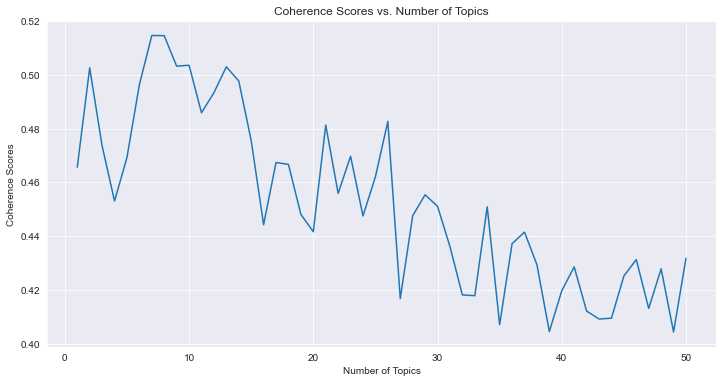

In [124]:
# Updated 4/11 
plt.figure(figsize=(12,6))
plt.title('Coherence Scores vs. Number of Topics')
plt.xlabel('Number of Topics')
plt.ylabel('Coherence Scores')
sns.lineplot(x=num_topics, y=coherence_scores)
plt.show()

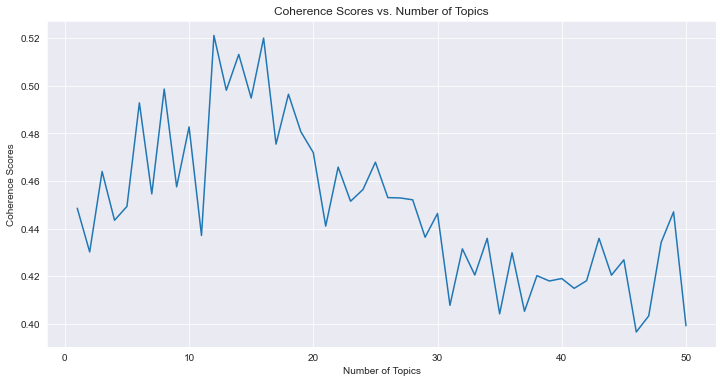

In [189]:
plt.figure(figsize=(12,6))
plt.title('Coherence Scores vs. Number of Topics')
plt.xlabel('Number of Topics')
plt.ylabel('Coherence Scores')
sns.lineplot(x=num_topics, y=coherence_scores)
plt.show()

In [128]:
pd.DataFrame(list(zip(num_topics, coherence_scores)), columns=['num_topics', 'coherence_score']).sort_values(by='coherence_score', ascending=False)

,num_topics,coherence_score
6,7,0.514689
7,8,0.514609
9,10,0.503610
8,9,0.503264
12,13,0.503028
1,2,0.502632
13,14,0.497754
5,6,0.496361
11,12,0.493382
10,11,0.485917


In [129]:
LDA = gensim.models.ldamodel.LdaModel
lda_model = LdaModel(corpus=doc_term_matrix, id2word=id2word, num_topics=7, random_state=123, passes=50)

In [130]:
lda_model.print_topics()

[(0,
  '0.029*"company" + 0.016*"employee" + 0.014*"work" + 0.010*"job" + 0.008*"get" + 0.007*"also" + 0.007*"people" + 0.007*"working" + 0.007*"help" + 0.006*"everyone"'),
 (1,
  '0.050*"great" + 0.034*"work" + 0.028*"company" + 0.027*"people" + 0.026*"culture" + 0.016*"employee" + 0.014*"team" + 0.012*"amazing" + 0.010*"fun" + 0.010*"environment"'),
 (2,
  '0.011*"benefit package" + 0.010*"bonus" + 0.009*"competitive salary" + 0.009*"benefit" + 0.009*"decent" + 0.008*"generous pto" + 0.007*"401k" + 0.007*"supportive management" + 0.005*"mom" + 0.005*"growth development"'),
 (3,
  '0.028*"good" + 0.016*"product" + 0.015*"company" + 0.010*"people" + 0.010*"team" + 0.008*"office" + 0.008*"culture" + 0.006*"lot" + 0.006*"great" + 0.005*"startup"'),
 (4,
  '0.009*"instructor" + 0.009*"training" + 0.007*"owner" + 0.006*"skill" + 0.005*"like family" + 0.005*"helpful" + 0.005*"senior management" + 0.005*"learn" + 0.004*"none" + 0.004*"entry level"'),
 (5,
  '0.012*"free food" + 0.011*"ping p

In [131]:
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim_models.prepare(lda_model, doc_term_matrix, id2word)
vis 

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1     -0.241046  0.006222       1        1  37.091505
0     -0.211851  0.190648       2        1  36.307635
3     -0.085451 -0.193926       3        1  10.960283
6     -0.080617 -0.089057       4        1   9.211056
4      0.211337  0.077884       5        1   3.031705
5      0.203845  0.016291       6        1   1.837161
2      0.203782 -0.008061       7        1   1.560655, topic_info=              Term         Freq        Total Category  logprob  loglift
12           great  3625.000000  3625.000000  Default  30.0000  30.0000
186           good  1074.000000  1074.000000  Default  29.0000  29.0000
1080             ’   629.000000   629.000000  Default  28.0000  28.0000
83         culture  2098.000000  2098.000000  Default  27.0000  27.0000
2628      training   796.000000   796.000000  Default  26.0000  26.0000
...            ...          ...          ...      ...      ...      ...
110        benefit    25.801496   769.174215   Topic7  -4.7262   0.7652
3441  good benefit    11.692766    98.582259   Topic7  -5.5177   2.0281
3762    also offer     7.423576    19.804013   Topic7  -5.9720   3.1788
3334           gym     7.295411    24.068487   Topic7  -5.9894   2.9664
476            pay     7.816245   352.477517   Topic7  -5.9204   0.3513

[448 rows x 6 columns], token_table=      Topic      Freq  Term
term                       
15        2  0.996268    'm
16        1  0.108607   're
16        2  0.789604   're
16        3  0.099801   're
4844      7  0.831656  2019
...     ...       ...   ...
4315      3  0.967664     —
1080      4  0.998728     ’
1081      4  0.983847     “
1082      4  0.988009     ”
2689      1  0.973759     •

[708 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 1, 4, 7, 5, 6, 3])

# Predictions

## TF-IDF

In [212]:
df.head()

,company,headline,date,overall_rating,author_position,pros,cons,pros_cleaned,year,headline_cleaned
0,6sense,Love working here,2022-02-01,5.0,Frontend Developer,- Love working with my team\n- There's complet...,The meetings with US folks tend to go late at ...,love working team complete transparency compan...,2022,love working
1,6sense,Great Opportunity,2022-03-30,5.0,Technical Recruiter,Great mentorship opportunities and supportive ...,No cons. They are growing fast,great mentorship opportunity supportive team,2022,great opportunity
2,6sense,"Fantastic place to learn, grow, and be heard",2022-03-14,5.0,Demand Generation Manager,Where do I even begin? I felt like I was a par...,None that I can think of!,even begin felt like part family first day onb...,2022,fantastic place learn grow heard
3,6sense,Fantastic Company,2022-03-16,5.0,Tax,"Great people to work with, value employees' op...",None that I can say at this time.,great people work employee opinion skill exper...,2022,fantastic company
4,6sense,Love it!,2022-03-14,5.0,Corporate Event Marketing Specialist,- Great compensation\r\n- Amazing benefits\r\n...,- There are a few teams that are still being b...,great compensation amazing benefit wonderful e...,2022,love


### Pros Column Only 

In [310]:
X = df['pros_cleaned']
y = df['overall_rating']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3) 
print(X_train.shape)
print(y_train.shape)

(125241,)
(125241,)


In [311]:
scaler = StandardScaler(with_mean=False)

In [312]:
vectorizer = TfidfVectorizer(ngram_range=(1,2), max_features=10000)
X_train_tf_idf = vectorizer.fit_transform(X_train)
# X_train_tf_idf_scaled = scaler.fit_transform(X_train_tf_idf)
X_test_tf_idf = vectorizer.transform(X_test)
print(X_train_tf_idf.shape)
print(X_train.shape)
# (6321, 9428)
# 6321 reviews with 9428 unique words 

(125241, 10000)
(125241,)


In [313]:
nb_classifier = MultinomialNB()
nb_classifier.fit(X_train_tf_idf, y_train)
y_hat_train = nb_classifier.predict(X_train_tf_idf)
y_hat_test = nb_classifier.predict(X_test_tf_idf)
print(f'Train Accuracy: {accuracy_score(y_train, y_hat_train)}')
print(f'Test Accuracy: {accuracy_score(y_test, y_hat_test)}')

Train Accuracy: 0.4547073242787905
Test Accuracy: 0.40029809035863995


# Pros and Headline Column

In [314]:
# X_pros = df['pros_cleaned']
# X_headline = df['headline']
from scipy.sparse import csr_matrix

"""

"""
# TODO add scaling 
def split_data(df, features, target='overall_rating', test_size=0.3, vec_max_features=10000):
    
    X = df[features]
    y = df[target]
    
    #scaler = StandardScaler(with_mean=False)

    # train test split 
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3) 
    
    X_train_final = pd.DataFrame()
    X_test_final = pd.DataFrame()
    
    # loop through features 
    for feature in features: 
        # Get X_train for just the feature column 
        X_train_current = X_train[feature]
        X_test_current = X_test[feature]
        
        # vectorizer 
        vectorizer = TfidfVectorizer(ngram_range=(1,2), max_features=vec_max_features)
        X_train_current_tfidf = pd.DataFrame(vectorizer.fit_transform(X_train_current).todense(), columns=vectorizer.get_feature_names())
        #X_train_current_tfidf_scaled = pd.DataFrame(scaler.fit_transform(X_train_current_tfidf.values), columns=X_train_current_tfidf.columns, index=X_train_current_tfidf.index)
        
        X_test_current_tfidf = pd.DataFrame(vectorizer.transform(X_test_current).todense(), columns=vectorizer.get_feature_names())
        #X_test_current_tfidf_scaled = pd.DataFrame(scaler.transform(X_test_current_tfidf.values), columns=X_test_current_tfidf.columns, index=X_test_current_tfidf.index)
        
        # add to combined dataframe 
        X_train_final = pd.concat([X_train_final, X_train_current_tfidf], axis=1)
        X_test_final = pd.concat([X_test_final, X_test_current_tfidf], axis=1)
    
    return X_train_final, X_test_final, y_train, y_test 



In [268]:
features = ['pros_cleaned']
X_train, X_test, y_train, y_test = split_data(df, features)

nb_classifier = MultinomialNB()
nb_classifier.fit(X_train, y_train)
y_hat_train = nb_classifier.predict(X_train)
y_hat_test = nb_classifier.predict(X_test)
print(f'Train Accuracy: {accuracy_score(y_train, y_hat_train)}')
print(f'Test Accuracy: {accuracy_score(y_test, y_hat_test)}')

Train Accuracy: 0.7818383167220376
Test Accuracy: 0.7718715393133998


In [315]:
features = ['pros_cleaned','headline_cleaned']
X_train, X_test, y_train, y_test = split_data(df, features)

nb_classifier = MultinomialNB()
nb_classifier.fit(X_train, y_train)
y_hat_train = nb_classifier.predict(X_train)
y_hat_test = nb_classifier.predict(X_test)
print(f'Train Accuracy: {accuracy_score(y_train, y_hat_train)}')
print(f'Test Accuracy: {accuracy_score(y_test, y_hat_test)}')

MemoryError: Unable to allocate 9.33 GiB for an array with shape (125241, 10000) and data type float64

## Word2Vec

## Bert